In [1]:
import os
import sys
import numpy as np
import matplotlib.pyplot as plt

# Add the directory where dynamics.py and utils.py are located to sys.path
module_path = os.path.abspath(os.path.join('../src'))
if module_path not in sys.path:
    sys.path.append(module_path)

from tqdm import tqdm
from dynamics import SatelliteDynamics
from scipy.optimize import approx_fprime
from scipy.linalg import block_diag, solve
from utils import get_form_initial_conditions

In [2]:
# Simulation parameters
dt = 60.0  # Time step [s]
T = 395  # Duration [min]
T_RMSE = 300  # Index from which the RMSE is calculated
M = 1  # Number of Monte-Carlo simulations
N = 4  # Number of satellites
formation = 1
n_x = 6  # Number of states
n_p = 3  
n_y_1 = 3  # Number of measurements
n_y_2 = 2
n_y_3 = 2
n_y_4 = 2
K = T
W = 100 # Window size [min]

In [3]:
# Initial state vector and get the true state vectors (propagation) F
X_initial = get_form_initial_conditions(formation)
X_true = np.zeros((24, 1, T))
X_true[:, :, 0] = X_initial
for t in range(T - 1):
    X_true[:, :, t + 1] = SatelliteDynamics().x_new(dt, X_true[:, :, t])

# Process noise
q_chief_pos = 1e-1  # [m]
q_chief_vel = 1e-2 # [m / s]
Q_chief = (
    np.diag(np.concatenate([q_chief_pos * np.ones(3), q_chief_vel * np.ones(3)]))
    ** 2
)
q_deputy_pos = 1e0  # [m]
q_deputy_vel = 1e-2  # [m / s]
Q_deputy = (
    np.diag(np.concatenate([q_deputy_pos * np.ones(3), q_deputy_vel * np.ones(3)]))
    ** 2
)
Q_deputies = block_diag(Q_deputy, Q_deputy, Q_deputy)
Q = block_diag(Q_chief, Q_deputies)

# Observation noise
r_chief_pos = 1e-1  # [m]
R_chief = np.diag(np.concatenate([r_chief_pos * np.ones(3)])) ** 2
r_deputy_pos = 1e0  # [m]
R_deputies = np.diag(np.concatenate([r_deputy_pos * np.ones(6)])) ** 2
R = block_diag(R_chief, R_deputies)

# Initial deviation noise
p_pos_initial = 1e2  # [m]
p_vel_initial = 1e-2  # [m / s]
P = np.array([[1, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0], [0, 0, 1, 0, 0, 0]])

In [4]:
def h_function_chief(x_vec):
    """
    Computes the measurement vector based on the current state vector.
    The measurement vector includes position components.

    Parameters:
    x_vec (np.array): The current state vector of the satellite (position [km] and velocity [km / s]).
    """
    return x_vec[0:3]

def h_function_deputy(x_vec):
    """
    Computes the measurement vector based on the current state vector.

    Parameters:
    x_vec (np.array): The current state vector of the satellite (position [km] and velocity [km / s]).

    Returns:
    y (np.array): The measurement vector of the satellite (range [km]).
    """
    r_chief = x_vec[:3]
    r_deputy1 = x_vec[6:9]
    r_deputy2 = x_vec[12:15]
    r_deputy3 = x_vec[18:21]

    range_deputy1_chief = np.linalg.norm(r_deputy1 - r_chief)
    range_deputy1_deputy2 = np.linalg.norm(r_deputy1 - r_deputy2)
    range_deputy1_deputy3 = np.linalg.norm(r_deputy1 - r_deputy3)
    range_deputy2_chief = np.linalg.norm(r_deputy2 - r_chief)
    range_deputy2_deputy3 = np.linalg.norm(r_deputy2 - r_deputy3)
    range_deputy3_chief = np.linalg.norm(r_deputy3 - r_chief)

    return np.array(
        [
            [range_deputy1_chief],
            [range_deputy1_deputy2],
            [range_deputy1_deputy3],
            [range_deputy2_chief],
            [range_deputy2_deputy3],
            [range_deputy3_chief],
        ]
    )

def h(x_vec):
    return np.concatenate([h_function_chief(x_vec), h_function_deputy(x_vec)])

In [5]:
# Simulation setup
np.random.seed(43)
X_est = np.zeros_like(X_true)
initial_dev = np.concatenate(
    (
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
    )
)
X_est[:, :, 0] = X_initial + initial_dev
for t in range(T - 1):
    X_est[:, :, t + 1] = SatelliteDynamics().x_new(dt, X_est[:, :, t])

# Observations
Y = np.zeros((9, 1, T))
for t in range(T):
    Y[:, :, t] = h(X_true[:, :, t]) + np.random.normal(0, np.sqrt(np.diag(R)).reshape((9, 1)), size=(9, 1))
    
dev_chief_initial = np.linalg.norm(X_est[:3, :, :] - X_true[:3, :, :], axis=0).reshape(-1, 1)
dev_deputy1_initial = np.linalg.norm(X_est[6:9, :, :] - X_true[6:9, :, :], axis=0).reshape(-1, 1)
dev_deputy2_initial = np.linalg.norm(X_est[12:15, :, :] - X_true[12:15, :, :], axis=0).reshape(-1, 1)
dev_deputy3_initial = np.linalg.norm(X_est[18:21, :, :] - X_true[18:21, :, :], axis=0).reshape(-1, 1)

In [6]:
def surrogate_function(x_i, x_j, z_i, z_j, d_ij, sigma=None):
    """
    Compute the surrogate function Φ_ij.
    
    Args:
        x_i, x_j: Current position vectors for agents i and j
        z_i, z_j: Previous iteration position vectors (denoted as bar_x in the equation)
        d_ij: True measurement between agents i and j
        sigma: Standard deviation parameter
    """
    # Compute the norm of the difference between previous positions
    z_ij_norm = np.linalg.norm(P @ z_i - P @ z_j)
    
    # Term 1: ||x_i - bar_x_i||^2 / sigma^2
    term1 = np.linalg.norm(P @ x_i - P @ z_i)**2 / sigma**2
    
    # Term 2: (||bar_x_i - bar_x_j|| - d_ij) * (x_i - bar_x_i)^T(bar_x_i - bar_x_j) / (sigma^2 * ||bar_x_i - bar_x_j||)
    term2 = ((z_ij_norm - d_ij) / (sigma**2 * z_ij_norm)) * (P @ x_i - P @ z_i).T @ (P @ z_i - P @ z_j)
    
    # Term 3: ||x_j - bar_x_j||^2 / sigma^2
    term3 = np.linalg.norm(P @ x_j - P @ z_j)**2 / sigma**2
    
    # Term 4: -(||bar_x_i - bar_x_j|| - d_ij) * (x_j - bar_x_j)^T(bar_x_i - bar_x_j) / (sigma^2 * ||bar_x_i - bar_x_j||)
    term4 = -((z_ij_norm - d_ij) / (sigma**2 * z_ij_norm)) * (P @ x_j - P @ z_j).T @ (P @ z_i - P @ z_j)
    
    # Term 5: ||bar_x_i - bar_x_j||^2 / (2*sigma^2)
    term5 = z_ij_norm**2 / (2 * sigma**2)
    
    # Term 6: -d_ij * ||bar_x_i - bar_x_j|| / sigma^2
    term6 = -(d_ij * z_ij_norm) / sigma**2
    
    # Term 7: d_ij^2 / (2*sigma^2)
    term7 = d_ij**2 / (2 * sigma**2)
    
    return term1 + term2 + term3 + term4 + term5 + term6 + term7

def surrogate_gradient(x_i, x_j, z_i, z_j, d_ij, sigma=None):
    """
    Compute the gradient of the surrogate function Φ_ij.
    """
    z_ij_norm = np.linalg.norm(P @ z_i - P @ z_j)
    z_ij = P @ z_i - P @ z_j
    
    # Gradient with respect to x_i
    grad_i = (2/sigma**2) * P.T @ (P @ x_i - P @ z_i) + ((z_ij_norm - d_ij) / (sigma**2 * z_ij_norm)) * P.T @ z_ij
    
    # Gradient with respect to x_j
    grad_j = (2/sigma**2) * P.T @ (P @ x_j - P @ z_j) - ((z_ij_norm - d_ij) / (sigma**2 * z_ij_norm)) * P.T @ z_ij
    
    return grad_i, grad_j

def surrogate_hessian(x_i, x_j, z_i, z_j, d_ij, sigma=None):
    """
    Compute the Hessian of the surrogate function Φ_ij.
    """
    n = 3
    
    # The Hessian is constant with respect to x_i and x_j
    H_ii = (2/sigma**2) * P.T @ P
    H_ij = P.T @ np.zeros((n, n)) @ P
    H_ji = P.T @ np.zeros((n, n)) @ P
    H_jj = (2/sigma**2) * P.T @ P
    
    return H_ii, H_ij, H_ji, H_jj

In [7]:
def f(x_0, y, z_0=None):
    """
    Cost function combining direct measurements and surrogate terms.
    """
    f_x_0 = 0
    if z_0 is None:
        z_0 = x_0.copy()

    # Extract positions for each satellite
    x_1_k = x_0[:n_x, :]
    x_2_k = x_0[n_x:2*n_x, :]
    x_3_k = x_0[2*n_x:3*n_x, :]
    x_4_k = x_0[3*n_x:4*n_x, :]
    
    z_1_k = z_0[:n_x, :]
    z_2_k = z_0[n_x:2*n_x, :]
    z_3_k = z_0[2*n_x:3*n_x, :]
    z_4_k = z_0[3*n_x:4*n_x, :]
    
    for k in range(W):    
        # 1. Direct measurements (deputies to chief)
        y_1_k = y[:n_y_1, :, k]
        y_rel_k = y[n_y_1:, :, k]

        # Chief absolute measurements
        residual = y_1_k - P @ x_1_k
        f_x_0 += 1/2 * residual.T @ np.linalg.inv(R_chief) @ residual

        # Surrogate terms for edges
        pairs_surrogate = [
            (x_2_k, x_1_k, z_2_k, z_1_k, y_rel_k[0]),  # Deputy 1 to chief
            (x_2_k, x_3_k, z_2_k, z_3_k, y_rel_k[1]),  # Deputy 1 to deputy 2
            (x_2_k, x_4_k, z_2_k, z_4_k, y_rel_k[2]),  # Deputy 1 to deputy 3
            (x_3_k, x_1_k, z_3_k, z_1_k, y_rel_k[3]),  # Deputy 2 to chief
            (x_3_k, x_4_k, z_3_k, z_4_k, y_rel_k[4]),  # Deputy 2 to deputy 3
            (x_4_k, x_1_k, z_4_k, z_1_k, y_rel_k[5]),  # Deputy 3 to chief
        ]

        for x_i_k, x_j_k, z_i_k, z_j_k, d_ij_k in pairs_surrogate:
            f_x_0 += surrogate_function(x_i_k, x_j_k, z_i_k, z_j_k, d_ij_k, sigma=r_deputy_pos)

        if k < W - 1:
            # Propagate states
            x_1_k = SatelliteDynamics().x_new(dt, x_1_k)
            x_2_k = SatelliteDynamics().x_new(dt, x_2_k)
            x_3_k = SatelliteDynamics().x_new(dt, x_3_k)
            x_4_k = SatelliteDynamics().x_new(dt, x_4_k)
            
            z_1_k = SatelliteDynamics().x_new(dt, z_1_k)
            z_2_k = SatelliteDynamics().x_new(dt, z_2_k)
            z_3_k = SatelliteDynamics().x_new(dt, z_3_k)
            z_4_k = SatelliteDynamics().x_new(dt, z_4_k)

    return f_x_0

def grad_f(x_0, y, z_0=None):
    """
    Gradient of cost function.
    """
    grad_f_x_0 = np.zeros_like(x_0)
    if z_0 is None:
        z_0 = x_0.copy()

    # Extract positions and STMs
    x_1_k = x_0[:n_x, :]
    x_2_k = x_0[n_x:2*n_x, :]
    x_3_k = x_0[2*n_x:3*n_x, :]
    x_4_k = x_0[3*n_x:4*n_x, :]
    
    z_1_k = z_0[:n_x, :]
    z_2_k = z_0[n_x:2*n_x, :]
    z_3_k = z_0[2*n_x:3*n_x, :]
    z_4_k = z_0[3*n_x:4*n_x, :]
    
    F_1_k = np.eye(n_x)
    F_2_k = np.eye(n_x)
    F_3_k = np.eye(n_x)
    F_4_k = np.eye(n_x)

    for k in range(W):
        # 1. Direct measurements (deputies to chief)
        y_1_k = y[:n_y_1, :, k]
        y_rel_k = y[n_y_1:, :, k]

        # Chief absolute measurements gradient
        grad_f_x_0[:n_x, :] -= F_1_k.T @ P.T @ np.linalg.inv(R_chief) @ (y_1_k - P @ x_1_k)
            
        # Surrogate terms for edges
        pairs_surrogate = [
            (2, 1, x_2_k, x_1_k, z_2_k, z_1_k, y_rel_k[0], F_2_k, F_1_k),  # Deputy 1 to chief
            (2, 3, x_2_k, x_3_k, z_2_k, z_3_k, y_rel_k[1], F_2_k, F_3_k),  # Deputy 1 to deputy 2
            (2, 4, x_2_k, x_4_k, z_2_k, z_4_k, y_rel_k[2], F_2_k, F_4_k),  # Deputy 1 to deputy 3
            (3, 1, x_3_k, x_1_k, z_3_k, z_1_k, y_rel_k[3], F_3_k, F_1_k),  # Deputy 2 to chief
            (3, 4, x_3_k, x_4_k, z_3_k, z_4_k, y_rel_k[4], F_3_k, F_4_k),  # Deputy 2 to deputy 3
            (4, 1, x_4_k, x_1_k, z_4_k, z_1_k, y_rel_k[5], F_4_k, F_1_k),  # Deputy 3 to chief
        ]
        
        for i, j, x_i_k, x_j_k, z_i_k, z_j_k, d_ij_k, STM_t0_i, STM_t0_j in pairs_surrogate:
            grad_i, grad_j = surrogate_gradient(x_i_k, x_j_k, z_i_k, z_j_k, d_ij_k, sigma=r_deputy_pos)
            
            grad_f_x_0[(i-1)*n_x:i*n_x, :] += STM_t0_i.T @ grad_i
            grad_f_x_0[(j-1)*n_x:j*n_x, :] += STM_t0_j.T @ grad_j

        if k < W - 1:
            # Propagate states and STMs
            F_1_old = F_1_k
            F_2_old = F_2_k
            F_3_old = F_3_k
            F_4_old = F_4_k
            
            x_1_k, F_1_k = SatelliteDynamics().x_new_and_F(dt, x_1_k)
            x_2_k, F_2_k = SatelliteDynamics().x_new_and_F(dt, x_2_k)
            x_3_k, F_3_k = SatelliteDynamics().x_new_and_F(dt, x_3_k)
            x_4_k, F_4_k = SatelliteDynamics().x_new_and_F(dt, x_4_k)
            
            F_1_k = F_1_k @ F_1_old
            F_2_k = F_2_k @ F_2_old
            F_3_k = F_3_k @ F_3_old
            F_4_k = F_4_k @ F_4_old
            
            z_1_k = SatelliteDynamics().x_new(dt, z_1_k)
            z_2_k = SatelliteDynamics().x_new(dt, z_2_k)
            z_3_k = SatelliteDynamics().x_new(dt, z_3_k)
            z_4_k = SatelliteDynamics().x_new(dt, z_4_k)

    return grad_f_x_0

def hessian_f(x_0, y, z_0=None):
    """
    Hessian of cost function combining direct measurements and surrogate terms.
    """
    hessian_f_x_0 = np.zeros((x_0.shape[0], x_0.shape[0]))
    if z_0 is None:
        z_0 = x_0.copy()

    # Extract positions and STMs
    x_1_k = x_0[:n_x, :]
    x_2_k = x_0[n_x:2*n_x, :]
    x_3_k = x_0[2*n_x:3*n_x, :]
    x_4_k = x_0[3*n_x:4*n_x, :]
    
    z_1_k = z_0[:n_x, :]
    z_2_k = z_0[n_x:2*n_x, :]
    z_3_k = z_0[2*n_x:3*n_x, :]
    z_4_k = z_0[3*n_x:4*n_x, :]
    
    F_1_k = np.eye(n_x)
    F_2_k = np.eye(n_x)
    F_3_k = np.eye(n_x)
    F_4_k = np.eye(n_x)

    for k in range(W):
        # 1. Direct measurements (deputies to chief)
        y_1_k = y[:n_y_1, :, k]
        y_rel_k = y[n_y_1:, :, k]

        # Chief absolute measurements Hessian
        hessian_f_x_0[:n_x, :n_x] += F_1_k.T @ P.T @ np.linalg.inv(R_chief) @ P @ F_1_k

        # Surrogate terms for edges
        pairs_surrogate = [
            (2, 1, x_2_k, x_1_k, z_2_k, z_1_k, y_rel_k[0], F_2_k, F_1_k),  # Deputy 1 to chief
            (2, 3, x_2_k, x_3_k, z_2_k, z_3_k, y_rel_k[1], F_2_k, F_3_k),  # Deputy 1 to deputy 2
            (2, 4, x_2_k, x_4_k, z_2_k, z_4_k, y_rel_k[2], F_2_k, F_4_k),  # Deputy 1 to deputy 3
            (3, 1, x_3_k, x_1_k, z_3_k, z_1_k, y_rel_k[3], F_3_k, F_1_k),  # Deputy 2 to chief
            (3, 4, x_3_k, x_4_k, z_3_k, z_4_k, y_rel_k[4], F_3_k, F_4_k),  # Deputy 2 to deputy 3
            (4, 1, x_4_k, x_1_k, z_4_k, z_1_k, y_rel_k[5], F_4_k, F_1_k),  # Deputy 3 to chief
        ]

        for i, j, x_i_k, x_j_k, z_i_k, z_j_k, d_ij_k, STM_t0_i, STM_t0_j in pairs_surrogate:
            H_ii, H_ij, H_ji, H_jj = surrogate_hessian(x_i_k, x_j_k, z_i_k, z_j_k, d_ij_k, sigma=r_deputy_pos)
            
            idx_i = (i-1)*n_x
            idx_j = (j-1)*n_x
            
            # Update Hessian blocks with surrogate terms
            hessian_f_x_0[idx_i:idx_i+n_x, idx_i:idx_i+n_x] += STM_t0_i.T @ H_ii @ STM_t0_i
            hessian_f_x_0[idx_i:idx_i+n_x, idx_j:idx_j+n_x] += STM_t0_i.T @ H_ij @ STM_t0_j
            hessian_f_x_0[idx_j:idx_j+n_x, idx_i:idx_i+n_x] += STM_t0_j.T @ H_ji @ STM_t0_i
            hessian_f_x_0[idx_j:idx_j+n_x, idx_j:idx_j+n_x] += STM_t0_j.T @ H_jj @ STM_t0_j

        if k < W - 1:
            # Propagate states and STMs
            F_1_old = F_1_k
            F_2_old = F_2_k
            F_3_old = F_3_k
            F_4_old = F_4_k
            
            x_1_k, F_1_k = SatelliteDynamics().x_new_and_F(dt, x_1_k)
            x_2_k, F_2_k = SatelliteDynamics().x_new_and_F(dt, x_2_k)
            x_3_k, F_3_k = SatelliteDynamics().x_new_and_F(dt, x_3_k)
            x_4_k, F_4_k = SatelliteDynamics().x_new_and_F(dt, x_4_k)
            
            F_1_k = F_1_k @ F_1_old
            F_2_k = F_2_k @ F_2_old
            F_3_k = F_3_k @ F_3_old
            F_4_k = F_4_k @ F_4_old
            
            z_1_k = SatelliteDynamics().x_new(dt, z_1_k)
            z_2_k = SatelliteDynamics().x_new(dt, z_2_k)
            z_3_k = SatelliteDynamics().x_new(dt, z_3_k)
            z_4_k = SatelliteDynamics().x_new(dt, z_4_k)

    return hessian_f_x_0

# def numerical_gradient(f, x_0, y, z_0=None, epsilon=1e-6):
#     """
#     Compute the numerical gradient of f at x_0 using finite differences.
    
#     Args:
#         f (function): The cost function.
#         x_0 (numpy.ndarray): The current state vector.
#         STM (numpy.ndarray): State transition matrix.
#         y (numpy.ndarray): Observed data.
#         epsilon (float): Small perturbation for finite differences.

#     Returns:
#         numpy.ndarray: Numerical gradient of f at x_0.
#     """
#     if z_0 is None:
#         z_0 = x_0.copy()
    
#     grad = np.zeros_like(x_0)
#     for i in range(x_0.size):
#         # Create perturbed versions of x_0
#         x_0_plus = x_0.copy()
#         x_0_minus = x_0.copy()
        
#         # Add and subtract epsilon to the i-th component
#         x_0_plus[i] += epsilon
#         x_0_minus[i] -= epsilon
        
#         # Compute the function value for perturbed inputs
#         f_plus = f(x_0_plus, y, z_0)
#         f_minus = f(x_0_minus, y, z_0)
        
#         # Central difference approximation
#         grad[i] = (f_plus - f_minus) / (2 * epsilon)
    
#     return grad

# Test grad_f using scipy's approx_fprime
# n = 0
# m = 0
# W = 100
# numerical_grad = numerical_gradient(f, X_true[:, :, n], Y[:, :, n:n + W], X_true[:, :, m]).flatten()
# analytical_grad = grad_f(X_true[:, :, n], Y[:, :, n:n + W], X_true[:, :, m]).flatten()
# print("Numerical Gradient:", numerical_grad)
# print("Analytical Gradient:", analytical_grad)
# print("Gradient Difference:", numerical_grad - analytical_grad)
# -np.linalg.inv(hessian_f(X_true[:, :, n], Y[:, :, n:n + W], X_true[:, :, m])) @ grad_f(X_true[:, :, n], Y[:, :, n:n + W], X_true[:, :, m])

# def numerical_hessian(f, x_0, y, z_0=None, epsilon=1e-6):
#     """
#     Compute the numerical Hessian of f at x_0 using finite differences.
    
#     Args:
#         f (function): The cost function.
#         x_0 (numpy.ndarray): The current state vector.
#         y (numpy.ndarray): Observed data.
#         z_0 (numpy.ndarray, optional): Previous iteration state vector.
#         epsilon (float): Small perturbation for finite differences.

#     Returns:
#         numpy.ndarray: Numerical Hessian of f at x_0.
#     """
#     if z_0 is None:
#         z_0 = x_0.copy()
    
#     n = x_0.size
#     H = np.zeros((n, n))
    
#     for i in range(n):
#         for j in range(n):
#             # Create perturbed versions of x_0
#             x_pp = x_0.copy()  # x plus-plus
#             x_pm = x_0.copy()  # x plus-minus
#             x_mp = x_0.copy()  # x minus-plus
#             x_mm = x_0.copy()  # x minus-minus
            
#             # Add/subtract epsilon to the i,j components
#             x_pp[i] += epsilon
#             x_pp[j] += epsilon
            
#             x_pm[i] += epsilon
#             x_pm[j] -= epsilon
            
#             x_mp[i] -= epsilon
#             x_mp[j] += epsilon
            
#             x_mm[i] -= epsilon
#             x_mm[j] -= epsilon
            
#             # Compute function values and ensure they're scalar
#             f_pp = f(x_pp, y, z_0).item()
#             f_pm = f(x_pm, y, z_0).item()
#             f_mp = f(x_mp, y, z_0).item()
#             f_mm = f(x_mm, y, z_0).item()
            
#             # Central difference approximation for second derivative
#             H[i, j] = (f_pp - f_pm - f_mp + f_mm) / (4 * epsilon * epsilon)
    
#     return H

# # Example usage to test:
# n = 0  # time index
# m = 0  # previous iteration time index
# W = 1  # window size

# numerical_H = numerical_hessian(f, X_true[:, :, n], Y[:, :, n:n + W], X_true[:, :, m])
# analytical_H = hessian_f(X_true[:, :, n], Y[:, :, n:n + W], X_true[:, :, m])

# print("Numerical Hessian:", numerical_H)
# print("Analytical Hessian:", analytical_H)
# print("Hessian Difference:", np.linalg.norm(numerical_H - analytical_H))

# Test grad_f using scipy's approx_fprime
# n = 0
# m = 10
# W = 10
# Y = np.zeros((9, 1, T))
# for t in range(T):
#     Y[:, :, t] = h(X_true[:, :, t]) + np.random.normal(0, np.sqrt(np.diag(R)).reshape((9, 1)), size=(9, 1))
# x_init = np.zeros((4 * n_x, 1))
# x_init[:4*n_x, :] = X_est[:, :, 0]
# f(x_init, Y[:, :, n:n + W]), f(x_init, Y[:, :, n:n + W], X_true[:, :, m]), np.linalg.norm(grad_f(x_init, Y[:, :, n:n + W])), np.linalg.norm(grad_f(x_init, Y[:, :, n:n + W], X_true[:, :, m]))

In [8]:
def L(x_0, y, z_0=None):
    """
    Lagrangian wrapper for the cost function.
    """
    return f(x_0, y, z_0)
    
def grad_L(x_0, y, z_0=None):
    """
    Gradient of Lagrangian wrapper.
    """
    return grad_f(x_0, y, z_0)

def hessian_L(x_0, y, z_0=None):
    """
    Hessian of Lagrangian wrapper.
    """
    return hessian_f(x_0, y, z_0)

In [9]:

class MM_Newton:
    def __init__(self, grad_tol=1e0, max_iter=20, mm_tol=1e0, mm_max_iter=5):
        self.grad_tol = grad_tol
        self.max_iter = max_iter
        self.mm_tol = mm_tol
        self.mm_max_iter = mm_max_iter
        
        # Storage for results
        self.cost_function_values = []
        self.grad_norm_values = []

    def solve(self, x_init, Y, X_true):
        x = x_init
        z = x_init.copy()  # Initialize z as current iterate
        
        for mm_iter in range(self.mm_max_iter):
            print(f"\nMajorization-Minimization Iteration {mm_iter + 1}")
            
            prev_cost_function_value = None
            prev_grad_norm_value = None
            prev_deviation_from_touching_point = None
            prev_global_error = None
            
            # Solve the surrogate problem
            for iteration in range(self.max_iter):
                # Compute the cost function, gradient and Hessian using current z
                L_x = L(x, Y, z)
                grad_L_x = grad_L(x, Y, z)
                hessian_L_x = hessian_L(x, Y, z)

                # Convergence tracking
                cost_function_value = L_x[0][0]
                grad_norm_value = np.linalg.norm(grad_L_x)

                # Store the norms
                self.cost_function_values.append(cost_function_value)
                self.grad_norm_values.append(grad_norm_value)
                
                if prev_cost_function_value is not None:
                    cost_function_change = (cost_function_value - prev_cost_function_value) / abs(prev_cost_function_value + 1e-10) * 100
                    grad_norm_change = (grad_norm_value - prev_grad_norm_value) / abs(prev_grad_norm_value + 1e-10) * 100
                    deviation_from_touching_point_change = (np.linalg.norm(x - z) - prev_deviation_from_touching_point) / abs(prev_deviation_from_touching_point + 1e-10) * 100
                    global_error_change = (np.linalg.norm(x - X_true) - prev_global_error) / abs(prev_global_error + 1e-10) * 100
                prev_cost_function_value = cost_function_value
                prev_grad_norm_value = grad_norm_value
                prev_deviation_from_touching_point = np.linalg.norm(x - z)
                prev_global_error = np.linalg.norm(x - X_true)

                # Check convergence and print metrics
                if grad_norm_value < self.grad_tol or iteration + 1 == self.max_iter:
                    print(f"STOP on Iteration {iteration}\nCost function = {cost_function_value} ({cost_function_change:.2f}%)\nGradient norm = {grad_norm_value} ({grad_norm_change:.2f}%)\nDeviation from touching point norm = {np.linalg.norm(x - z)} ({deviation_from_touching_point_change:.2f}%)\nGlobal relative error = {np.linalg.norm(x - X_true)} ({global_error_change:.2f}%)")
                    print(f"Final position relative errors: {np.linalg.norm(x[0:3, :] - X_true[0:3, :])} m, {np.linalg.norm(x[6:9, :] - X_true[6:9, :])} m, {np.linalg.norm(x[12:15, :] - X_true[12:15, :])} m, {np.linalg.norm(x[18:21, :] - X_true[18:21, :])} m\n")
                    break
                else:
                    if iteration == 0:
                        print(f"Before applying the algorithm\nCost function: {cost_function_value}\nGradient norm: {grad_norm_value}\nDeviation from touching point norm = {np.linalg.norm(x - z)}\nGlobal relative error: {np.linalg.norm(x - X_true)}")
                    else:
                        print(f"Iteration {iteration}\nCost function: {cost_function_value} ({cost_function_change:.2f}%)\nGradient norm: {grad_norm_value} ({grad_norm_change:.2f}%)\nDeviation from touching point norm = {np.linalg.norm(x - z)} ({deviation_from_touching_point_change:.2f}%)\nGlobal relative error = {np.linalg.norm(x - X_true)} ({global_error_change:.2f}%)")
                        
                # Print relative errors 
                print(f"Position relative errors: {np.linalg.norm(x[0:3, :] - X_true[0:3, :])} m, {np.linalg.norm(x[6:9, :] - X_true[6:9, :])} m, {np.linalg.norm(x[12:15, :] - X_true[12:15, :])} m, {np.linalg.norm(x[18:21, :] - X_true[18:21, :])} m\n")
                
                # Solve for the Newton step
                delta_x = solve(hessian_L_x, -grad_L_x)
                x += delta_x
            
            # Update z for next majorization step
            if np.linalg.norm(x - z) < self.mm_tol:
                print(f"Majorization-Minimization converged after {mm_iter + 1} iterations")
                break
            
            # Update z for next majorization step
            z = x.copy()

        return x

In [10]:
def give_me_the_plots(cost_function_values, grad_norm_values):
    iterations = np.arange(0, len(cost_function_values))

    # Plot 1
    plt.semilogy(iterations, cost_function_values, '.-')
    plt.xlabel(r'$m$')
    plt.ylabel(r'$L(x^{(m)})$')
    plt.grid(True)
    plt.grid(True, which="minor", linestyle='--')
    plt.show()
    
    # Plot 2
    plt.semilogy(iterations, grad_norm_values, '.-')
    plt.xlabel(r'$m$')
    plt.ylabel(r'$||\nabla L(x^{(m)})||_2$')
    plt.grid(True)
    plt.grid(True, which="minor", linestyle='--')
    plt.show()

Windows:   0%|          | 0/296 [00:00<?, ?it/s]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1027490136.0165379
Gradient norm: 29945857737.629856
Deviation from touching point norm = 0.0
Global relative error: 354.63849616863644
Position relative errors: 101.72796255564326 m, 242.56776705223683 m, 194.18001273776096 m, 137.38589643018517 m

Iteration 1
Cost function: 388426567.2860124 (-62.20%)
Gradient norm: 862809.8833031874 (-100.00%)
Deviation from touching point norm = 382.1280121645328 (382128012164532.75%)
Global relative error = 380.12368960630806 (7.19%)
Position relative errors: 10.01832484456901 m, 212.90623209518816 m, 256.6424714840717 m, 182.20613270735566 m

Iteration 2
Cost function: 388426565.386273 (-0.00%)
Gradient norm: 8.29490294862111 (-100.00%)
Deviation from touching point norm = 382.1550065872667 (0.01%)
Global relative error = 380.1470890064751 (0.01%)
Position relative errors: 10.01634313016572 m, 212.89706741398405 m, 256.6843778861218 m, 182.20673705142158 m

Iterat

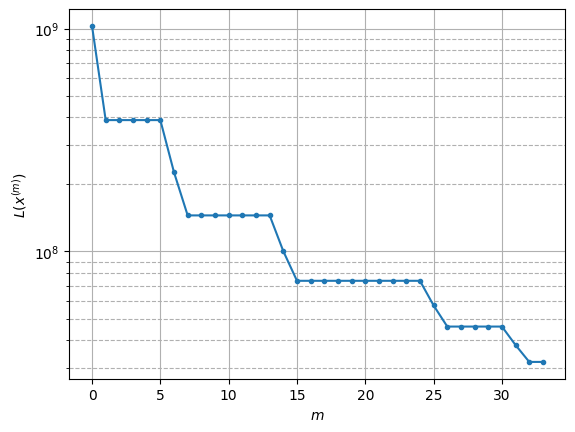

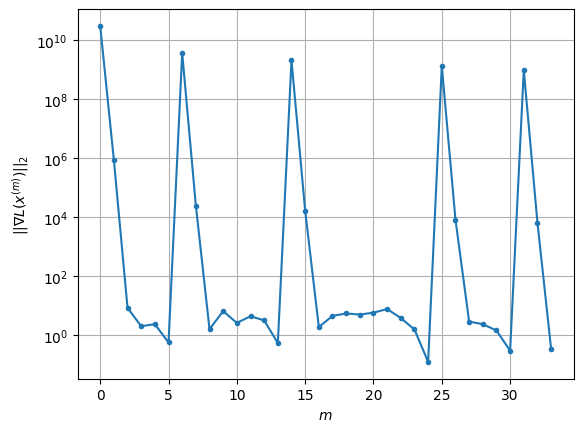

Windows:   0%|          | 1/296 [01:17<6:19:26, 77.17s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 27895387.719670013
Gradient norm: 760840461.0156307
Deviation from touching point norm = 0.0
Global relative error: 404.08102188597996
Position relative errors: 2.397501478935705 m, 153.62561204921275 m, 367.4231165921638 m, 68.37349038535578 m

Iteration 1
Cost function: 23936819.10904404 (-14.19%)
Gradient norm: 4698.403828797147 (-100.00%)
Deviation from touching point norm = 39.347134319015055 (39347134319015.05%)
Global relative error = 390.0284899474348 (-3.48%)
Position relative errors: 2.0706296662646633 m, 142.71867961208872 m, 360.0377952590513 m, 46.064045705272385 m

Iteration 2
Cost function: 23936819.10896377 (-0.00%)
Gradient norm: 4.196853055283013 (-99.91%)
Deviation from touching point norm = 39.34732735350468 (0.00%)
Global relative error = 390.0285120384159 (0.00%)
Position relative errors: 2.0706295120089235 m, 142.71866822938182 m, 360.0378389826269 m, 46.06392628044059 m

Iteratio

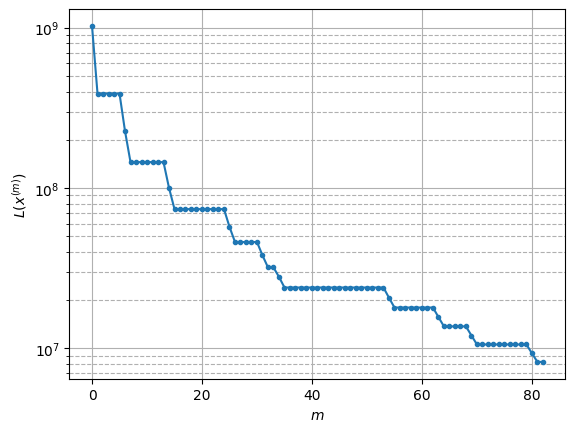

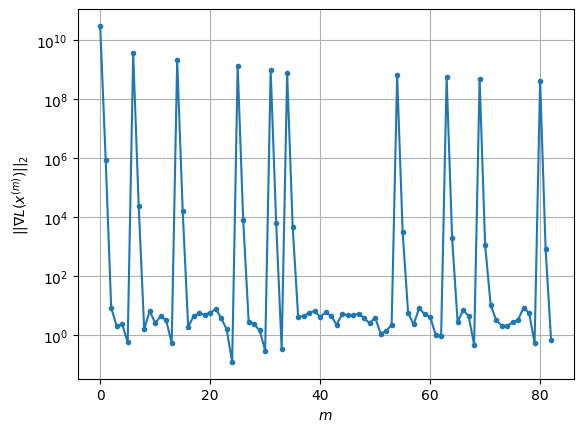

Windows:   1%|          | 2/296 [03:08<7:57:15, 97.40s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7375595.374452693
Gradient norm: 367745297.88452536
Deviation from touching point norm = 0.0
Global relative error: 335.6307379281228
Position relative errors: 0.6752412050888266 m, 137.7210279475728 m, 300.82653183596886 m, 56.42412500278259 m

Iteration 1
Cost function: 6528505.160709428 (-11.49%)
Gradient norm: 571.5071347794285 (-100.00%)
Deviation from touching point norm = 18.91295822210123 (18912958222101.23%)
Global relative error = 329.6448885104068 (-1.78%)
Position relative errors: 0.508396769689828 m, 135.84185190705008 m, 292.24280153383165 m, 69.32866311249201 m

STOP on Iteration 2
Cost function = 6528505.160677793 (-0.00%)
Gradient norm = 0.82454932063734 (-99.86%)
Deviation from touching point norm = 18.912986129017455 (0.00%)
Global relative error = 329.6449031451071 (0.00%)
Final position relative errors: 0.5083967330540686 m, 135.8418603467695 m, 292.24280359226907 m, 69.328707484291

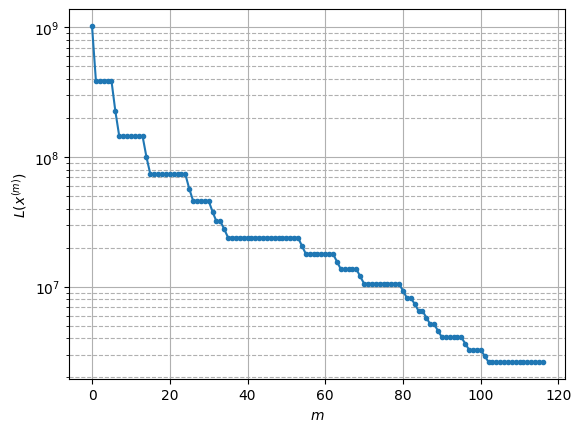

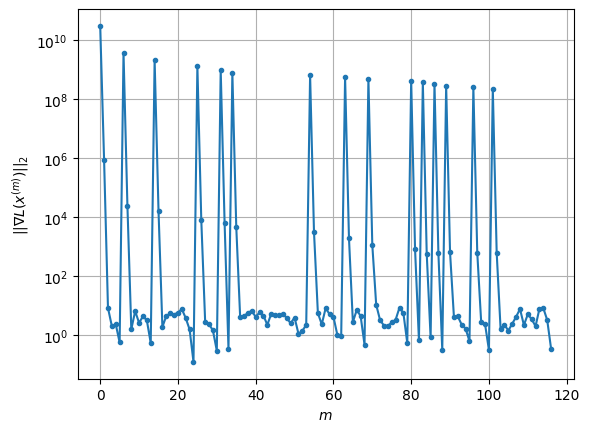

Windows:   1%|          | 3/296 [04:26<7:12:12, 88.51s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2377687.0167520097
Gradient norm: 195915494.47761533
Deviation from touching point norm = 0.0
Global relative error: 295.2694703809372
Position relative errors: 0.29087927879735404 m, 135.70032412628424 m, 242.4031189354204 m, 100.04989415558155 m

Iteration 1
Cost function: 2142169.4735628255 (-9.91%)
Gradient norm: 565.3709907842361 (-100.00%)
Deviation from touching point norm = 12.302020605074311 (12302020605074.31%)
Global relative error = 289.98130241579406 (-1.79%)
Position relative errors: 0.2759678646785093 m, 133.31334304619014 m, 234.0049986060307 m, 107.50885017849534 m

Iteration 2
Cost function: 2142169.4735418037 (-0.00%)
Gradient norm: 3.1877456058542126 (-99.44%)
Deviation from touching point norm = 12.302026235895637 (0.00%)
Global relative error = 289.98130478156514 (0.00%)
Position relative errors: 0.27596788327421556 m, 133.31334340822218 m, 234.0049962379328 m, 107.5088612650945 m


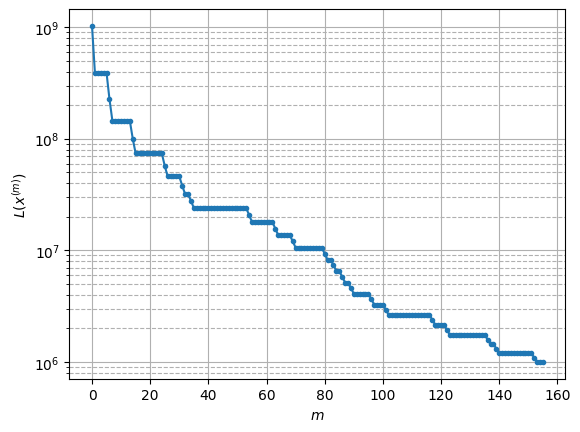

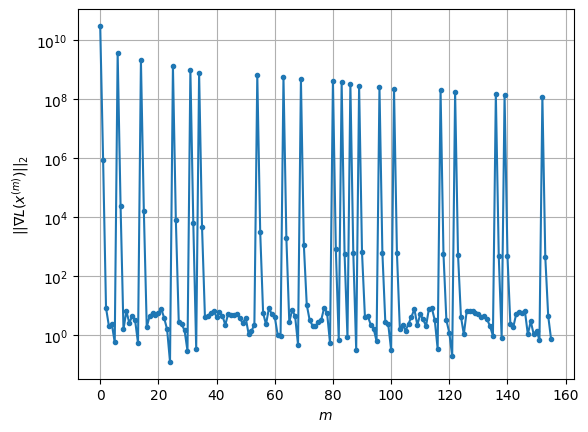

Windows:   1%|▏         | 4/296 [05:53<7:08:13, 87.99s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 914318.113963847
Gradient norm: 105752784.93800081
Deviation from touching point norm = 0.0
Global relative error: 259.79608976801376
Position relative errors: 0.3585178246173701 m, 130.36204040577732 m, 189.77618443699805 m, 120.3515646977524 m

Iteration 1
Cost function: 839727.3158711593 (-8.16%)
Gradient norm: 386.6066915331038 (-100.00%)
Deviation from touching point norm = 9.736940937075019 (9736940937075.02%)
Global relative error = 254.86853219061373 (-1.90%)
Position relative errors: 0.3754592964634462 m, 127.75290658159297 m, 182.16429480623796 m, 124.31040732623269 m

STOP on Iteration 2
Cost function = 839727.3158584741 (-0.00%)
Gradient norm = 0.4841350338402531 (-99.87%)
Deviation from touching point norm = 9.736944009848324 (0.00%)
Global relative error = 254.8685322283398 (0.00%)
Final position relative errors: 0.3754593029852366 m, 127.75290644811572 m, 182.16429264884448 m, 124.3104107

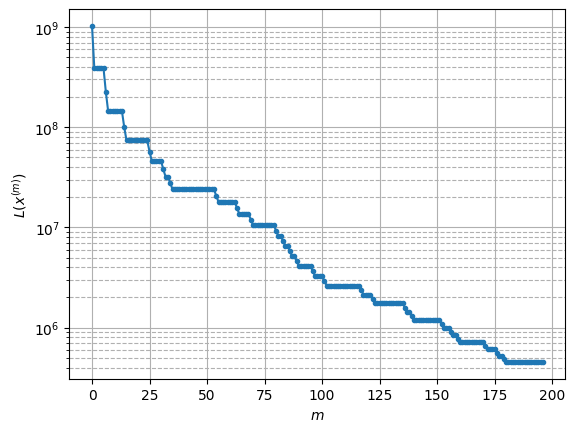

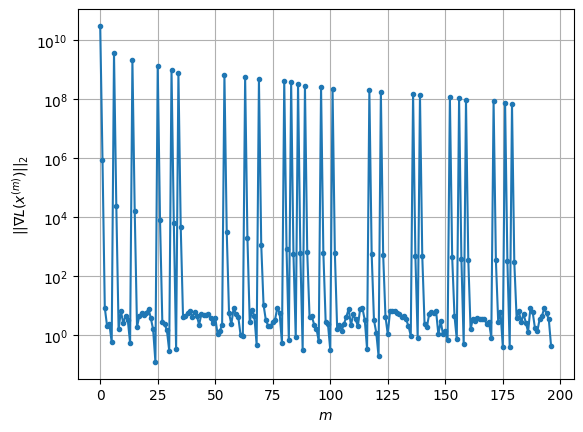

Windows:   2%|▏         | 5/296 [07:25<7:13:56, 89.47s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 424567.50919571647
Gradient norm: 57855208.79170276
Deviation from touching point norm = 0.0
Global relative error: 229.08597335837732
Position relative errors: 0.3573377009066921 m, 123.65161301364175 m, 144.47979360508324 m, 127.73419842272777 m

Iteration 1
Cost function: 396876.4064770619 (-6.52%)
Gradient norm: 259.03482857578206 (-100.00%)
Deviation from touching point norm = 7.975786250750857 (7975786250750.86%)
Global relative error = 224.8871354515233 (-1.83%)
Position relative errors: 0.3701496034657558 m, 121.1827171543242 m, 138.13302303423916 m, 129.6457053507077 m

Iteration 2
Cost function: 396876.40647718596 (0.00%)
Gradient norm: 3.866152913771935 (-98.51%)
Deviation from touching point norm = 7.975787764652753 (0.00%)
Global relative error = 224.88713539224554 (-0.00%)
Position relative errors: 0.3701496188293852 m, 121.18271711563509 m, 138.13302186785856 m, 129.6457065267458 m

STOP 

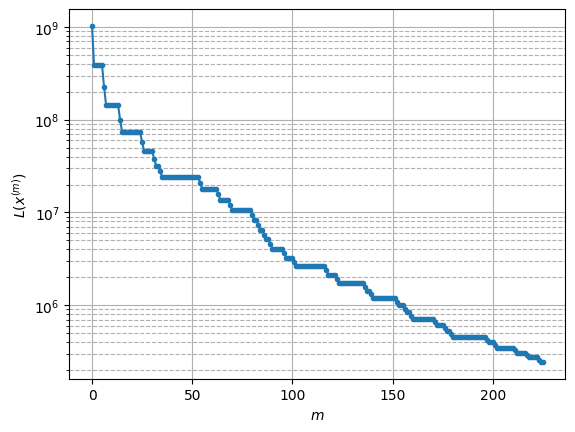

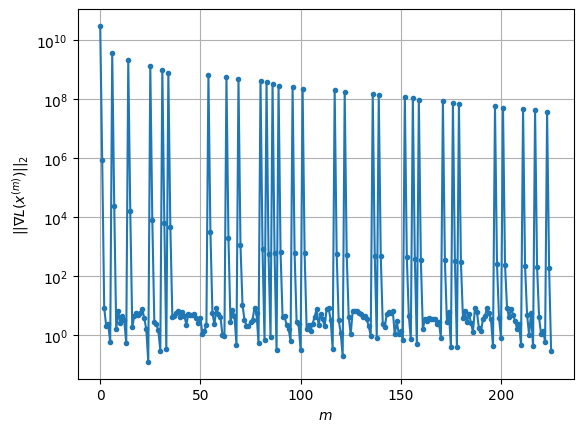

Windows:   2%|▏         | 6/296 [08:31<6:33:43, 81.46s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 233156.03635121396
Gradient norm: 32292685.640733372
Deviation from touching point norm = 0.0
Global relative error: 203.85876752509236
Position relative errors: 0.3132931402101078 m, 116.99609458440023 m, 107.43996958577567 m, 127.77630305814768 m

Iteration 1
Cost function: 221026.2073532776 (-5.20%)
Gradient norm: 167.22442509180448 (-100.00%)
Deviation from touching point norm = 6.426111072198145 (6426111072198.14%)
Global relative error = 200.4560317148724 (-1.67%)
Position relative errors: 0.3195609946414111 m, 114.84581285780331 m, 102.49662026411075 m, 128.402962807754 m

Iteration 2
Cost function: 221026.20735431416 (0.00%)
Gradient norm: 4.726136206173395 (-97.17%)
Deviation from touching point norm = 6.426111851499239 (0.00%)
Global relative error = 200.45603169242077 (-0.00%)
Position relative errors: 0.31956099275822414 m, 114.84581291312185 m, 102.49661963944116 m, 128.4029632218713 m

Ite

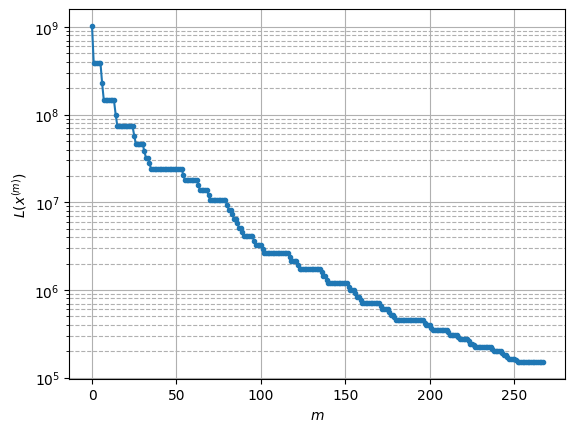

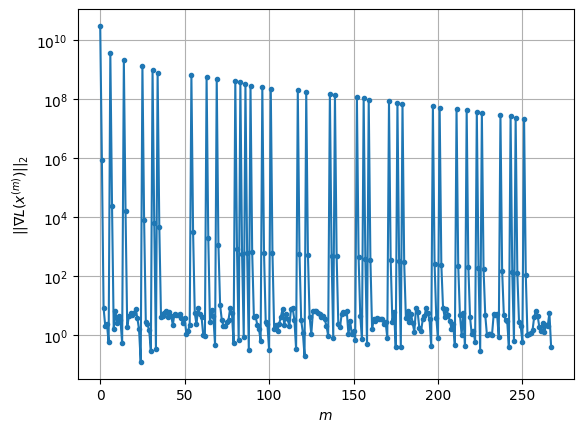

Windows:   2%|▏         | 7/296 [10:04<6:50:06, 85.14s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 146309.2662351635
Gradient norm: 18366324.986889083
Deviation from touching point norm = 0.0
Global relative error: 183.54499904546824
Position relative errors: 0.2581909415221304 m, 110.99947034523072 m, 78.34956522803346 m, 123.40620988122927 m

Iteration 1
Cost function: 140221.06680919137 (-4.16%)
Gradient norm: 102.52463218107741 (-100.00%)
Deviation from touching point norm = 5.083861604415797 (5083861604415.80%)
Global relative error = 180.7781512098233 (-1.51%)
Position relative errors: 0.2612377957774158 m, 109.1876866054551 m, 74.7274642498823 m, 123.18465018517925 m

Iteration 2
Cost function: 140221.0668078445 (-0.00%)
Gradient norm: 1.1553788885020937 (-98.87%)
Deviation from touching point norm = 5.083862090826207 (0.00%)
Global relative error = 180.7781512324725 (0.00%)
Position relative errors: 0.2612377828484817 m, 109.18768675401158 m, 74.72746386604115 m, 123.18465031962054 m

Iterati

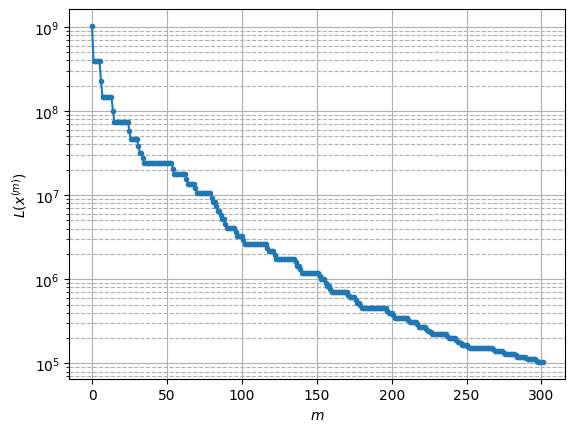

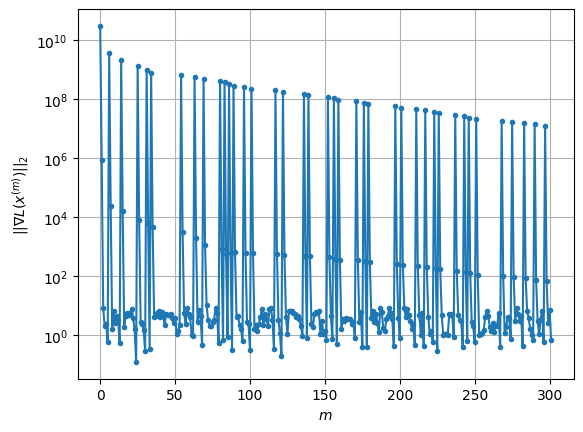

Windows:   3%|▎         | 8/296 [11:21<6:35:42, 82.44s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 102052.92596425874
Gradient norm: 10798787.322247628
Deviation from touching point norm = 0.0
Global relative error: 166.92924621893687
Position relative errors: 0.20749520011721995 m, 105.64959772085756 m, 56.20876708911603 m, 116.37871414573188 m

Iteration 1
Cost function: 98644.76390710437 (-3.34%)
Gradient norm: 62.31961736610729 (-100.00%)
Deviation from touching point norm = 4.031727646117294 (4031727646117.29%)
Global relative error = 164.5867246741895 (-1.40%)
Position relative errors: 0.20948436774464094 m, 104.12722460716634 m, 53.67437355354541 m, 115.60825238968191 m

Iteration 2
Cost function: 98644.76390472939 (-0.00%)
Gradient norm: 3.1988538352139306 (-94.87%)
Deviation from touching point norm = 4.0317279812381885 (0.00%)
Global relative error = 164.58672476820203 (0.00%)
Position relative errors: 0.2094843594175276 m, 104.12722482956514 m, 53.67437329621318 m, 115.6082524427019 m

Ite

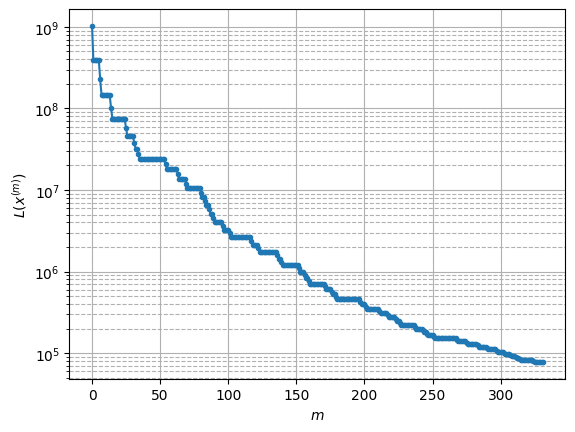

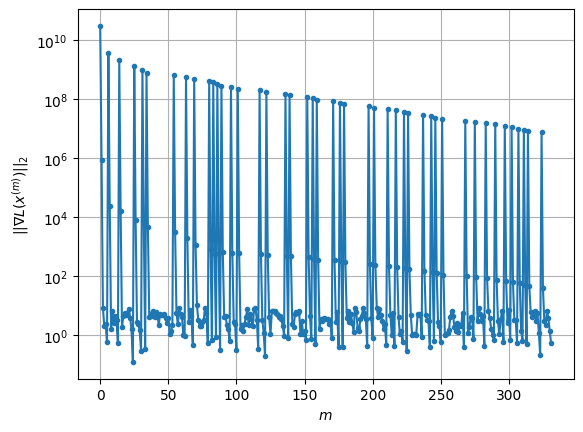

Windows:   3%|▎         | 9/296 [12:28<6:11:20, 77.63s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 77212.19312424572
Gradient norm: 6346696.1028497415
Deviation from touching point norm = 0.0
Global relative error: 152.84408958031426
Position relative errors: 0.16580713077696693 m, 100.72055039810965 m, 39.64842988668722 m, 107.91017269919922 m

Iteration 1
Cost function: 75121.19544760569 (-2.71%)
Gradient norm: 41.16771825465 (-100.00%)
Deviation from touching point norm = 3.2528274390297884 (3252827439029.79%)
Global relative error = 150.77902095685513 (-1.35%)
Position relative errors: 0.16027877433118132 m, 99.41228177733954 m, 37.94353135756144 m, 106.82565045465734 m

STOP on Iteration 2
Cost function = 75121.19544049074 (-0.00%)
Gradient norm = 0.5052142595681013 (-98.77%)
Deviation from touching point norm = 3.252827654210087 (0.00%)
Global relative error = 150.7790211172988 (0.00%)
Final position relative errors: 0.16027877958623432 m, 99.4122820636387 m, 37.94353118037792 m, 106.8256504776

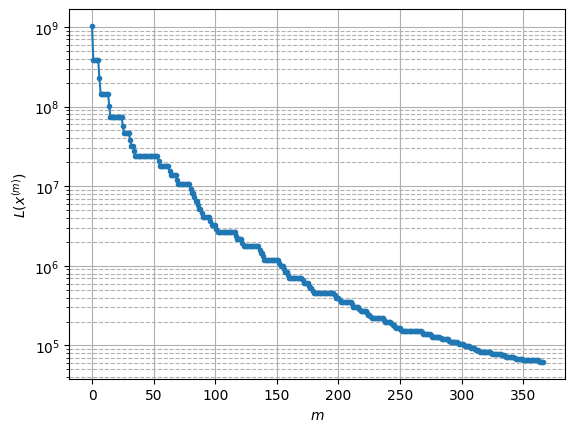

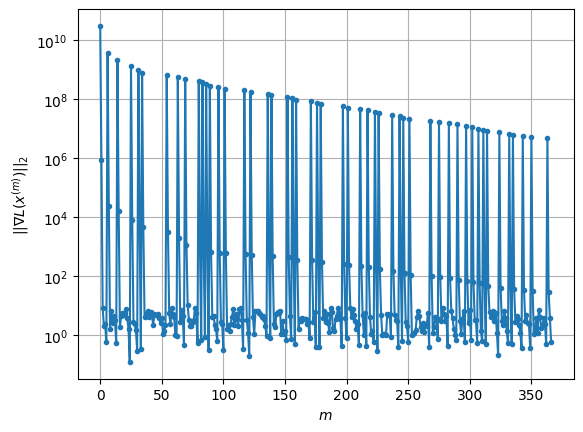

Windows:   3%|▎         | 10/296 [13:48<6:13:36, 78.38s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 62051.18320303365
Gradient norm: 3925399.8793576253
Deviation from touching point norm = 0.0
Global relative error: 140.5339294701804
Position relative errors: 0.12568777335584322 m, 95.9189731584342 m, 27.46773700642828 m, 98.96864710779015 m

Iteration 1
Cost function: 60656.50413350198 (-2.25%)
Gradient norm: 31.12660811746426 (-100.00%)
Deviation from touching point norm = 2.7096579024458594 (2709657902445.86%)
Global relative error = 138.64408232727052 (-1.34%)
Position relative errors: 0.12453021216726 m, 94.76313216081041 m, 26.345131439841854 m, 97.71386448888107 m

Iteration 2
Cost function: 60656.50413273282 (-0.00%)
Gradient norm: 4.811159908105677 (-84.54%)
Deviation from touching point norm = 2.7096579942700707 (0.00%)
Global relative error = 138.64408254672048 (0.00%)
Position relative errors: 0.12453021571247619 m, 94.76313248153153 m, 26.345131330638036 m, 97.71386451865739 m

Iteration 

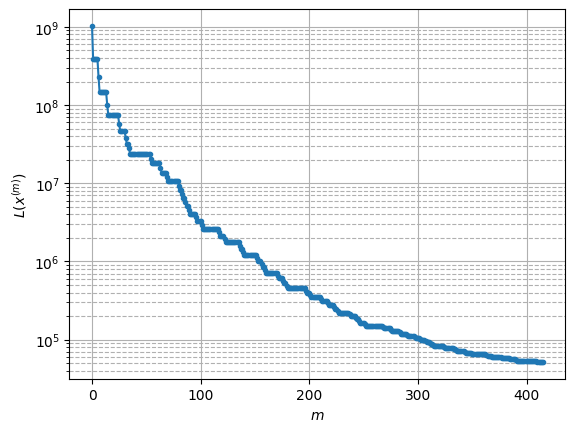

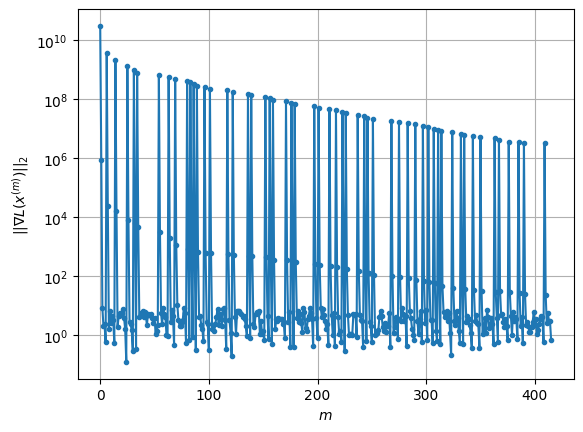

Windows:   4%|▎         | 11/296 [15:43<7:06:19, 89.75s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 52171.48414251537
Gradient norm: 2537467.025619785
Deviation from touching point norm = 0.0
Global relative error: 129.51530734359193
Position relative errors: 0.09784831056791288 m, 91.04088294599087 m, 18.874708942917824 m, 90.16352956190485 m

Iteration 1
Cost function: 51155.44372942661 (-1.95%)
Gradient norm: 26.715546491685284 (-100.00%)
Deviation from touching point norm = 2.352181321507029 (2352181321507.03%)
Global relative error = 127.7308770096958 (-1.38%)
Position relative errors: 0.11021201521374416 m, 89.98570102071851 m, 18.12637317738573 m, 88.820760698295 m

Iteration 2
Cost function: 51155.443730155945 (0.00%)
Gradient norm: 2.5759757961315053 (-90.36%)
Deviation from touching point norm = 2.352181340069068 (0.00%)
Global relative error = 127.73087723813038 (0.00%)
Position relative errors: 0.11021201176229406 m, 89.98570135436758 m, 18.126373082713513 m, 88.82076070810159 m

STOP on I

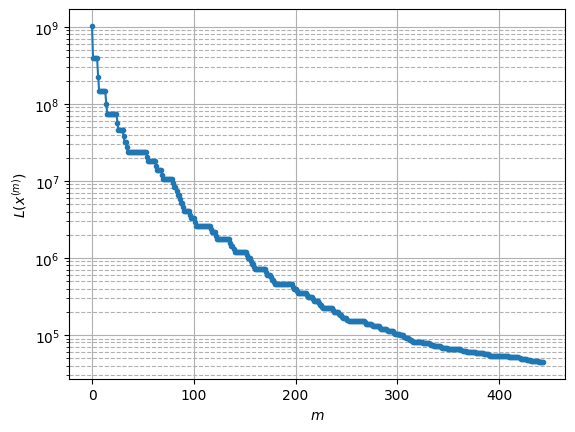

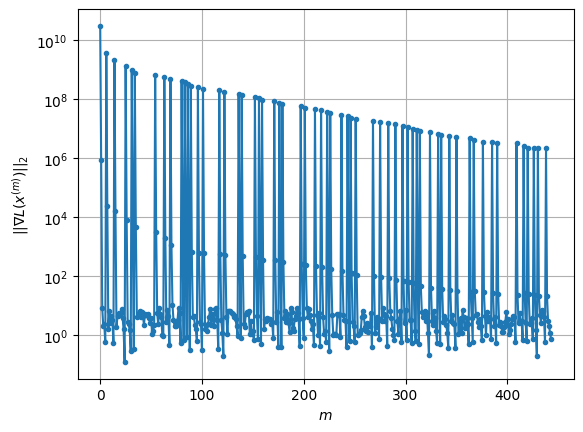

Windows:   4%|▍         | 12/296 [16:49<6:29:59, 82.39s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 44968.94411922161
Gradient norm: 1697559.4942493797
Deviation from touching point norm = 0.0
Global relative error: 119.49403687987692
Position relative errors: 0.09032307287201996 m, 85.93319677975411 m, 13.768423505551803 m, 81.88217332979242 m

Iteration 1
Cost function: 44191.813604787014 (-1.73%)
Gradient norm: 23.251517105313287 (-100.00%)
Deviation from touching point norm = 2.0747725300778606 (2074772530077.86%)
Global relative error = 117.80471201391778 (-1.41%)
Position relative errors: 0.08731937374917517 m, 84.95075686552593 m, 13.216988870391448 m, 80.53931141779066 m

STOP on Iteration 2
Cost function = 44191.81360556015 (0.00%)
Gradient norm = 0.8101789893619281 (-96.52%)
Deviation from touching point norm = 2.074772492438087 (-0.00%)
Global relative error = 117.80471224494075 (0.00%)
Final position relative errors: 0.08731938005381626 m, 84.95075720469454 m, 13.216988783753724 m, 80.5393

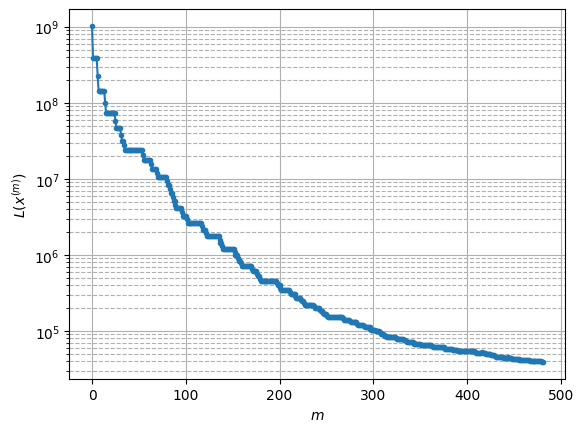

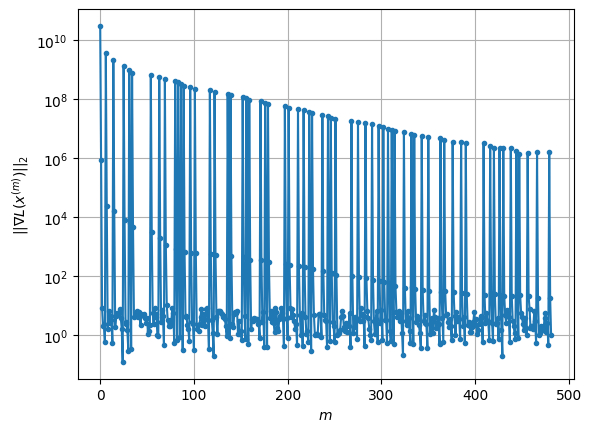

Windows:   4%|▍         | 13/296 [18:17<6:37:14, 84.22s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 39612.20345584002
Gradient norm: 1043401.1311370659
Deviation from touching point norm = 0.0
Global relative error: 110.40284569353447
Position relative errors: 0.07059553286948023 m, 80.53736019361774 m, 12.459329656707684 m, 74.4798134273332 m

Iteration 1
Cost function: 38978.26480224776 (-1.60%)
Gradient norm: 21.11360036048996 (-100.00%)
Deviation from touching point norm = 1.9008813766613737 (1900881376661.37%)
Global relative error = 108.77290885798479 (-1.48%)
Position relative errors: 0.07571914294079757 m, 79.6069617637244 m, 11.977380801048513 m, 73.14899190371092 m

STOP on Iteration 2
Cost function = 38978.26479939315 (-0.00%)
Gradient norm = 0.24445140559602582 (-98.84%)
Deviation from touching point norm = 1.9008813228534962 (-0.00%)
Global relative error = 108.77290907080418 (0.00%)
Final position relative errors: 0.07571914662930161 m, 79.60696209103999 m, 11.977380676249092 m, 73.14899

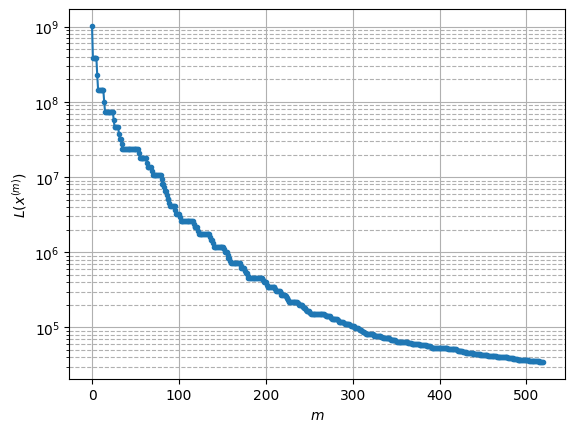

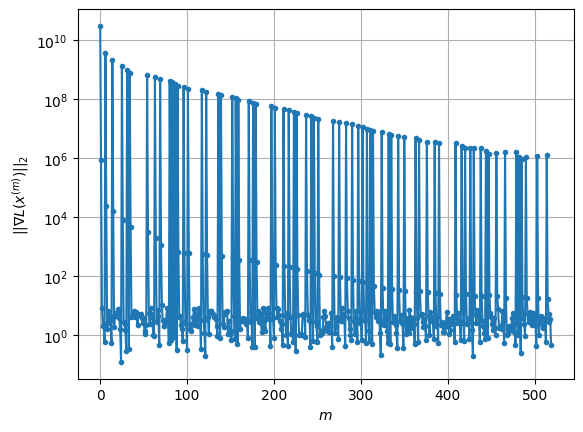

Windows:   5%|▍         | 14/296 [19:45<6:41:14, 85.37s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 35410.25873480274
Gradient norm: 946035.6918299922
Deviation from touching point norm = 0.0
Global relative error: 102.14372954527497
Position relative errors: 0.06297111106868038 m, 74.83268037399789 m, 14.128529063843375 m, 68.07169336692857 m

Iteration 1
Cost function: 34871.75199419039 (-1.52%)
Gradient norm: 18.78661169625369 (-100.00%)
Deviation from touching point norm = 1.7746045044487373 (1774604504448.74%)
Global relative error = 100.55831365469842 (-1.55%)
Position relative errors: 0.06375669697150534 m, 73.94228851220004 m, 13.646763091712238 m, 66.77003790371135 m

Iteration 2
Cost function: 34871.75199827654 (0.00%)
Gradient norm: 5.1121682296373265 (-72.79%)
Deviation from touching point norm = 1.774604444768106 (-0.00%)
Global relative error = 100.55831384174488 (0.00%)
Position relative errors: 0.06375668836203571 m, 73.94228881809843 m, 13.646762945336707 m, 66.77003787657898 m

Itera

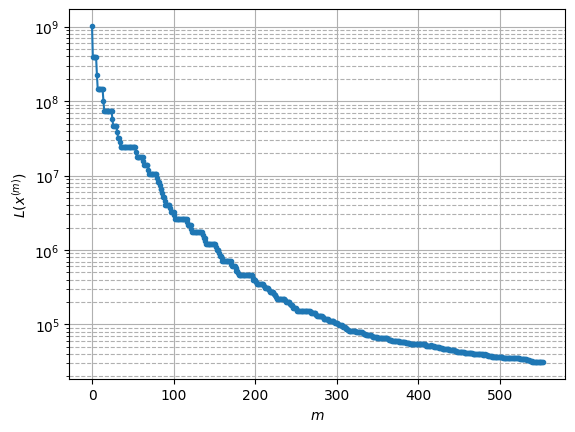

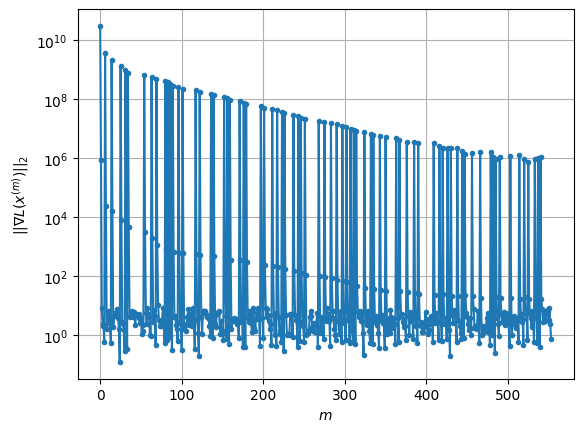

Windows:   5%|▌         | 15/296 [21:04<6:30:42, 83.42s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 32017.41496648079
Gradient norm: 714669.6224743451
Deviation from touching point norm = 0.0
Global relative error: 94.69014253076442
Position relative errors: 0.05311397676617142 m, 68.82576250482583 m, 17.080154575330116 m, 62.74925335653525 m

Iteration 1
Cost function: 31549.0000887074 (-1.46%)
Gradient norm: 16.597879491579288 (-100.00%)
Deviation from touching point norm = 1.6773309709280921 (1677330970928.09%)
Global relative error = 93.13892069393019 (-1.64%)
Position relative errors: 0.06668848605232329 m, 67.9656737276972 m, 16.55955938436175 m, 61.492019552008365 m

Iteration 2
Cost function: 31549.000088177112 (-0.00%)
Gradient norm: 2.856481165018189 (-82.79%)
Deviation from touching point norm = 1.677330918061006 (-0.00%)
Global relative error = 93.13892084650287 (0.00%)
Position relative errors: 0.06668848816625307 m, 67.96567400758738 m, 16.5595592331157 m, 61.49201951447448 m

Iteration 

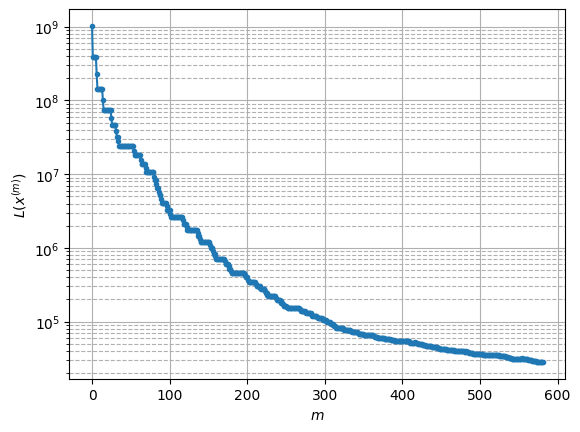

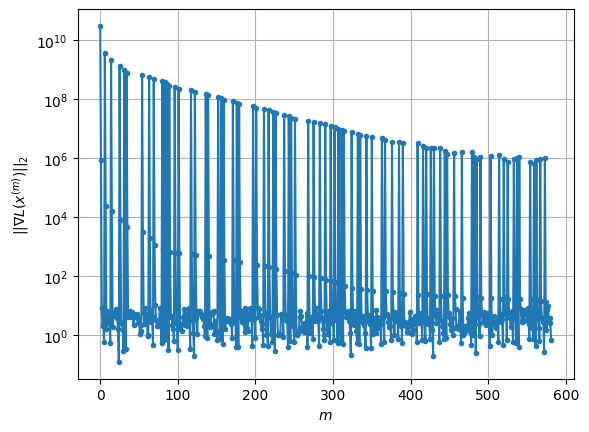

Windows:   5%|▌         | 16/296 [22:10<6:03:52, 77.97s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 29289.99599080831
Gradient norm: 765448.7440240537
Deviation from touching point norm = 0.0
Global relative error: 88.04180388123672
Position relative errors: 0.058706061333731685 m, 62.53084684673445 m, 20.28199558386612 m, 58.56498687285277 m

Iteration 1
Cost function: 28865.551806016512 (-1.45%)
Gradient norm: 15.901370419925888 (-100.00%)
Deviation from touching point norm = 1.6324963917834299 (1632496391783.43%)
Global relative error = 86.49913329226943 (-1.75%)
Position relative errors: 0.0579978996215943 m, 61.7029550484976 m, 19.726429394696705 m, 57.320837531711305 m

Iteration 2
Cost function: 28865.55181509119 (0.00%)
Gradient norm: 4.040665305368815 (-74.59%)
Deviation from touching point norm = 1.6324963394180514 (-0.00%)
Global relative error = 86.4991334129037 (0.00%)
Position relative errors: 0.05799791249462589 m, 61.702955290765004 m, 19.726429242359853 m, 57.320837505376346 m

STOP o

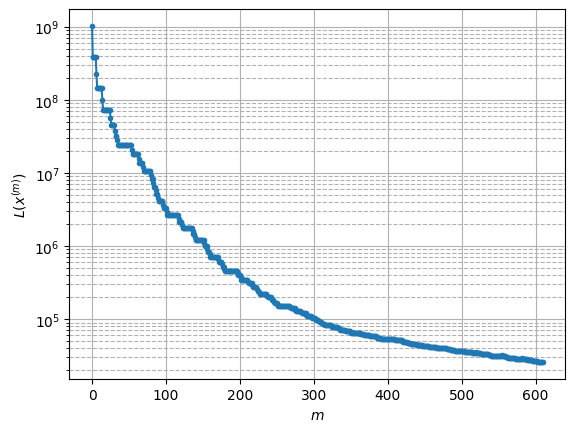

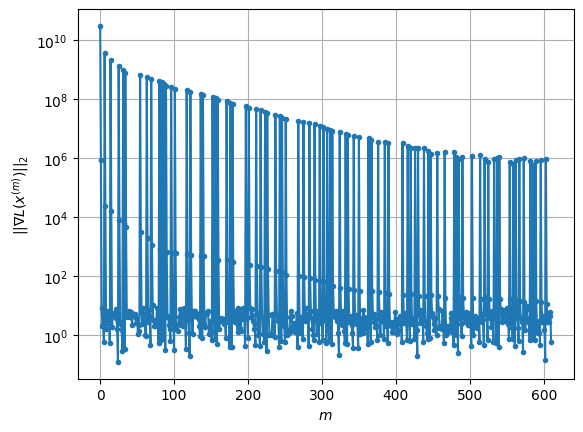

Windows:   6%|▌         | 17/296 [23:17<5:48:16, 74.90s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 26838.14557545755
Gradient norm: 826834.1015618307
Deviation from touching point norm = 0.0
Global relative error: 82.16076091873303
Position relative errors: 0.050575252908930356 m, 56.00279781736868 m, 23.383021830073837 m, 55.38302231734996 m

Iteration 1
Cost function: 26454.96054413068 (-1.43%)
Gradient norm: 14.484585793999342 (-100.00%)
Deviation from touching point norm = 1.575770516246999 (1575770516247.00%)
Global relative error = 80.64571471019843 (-1.84%)
Position relative errors: 0.0588098523681131 m, 55.2015578693925 m, 22.780866331697055 m, 54.19887852557624 m

Iteration 2
Cost function: 26454.96054125179 (-0.00%)
Gradient norm: 1.1301851182804543 (-92.20%)
Deviation from touching point norm = 1.5757704796731824 (-0.00%)
Global relative error = 80.6457147922352 (0.00%)
Position relative errors: 0.0588098580249571 m, 55.20155808124679 m, 22.78086618544901 m, 54.19887849333462 m

STOP on It

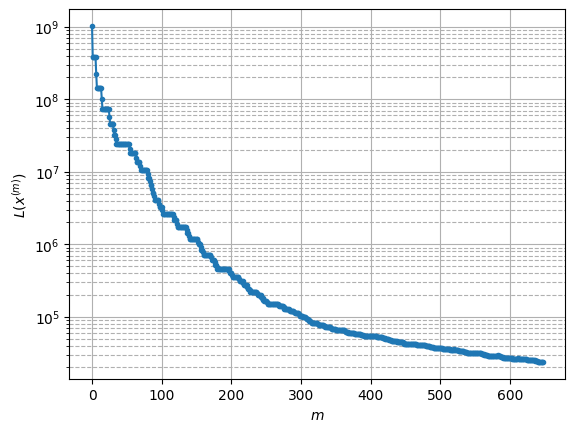

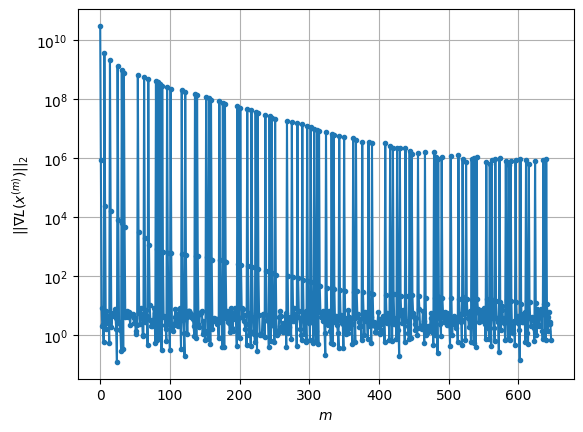

Windows:   6%|▌         | 18/296 [24:41<5:59:50, 77.66s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 24765.529002756735
Gradient norm: 678439.4928123734
Deviation from touching point norm = 0.0
Global relative error: 77.15818220985416
Position relative errors: 0.052398832522055114 m, 49.2695513535381 m, 26.209686774050716 m, 53.28149847350737 m

Iteration 1
Cost function: 24410.802731745483 (-1.43%)
Gradient norm: 13.497835825673713 (-100.00%)
Deviation from touching point norm = 1.5434788179647638 (1543478817964.76%)
Global relative error = 75.66273330316567 (-1.94%)
Position relative errors: 0.06528670196885429 m, 48.48739696263806 m, 25.573099748894062 m, 52.15176148068702 m

STOP on Iteration 2
Cost function = 24410.80272840709 (-0.00%)
Gradient norm = 0.9312600486112721 (-93.10%)
Deviation from touching point norm = 1.5434787982337044 (-0.00%)
Global relative error = 75.66273334487474 (0.00%)
Final position relative errors: 0.06528670855963148 m, 48.487397141430925 m, 25.573099607886437 m, 52.1517

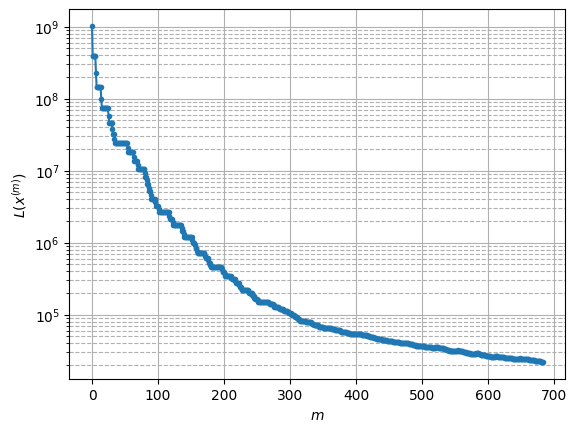

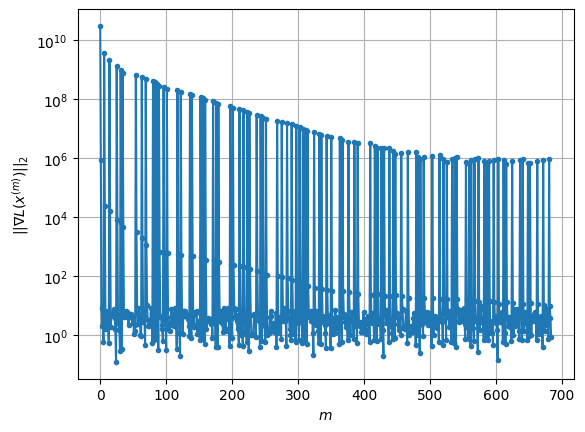

Windows:   6%|▋         | 19/296 [26:07<6:09:46, 80.10s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 22870.449035117144
Gradient norm: 621721.4273016825
Deviation from touching point norm = 0.0
Global relative error: 73.03706270051956
Position relative errors: 0.059893645460249945 m, 42.34919472209159 m, 28.74493794641893 m, 52.1023718420524 m

Iteration 1
Cost function: 22539.567378710122 (-1.45%)
Gradient norm: 12.383468818981298 (-100.00%)
Deviation from touching point norm = 1.5146657468422355 (1514665746842.24%)
Global relative error = 71.57588113878649 (-2.00%)
Position relative errors: 0.06496532743161706 m, 41.586227016127474 m, 28.079697529858308 m, 51.041091619717754 m

Iteration 2
Cost function: 22539.56738757649 (0.00%)
Gradient norm: 1.3416878026179024 (-89.17%)
Deviation from touching point norm = 1.5146657191169581 (-0.00%)
Global relative error = 71.57588116393929 (0.00%)
Position relative errors: 0.06496532997688277 m, 41.58622716365285 m, 28.079697397242878 m, 51.04109160774551 m

Ite

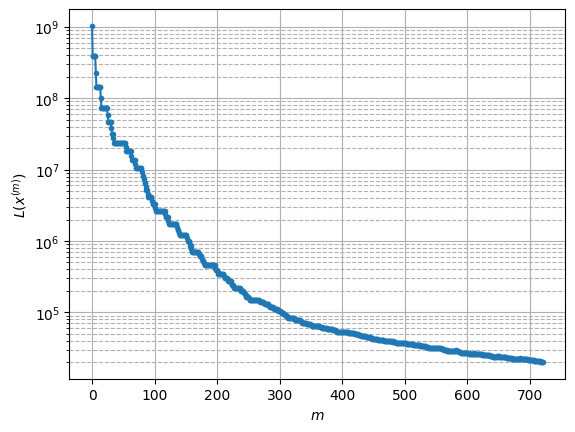

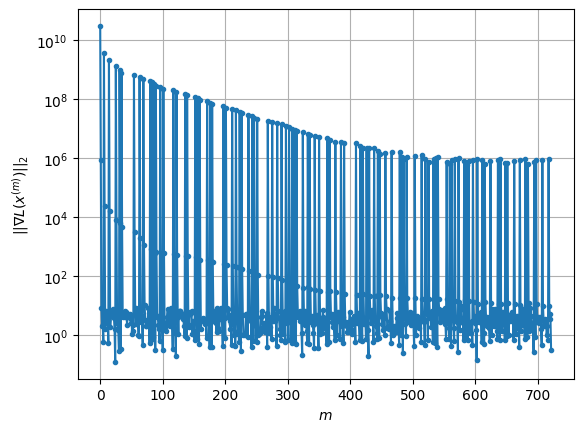

Windows:   7%|▋         | 20/296 [27:35<6:18:48, 82.35s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 21075.870849663363
Gradient norm: 742412.9540088216
Deviation from touching point norm = 0.0
Global relative error: 69.87348387492008
Position relative errors: 0.06009533000826108 m, 35.296698151943545 m, 30.995635107261304 m, 51.72706793102997 m

Iteration 1
Cost function: 20768.639314002034 (-1.46%)
Gradient norm: 11.130405905241984 (-100.00%)
Deviation from touching point norm = 1.4716954266535 (1471695426653.50%)
Global relative error = 68.47548684597434 (-2.00%)
Position relative errors: 0.05876333386931108 m, 34.552306991894994 m, 30.31427896879215 m, 50.75477634750871 m

Iteration 2
Cost function: 20768.639313364773 (-0.00%)
Gradient norm: 4.450589120446285 (-60.01%)
Deviation from touching point norm = 1.471695410273368 (-0.00%)
Global relative error = 68.47548684277729 (-0.00%)
Position relative errors: 0.05876332798674867 m, 34.55230710857843 m, 30.31427884867696 m, 50.7547763355083 m

Iterati

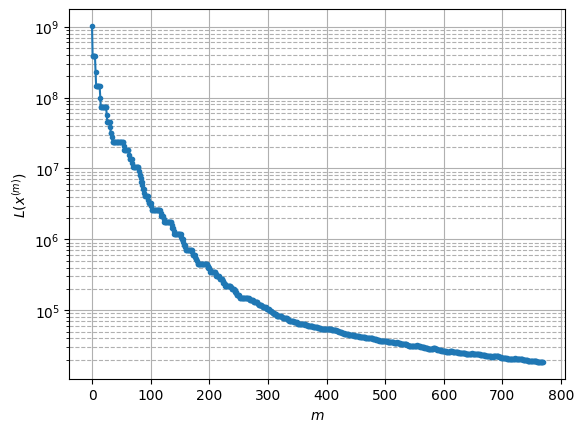

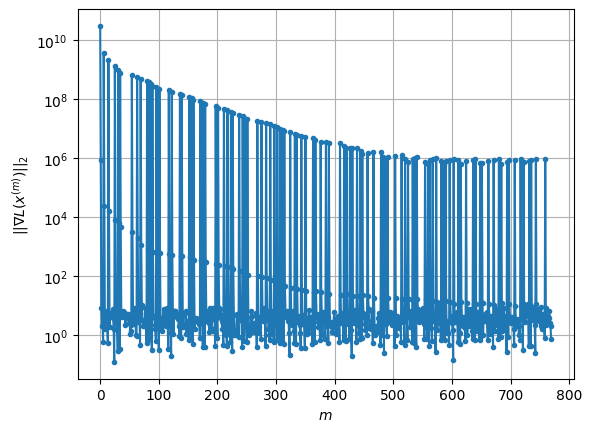

Windows:   7%|▋         | 21/296 [29:26<6:56:43, 90.92s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 19331.88873713644
Gradient norm: 828010.7459012521
Deviation from touching point norm = 0.0
Global relative error: 67.74417108545497
Position relative errors: 0.05496284715937028 m, 28.16079648313613 m, 33.002187160059236 m, 52.02953261456279 m

Iteration 1
Cost function: 19046.607014612717 (-1.48%)
Gradient norm: 10.324306355068016 (-100.00%)
Deviation from touching point norm = 1.4364881294725684 (1436488129472.57%)
Global relative error = 66.42243298883916 (-1.95%)
Position relative errors: 0.056306413769399606 m, 27.43938051566524 m, 32.31687833362822 m, 51.13329395908785 m

Iteration 2
Cost function: 19046.607011014912 (-0.00%)
Gradient norm: 4.241018336628702 (-58.92%)
Deviation from touching point norm = 1.436488107881024 (-0.00%)
Global relative error = 66.42243297651528 (-0.00%)
Position relative errors: 0.056306409342588966 m, 27.439380606527866 m, 32.31687822772884 m, 51.133293961254005 m

It

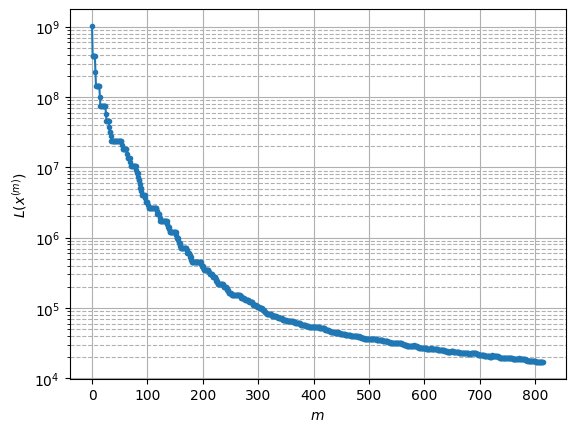

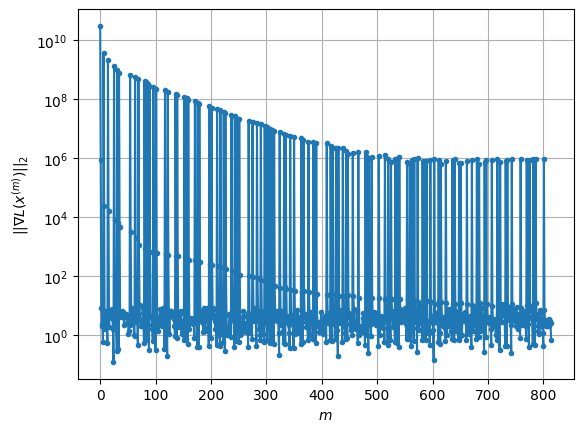

Windows:   7%|▋         | 22/296 [31:11<7:14:14, 95.09s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 17582.846948621976
Gradient norm: 875471.3179047535
Deviation from touching point norm = 0.0
Global relative error: 66.6486169551271
Position relative errors: 0.05319687125786274 m, 21.022571487245997 m, 34.814729270171505 m, 52.80151908559642 m

Iteration 1
Cost function: 17318.73840046471 (-1.50%)
Gradient norm: 10.390516173597485 (-100.00%)
Deviation from touching point norm = 1.3964774675393195 (1396477467539.32%)
Global relative error = 65.42751983917928 (-1.83%)
Position relative errors: 0.056723383147301645 m, 20.329141911269165 m, 34.14330527630478 m, 51.97785063723758 m

Iteration 2
Cost function: 17318.73840057854 (0.00%)
Gradient norm: 3.8072623365267306 (-63.36%)
Deviation from touching point norm = 1.3964774479461135 (-0.00%)
Global relative error = 65.4275198223456 (-0.00%)
Position relative errors: 0.056723383363683905 m, 20.329141976009897 m, 34.14330518561432 m, 51.97785065029937 m

Ite

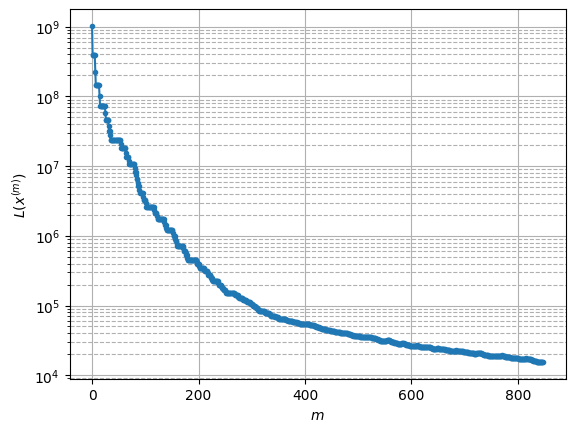

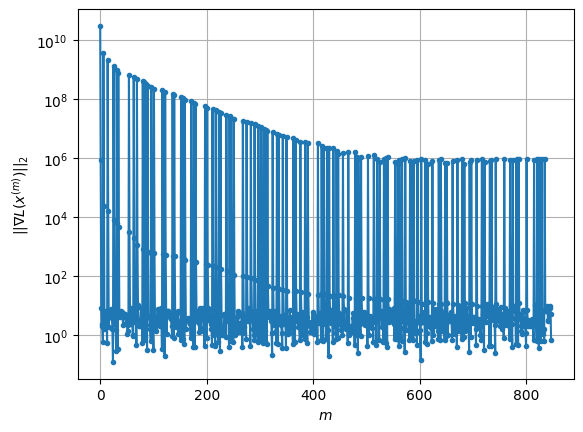

Windows:   8%|▊         | 23/296 [32:27<6:47:40, 89.60s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 15947.289726790223
Gradient norm: 965608.5600598623
Deviation from touching point norm = 0.0
Global relative error: 66.58979774242792
Position relative errors: 0.05418170566415076 m, 13.998049857057735 m, 36.5002824713538 m, 53.90698244433215 m

Iteration 1
Cost function: 15706.083850178025 (-1.51%)
Gradient norm: 9.318814726601586 (-100.00%)
Deviation from touching point norm = 1.3246154357987845 (1324615435798.78%)
Global relative error = 65.49319552021348 (-1.65%)
Position relative errors: 0.06252841101734752 m, 13.338890466028705 m, 35.85841729750856 m, 53.15621621890773 m

STOP on Iteration 2
Cost function = 15706.083848234559 (-0.00%)
Gradient norm = 0.7317487598534251 (-92.15%)
Deviation from touching point norm = 1.3246154202495093 (-0.00%)
Global relative error = 65.4931955024022 (-0.00%)
Final position relative errors: 0.06252840799985264 m, 13.33889051102712 m, 35.85841722363562 m, 53.1562162

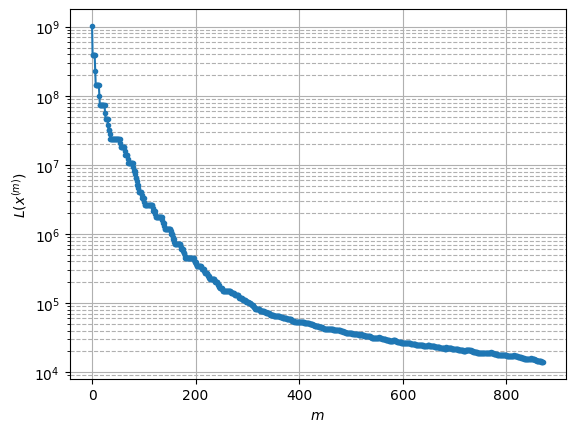

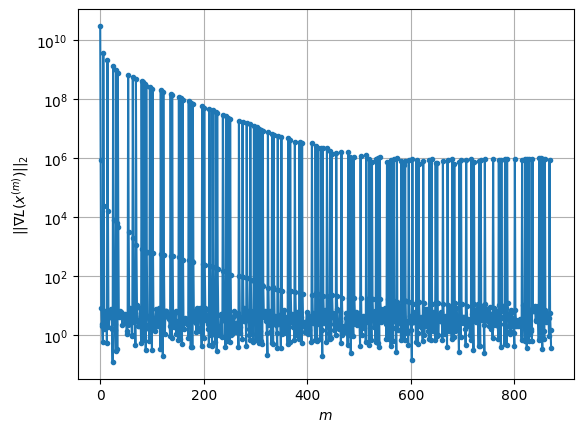

Windows:   8%|▊         | 24/296 [33:23<5:59:42, 79.35s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 14312.509900014255
Gradient norm: 931960.632540889
Deviation from touching point norm = 0.0
Global relative error: 67.51121276782523
Position relative errors: 0.06027118584540029 m, 7.354732695961689 m, 38.11668548505372 m, 55.233762093035196 m

Iteration 1
Cost function: 14102.452520334375 (-1.47%)
Gradient norm: 7.850337869208769 (-100.00%)
Deviation from touching point norm = 1.2434281598455283 (1243428159845.53%)
Global relative error = 66.54665798615459 (-1.43%)
Position relative errors: 0.07865648982632333 m, 6.7896775842458 m, 37.51037598698793 m, 54.54636224224802 m

Iteration 2
Cost function: 14102.452523805756 (0.00%)
Gradient norm: 1.5387127522634405 (-80.40%)
Deviation from touching point norm = 1.243428150598062 (-0.00%)
Global relative error = 66.54665797877965 (-0.00%)
Position relative errors: 0.07865648760968566 m, 6.789677611834606 m, 37.51037593159353 m, 54.54636226791281 m

Iteration

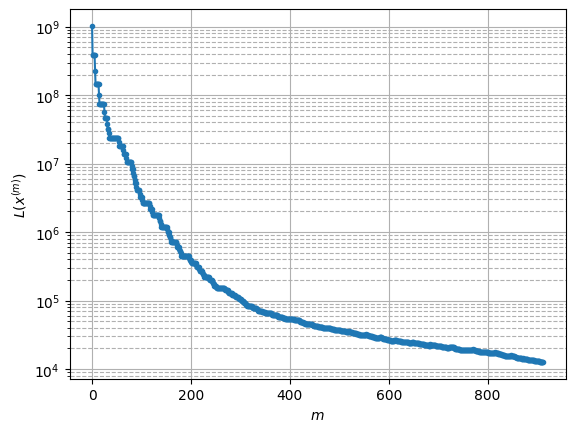

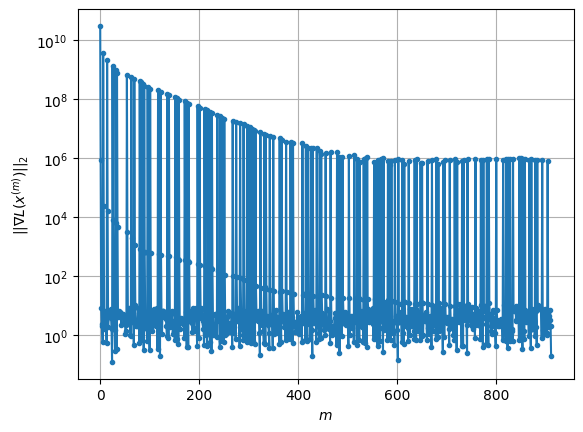

Windows:   8%|▊         | 25/296 [34:57<6:18:25, 83.78s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 12818.06670746719
Gradient norm: 863582.9029167765
Deviation from touching point norm = 0.0
Global relative error: 69.28939029153153
Position relative errors: 0.0760389098527167 m, 3.5350203898631807 m, 39.7110828363506 m, 56.670370603746946 m

Iteration 1
Cost function: 12641.486252676032 (-1.38%)
Gradient norm: 6.227238706239013 (-100.00%)
Deviation from touching point norm = 1.1242480645463184 (1124248064546.32%)
Global relative error = 68.46292634296464 (-1.19%)
Position relative errors: 0.07559174228104465 m, 3.56626368011633 m, 39.14785137004488 m, 56.0524548482506 m

STOP on Iteration 2
Cost function = 12641.4862551855 (0.00%)
Gradient norm = 0.5356309813612823 (-91.40%)
Deviation from touching point norm = 1.1242480550008276 (-0.00%)
Global relative error = 68.46292634222473 (-0.00%)
Final position relative errors: 0.07559173472143699 m, 3.566263679823875 m, 39.147851327251225 m, 56.052454877263

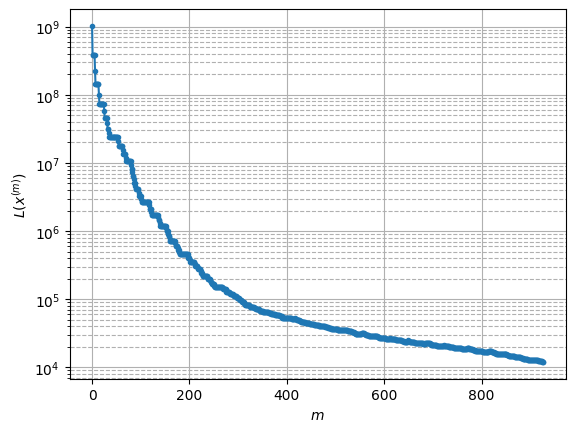

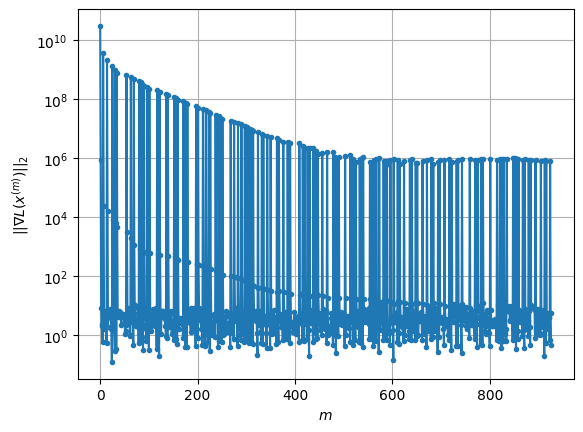

Windows:   9%|▉         | 26/296 [35:29<5:07:48, 68.40s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 12006.57111402535
Gradient norm: 840553.9571794354
Deviation from touching point norm = 0.0
Global relative error: 73.1772925541898
Position relative errors: 0.07277789251819958 m, 6.963427388222348 m, 42.320892693657804 m, 59.29037396463623 m

Iteration 1
Cost function: 11841.208250301284 (-1.38%)
Gradient norm: 6.853468594714454 (-100.00%)
Deviation from touching point norm = 1.1185562736930226 (1118556273693.02%)
Global relative error = 72.42334021961864 (-1.03%)
Position relative errors: 0.08434623347696561 m, 7.3834119996537835 m, 41.765675103537646 m, 58.70461353658141 m

Iteration 2
Cost function: 11841.20825064485 (0.00%)
Gradient norm: 5.865805490290894 (-14.41%)
Deviation from touching point norm = 1.1185562703259337 (-0.00%)
Global relative error = 72.42334023045379 (0.00%)
Position relative errors: 0.08434623232848679 m, 7.383412000275662 m, 41.76567506728445 m, 58.70461357566433 m

Iteratio

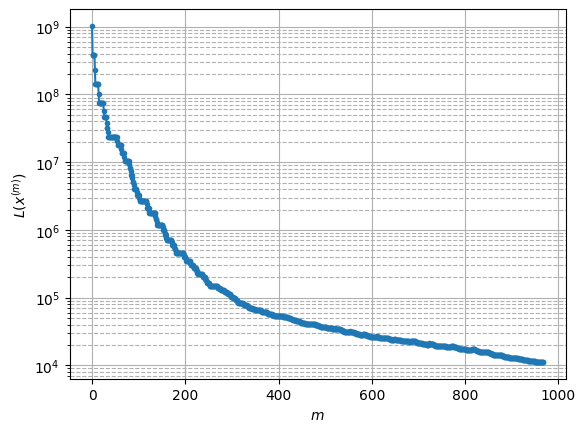

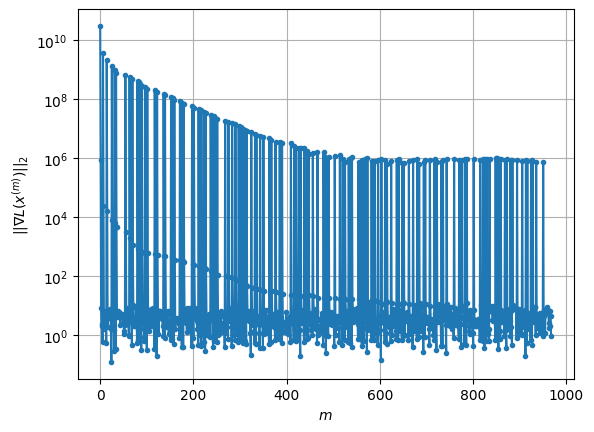

Windows:   9%|▉         | 27/296 [37:03<5:40:59, 76.06s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 11237.243255761132
Gradient norm: 733394.4902334807
Deviation from touching point norm = 0.0
Global relative error: 77.23512648498614
Position relative errors: 0.08124994140462467 m, 11.986740796093192 m, 44.77661532886477 m, 61.778775855019006 m

Iteration 1
Cost function: 11089.605738434188 (-1.31%)
Gradient norm: 5.67647465010042 (-100.00%)
Deviation from touching point norm = 1.0593013447165376 (1059301344716.54%)
Global relative error = 76.56060033362648 (-0.87%)
Position relative errors: 0.07408535276914993 m, 12.424805146448923 m, 44.23630373526651 m, 61.23952942368316 m

Iteration 2
Cost function: 11089.605743874588 (0.00%)
Gradient norm: 1.1586647296548767 (-79.59%)
Deviation from touching point norm = 1.0593013364333066 (-0.00%)
Global relative error = 76.56060035257694 (0.00%)
Position relative errors: 0.07408534568058245 m, 12.424805151517873 m, 44.236303704415896 m, 61.23952946863953 m

Ite

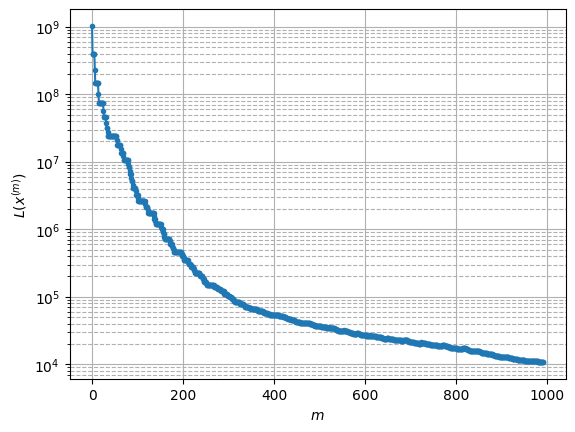

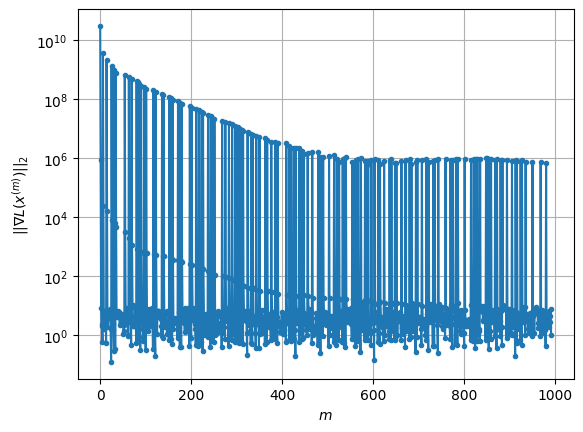

Windows:   9%|▉         | 28/296 [37:58<5:11:15, 69.69s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 10743.355225893001
Gradient norm: 646059.3832334115
Deviation from touching point norm = 0.0
Global relative error: 81.98529676005468
Position relative errors: 0.0706706337573762 m, 16.664902578150684 m, 47.59003366068952 m, 64.6455035299339 m

Iteration 1
Cost function: 10601.721701163238 (-1.32%)
Gradient norm: 7.52725920790053 (-100.00%)
Deviation from touching point norm = 1.0712776828143158 (1071277682814.32%)
Global relative error = 81.36141952523765 (-0.76%)
Position relative errors: 0.06183860609340927 m, 17.083439425156072 m, 47.04672781361621 m, 64.14379029449431 m

Iteration 2
Cost function: 10601.721699524203 (-0.00%)
Gradient norm: 3.473154970949908 (-53.86%)
Deviation from touching point norm = 1.0712776850372945 (0.00%)
Global relative error = 81.36141954832088 (0.00%)
Position relative errors: 0.06183860108621807 m, 17.08343942916381 m, 47.04672778357588 m, 64.14379034474415 m

Iteration

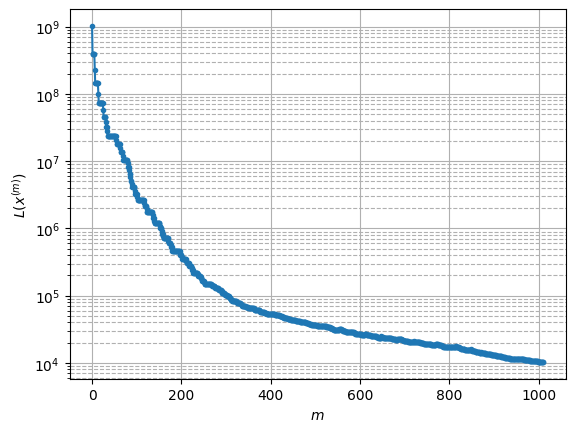

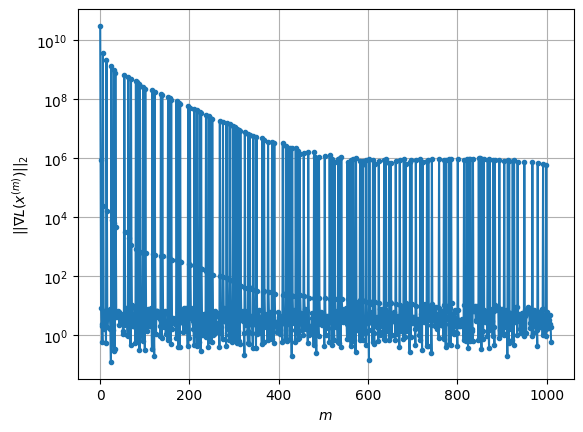

Windows:  10%|▉         | 29/296 [38:42<4:35:47, 61.98s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 10268.012748535719
Gradient norm: 554334.567950518
Deviation from touching point norm = 0.0
Global relative error: 86.62141566117205
Position relative errors: 0.05863696164275854 m, 21.2546114367461 m, 50.20411470788932 m, 67.3130254452432 m

Iteration 1
Cost function: 10140.935029983795 (-1.24%)
Gradient norm: 5.331248701991629 (-100.00%)
Deviation from touching point norm = 0.9974043279414074 (997404327941.41%)
Global relative error = 86.05238427954251 (-0.66%)
Position relative errors: 0.061174866145547326 m, 21.644504582362252 m, 49.66816766408041 m, 66.85496621492544 m

STOP on Iteration 2
Cost function = 10140.935030584806 (0.00%)
Gradient norm = 0.34893946092497186 (-93.45%)
Deviation from touching point norm = 0.9974043352847908 (0.00%)
Global relative error = 86.05238430368601 (0.00%)
Final position relative errors: 0.06117487007241548 m, 21.64450458758578 m, 49.66816763656818 m, 66.85496626474

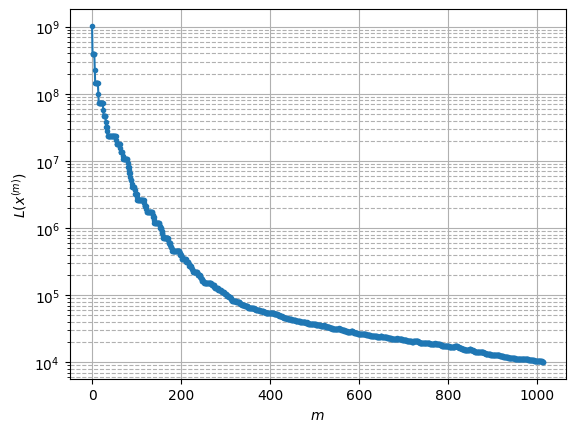

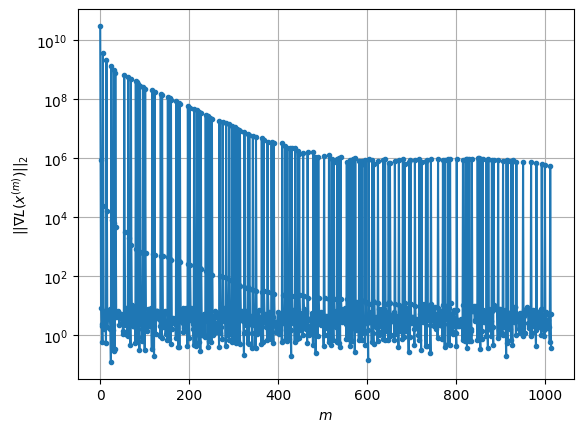

Windows:  10%|█         | 30/296 [38:50<3:22:22, 45.65s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 10048.276206881954
Gradient norm: 476223.77014325967
Deviation from touching point norm = 0.0
Global relative error: 91.63073792459012
Position relative errors: 0.058469717835956864 m, 25.32319455047154 m, 53.13831070255139 m, 70.22274949460098 m

Iteration 1
Cost function: 9917.59249703148 (-1.30%)
Gradient norm: 8.429607361013943 (-100.00%)
Deviation from touching point norm = 1.056367878437043 (1056367878437.04%)
Global relative error = 91.08447202391517 (-0.60%)
Position relative errors: 0.0680860766569551 m, 25.696671463346146 m, 52.595899959292694 m, 69.78337129699564 m

STOP on Iteration 2
Cost function = 9917.592496883019 (-0.00%)
Gradient norm = 0.8324039909696738 (-90.13%)
Deviation from touching point norm = 1.0563678864921529 (0.00%)
Global relative error = 91.08447205308535 (0.00%)
Final position relative errors: 0.0680860851167976 m, 25.69667147171116 m, 52.59589993003277 m, 69.78337135403

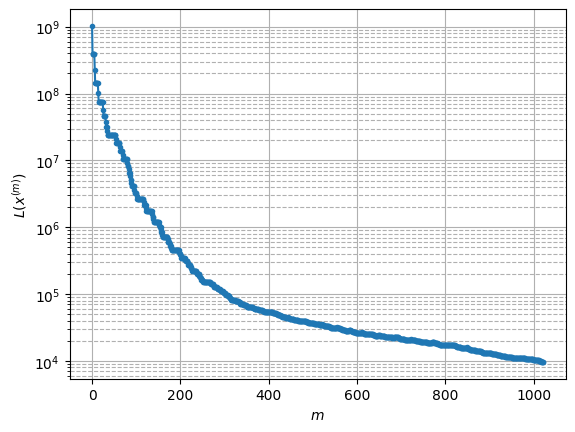

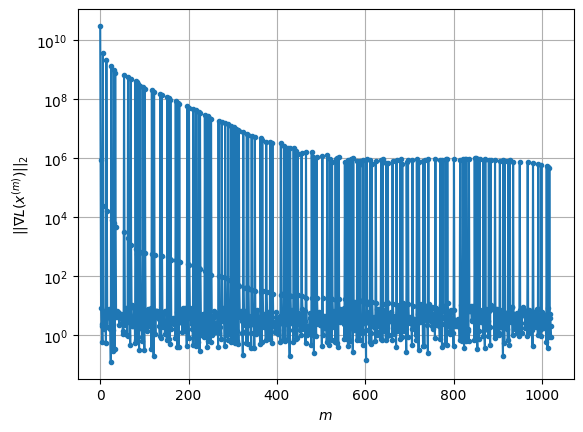

Windows:  10%|█         | 31/296 [39:09<2:46:07, 37.61s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 9566.30336898771
Gradient norm: 474885.7231783472
Deviation from touching point norm = 0.0
Global relative error: 95.83112518531483
Position relative errors: 0.06484112755009619 m, 29.613774506415083 m, 55.334178157598465 m, 72.42061025306865 m

Iteration 1
Cost function: 9449.532221942975 (-1.22%)
Gradient norm: 7.023814094524906 (-100.00%)
Deviation from touching point norm = 0.972507797703956 (972507797703.96%)
Global relative error = 95.33205170454893 (-0.52%)
Position relative errors: 0.07150364761966611 m, 29.948829548462964 m, 54.809204843265576 m, 72.02225369413398 m

Iteration 2
Cost function: 9449.532220201347 (-0.00%)
Gradient norm: 5.370998109134036 (-23.53%)
Deviation from touching point norm = 0.9725078026244706 (0.00%)
Global relative error = 95.33205173152461 (0.00%)
Position relative errors: 0.07150364886616033 m, 29.948829556311477 m, 54.80920481504936 m, 72.02225374804797 m

Iteration

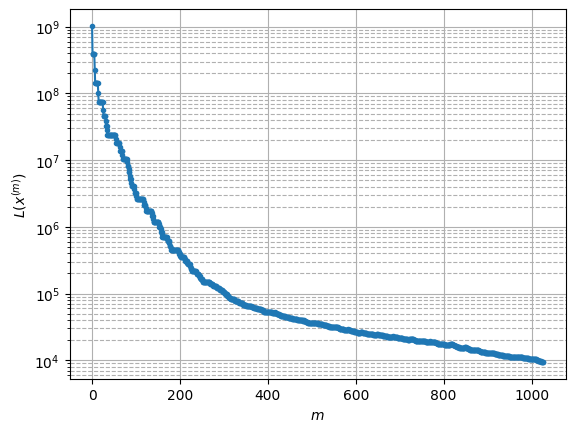

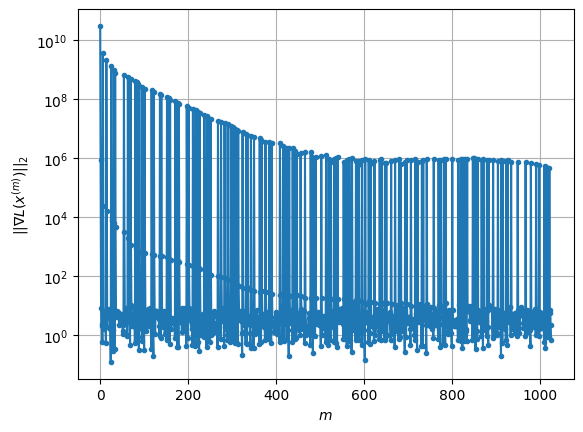

Windows:  11%|█         | 32/296 [39:20<2:11:27, 29.88s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 9294.184094173406
Gradient norm: 495053.7573145747
Deviation from touching point norm = 0.0
Global relative error: 100.24721826082214
Position relative errors: 0.06840118076327709 m, 33.371278264078335 m, 57.83682089848059 m, 74.77133528533167 m

Iteration 1
Cost function: 9173.548984812685 (-1.30%)
Gradient norm: 5.632099906147918 (-100.00%)
Deviation from touching point norm = 1.0108733005782342 (1010873300578.23%)
Global relative error = 99.77364578357114 (-0.47%)
Position relative errors: 0.05691990031706633 m, 33.681701585363335 m, 57.30704731688264 m, 74.40574602080504 m

Iteration 2
Cost function: 9173.548982675462 (-0.00%)
Gradient norm: 2.0266487318069615 (-64.02%)
Deviation from touching point norm = 1.0108733183122607 (0.00%)
Global relative error = 99.77364580825599 (0.00%)
Position relative errors: 0.05691989682332072 m, 33.68170159384758 m, 57.307047286200856 m, 74.40574607369896 m

STOP o

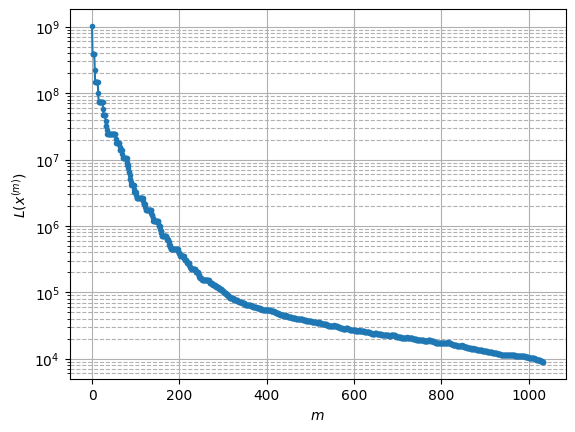

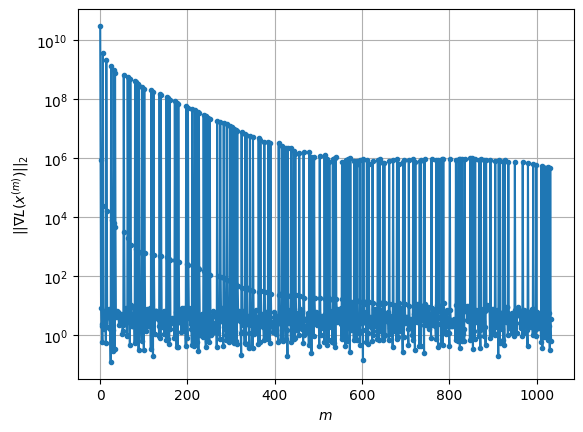

Windows:  11%|█         | 33/296 [39:37<1:52:55, 25.76s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 8840.995773342109
Gradient norm: 590083.8302083552
Deviation from touching point norm = 0.0
Global relative error: 103.85362484789238
Position relative errors: 0.0525189470906709 m, 37.23885776454899 m, 59.59775543379691 m, 76.46529527959666 m

Iteration 1
Cost function: 8733.324321569271 (-1.22%)
Gradient norm: 4.642933934216572 (-100.00%)
Deviation from touching point norm = 0.896502099063289 (896502099063.29%)
Global relative error = 103.41888989572077 (-0.42%)
Position relative errors: 0.06001149664424553 m, 37.50973266975894 m, 59.08714322380097 m, 76.13925659260414 m

STOP on Iteration 2
Cost function = 8733.32432194243 (0.00%)
Gradient norm = 0.3667071452723759 (-92.10%)
Deviation from touching point norm = 0.8965021215597087 (0.00%)
Global relative error = 103.4188899140779 (0.00%)
Final position relative errors: 0.060011496428950796 m, 37.509732677118706 m, 59.087143192313064 m, 76.139256638348

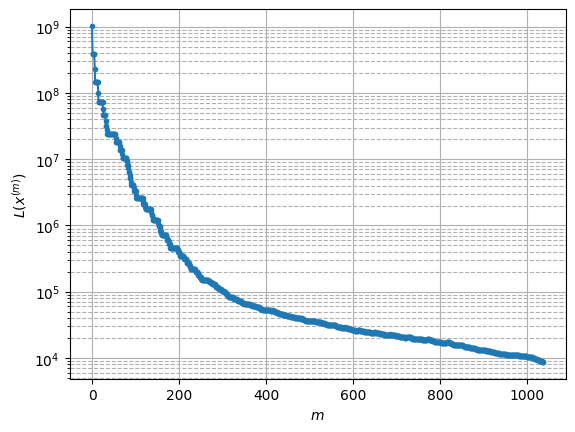

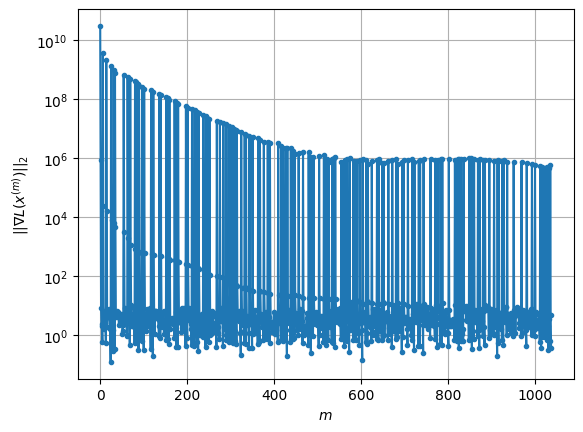

Windows:  11%|█▏        | 34/296 [39:44<1:28:25, 20.25s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 8647.0448279904
Gradient norm: 781475.6445289701
Deviation from touching point norm = 0.0
Global relative error: 107.54763380727752
Position relative errors: 0.05738671315302864 m, 40.594307287738886 m, 61.639257011845714 m, 78.22524694780861 m

Iteration 1
Cost function: 8536.010958879879 (-1.28%)
Gradient norm: 4.284529826190251 (-100.00%)
Deviation from touching point norm = 0.9015428493844901 (901542849384.49%)
Global relative error = 107.13326809354483 (-0.39%)
Position relative errors: 0.06394623540232185 m, 40.83854193459986 m, 61.13603101095778 m, 77.92385430785941 m

Iteration 2
Cost function: 8536.010958697816 (-0.00%)
Gradient norm: 2.6060360696767315 (-39.18%)
Deviation from touching point norm = 0.9015428699584724 (0.00%)
Global relative error = 107.13326810928339 (0.00%)
Position relative errors: 0.06394623712822885 m, 40.83854194312956 m, 61.136030977858525 m, 77.9238543509942 m

Iteratio

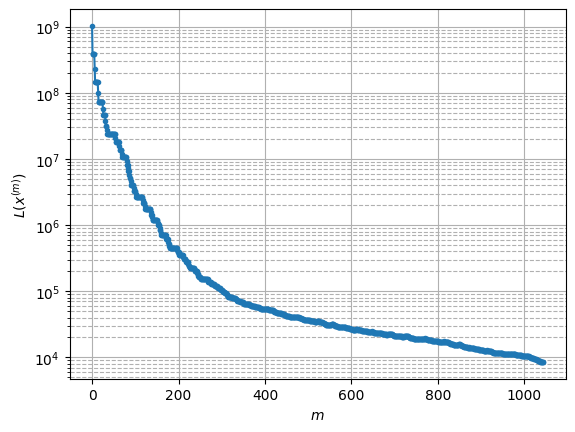

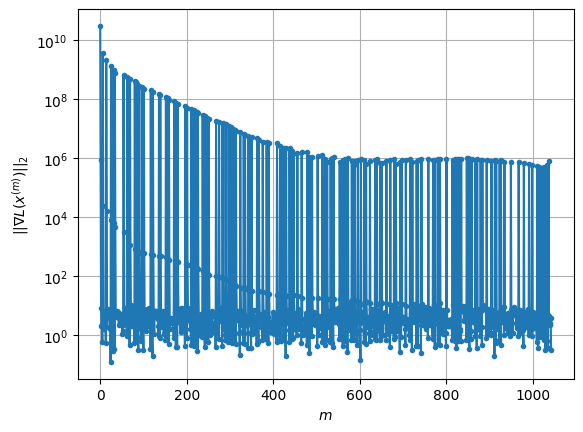

Windows:  12%|█▏        | 35/296 [40:01<1:23:38, 19.23s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 8452.119848747294
Gradient norm: 923518.6078135532
Deviation from touching point norm = 0.0
Global relative error: 110.83202374956045
Position relative errors: 0.06092204689998616 m, 43.73412549559502 m, 63.4346679720377 m, 79.66868106643437 m

Iteration 1
Cost function: 8341.340457238339 (-1.31%)
Gradient norm: 5.235371773888615 (-100.00%)
Deviation from touching point norm = 0.8694719394340115 (869471939434.01%)
Global relative error = 110.43605374017135 (-0.36%)
Position relative errors: 0.0541551350429417 m, 43.955770118915545 m, 62.93849943795442 m, 79.38986338036995 m

Iteration 2
Cost function: 8341.340459001816 (0.00%)
Gradient norm: 1.8936497089371838 (-63.83%)
Deviation from touching point norm = 0.8694719657804874 (0.00%)
Global relative error = 110.43605375081944 (0.00%)
Position relative errors: 0.05415513301308515 m, 43.95577012734977 m, 62.938499402661435 m, 79.38986341849316 m

STOP on I

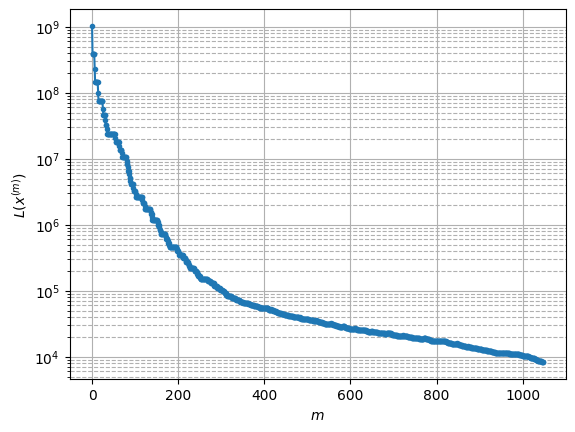

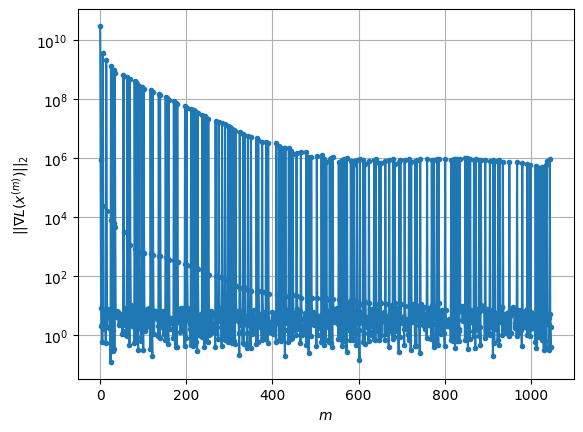

Windows:  12%|█▏        | 36/296 [40:11<1:11:04, 16.40s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 8297.210881598225
Gradient norm: 1085130.2733634792
Deviation from touching point norm = 0.0
Global relative error: 113.6865259096499
Position relative errors: 0.051862156845431724 m, 46.64752880371677 m, 64.9764893805508 m, 80.78789552646803 m

Iteration 1
Cost function: 8185.334797724825 (-1.35%)
Gradient norm: 4.124446935889905 (-100.00%)
Deviation from touching point norm = 0.8332658867417937 (833265886741.79%)
Global relative error = 113.30767602786494 (-0.33%)
Position relative errors: 0.053501251489330354 m, 46.846060008284375 m, 64.49087680180601 m, 80.52947759483726 m

Iteration 2
Cost function: 8185.334798462722 (0.00%)
Gradient norm: 1.2421215495469673 (-69.88%)
Deviation from touching point norm = 0.8332659123321604 (0.00%)
Global relative error = 113.30767603401661 (0.00%)
Position relative errors: 0.05350125404820207 m, 46.846060017022154 m, 64.49087676362373 m, 80.52947762898586 m

Iterat

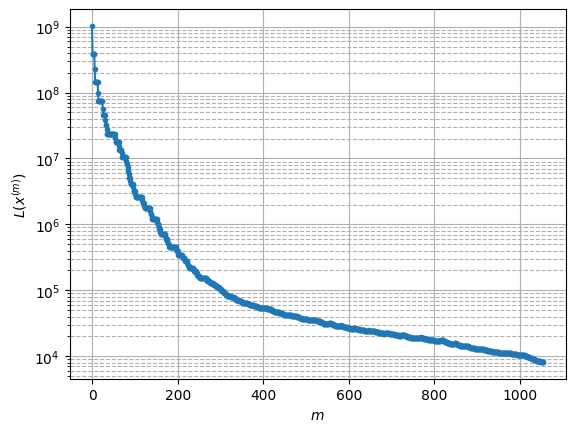

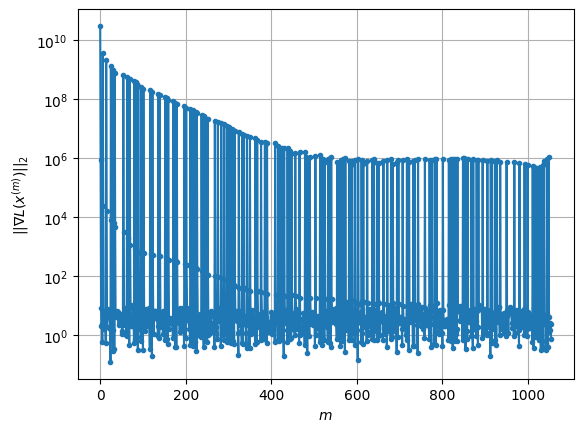

Windows:  12%|█▎        | 37/296 [40:27<1:11:09, 16.48s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 8165.907937307494
Gradient norm: 1187302.2348577445
Deviation from touching point norm = 0.0
Global relative error: 116.09467811534878
Position relative errors: 0.0512035324051184 m, 49.32026337555079 m, 66.26230385334735 m, 81.57688308560118 m

Iteration 1
Cost function: 8054.6044345393 (-1.36%)
Gradient norm: 3.552438113929112 (-100.00%)
Deviation from touching point norm = 0.7955386930067093 (795538693006.71%)
Global relative error = 115.7299493706481 (-0.31%)
Position relative errors: 0.058820092608342325 m, 49.4969252329603 m, 65.78809329525625 m, 81.3350870387306 m

STOP on Iteration 2
Cost function = 8054.604434417609 (-0.00%)
Gradient norm = 0.8554400594864696 (-75.92%)
Deviation from touching point norm = 0.7955387259715659 (0.00%)
Global relative error = 115.7299493729918 (0.00%)
Final position relative errors: 0.05882008471737527 m, 49.49692524341168 m, 65.78809325402287 m, 81.33508706906258 

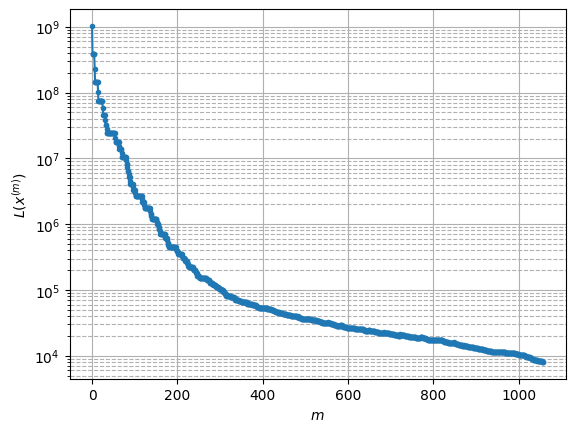

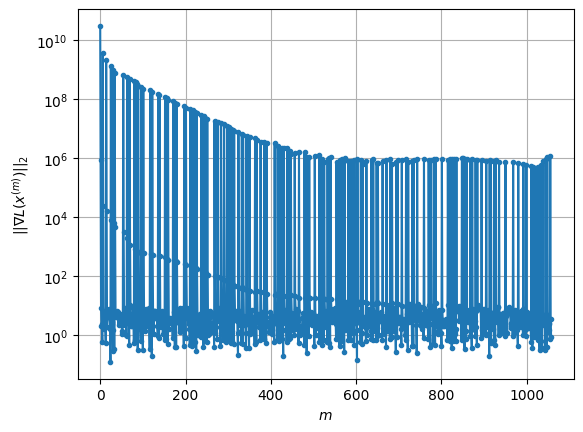

Windows:  13%|█▎        | 38/296 [40:35<59:10, 13.76s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 8017.56365715463
Gradient norm: 1297010.3271572478
Deviation from touching point norm = 0.0
Global relative error: 118.0411384122943
Position relative errors: 0.055821244554676186 m, 51.741087428238544 m, 67.2880614494808 m, 82.02976315182495 m

Iteration 1
Cost function: 7908.080555676236 (-1.37%)
Gradient norm: 3.2048048346226112 (-100.00%)
Deviation from touching point norm = 0.7605256938710689 (760525693871.07%)
Global relative error = 117.69056816755986 (-0.30%)
Position relative errors: 0.05251818097011824 m, 51.89752764568744 m, 66.82780603219545 m, 81.8031551535632 m

Iteration 2
Cost function: 7908.08055463588 (-0.00%)
Gradient norm: 2.051173418691783 (-36.00%)
Deviation from touching point norm = 0.7605257265911739 (0.00%)
Global relative error = 117.69056816707749 (-0.00%)
Position relative errors: 0.052518176653749096 m, 51.89752765572089 m, 66.82780598934855 m, 81.80315518150967 m

STOP on 

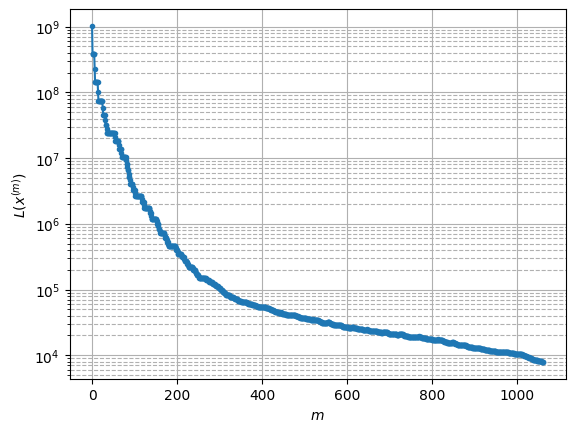

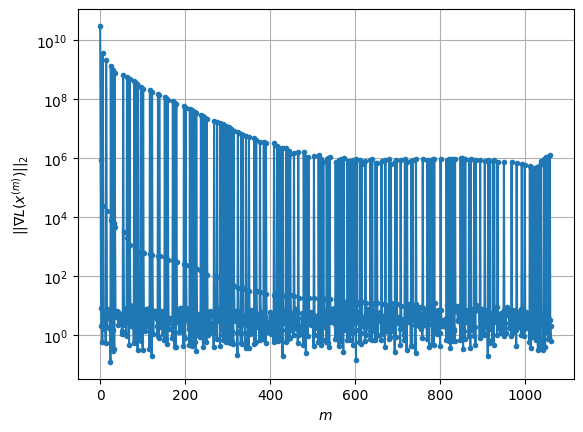

Windows:  13%|█▎        | 39/296 [40:45<54:12, 12.66s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7895.946299159691
Gradient norm: 1311007.9398710984
Deviation from touching point norm = 0.0
Global relative error: 119.51631624694421
Position relative errors: 0.049845469591091866 m, 53.90043509240866 m, 68.05259752619412 m, 82.14458658892445 m

Iteration 1
Cost function: 7789.162306869977 (-1.35%)
Gradient norm: 2.3348690241000063 (-100.00%)
Deviation from touching point norm = 0.722670780325519 (722670780325.52%)
Global relative error = 119.17883840900068 (-0.28%)
Position relative errors: 0.053672794174982844 m, 54.03673571377636 m, 67.61039694976856 m, 81.92958405388558 m

Iteration 2
Cost function: 7789.162307903113 (0.00%)
Gradient norm: 2.7383498024245303 (17.28%)
Deviation from touching point norm = 0.7226708039782694 (0.00%)
Global relative error = 119.17883840602248 (-0.00%)
Position relative errors: 0.05367279718261172 m, 54.036735725207855 m, 67.61039690445642 m, 81.92958407940445 m

STOP 

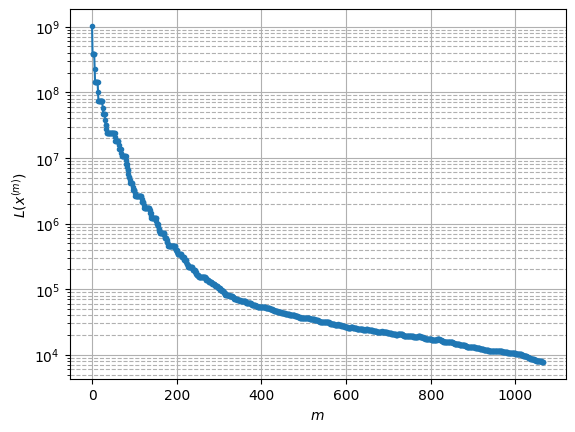

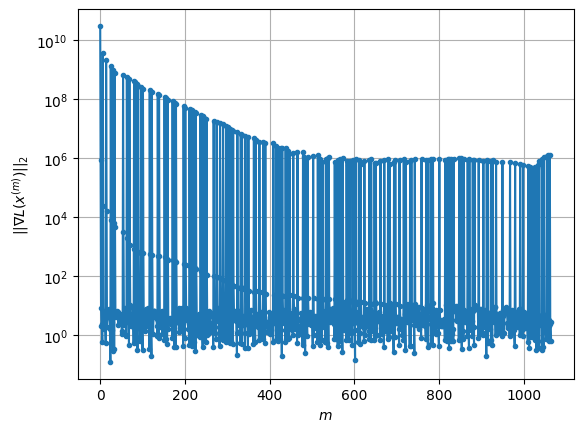

Windows:  14%|█▎        | 40/296 [40:54<50:05, 11.74s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7758.15115225787
Gradient norm: 1304164.9338149666
Deviation from touching point norm = 0.0
Global relative error: 120.51216306139068
Position relative errors: 0.050488533168824956 m, 55.78841509535591 m, 68.55739702192281 m, 81.9189478668918 m

Iteration 1
Cost function: 7656.555752776916 (-1.31%)
Gradient norm: 4.089420222962866 (-100.00%)
Deviation from touching point norm = 0.6754407626326044 (675440762632.60%)
Global relative error = 120.1865946555238 (-0.27%)
Position relative errors: 0.047846697807147655 m, 55.90747437627242 m, 68.12953846040962 m, 81.71618334197657 m

Iteration 2
Cost function: 7656.555753254104 (0.00%)
Gradient norm: 3.4752774113283484 (-15.02%)
Deviation from touching point norm = 0.6754407960367828 (0.00%)
Global relative error = 120.1865946535464 (-0.00%)
Position relative errors: 0.047846711894776475 m, 55.90747438998628 m, 68.12953841465874 m, 81.71618336782146 m

Iteratio

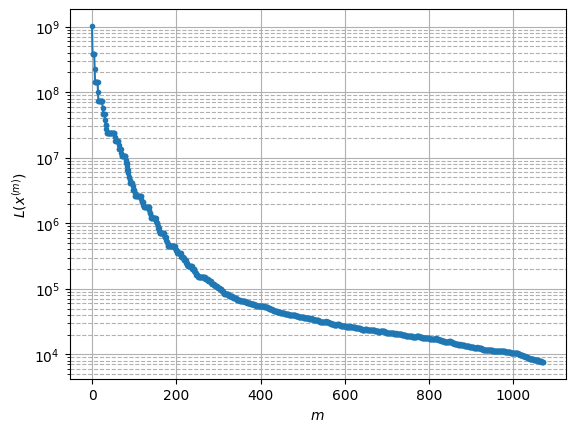

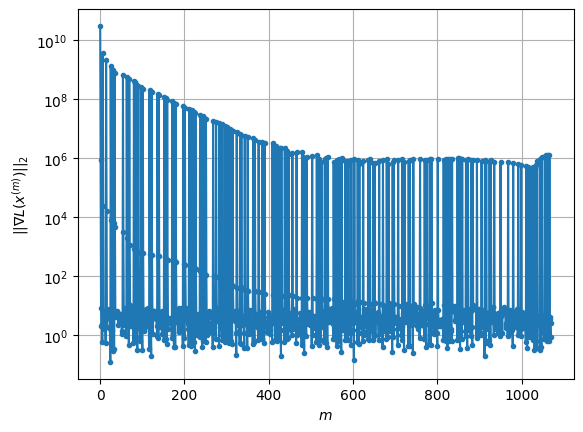

Windows:  14%|█▍        | 41/296 [41:06<49:51, 11.73s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7634.851308317044
Gradient norm: 1285959.0530892494
Deviation from touching point norm = 0.0
Global relative error: 121.02302449507737
Position relative errors: 0.0449058625708526 m, 57.39924024942229 m, 68.79726096490398 m, 81.3562158905846 m

Iteration 1
Cost function: 7537.797874826612 (-1.27%)
Gradient norm: 2.979905584684413 (-100.00%)
Deviation from touching point norm = 0.6417256213434251 (641725621343.43%)
Global relative error = 120.70979785834324 (-0.26%)
Position relative errors: 0.04059385844537132 m, 57.500140305900956 m, 68.38897596469235 m, 81.16362986204625 m

Iteration 2
Cost function: 7537.797876493912 (0.00%)
Gradient norm: 3.097367100138828 (3.94%)
Deviation from touching point norm = 0.6417256530158324 (0.00%)
Global relative error = 120.70979785701913 (-0.00%)
Position relative errors: 0.040593861674119165 m, 57.50014032142304 m, 68.38897591823557 m, 81.16362988822353 m

STOP on It

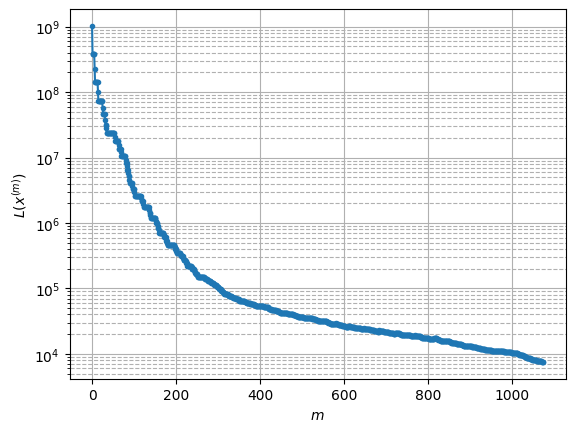

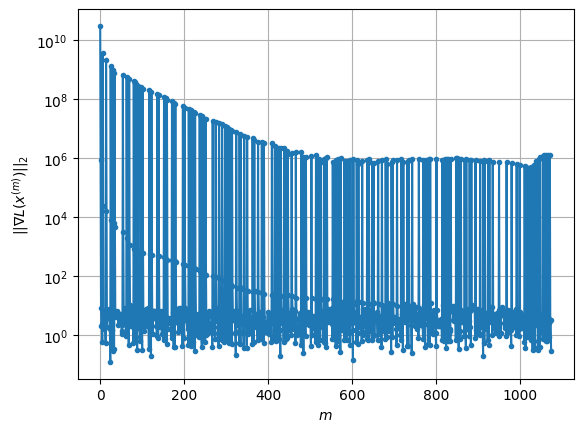

Windows:  14%|█▍        | 42/296 [41:16<46:56, 11.09s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7570.35874101788
Gradient norm: 1329242.585228923
Deviation from touching point norm = 0.0
Global relative error: 121.04729329556281
Position relative errors: 0.037973734624802 m, 58.724664626428755 m, 68.77706288291186 m, 80.45852711875298 m

Iteration 1
Cost function: 7473.772741255481 (-1.28%)
Gradient norm: 5.930780118393801 (-100.00%)
Deviation from touching point norm = 0.6042958178363388 (604295817836.34%)
Global relative error = 120.7469052888333 (-0.25%)
Position relative errors: 0.037545795162076664 m, 58.80779076276051 m, 68.39073416453786 m, 80.27555290218535 m

Iteration 2
Cost function: 7473.772741318937 (0.00%)
Gradient norm: 7.77221936753728 (31.05%)
Deviation from touching point norm = 0.6042958410996998 (0.00%)
Global relative error = 120.7469052889767 (0.00%)
Position relative errors: 0.03754579941719082 m, 58.80779077860359 m, 68.39073411787116 m, 80.2755529305505 m

Iteration 3
Cost

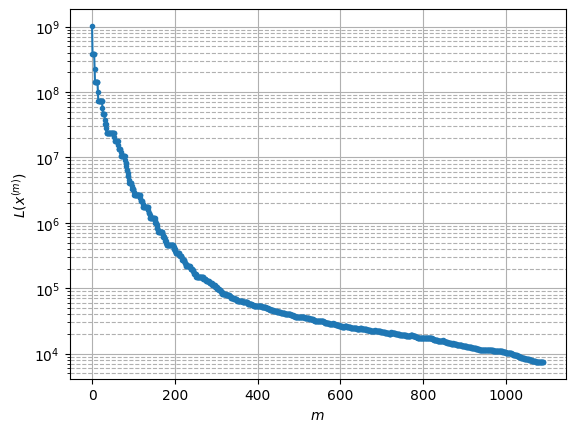

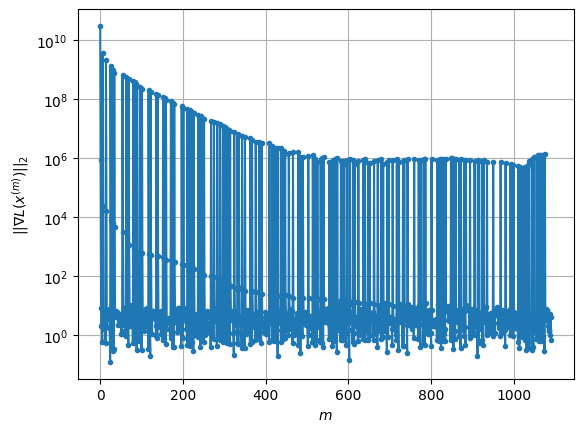

Windows:  15%|█▍        | 43/296 [41:53<1:19:58, 18.97s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7499.972966496891
Gradient norm: 1268169.252461154
Deviation from touching point norm = 0.0
Global relative error: 120.58581525023119
Position relative errors: 0.035118509648146265 m, 59.7591705532913 m, 68.49988803217278 m, 79.23095274973771 m

Iteration 1
Cost function: 7406.553762592489 (-1.25%)
Gradient norm: 3.1314555575042076 (-100.00%)
Deviation from touching point norm = 0.5673773732127395 (567377373212.74%)
Global relative error = 120.29793355963231 (-0.24%)
Position relative errors: 0.036889528003667106 m, 59.82642570680825 m, 68.13718724837193 m, 79.05512866082844 m

Iteration 2
Cost function: 7406.553762049902 (-0.00%)
Gradient norm: 3.3134995090854695 (5.81%)
Deviation from touching point norm = 0.5673773885772766 (0.00%)
Global relative error = 120.29793356111708 (0.00%)
Position relative errors: 0.0368895217765436 m, 59.82642572349325 m, 68.13718720064999 m, 79.05512869159533 m

STOP on I

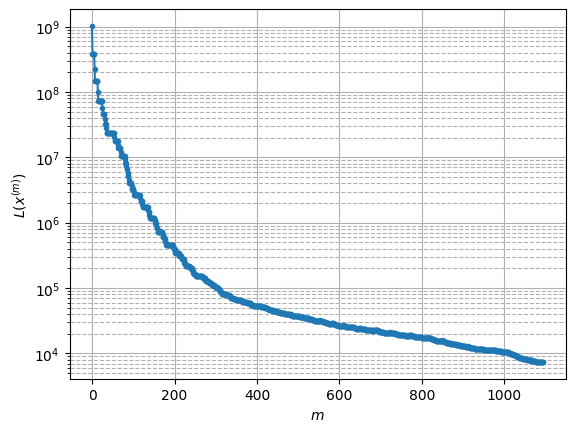

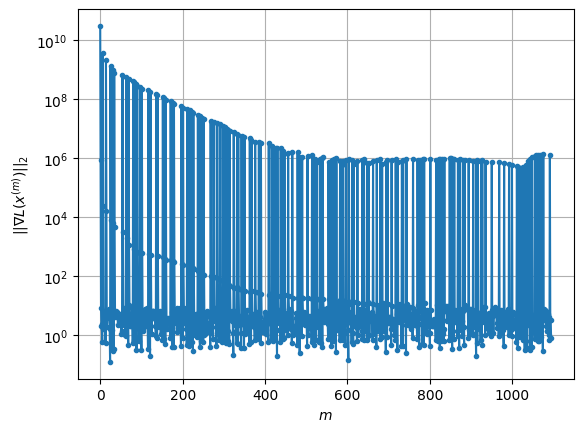

Windows:  15%|█▍        | 44/296 [42:03<1:07:55, 16.17s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7418.315651390507
Gradient norm: 1212315.5962621255
Deviation from touching point norm = 0.0
Global relative error: 119.64104872983069
Position relative errors: 0.03475770650394671 m, 60.5001155014432 m, 67.96921236186076 m, 77.6781870646599 m

Iteration 1
Cost function: 7329.032813781971 (-1.20%)
Gradient norm: 4.474539129423767 (-100.00%)
Deviation from touching point norm = 0.5339218805139124 (533921880513.91%)
Global relative error = 119.36574035823675 (-0.23%)
Position relative errors: 0.03563551042437608 m, 60.55240631353563 m, 67.63004787755906 m, 77.50974552985923 m

STOP on Iteration 2
Cost function = 7329.032814191662 (0.00%)
Gradient norm = 0.8769415012595424 (-80.40%)
Deviation from touching point norm = 0.5339219004862672 (0.00%)
Global relative error = 119.36574036316615 (0.00%)
Final position relative errors: 0.035635515293815326 m, 60.55240633096633 m, 67.63004782997965 m, 77.50974556534

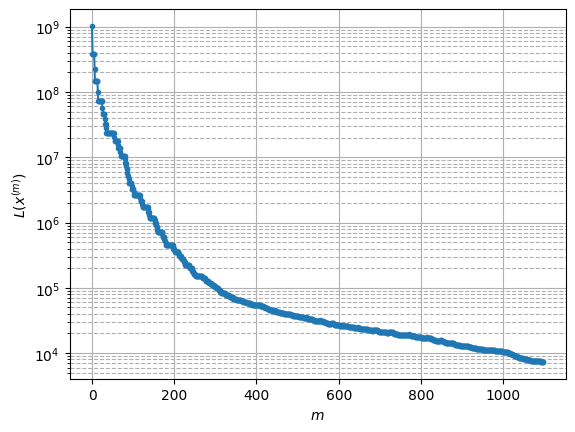

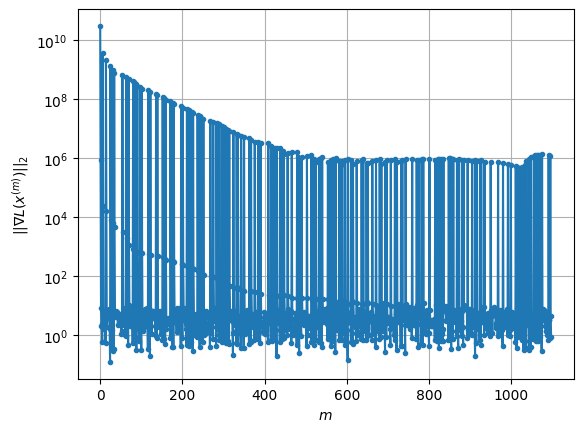

Windows:  15%|█▌        | 45/296 [42:10<56:43, 13.56s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7323.374967221028
Gradient norm: 1118008.1048564175
Deviation from touching point norm = 0.0
Global relative error: 118.21814526897623
Position relative errors: 0.03336137006484683 m, 60.94529445389097 m, 67.18783656143395 m, 75.80892669310306 m

Iteration 1
Cost function: 7239.429484523802 (-1.15%)
Gradient norm: 2.6579004126759327 (-100.00%)
Deviation from touching point norm = 0.5090787774260367 (509078777426.04%)
Global relative error = 117.95586878260836 (-0.22%)
Position relative errors: 0.030907694883934744 m, 60.983306780618065 m, 66.87327715886059 m, 75.64777625048652 m

STOP on Iteration 2
Cost function = 7239.42948295359 (-0.00%)
Gradient norm = 0.7655692674965036 (-71.20%)
Deviation from touching point norm = 0.5090787959576873 (0.00%)
Global relative error = 117.95586879070592 (0.00%)
Final position relative errors: 0.03090769700199801 m, 60.983306797189194 m, 66.87327711181439 m, 75.647776

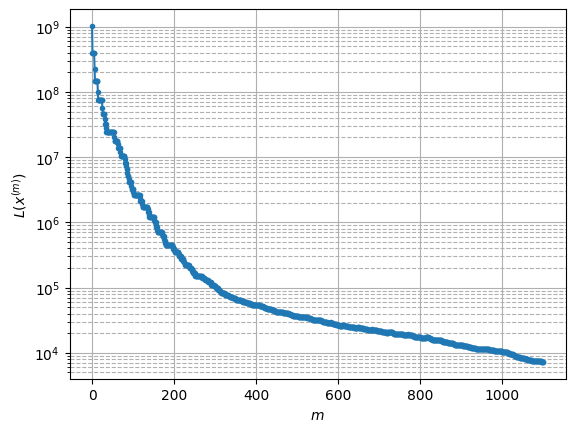

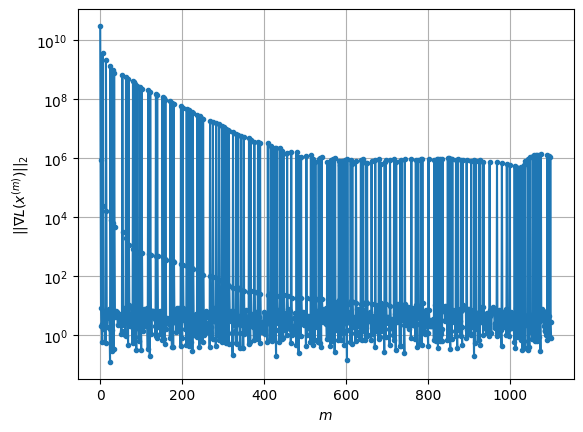

Windows:  16%|█▌        | 46/296 [42:18<49:19, 11.84s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7227.917934360791
Gradient norm: 1053602.1537946155
Deviation from touching point norm = 0.0
Global relative error: 116.3249190019013
Position relative errors: 0.02861253591241796 m, 61.093703163531465 m, 66.16074217713904 m, 73.63287348597305 m

Iteration 1
Cost function: 7148.207250062366 (-1.10%)
Gradient norm: 2.7329638027434755 (-100.00%)
Deviation from touching point norm = 0.49169587107403656 (491695871074.04%)
Global relative error = 116.07637505267122 (-0.21%)
Position relative errors: 0.029095494565390567 m, 61.11703202003014 m, 65.8715974809316 m, 73.48036157750542 m

Iteration 2
Cost function: 7148.207251029781 (0.00%)
Gradient norm: 2.66302669192767 (-2.56%)
Deviation from touching point norm = 0.4916958832822857 (0.00%)
Global relative error = 116.07637506198013 (0.00%)
Position relative errors: 0.029095491481938227 m, 61.11703203560838 m, 65.87159743415612 m, 73.48036162118667 m

Iteratio

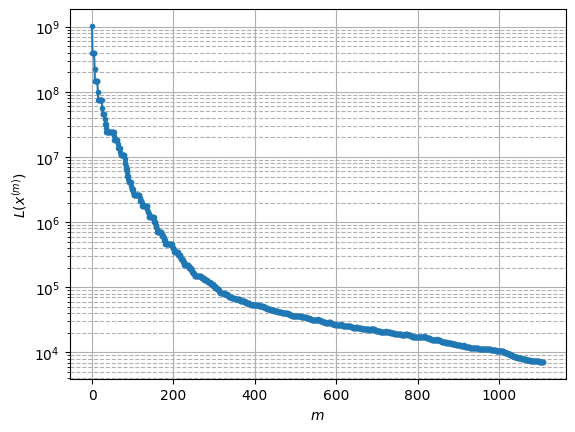

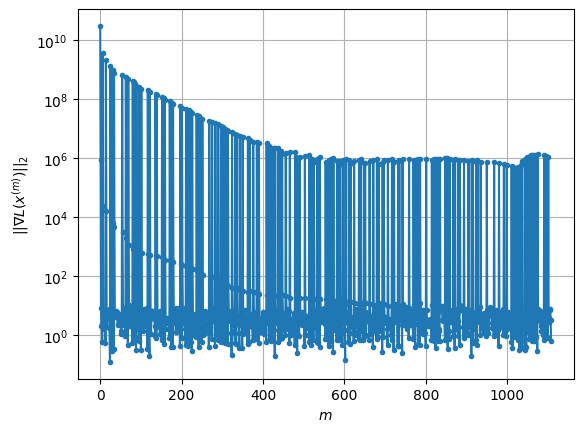

Windows:  16%|█▌        | 47/296 [42:37<57:51, 13.94s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7158.5628074616625
Gradient norm: 1068565.5593466472
Deviation from touching point norm = 0.0
Global relative error: 113.97155971093481
Position relative errors: 0.026859139103362583 m, 60.94480235567382 m, 64.89359945618932 m, 71.16224719939362 m

Iteration 1
Cost function: 7081.618271525653 (-1.07%)
Gradient norm: 3.2443297427221736 (-100.00%)
Deviation from touching point norm = 0.47876504360606886 (478765043606.07%)
Global relative error = 113.73676371990967 (-0.21%)
Position relative errors: 0.02803408224018708 m, 60.955538989056244 m, 64.62852021005939 m, 71.0184850661808 m

Iteration 2
Cost function: 7081.618270831854 (-0.00%)
Gradient norm: 2.159650586587627 (-33.43%)
Deviation from touching point norm = 0.4787650531611925 (0.00%)
Global relative error = 113.73676373367776 (0.00%)
Position relative errors: 0.02803408291115499 m, 60.95553900460701 m, 64.62852016551741 m, 71.01848511541723 m

Iter

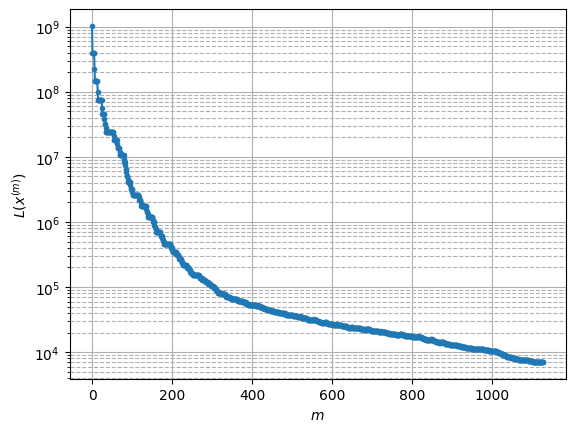

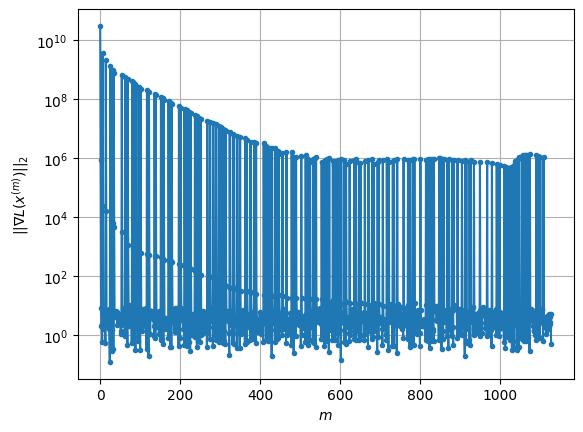

Windows:  16%|█▌        | 48/296 [43:24<1:38:34, 23.85s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7096.221853140787
Gradient norm: 1045239.827968641
Deviation from touching point norm = 0.0
Global relative error: 111.16978305594903
Position relative errors: 0.025876883189258824 m, 60.50182079674935 m, 63.3909494115652 m, 68.40931553445914 m

Iteration 1
Cost function: 7021.4467012283585 (-1.05%)
Gradient norm: 2.460304956305793 (-100.00%)
Deviation from touching point norm = 0.4733459642149735 (473345964214.97%)
Global relative error = 110.94900704030906 (-0.20%)
Position relative errors: 0.03129599348403672 m, 60.50015989711199 m, 63.150651956563266 m, 68.2744774909743 m

Iteration 2
Cost function: 7021.446702995437 (0.00%)
Gradient norm: 7.022971722455758 (185.45%)
Deviation from touching point norm = 0.4733459745457802 (0.00%)
Global relative error = 110.94900705637667 (0.00%)
Position relative errors: 0.03129599175547835 m, 60.500159911651366 m, 63.15065191363155 m, 68.27447754391171 m

Iteratio

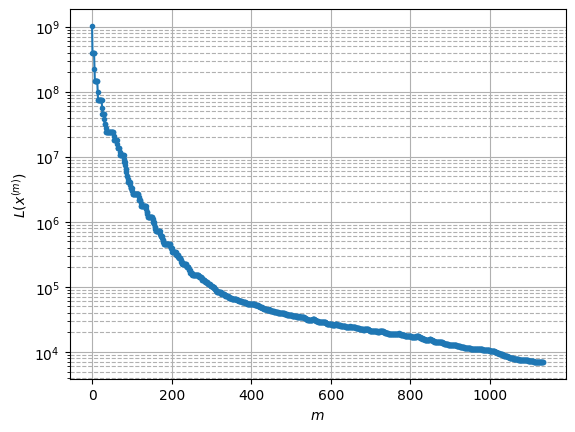

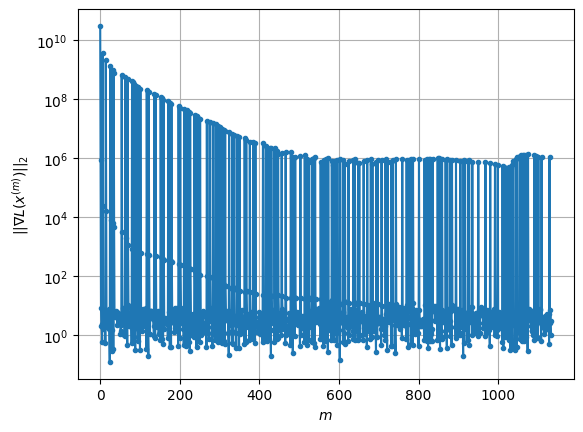

Windows:  17%|█▋        | 49/296 [43:36<1:23:26, 20.27s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7057.0492921180685
Gradient norm: 888808.4661121884
Deviation from touching point norm = 0.0
Global relative error: 107.93368385888753
Position relative errors: 0.02916370123990502 m, 59.76747484937829 m, 61.66041411295421 m, 65.38744547335828 m

Iteration 1
Cost function: 6983.49968131471 (-1.04%)
Gradient norm: 1.9156150038928021 (-100.00%)
Deviation from touching point norm = 0.4813713599796805 (481371359979.68%)
Global relative error = 107.7270168425451 (-0.19%)
Position relative errors: 0.032396543846617866 m, 59.75409973906903 m, 61.44419662031568 m, 65.26227012378679 m

Iteration 2
Cost function: 6983.499682414649 (0.00%)
Gradient norm: 3.6854326594968123 (92.39%)
Deviation from touching point norm = 0.48137134630436984 (-0.00%)
Global relative error = 107.72701686037618 (0.00%)
Position relative errors: 0.032396543663925706 m, 59.75409975319952 m, 61.4441965776325 m, 65.26227018046846 m

STOP on

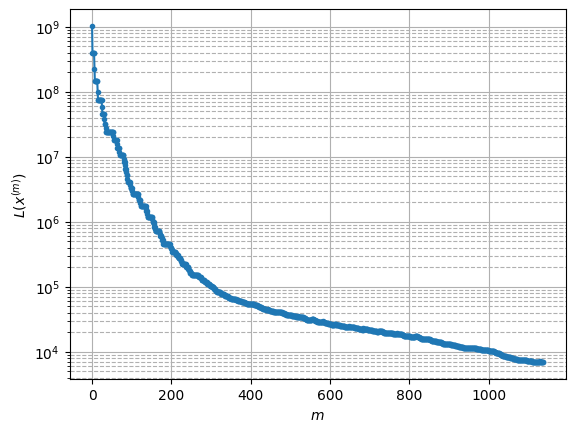

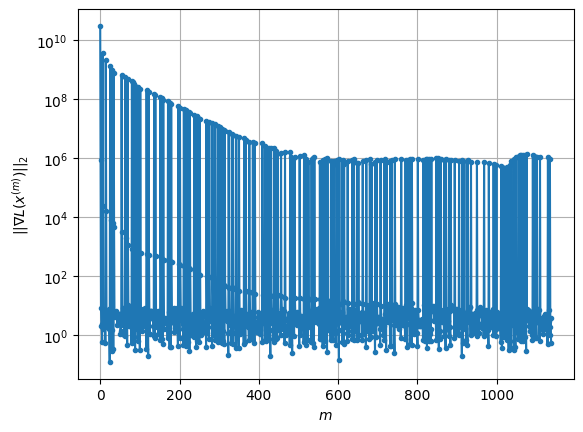

Windows:  17%|█▋        | 50/296 [43:45<1:10:06, 17.10s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7012.979690791238
Gradient norm: 851204.6481469589
Deviation from touching point norm = 0.0
Global relative error: 104.27931921454852
Position relative errors: 0.03033979860239573 m, 58.746314155155964 m, 59.709023193434035 m, 62.11178841006755 m

Iteration 1
Cost function: 6939.773108226761 (-1.04%)
Gradient norm: 4.514948808350985 (-100.00%)
Deviation from touching point norm = 0.5227420106236563 (522742010623.66%)
Global relative error = 104.0876191986599 (-0.18%)
Position relative errors: 0.03165609167923667 m, 58.72196455060882 m, 59.5180240240915 m, 61.9964745334406 m

Iteration 2
Cost function: 6939.77310872399 (0.00%)
Gradient norm: 5.665980856638844 (25.49%)
Deviation from touching point norm = 0.5227420020815075 (-0.00%)
Global relative error = 104.08761921931041 (0.00%)
Position relative errors: 0.03165609000009801 m, 58.72196456427487 m, 59.51802398287155 m, 61.99647459474004 m

Iteration 3


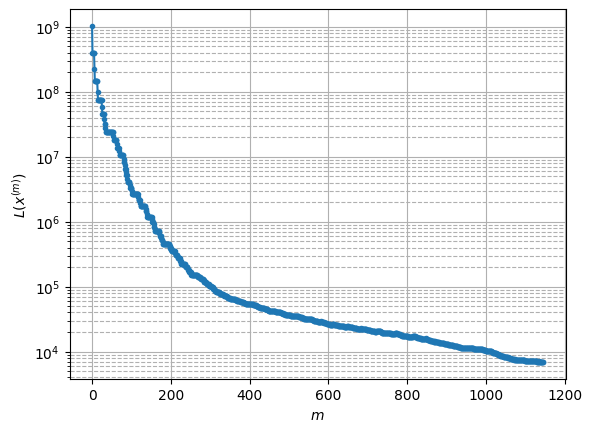

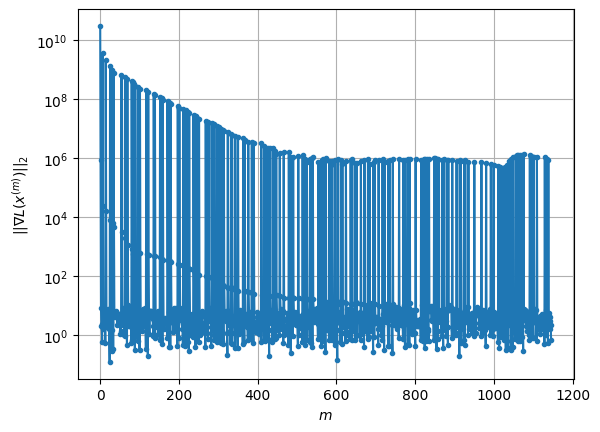

Windows:  17%|█▋        | 51/296 [44:04<1:11:48, 17.59s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6915.338839459328
Gradient norm: 727841.8503385441
Deviation from touching point norm = 0.0
Global relative error: 100.2257484658681
Position relative errors: 0.02967476526052627 m, 57.444253306365816 m, 57.5464910734463 m, 58.598239195489825 m

Iteration 1
Cost function: 6846.6421955702945 (-0.99%)
Gradient norm: 4.233346383672064 (-100.00%)
Deviation from touching point norm = 0.5213418468418127 (521341846841.81%)
Global relative error = 100.04929901157078 (-0.18%)
Position relative errors: 0.01946559674626092 m, 57.40947882766223 m, 57.378711685966735 m, 58.49522910600051 m

Iteration 2
Cost function: 6846.642196456834 (0.00%)
Gradient norm: 1.8590867302165384 (-56.08%)
Deviation from touching point norm = 0.52134184802749 (0.00%)
Global relative error = 100.04929903359464 (0.00%)
Position relative errors: 0.019465598643477456 m, 57.40947883994978 m, 57.37871164811362 m, 58.495229168740266 m

Iterati

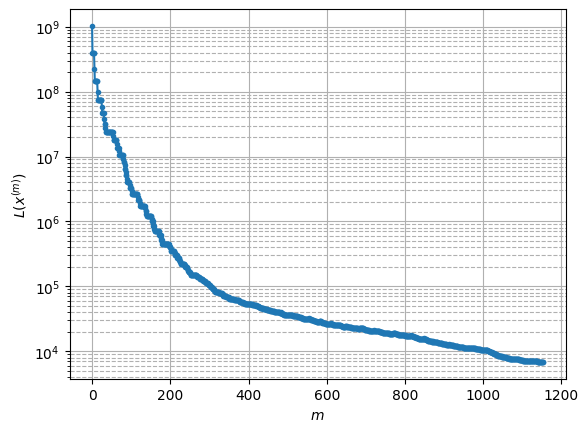

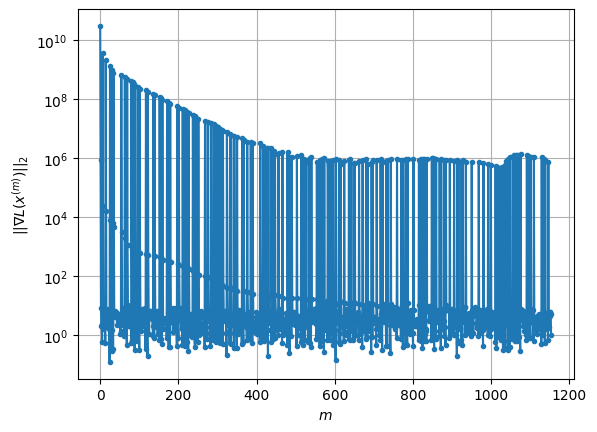

Windows:  18%|█▊        | 52/296 [44:23<1:13:04, 17.97s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6849.455731309463
Gradient norm: 692097.1442925663
Deviation from touching point norm = 0.0
Global relative error: 95.79367833498812
Position relative errors: 0.017273368867957332 m, 55.868446672637226 m, 55.180440147035405 m, 54.86581796403767 m

Iteration 1
Cost function: 6783.934306596329 (-0.96%)
Gradient norm: 4.350524748483206 (-100.00%)
Deviation from touching point norm = 0.5187414042722092 (518741404272.21%)
Global relative error = 95.63117254301014 (-0.17%)
Position relative errors: 0.014833709525228297 m, 55.825516164741906 m, 55.031509218736424 m, 54.7755375757475 m

Iteration 2
Cost function: 6783.934307209568 (0.00%)
Gradient norm: 3.735225937482751 (-14.14%)
Deviation from touching point norm = 0.5187413859516953 (-0.00%)
Global relative error = 95.63117256543974 (0.00%)
Position relative errors: 0.014833709662013745 m, 55.82551617578789 m, 55.03150918274775 m, 54.77553763980589 m

Iterat

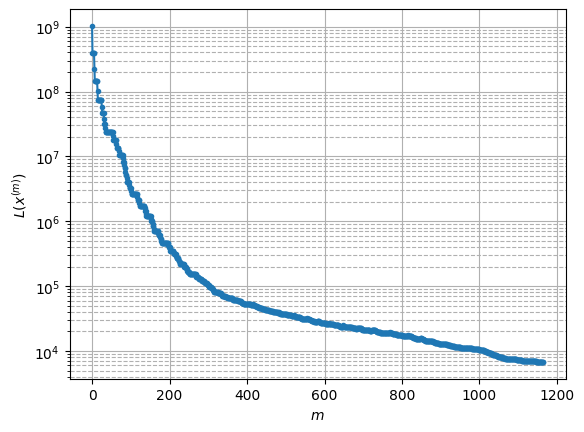

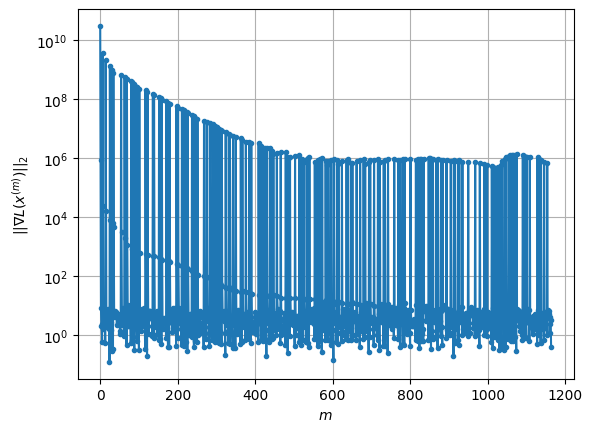

Windows:  18%|█▊        | 53/296 [44:49<1:22:34, 20.39s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6796.399033110655
Gradient norm: 625456.3659527949
Deviation from touching point norm = 0.0
Global relative error: 91.00450813712001
Position relative errors: 0.012576677160404278 m, 54.02904771562542 m, 52.61703656916439 m, 50.93252987612786 m

Iteration 1
Cost function: 6736.5230166534875 (-0.88%)
Gradient norm: 2.4331599523816347 (-100.00%)
Deviation from touching point norm = 0.4753425152380085 (475342515238.01%)
Global relative error = 90.8537276325032 (-0.17%)
Position relative errors: 0.013652991148852425 m, 53.97952202851724 m, 52.48072407265506 m, 50.85643807774975 m

Iteration 2
Cost function: 6736.523015867674 (-0.00%)
Gradient norm: 3.2825046453548334 (34.91%)
Deviation from touching point norm = 0.4753425091911726 (-0.00%)
Global relative error = 90.85372765650895 (0.00%)
Position relative errors: 0.013652993273137775 m, 53.97952203903722 m, 52.48072404287747 m, 50.856438140197476 m

Iterat

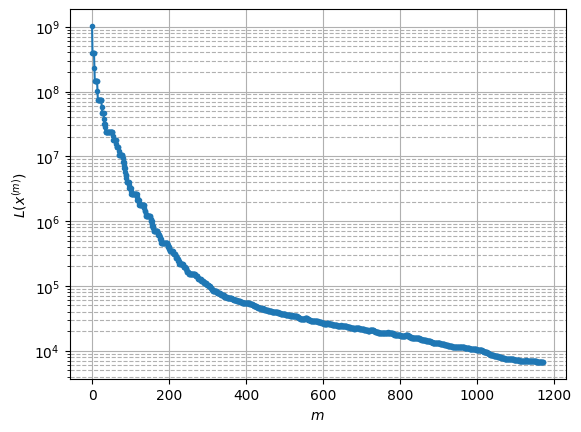

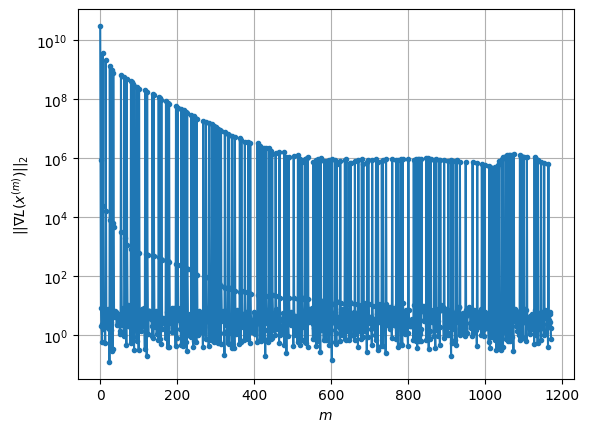

Windows:  18%|█▊        | 54/296 [45:08<1:20:38, 20.00s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6741.963672934039
Gradient norm: 591886.4381513263
Deviation from touching point norm = 0.0
Global relative error: 85.88131956437246
Position relative errors: 0.011082466709698736 m, 51.93661131349715 m, 49.86179025430842 m, 46.81861802936027 m

Iteration 1
Cost function: 6683.594288620939 (-0.87%)
Gradient norm: 2.397321521958453 (-100.00%)
Deviation from touching point norm = 0.5192100286364497 (519210028636.45%)
Global relative error = 85.74533160272887 (-0.16%)
Position relative errors: 0.011125012513472162 m, 51.88195973623002 m, 49.73818012751965 m, 46.76140838404151 m

Iteration 2
Cost function: 6683.594289414388 (0.00%)
Gradient norm: 1.8417577485939836 (-23.17%)
Deviation from touching point norm = 0.5192100268489571 (-0.00%)
Global relative error = 85.74533162662809 (0.00%)
Position relative errors: 0.011125010225891803 m, 51.88195974516226 m, 49.73818010042979 m, 46.761408446769515 m

Iterati

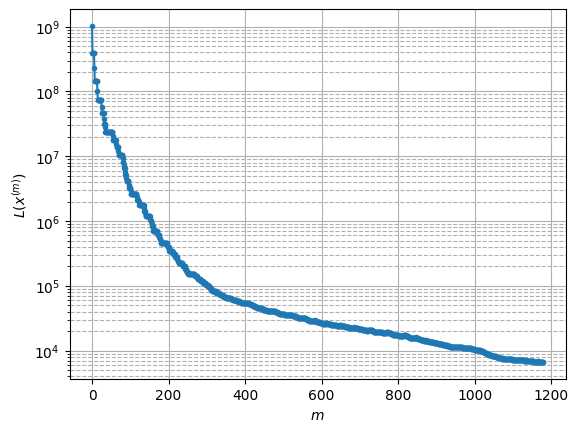

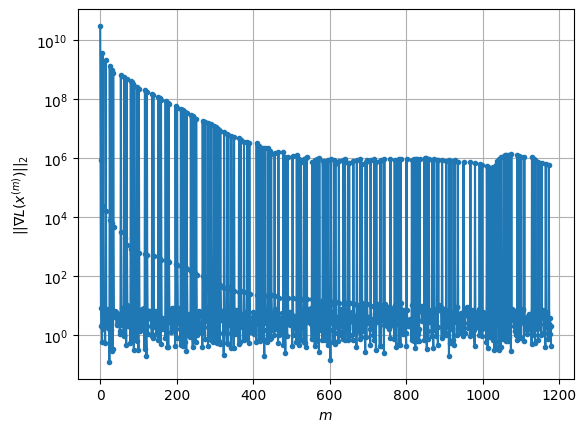

Windows:  19%|█▊        | 55/296 [45:25<1:16:59, 19.17s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6676.767936173337
Gradient norm: 489018.5928235427
Deviation from touching point norm = 0.0
Global relative error: 80.45510223295305
Position relative errors: 0.008595853258991669 m, 49.6027787087058 m, 46.92690575180341 m, 42.5493131836746 m

Iteration 1
Cost function: 6621.268118332667 (-0.83%)
Gradient norm: 3.637633254723714 (-100.00%)
Deviation from touching point norm = 0.526696652510222 (526696652510.22%)
Global relative error = 80.33214334840926 (-0.15%)
Position relative errors: 0.020797066738165688 m, 49.54276865418981 m, 46.8135561573339 m, 42.51174796592626 m

Iteration 2
Cost function: 6621.268117437129 (-0.00%)
Gradient norm: 3.273608001312036 (-10.01%)
Deviation from touching point norm = 0.5266966471849001 (-0.00%)
Global relative error = 80.33214337205041 (0.00%)
Position relative errors: 0.020797065381543765 m, 49.542768661333156 m, 46.81355613392379 m, 42.51174802805454 m

Iteration 3

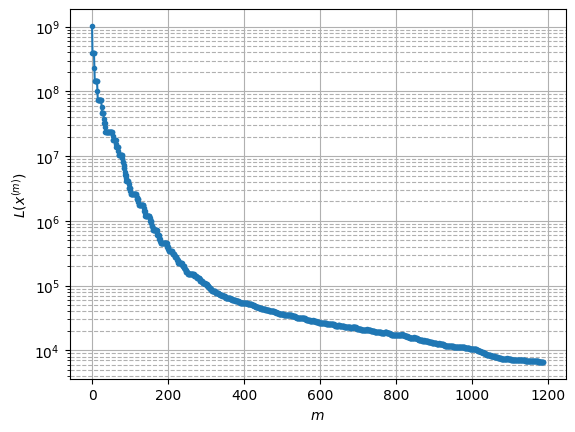

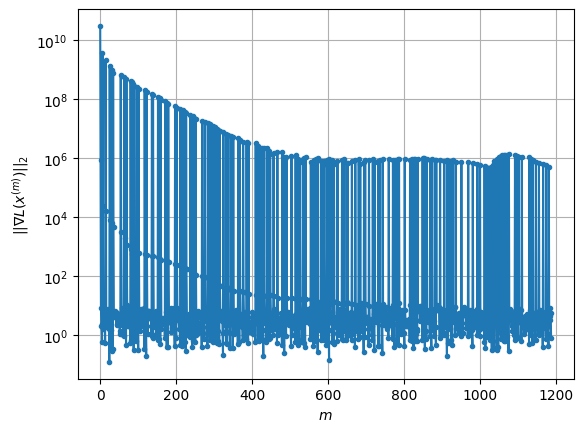

Windows:  19%|█▉        | 56/296 [45:42<1:14:00, 18.50s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6583.217013994063
Gradient norm: 384726.37801997515
Deviation from touching point norm = 0.0
Global relative error: 74.75529844354017
Position relative errors: 0.018464956466314453 m, 47.03857593582898 m, 43.82317798700783 m, 38.147680941430465 m

Iteration 1
Cost function: 6531.9351976876105 (-0.78%)
Gradient norm: 5.053428191905925 (-100.00%)
Deviation from touching point norm = 0.5239723068004953 (523972306800.50%)
Global relative error = 74.64610188566081 (-0.15%)
Position relative errors: 0.017305289867531 m, 46.97617403546314 m, 43.71580055352677 m, 38.13394767531992 m

Iteration 2
Cost function: 6531.935197114039 (-0.00%)
Gradient norm: 4.5315499405638 (-10.33%)
Deviation from touching point norm = 0.5239723103308159 (0.00%)
Global relative error = 74.64610190824288 (0.00%)
Position relative errors: 0.01730529709088722 m, 46.97617404127342 m, 43.71580053441636 m, 38.13394773427057 m

Iteration 3


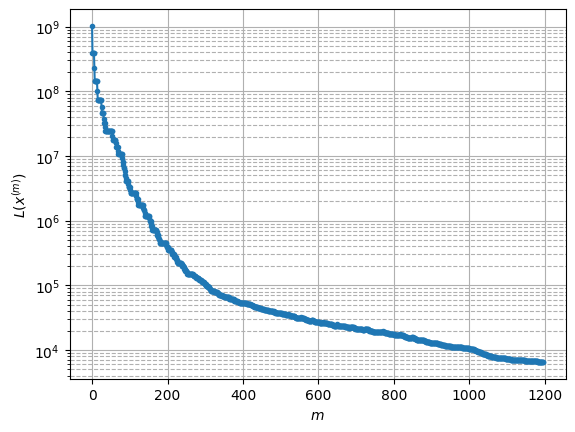

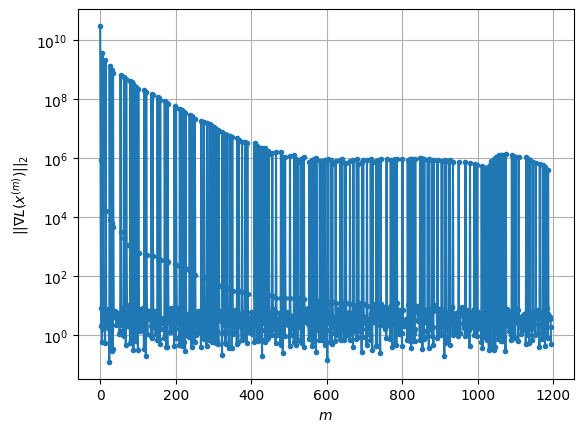

Windows:  19%|█▉        | 57/296 [46:04<1:17:29, 19.46s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6506.641356091421
Gradient norm: 318800.3442301253
Deviation from touching point norm = 0.0
Global relative error: 68.81801451249734
Position relative errors: 0.015302491415078922 m, 44.25927995485053 m, 40.56056077701083 m, 33.64319850762687 m

Iteration 1
Cost function: 6458.750034518292 (-0.74%)
Gradient norm: 2.967418028343448 (-100.00%)
Deviation from touching point norm = 0.5151179357371657 (515117935737.17%)
Global relative error = 68.72108758441986 (-0.14%)
Position relative errors: 0.021039404337419486 m, 44.19465212935032 m, 40.45695403153979 m, 33.65477640099407 m

Iteration 2
Cost function: 6458.750037426068 (0.00%)
Gradient norm: 5.521099904502346 (86.06%)
Deviation from touching point norm = 0.5151179249937063 (-0.00%)
Global relative error = 68.72108760544974 (0.00%)
Position relative errors: 0.021039398063291335 m, 44.1946521341189 m, 40.45695401588173 m, 33.65477645650057 m

Iteration 3

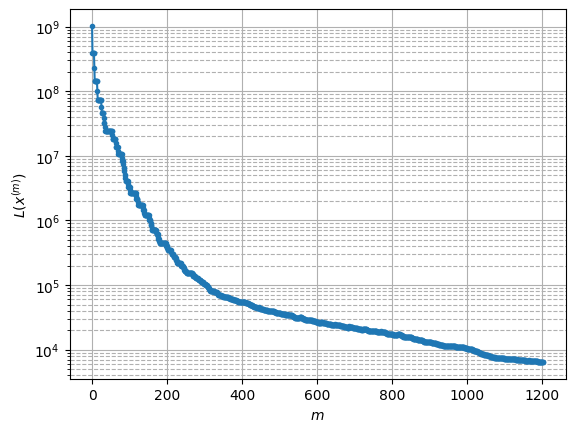

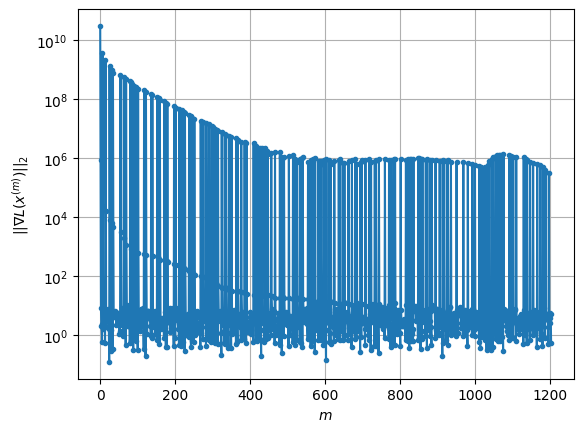

Windows:  20%|█▉        | 58/296 [46:21<1:13:53, 18.63s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6404.935075540159
Gradient norm: 230262.077428775
Deviation from touching point norm = 0.0
Global relative error: 62.68252255247061
Position relative errors: 0.019494168925433434 m, 41.278262521649374 m, 37.15210090842868 m, 29.067381711864904 m

Iteration 1
Cost function: 6358.677274879912 (-0.72%)
Gradient norm: 2.9889220118566544 (-100.00%)
Deviation from touching point norm = 0.5398774283647276 (539877428364.73%)
Global relative error = 62.60137655608725 (-0.13%)
Position relative errors: 0.02831301199044186 m, 41.21268330138566 m, 37.05061657001506 m, 29.115050263472277 m

Iteration 2
Cost function: 6358.677274634832 (-0.00%)
Gradient norm: 3.803690258377481 (27.26%)
Deviation from touching point norm = 0.539877434679976 (0.00%)
Global relative error = 62.601376577585086 (0.00%)
Position relative errors: 0.028313011835118553 m, 41.212683305347504 m, 37.05061655982686 m, 29.115050317052756 m

Iterat

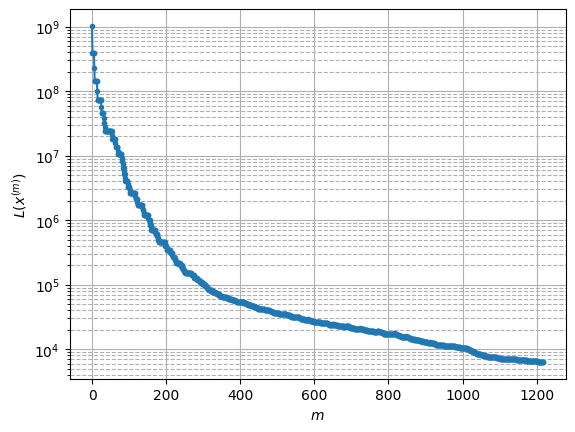

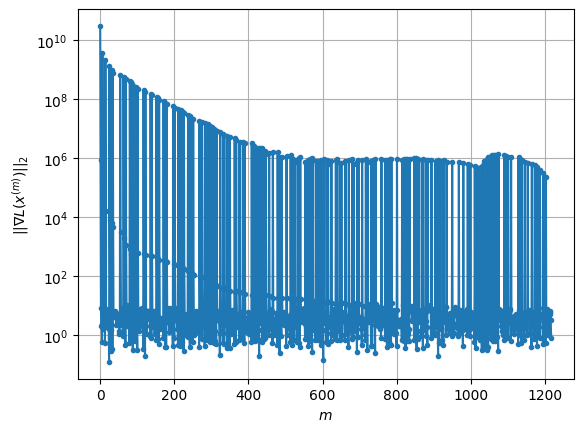

Windows:  20%|█▉        | 59/296 [46:57<1:34:02, 23.81s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6315.88274498776
Gradient norm: 268254.82534913317
Deviation from touching point norm = 0.0
Global relative error: 56.40101029794015
Position relative errors: 0.026868956166526976 m, 38.110904208892265 m, 33.6121671949943 m, 24.471240364136293 m

Iteration 1
Cost function: 6273.2197326716 (-0.68%)
Gradient norm: 3.1685829210134893 (-100.00%)
Deviation from touching point norm = 0.49993088127380203 (499930881273.80%)
Global relative error = 56.33134905962265 (-0.12%)
Position relative errors: 0.023365888834101203 m, 38.04500441816158 m, 33.51215896278756 m, 24.55036508262463 m

Iteration 2
Cost function: 6273.219733772604 (0.00%)
Gradient norm: 1.6947987477957265 (-46.51%)
Deviation from touching point norm = 0.4999308774406122 (-0.00%)
Global relative error = 56.33134907890928 (0.00%)
Position relative errors: 0.023365889359784463 m, 38.045004420913465 m, 33.512158958098276 m, 24.5503651290142 m

Iterat

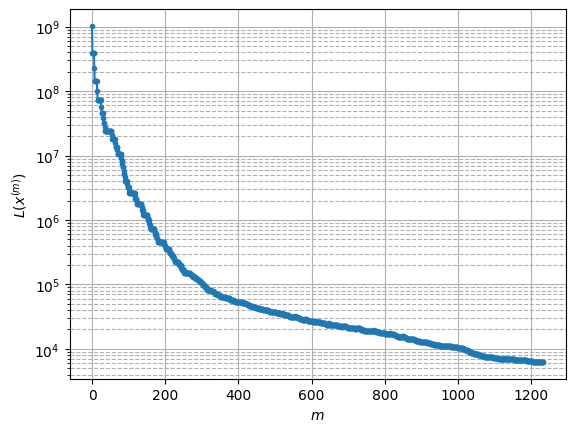

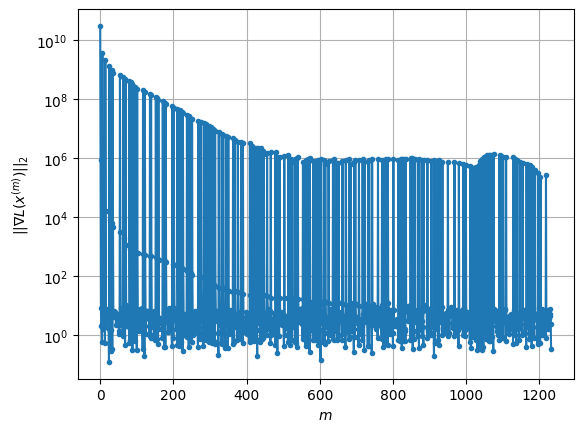

Windows:  20%|██        | 60/296 [47:32<1:47:17, 27.28s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6243.514246658727
Gradient norm: 157068.80600079484
Deviation from touching point norm = 0.0
Global relative error: 50.02990722988821
Position relative errors: 0.02250002217969344 m, 34.77287268897645 m, 29.95751275049386 m, 19.909100930457942 m

Iteration 1
Cost function: 6202.611476847477 (-0.66%)
Gradient norm: 7.841955908621459 (-100.00%)
Deviation from touching point norm = 0.47701884849396287 (477018848493.96%)
Global relative error = 49.97218909363217 (-0.12%)
Position relative errors: 0.019327311299767492 m, 34.70537659676002 m, 29.855062240469195 m, 20.035416523724464 m

Iteration 2
Cost function: 6202.611479487438 (0.00%)
Gradient norm: 5.399020087016238 (-31.15%)
Deviation from touching point norm = 0.47701884795875477 (-0.00%)
Global relative error = 49.972189110167406 (0.00%)
Position relative errors: 0.019327313482333283 m, 34.70537659793758 m, 29.8550622389038 m, 20.03541656525722 m

Iter

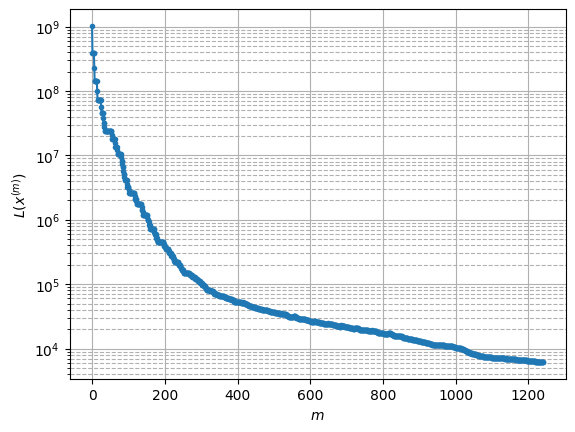

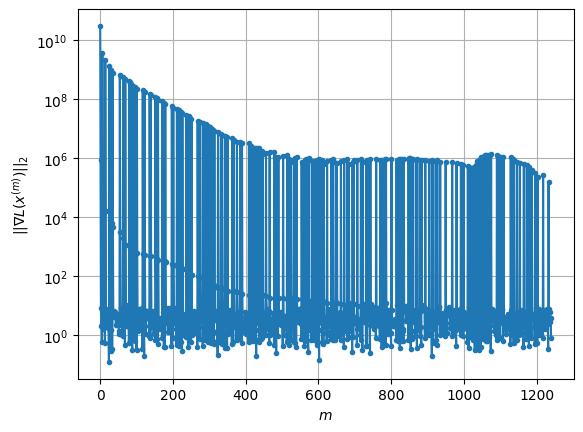

Windows:  21%|██        | 61/296 [47:51<1:37:17, 24.84s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6153.545203841738
Gradient norm: 213698.27524632638
Deviation from touching point norm = 0.0
Global relative error: 43.65080958255737
Position relative errors: 0.019270390149877394 m, 31.2787584697672 m, 26.202882634530585 m, 15.505702590107408 m

Iteration 1
Cost function: 6112.272324059076 (-0.67%)
Gradient norm: 4.086976682373944 (-100.00%)
Deviation from touching point norm = 0.4917176382730261 (491717638273.03%)
Global relative error = 43.61035703851373 (-0.09%)
Position relative errors: 0.02771486715904774 m, 31.210213552836407 m, 26.10445400604618 m, 15.694852631231653 m

Iteration 2
Cost function: 6112.27232447791 (0.00%)
Gradient norm: 5.817323296080704 (42.34%)
Deviation from touching point norm = 0.4917176367208538 (-0.00%)
Global relative error = 43.61035705294666 (0.00%)
Position relative errors: 0.027714873572980518 m, 31.21021355395362 m, 26.104454006845582 m, 15.694852667772912 m

STOP o

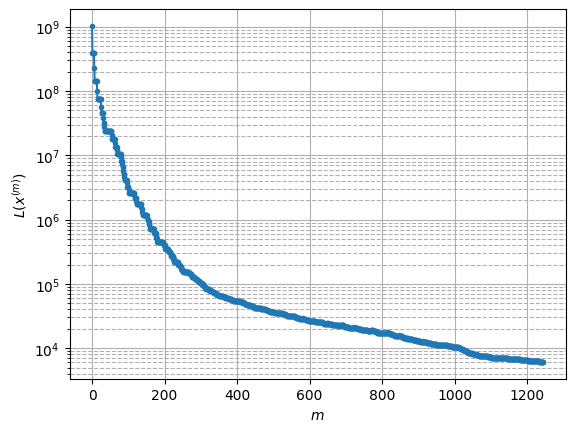

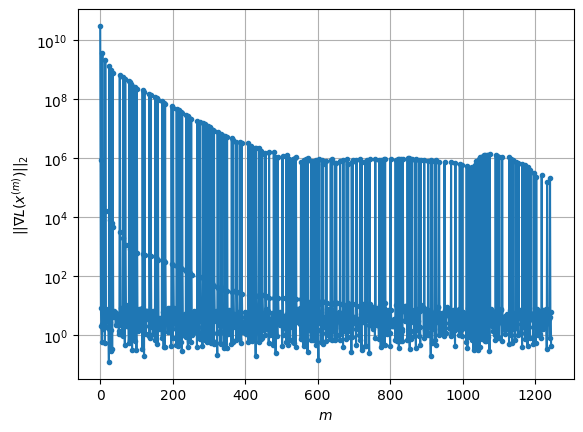

Windows:  21%|██        | 62/296 [48:01<1:19:08, 20.29s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6081.35219768781
Gradient norm: 363543.48737538327
Deviation from touching point norm = 0.0
Global relative error: 37.38599970067537
Position relative errors: 0.02772592588325985 m, 27.645813565519656 m, 22.37491299669426 m, 11.522574869138152 m

Iteration 1
Cost function: 6042.0663957534425 (-0.65%)
Gradient norm: 1.9193892506576264 (-100.00%)
Deviation from touching point norm = 0.42655311203196233 (426553112031.96%)
Global relative error = 37.35284529256062 (-0.09%)
Position relative errors: 0.028464584917925487 m, 27.57713682332082 m, 22.27899827990629 m, 11.762965063507048 m

Iteration 2
Cost function: 6042.066393580892 (-0.00%)
Gradient norm: 2.1577515777978653 (12.42%)
Deviation from touching point norm = 0.4265531094486077 (-0.00%)
Global relative error = 37.35284530455496 (0.00%)
Position relative errors: 0.02846457799579806 m, 27.57713682370367 m, 22.27899828608315 m, 11.762965089014775 m

Ite

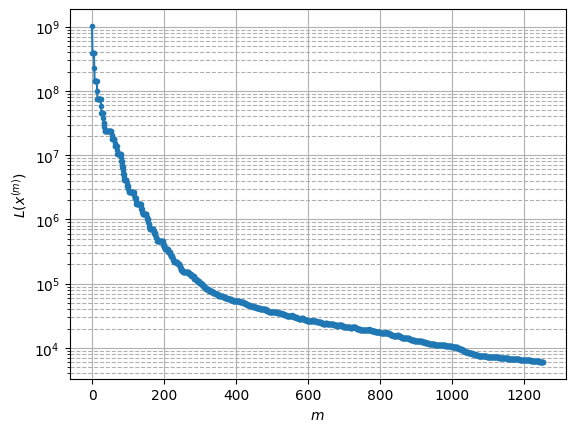

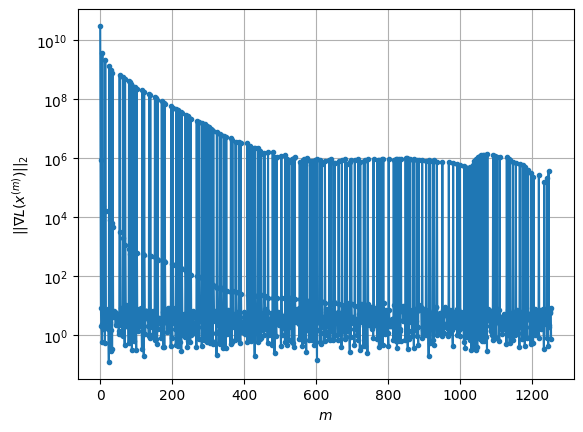

Windows:  21%|██▏       | 63/296 [48:20<1:17:08, 19.86s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6012.993327734009
Gradient norm: 360560.33042586833
Deviation from touching point norm = 0.0
Global relative error: 31.40930610692309
Position relative errors: 0.028935937932746653 m, 23.892383312314916 m, 18.496255023357822 m, 8.577359420759661 m

Iteration 1
Cost function: 5973.843751578456 (-0.65%)
Gradient norm: 4.875715899432803 (-100.00%)
Deviation from touching point norm = 0.39536587638522924 (395365876385.23%)
Global relative error = 31.38684032136845 (-0.07%)
Position relative errors: 0.025576062608935114 m, 23.823602813352743 m, 18.40382218476086 m, 8.879938130283977 m

Iteration 2
Cost function: 5973.843750835027 (-0.00%)
Gradient norm: 3.045234296448424 (-37.54%)
Deviation from touching point norm = 0.3953658736818846 (-0.00%)
Global relative error = 31.386840331146264 (0.00%)
Position relative errors: 0.025576054387697077 m, 23.823602813835777 m, 18.403822195991854 m, 8.879938140295646 m



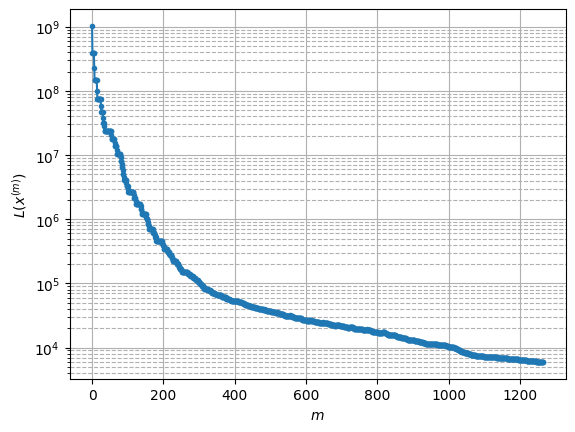

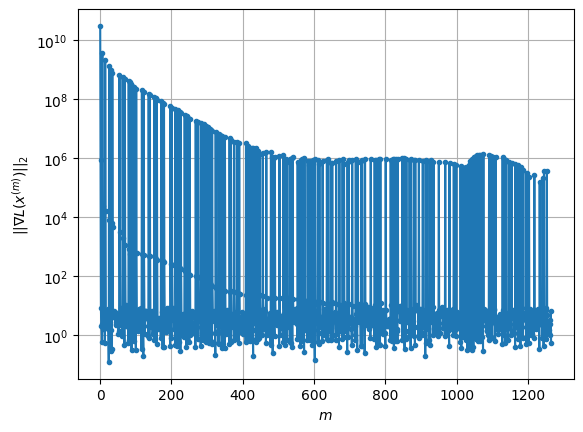

Windows:  22%|██▏       | 64/296 [48:50<1:28:29, 22.88s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5939.893984137519
Gradient norm: 462379.5359692018
Deviation from touching point norm = 0.0
Global relative error: 26.037849856147044
Position relative errors: 0.027049198533651175 m, 20.03698960925848 m, 14.599272232947008 m, 7.958250587705438 m

Iteration 1
Cost function: 5899.518705197732 (-0.68%)
Gradient norm: 1.6542251121547387 (-100.00%)
Deviation from touching point norm = 0.38729843313928164 (387298433139.28%)
Global relative error = 26.029267369573603 (-0.03%)
Position relative errors: 0.02506404935564261 m, 19.967747285362393 m, 14.512207969833156 m, 8.2578242098752 m

Iteration 2
Cost function: 5899.518703194769 (-0.00%)
Gradient norm: 4.641594967657053 (180.59%)
Deviation from touching point norm = 0.38729844470042823 (0.00%)
Global relative error = 26.0292673805058 (0.00%)
Position relative errors: 0.025064053936765567 m, 19.96774728514953 m, 14.512207985537227 m, 8.257824217236765 m

Iter

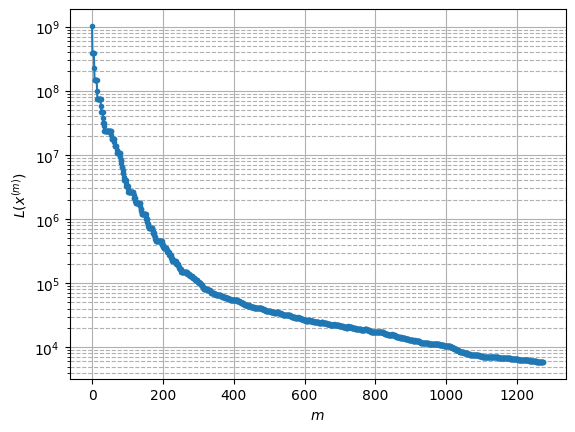

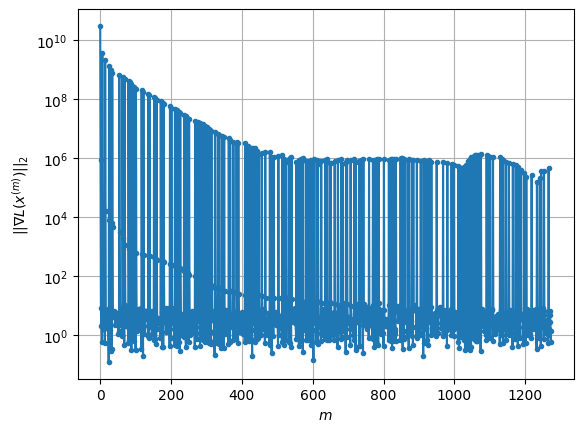

Windows:  22%|██▏       | 65/296 [49:09<1:23:41, 21.74s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5876.8318635569885
Gradient norm: 648054.9858004722
Deviation from touching point norm = 0.0
Global relative error: 21.819573672770495
Position relative errors: 0.027017605115977072 m, 16.099240552888727 m, 10.735901304002358 m, 10.081286637972765 m

Iteration 1
Cost function: 5836.190211395173 (-0.69%)
Gradient norm: 5.549105834717239 (-100.00%)
Deviation from touching point norm = 0.34530659489071786 (345306594890.72%)
Global relative error = 21.80806018543854 (-0.05%)
Position relative errors: 0.026103991346080126 m, 16.031188344779647 m, 10.656351930107991 m, 10.247850944379305 m

Iteration 2
Cost function: 5836.190210387726 (-0.00%)
Gradient norm: 3.6008954425619093 (-35.11%)
Deviation from touching point norm = 0.3453066063179406 (0.00%)
Global relative error = 21.808060191608202 (0.00%)
Position relative errors: 0.026103990667580464 m, 16.03118834477327 m, 10.656351947687115 m, 10.247850939240456

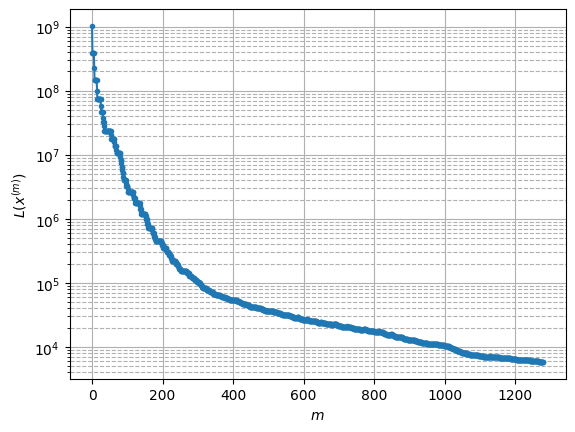

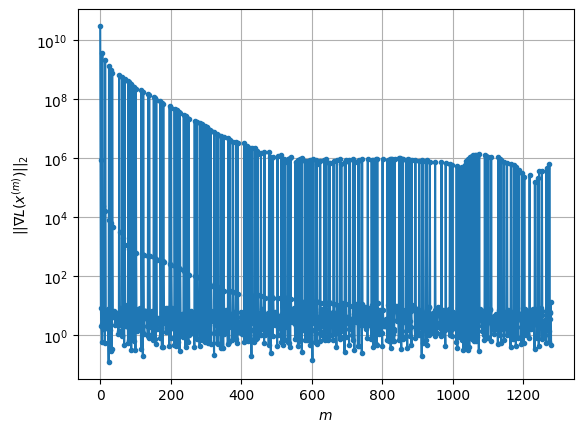

Windows:  22%|██▏       | 66/296 [49:23<1:14:52, 19.53s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5830.722209331463
Gradient norm: 636539.9721567067
Deviation from touching point norm = 0.0
Global relative error: 19.551773870953262
Position relative errors: 0.028585578209851692 m, 12.105004889680789 m, 7.027088205767693 m, 13.650798436930481 m

Iteration 1
Cost function: 5789.0845872905875 (-0.71%)
Gradient norm: 7.399813243551051 (-100.00%)
Deviation from touching point norm = 0.3432134156294965 (343213415629.50%)
Global relative error = 19.53824653522552 (-0.07%)
Position relative errors: 0.027394212989292673 m, 12.038802354514765 m, 6.945457026803563 m, 13.731519787053287 m

Iteration 2
Cost function: 5789.084591099344 (0.00%)
Gradient norm: 1.8634878159132697 (-74.82%)
Deviation from touching point norm = 0.3432134113322289 (-0.00%)
Global relative error = 19.538246531946765 (-0.00%)
Position relative errors: 0.027394210768202747 m, 12.038802354654026 m, 6.945457050507909 m, 13.731519770280526 m

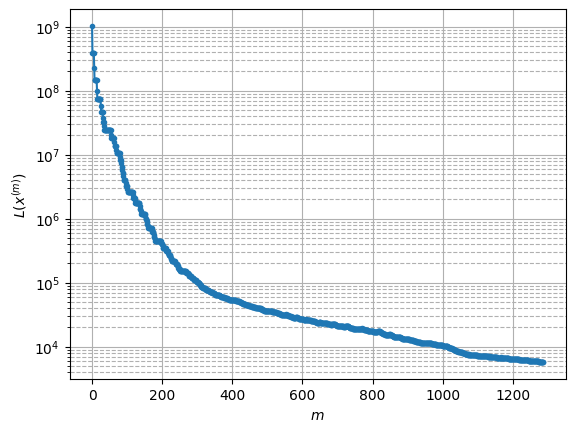

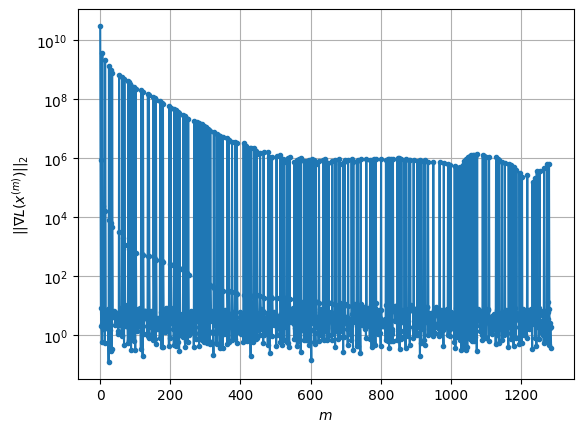

Windows:  23%|██▎       | 67/296 [49:39<1:10:48, 18.55s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5790.044428490119
Gradient norm: 667243.805766972
Deviation from touching point norm = 0.0
Global relative error: 19.92579599068741
Position relative errors: 0.029761655342610428 m, 8.09121856860914 m, 3.959840464340573 m, 17.772809825267554 m

Iteration 1
Cost function: 5749.1068371829315 (-0.71%)
Gradient norm: 1.6342690392016386 (-100.00%)
Deviation from touching point norm = 0.31224950613753727 (312249506137.54%)
Global relative error = 19.88351518765005 (-0.21%)
Position relative errors: 0.030776552469472074 m, 8.031222175234072 m, 3.8709398134289277 m, 17.7722554811674 m

Iteration 2
Cost function: 5749.106834584465 (-0.00%)
Gradient norm: 2.462421364429109 (50.67%)
Deviation from touching point norm = 0.3122495124067525 (0.00%)
Global relative error = 19.883515177841875 (-0.00%)
Position relative errors: 0.030776553464687887 m, 8.031222176155463 m, 3.870939828762693 m, 17.772255466436082 m

Itera

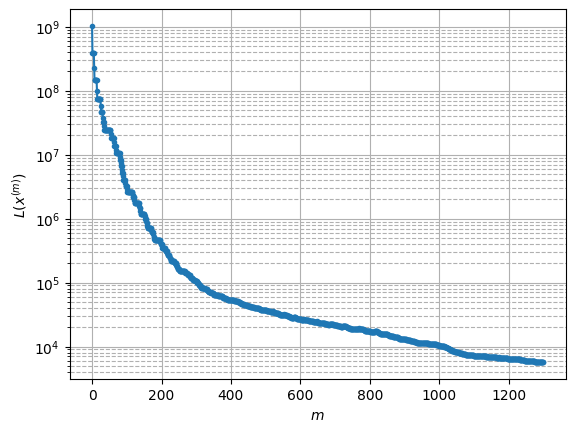

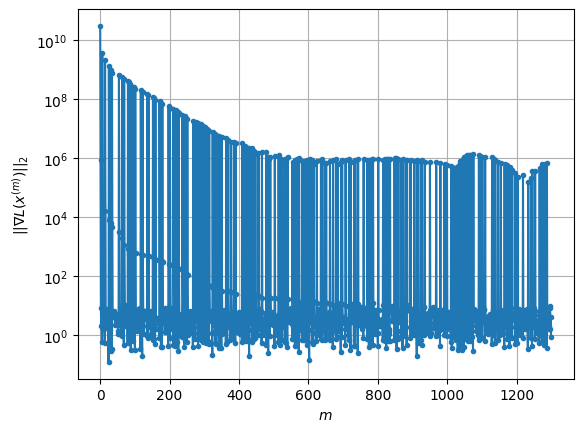

Windows:  23%|██▎       | 68/296 [50:09<1:23:33, 21.99s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5739.78782881676
Gradient norm: 696028.026009749
Deviation from touching point norm = 0.0
Global relative error: 22.756782958668257
Position relative errors: 0.03303980178414354 m, 4.173908481728421 m, 3.722687098833647 m, 22.058441867216445 m

Iteration 1
Cost function: 5698.8027588625555 (-0.71%)
Gradient norm: 2.5554705270183207 (-100.00%)
Deviation from touching point norm = 0.33024252944243965 (330242529442.44%)
Global relative error = 22.70319658715359 (-0.24%)
Position relative errors: 0.02857023413058822 m, 4.122456131266358 m, 3.6525455656318235 m, 22.024607822420595 m

Iteration 2
Cost function: 5698.80276138638 (0.00%)
Gradient norm: 1.4931831076147382 (-41.57%)
Deviation from touching point norm = 0.3302425276078189 (-0.00%)
Global relative error = 22.703196574237413 (-0.00%)
Position relative errors: 0.028570234314659416 m, 4.1224561312665395 m, 3.6525455588950604 m, 22.02460781022336 m

It

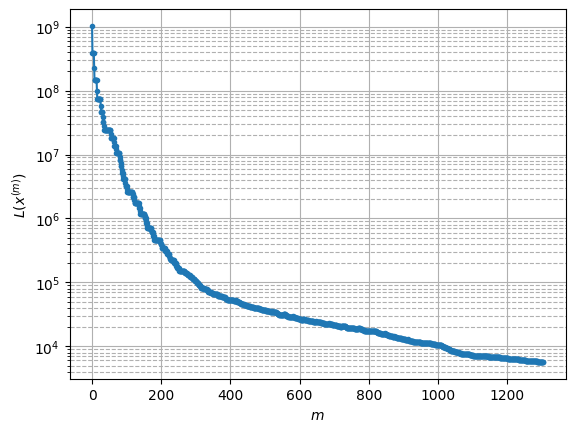

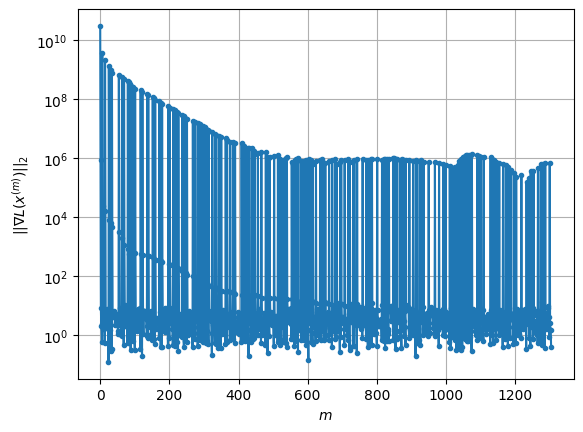

Windows:  23%|██▎       | 69/296 [50:21<1:11:35, 18.92s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5725.524558217634
Gradient norm: 760717.3975024733
Deviation from touching point norm = 0.0
Global relative error: 27.238060941854638
Position relative errors: 0.030726503556599335 m, 1.7602802691108177 m, 6.552350519334394 m, 26.379237583101748 m

Iteration 1
Cost function: 5684.576603367433 (-0.72%)
Gradient norm: 3.708688037141865 (-100.00%)
Deviation from touching point norm = 0.3268697448783073 (326869744878.31%)
Global relative error = 27.145470468440426 (-0.34%)
Position relative errors: 0.035596020969446675 m, 1.8124463486721871 m, 6.516135456579177 m, 26.28907433440125 m

Iteration 2
Cost function: 5684.576604121509 (0.00%)
Gradient norm: 1.7823509382076237 (-51.94%)
Deviation from touching point norm = 0.3268697591465731 (0.00%)
Global relative error = 27.145470454171953 (-0.00%)
Position relative errors: 0.03559602252715587 m, 1.8124463479030057 m, 6.5161354352103205 m, 26.289074325015427 m



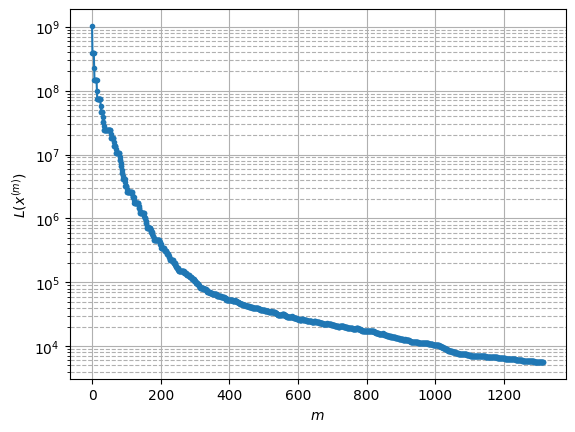

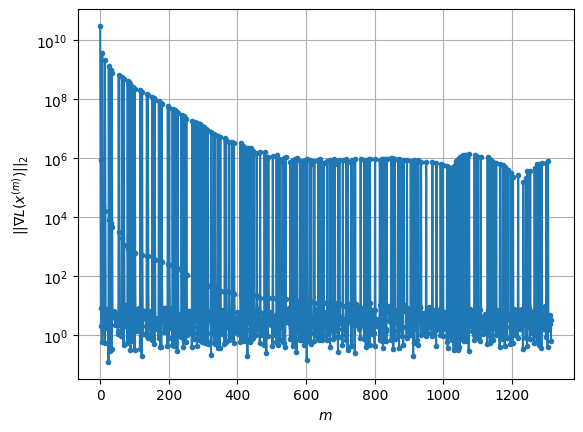

Windows:  24%|██▎       | 70/296 [50:45<1:16:37, 20.35s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5670.568827367673
Gradient norm: 684861.5061741018
Deviation from touching point norm = 0.0
Global relative error: 32.59469427864027
Position relative errors: 0.036889227922377976 m, 4.770423344410424 m, 10.077202886507612 m, 30.628275910201115 m

Iteration 1
Cost function: 5631.952579253597 (-0.68%)
Gradient norm: 3.8291239345805024 (-100.00%)
Deviation from touching point norm = 0.34505795392200306 (345057953922.00%)
Global relative error = 32.492277434588686 (-0.31%)
Position relative errors: 0.04360869649008285 m, 4.844755407920196 m, 10.033037030309664 m, 30.522094961797674 m

Iteration 2
Cost function: 5631.952579626482 (0.00%)
Gradient norm: 1.7653097399581086 (-53.90%)
Deviation from touching point norm = 0.3450579762443788 (0.00%)
Global relative error = 32.49227741723673 (-0.00%)
Position relative errors: 0.04360869790285959 m, 4.8447554088902525 m, 10.033037003074242 m, 30.522094952122288 m



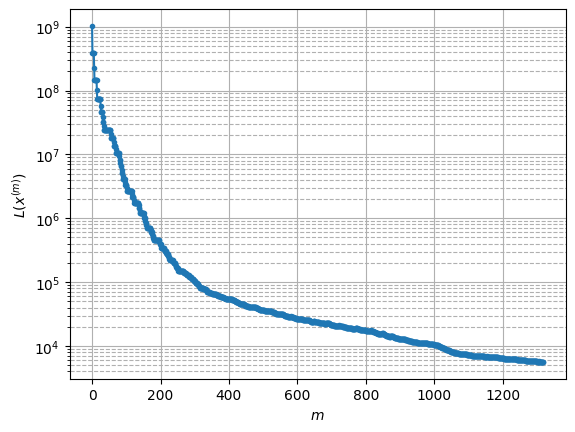

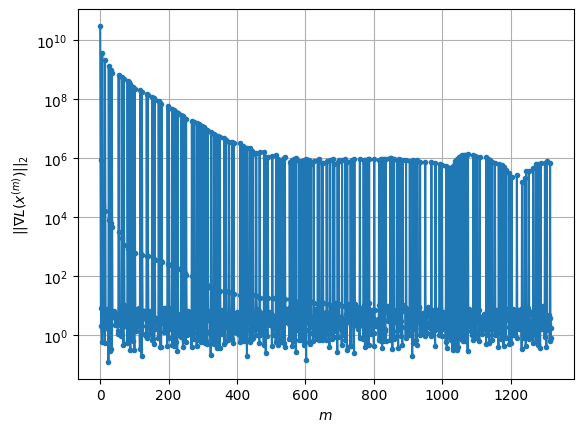

Windows:  24%|██▍       | 71/296 [50:54<1:04:11, 17.12s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5643.933036215013
Gradient norm: 677949.5290164954
Deviation from touching point norm = 0.0
Global relative error: 38.38846802278816
Position relative errors: 0.04457954821128727 m, 8.712402130305392 m, 13.693942222235316 m, 34.78833956155918 m

Iteration 1
Cost function: 5606.37528710969 (-0.67%)
Gradient norm: 1.4590081420248027 (-100.00%)
Deviation from touching point norm = 0.368299943546822 (368299943546.82%)
Global relative error = 38.26272265066924 (-0.33%)
Position relative errors: 0.04816687480886083 m, 8.785547370364757 m, 13.642852206340534 m, 34.65121232169171 m

STOP on Iteration 2
Cost function = 5606.375289487846 (0.00%)
Gradient norm = 0.43901460639703427 (-69.91%)
Deviation from touching point norm = 0.3682999695773867 (0.00%)
Global relative error = 38.26272263553095 (-0.00%)
Final position relative errors: 0.04816687565734825 m, 8.785547368927514 m, 13.642852177851388 m, 34.6512123165

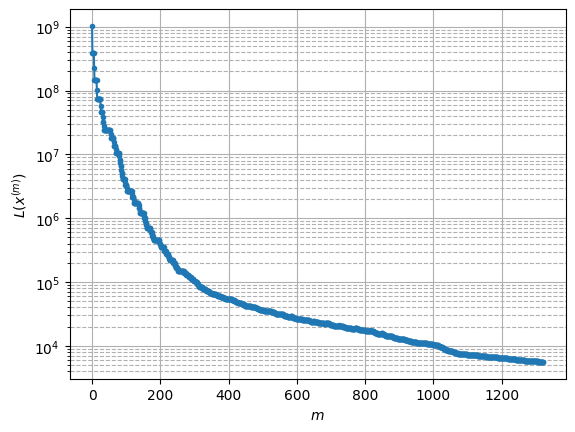

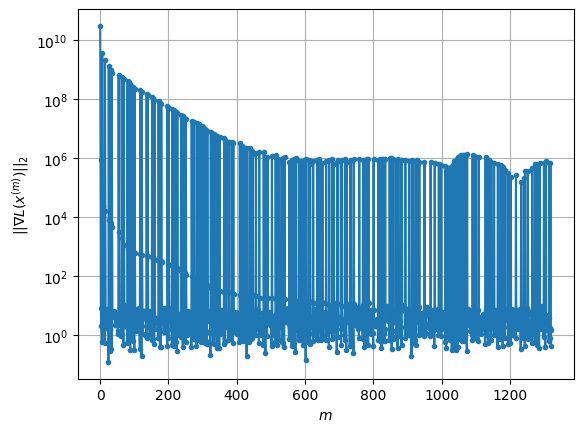

Windows:  24%|██▍       | 72/296 [51:02<52:48, 14.15s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5595.235951305435
Gradient norm: 604074.8743941096
Deviation from touching point norm = 0.0
Global relative error: 44.34241141569617
Position relative errors: 0.0490300372883493 m, 12.710627383644082 m, 17.280969801130595 m, 38.80775489437992 m

Iteration 1
Cost function: 5560.763867200826 (-0.62%)
Gradient norm: 6.135555737898621 (-100.00%)
Deviation from touching point norm = 0.38225468194161777 (382254681941.62%)
Global relative error = 44.20207727143731 (-0.32%)
Position relative errors: 0.053557299188135975 m, 12.77924315872931 m, 17.215213695032798 m, 38.65404182063795 m

Iteration 2
Cost function: 5560.763868621083 (0.00%)
Gradient norm: 9.680259297533484 (57.77%)
Deviation from touching point norm = 0.3822547155209703 (0.00%)
Global relative error = 44.202077257173094 (-0.00%)
Position relative errors: 0.05355729619542186 m, 12.779243157211766 m, 17.21521366653806 m, 38.6540418175228 m

Iteratio

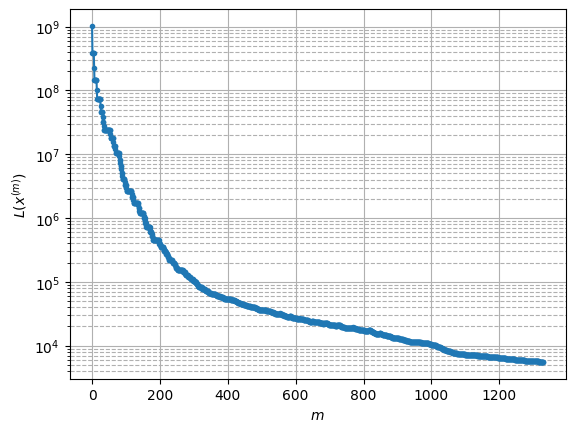

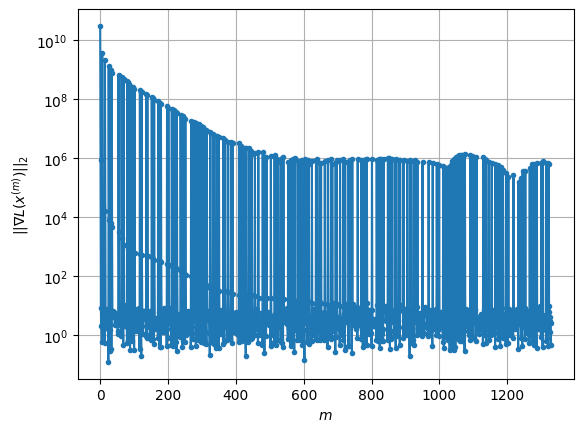

Windows:  25%|██▍       | 73/296 [51:21<58:13, 15.67s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5547.459005835719
Gradient norm: 538622.1224674631
Deviation from touching point norm = 0.0
Global relative error: 50.307273748542194
Position relative errors: 0.054106091628224974 m, 16.673934235709353 m, 20.784594566976907 m, 42.67068000141043 m

Iteration 1
Cost function: 5513.961079890683 (-0.60%)
Gradient norm: 3.7389223038912096 (-100.00%)
Deviation from touching point norm = 0.4247807549618193 (424780754961.82%)
Global relative error = 50.15112869253809 (-0.31%)
Position relative errors: 0.06021691159843888 m, 16.73939181079969 m, 20.711346295449264 m, 42.49650053611787 m

STOP on Iteration 2
Cost function = 5513.961079744127 (-0.00%)
Gradient norm = 0.7607667450419368 (-79.65%)
Deviation from touching point norm = 0.42478079022966675 (0.00%)
Global relative error = 50.151128679837775 (-0.00%)
Final position relative errors: 0.060216911808727715 m, 16.73939181020157 m, 20.711346265422247 m, 42.49

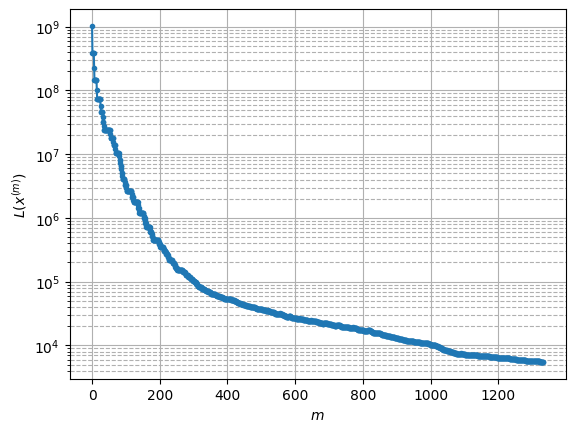

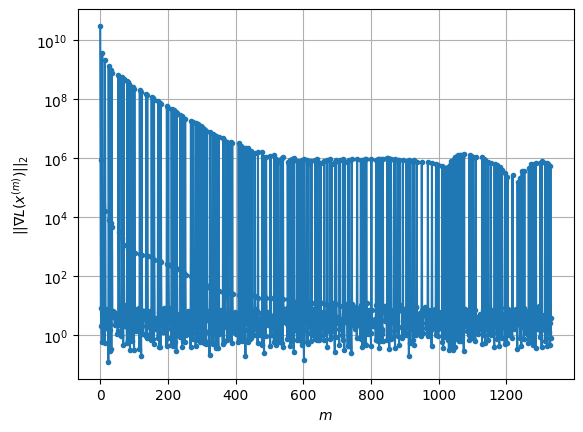

Windows:  25%|██▌       | 74/296 [51:28<48:53, 13.21s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5507.67188087816
Gradient norm: 531306.5968039162
Deviation from touching point norm = 0.0
Global relative error: 56.180850286754605
Position relative errors: 0.060047362814630856 m, 20.569424442057375 m, 24.184608253264578 m, 46.34950045501088 m

Iteration 1
Cost function: 5474.176766802089 (-0.61%)
Gradient norm: 5.141956860417574 (-100.00%)
Deviation from touching point norm = 0.45933294297274974 (459332942972.75%)
Global relative error = 56.011317719949325 (-0.30%)
Position relative errors: 0.0633384891686401 m, 20.634651218831063 m, 24.102969348154907 m, 46.157449541909195 m

Iteration 2
Cost function: 5474.176765724707 (-0.00%)
Gradient norm: 1.3326219319043708 (-74.08%)
Deviation from touching point norm = 0.459332988319071 (0.00%)
Global relative error = 56.01131770992438 (-0.00%)
Position relative errors: 0.0633384828888451 m, 20.634651217219854 m, 24.102969320728207 m, 46.1574495447949 m

Iter

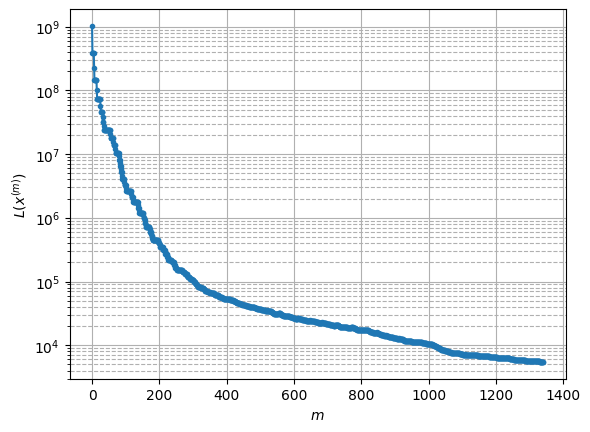

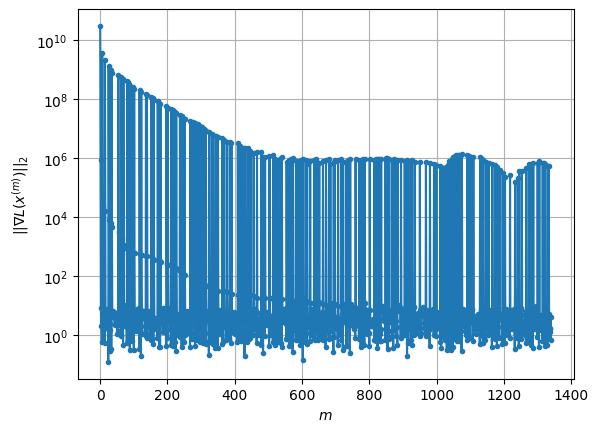

Windows:  25%|██▌       | 75/296 [51:47<54:34, 14.82s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5415.800624148362
Gradient norm: 489368.3830784651
Deviation from touching point norm = 0.0
Global relative error: 61.894713970867166
Position relative errors: 0.06287764596287905 m, 24.37680702665329 m, 27.460899636974883 m, 49.82580844509919 m

Iteration 1
Cost function: 5383.460612747222 (-0.60%)
Gradient norm: 8.128396842327003 (-100.00%)
Deviation from touching point norm = 0.4874771523010415 (487477152301.04%)
Global relative error = 61.71813242370107 (-0.29%)
Position relative errors: 0.05405369755832489 m, 24.43614811723222 m, 27.378418732140556 m, 49.62268736231701 m

STOP on Iteration 2
Cost function = 5383.460611352691 (-0.00%)
Gradient norm = 0.7257589994342126 (-91.07%)
Deviation from touching point norm = 0.48747720407354483 (0.00%)
Global relative error = 61.718132415376616 (-0.00%)
Final position relative errors: 0.054053703335052786 m, 24.436148117272683 m, 27.378418704730645 m, 49.6226

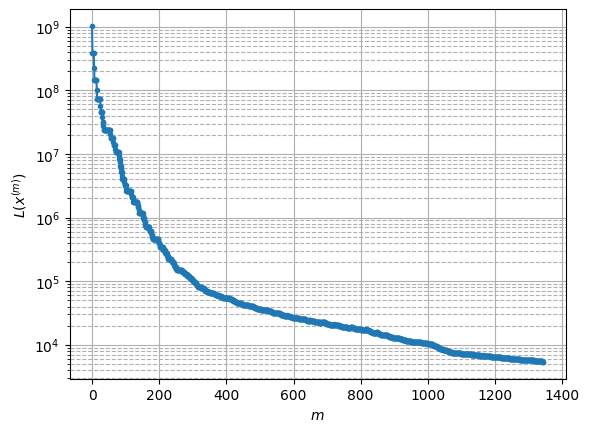

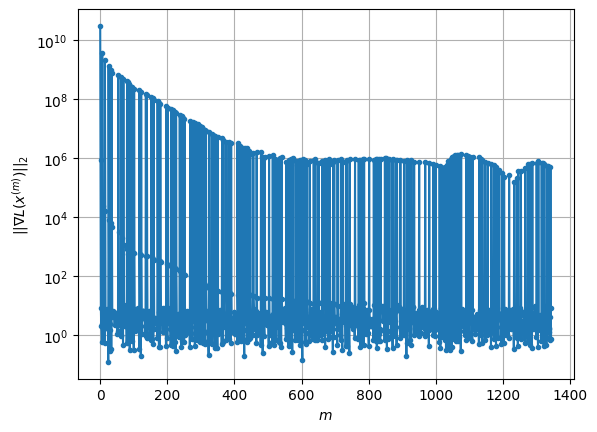

Windows:  26%|██▌       | 76/296 [51:54<45:58, 12.54s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5356.7939376257855
Gradient norm: 498772.1286351356
Deviation from touching point norm = 0.0
Global relative error: 67.4014265158576
Position relative errors: 0.05366098901186896 m, 28.071407559406325 m, 30.60488980043817 m, 53.08744114831415 m

Iteration 1
Cost function: 5324.483305748382 (-0.60%)
Gradient norm: 2.7365256126902544 (-100.00%)
Deviation from touching point norm = 0.5277244781588398 (527724478158.84%)
Global relative error = 67.21259491027749 (-0.28%)
Position relative errors: 0.04518639821898663 m, 28.125161800564296 m, 30.518973043108197 m, 52.86859811448511 m

STOP on Iteration 2
Cost function = 5324.48330321952 (-0.00%)
Gradient norm = 0.9101679360210332 (-66.74%)
Deviation from touching point norm = 0.5277245227671319 (0.00%)
Global relative error = 67.21259490708492 (-0.00%)
Final position relative errors: 0.0451863991781977 m, 28.12516179926496 m, 30.518973017928488 m, 52.868598125

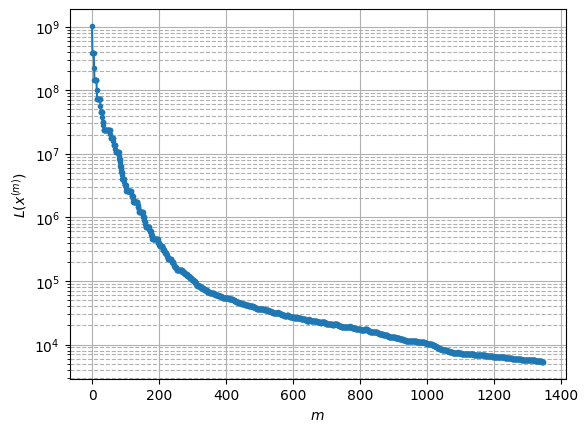

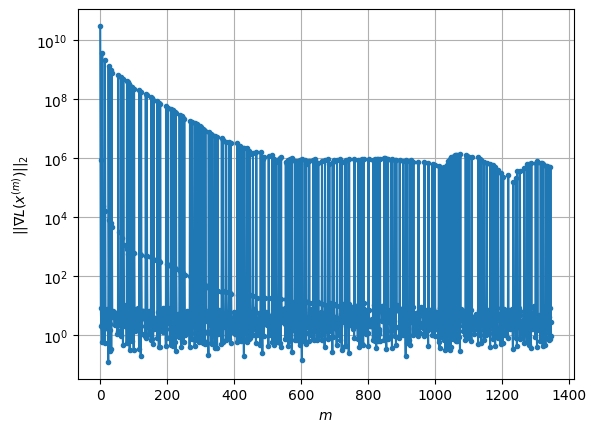

Windows:  26%|██▌       | 77/296 [52:01<40:08, 11.00s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5230.584354708418
Gradient norm: 339662.92888405215
Deviation from touching point norm = 0.0
Global relative error: 72.65356892541203
Position relative errors: 0.045251241949954904 m, 31.636129645625655 m, 33.59973956529017 m, 56.113661388340084 m

Iteration 1
Cost function: 5199.317714673121 (-0.60%)
Gradient norm: 2.2125607956754045 (-100.00%)
Deviation from touching point norm = 0.5552327009826249 (555232700982.62%)
Global relative error = 72.46132249429338 (-0.26%)
Position relative errors: 0.04194909611935546 m, 31.685813709569793 m, 33.5119421020281 m, 55.88910130110017 m

Iteration 2
Cost function: 5199.317714568955 (-0.00%)
Gradient norm: 1.660678579823034 (-24.94%)
Deviation from touching point norm = 0.5552327388052203 (0.00%)
Global relative error = 72.4613224933536 (-0.00%)
Position relative errors: 0.04194909525412563 m, 31.68581370839019 m, 33.51194207864749 m, 55.88910131457047 m

STOP on

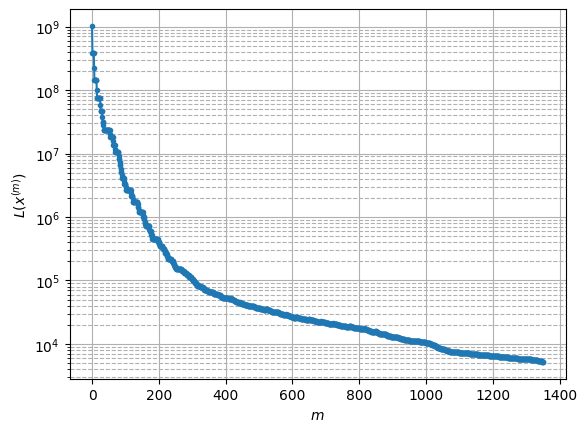

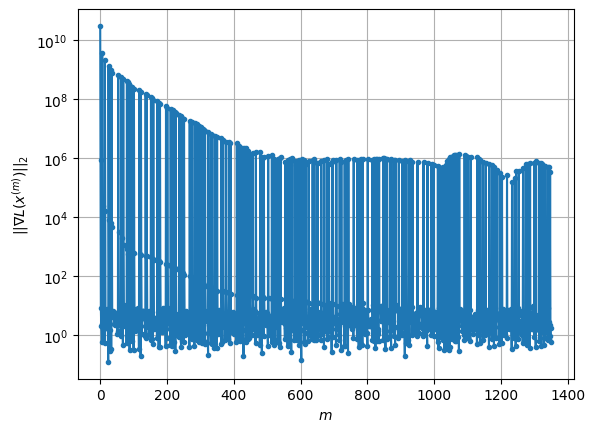

Windows:  26%|██▋       | 78/296 [52:11<38:15, 10.53s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5114.793702019927
Gradient norm: 383570.28704143054
Deviation from touching point norm = 0.0
Global relative error: 77.62413774432316
Position relative errors: 0.04218347352165335 m, 35.05602254281838 m, 36.43444475568184 m, 58.89909714432661 m

Iteration 1
Cost function: 5085.736137608069 (-0.57%)
Gradient norm: 2.253754118215258 (-100.00%)
Deviation from touching point norm = 0.5338451678294979 (533845167829.50%)
Global relative error = 77.42880245022086 (-0.25%)
Position relative errors: 0.038896383680235035 m, 35.09977078788245 m, 36.34246497503556 m, 58.672322637211856 m

Iteration 2
Cost function: 5085.736136972667 (-0.00%)
Gradient norm: 2.754776525208491 (22.23%)
Deviation from touching point norm = 0.5338451922140004 (0.00%)
Global relative error = 77.42880245147639 (0.00%)
Position relative errors: 0.03889638428691033 m, 35.09977078672619 m, 36.342464953685415 m, 58.67232265278462 m

STOP on I

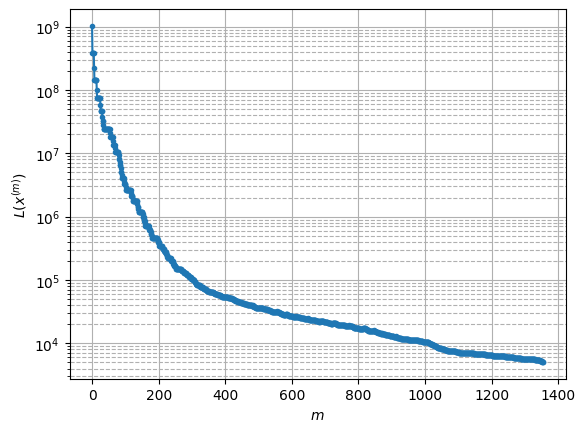

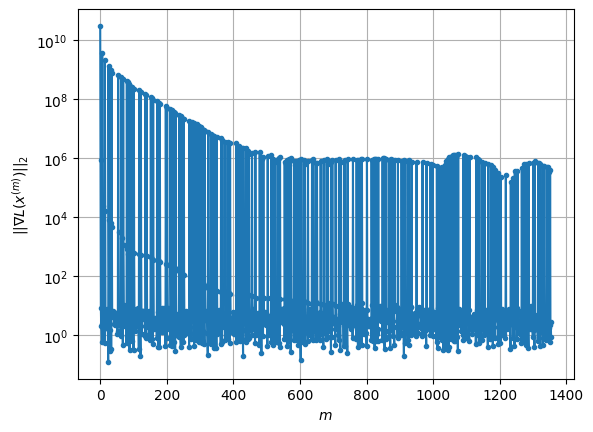

Windows:  27%|██▋       | 79/296 [52:20<36:57, 10.22s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4952.743909885468
Gradient norm: 308395.8919731111
Deviation from touching point norm = 0.0
Global relative error: 82.2829146294287
Position relative errors: 0.03911405758085914 m, 38.314036726066675 m, 39.0958673148147 m, 61.43303168411985 m

Iteration 1
Cost function: 4925.128186573524 (-0.56%)
Gradient norm: 2.6887721713196995 (-100.00%)
Deviation from touching point norm = 0.534492807969094 (534492807969.09%)
Global relative error = 82.0847808287817 (-0.24%)
Position relative errors: 0.0382909981995895 m, 38.35087045523814 m, 39.00381384449622 m, 61.20307321214175 m

Iteration 2
Cost function: 4925.128186855429 (0.00%)
Gradient norm: 2.6162677988861867 (-2.70%)
Deviation from touching point norm = 0.5344928160734151 (0.00%)
Global relative error = 82.08478083304237 (0.00%)
Position relative errors: 0.03829099756650936 m, 38.350870453996286 m, 39.00381382508554 m, 61.20307323100476 m

Iteration 3
Cos

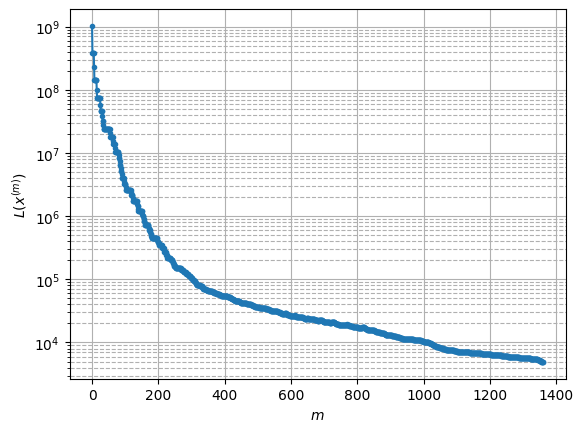

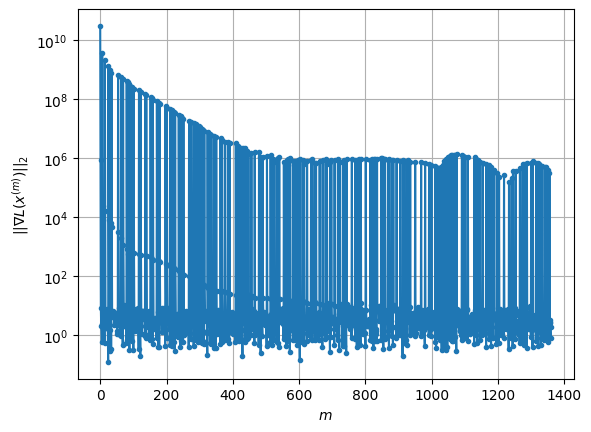

Windows:  27%|██▋       | 80/296 [52:34<40:55, 11.37s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4775.453527838497
Gradient norm: 314313.1020462549
Deviation from touching point norm = 0.0
Global relative error: 86.6039355883079
Position relative errors: 0.038388187422705534 m, 41.394922465717414 m, 41.57769308045403 m, 63.70235553819549 m

Iteration 1
Cost function: 4750.806221823739 (-0.52%)
Gradient norm: 1.2950130855065691 (-100.00%)
Deviation from touching point norm = 0.5084454661407977 (508445466140.80%)
Global relative error = 86.40183566098324 (-0.23%)
Position relative errors: 0.04029913468165187 m, 41.42382750147127 m, 41.479576293183435 m, 63.47267881562671 m

Iteration 2
Cost function: 4750.8062230769165 (0.00%)
Gradient norm: 3.158104176472526 (143.87%)
Deviation from touching point norm = 0.5084454654589554 (-0.00%)
Global relative error = 86.40183566699606 (0.00%)
Position relative errors: 0.040299134909831995 m, 41.42382750061376 m, 41.479576276749036 m, 63.47267883511105 m

Iterat

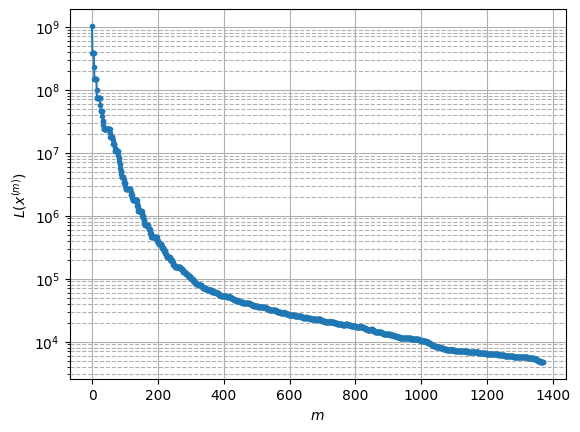

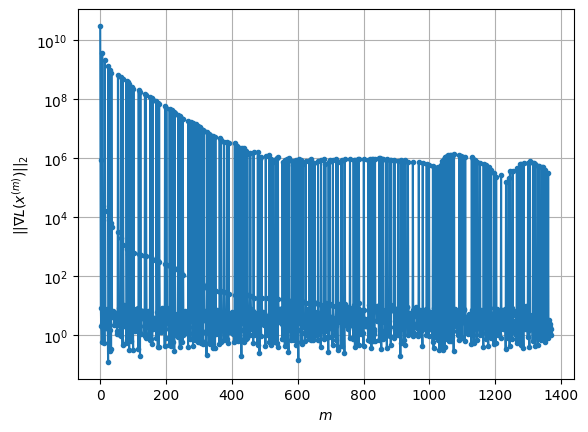

Windows:  27%|██▋       | 81/296 [52:58<53:25, 14.91s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4620.951052193059
Gradient norm: 362417.6707080465
Deviation from touching point norm = 0.0
Global relative error: 90.56325297055459
Position relative errors: 0.04025922449166354 m, 44.28415519662021 m, 43.86514987066846 m, 65.69975953102562 m

Iteration 1
Cost function: 4596.44194160176 (-0.53%)
Gradient norm: 1.6791826498339406 (-100.00%)
Deviation from touching point norm = 0.531372126852346 (531372126852.35%)
Global relative error = 90.35809026119121 (-0.23%)
Position relative errors: 0.041121169056524964 m, 44.30678173049825 m, 43.760917821846554 m, 65.47113089426027 m

Iteration 2
Cost function: 4596.441940486236 (-0.00%)
Gradient norm: 1.1119864023946697 (-33.78%)
Deviation from touching point norm = 0.5313721381615701 (0.00%)
Global relative error = 90.35809026955322 (0.00%)
Position relative errors: 0.041121169459166974 m, 44.30678172889086 m, 43.76091781070955 m, 65.47113091433232 m

Iteration

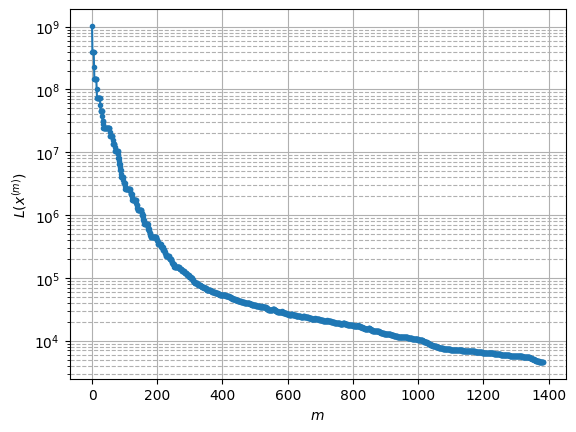

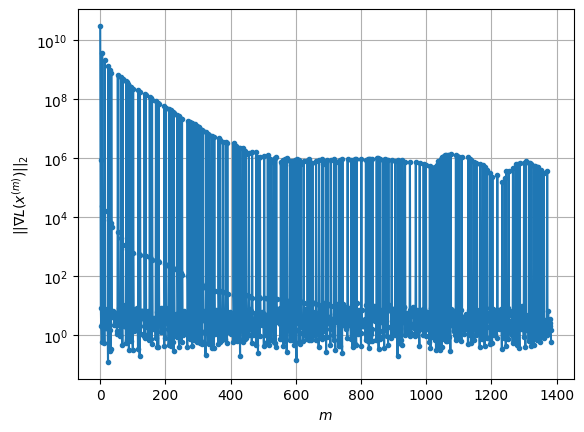

Windows:  28%|██▊       | 82/296 [53:28<1:09:38, 19.52s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4446.484541204615
Gradient norm: 359086.3666653325
Deviation from touching point norm = 0.0
Global relative error: 94.14152185071647
Position relative errors: 0.04091169794045361 m, 46.97061326709049 m, 45.949547160077366 m, 67.41677057055824 m

Iteration 1
Cost function: 4424.471416426992 (-0.50%)
Gradient norm: 1.9518352678274193 (-100.00%)
Deviation from touching point norm = 0.49731907775037837 (497319077750.38%)
Global relative error = 93.93571238594193 (-0.22%)
Position relative errors: 0.03964215200078985 m, 46.98516422015231 m, 45.83870290450967 m, 67.19464305402154 m

STOP on Iteration 2
Cost function = 4424.4714166408985 (0.00%)
Gradient norm = 0.677182994583455 (-65.31%)
Deviation from touching point norm = 0.49731907526016456 (-0.00%)
Global relative error = 93.93571239510963 (0.00%)
Final position relative errors: 0.039642151530755676 m, 46.98516422062601 m, 45.83870289319718 m, 67.19464307

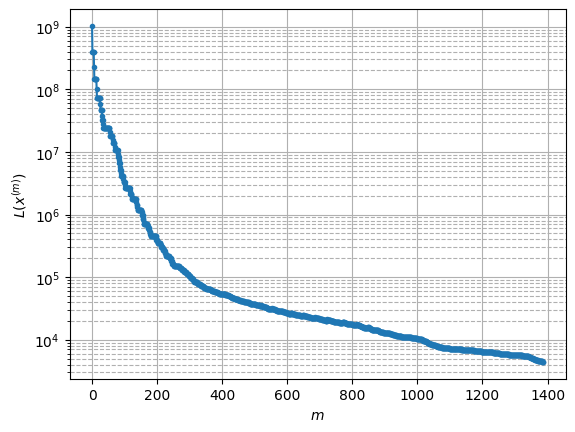

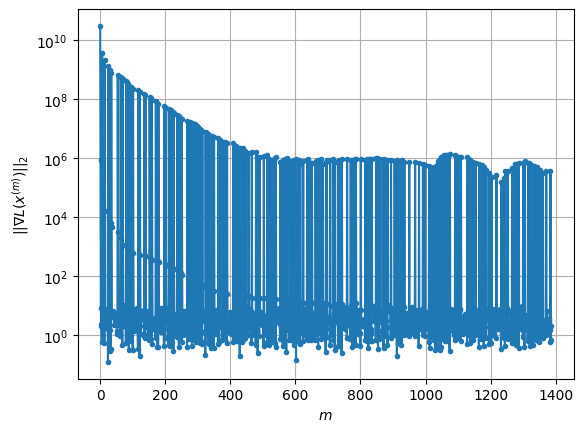

Windows:  28%|██▊       | 83/296 [53:36<56:41, 15.97s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4289.676381637632
Gradient norm: 571924.3640847603
Deviation from touching point norm = 0.0
Global relative error: 97.32335778203145
Position relative errors: 0.03925291573374909 m, 49.44093920582583 m, 47.82303280585326 m, 68.85043350088702 m

Iteration 1
Cost function: 4268.608335381347 (-0.49%)
Gradient norm: 3.052677645567852 (-100.00%)
Deviation from touching point norm = 0.4985149805028235 (498514980502.82%)
Global relative error = 97.11440907569333 (-0.21%)
Position relative errors: 0.04043975328651743 m, 49.44710515624288 m, 47.700382421322594 m, 68.63571112098913 m

Iteration 2
Cost function: 4268.608335262247 (-0.00%)
Gradient norm: 6.105018859365578 (99.99%)
Deviation from touching point norm = 0.4985149724272802 (-0.00%)
Global relative error = 97.11440908542251 (0.00%)
Position relative errors: 0.04043975401819056 m, 49.447105156013016 m, 47.70038241229493 m, 68.63571114119435 m

Iteration 

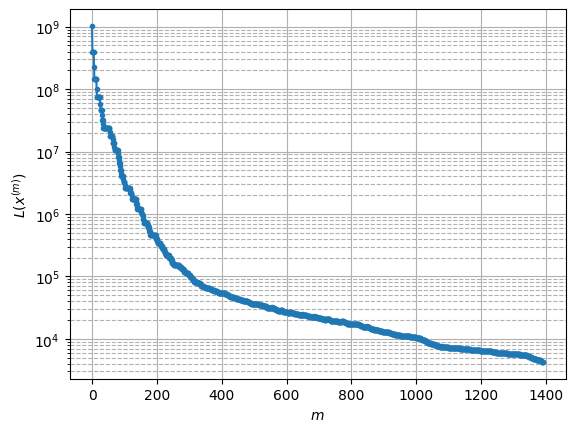

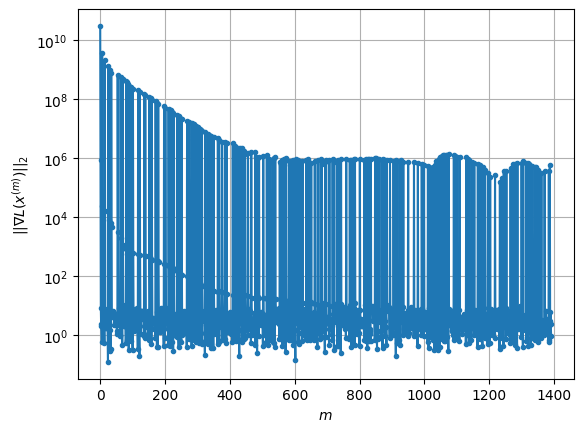

Windows:  28%|██▊       | 84/296 [53:48<52:31, 14.86s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4138.949895753751
Gradient norm: 474953.1596337688
Deviation from touching point norm = 0.0
Global relative error: 100.09105923288116
Position relative errors: 0.04007970716584419 m, 51.683824292492694 m, 49.47431750410105 m, 69.99492970624337 m

Iteration 1
Cost function: 4117.929174389356 (-0.51%)
Gradient norm: 5.467416949172805 (-100.00%)
Deviation from touching point norm = 0.5294845581800691 (529484558180.07%)
Global relative error = 99.88170104628493 (-0.21%)
Position relative errors: 0.046211588370526836 m, 51.683926813161136 m, 49.34084313624327 m, 69.78970146175465 m

Iteration 2
Cost function: 4117.929174945653 (0.00%)
Gradient norm: 4.341849234773911 (-20.59%)
Deviation from touching point norm = 0.52948454992256 (-0.00%)
Global relative error = 99.88170105634123 (0.00%)
Position relative errors: 0.04621158450196416 m, 51.6839268127863 m, 49.34084313013058 m, 69.78970148074882 m

Iteration 3

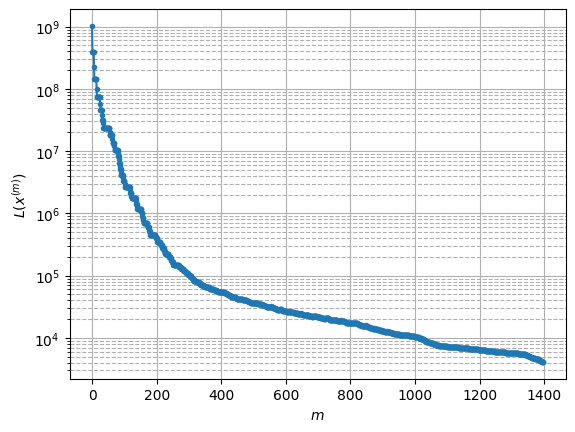

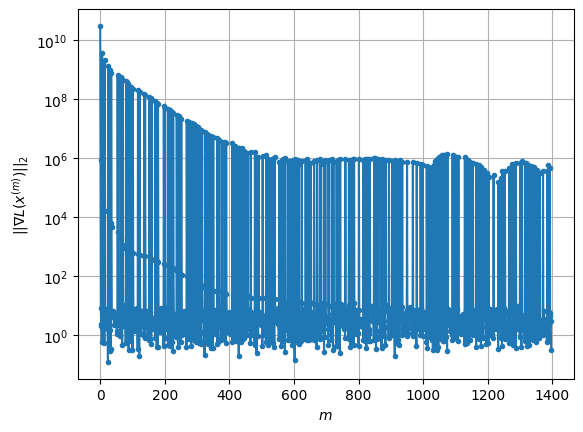

Windows:  29%|██▊       | 85/296 [54:00<49:26, 14.06s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4001.72406169288
Gradient norm: 435059.6851036996
Deviation from touching point norm = 0.0
Global relative error: 102.43414850038833
Position relative errors: 0.04571876275507764 m, 53.69155160454085 m, 50.89867600544424 m, 70.84696778997176 m

Iteration 1
Cost function: 3980.502775836646 (-0.53%)
Gradient norm: 3.4193223566946607 (-100.00%)
Deviation from touching point norm = 0.5533182210749704 (553318221074.97%)
Global relative error = 102.22631454523768 (-0.20%)
Position relative errors: 0.057175375784664514 m, 53.68439070815167 m, 50.75817323091754 m, 70.65273004932573 m

Iteration 2
Cost function: 3980.5027761206097 (0.00%)
Gradient norm: 3.6792720742248903 (7.60%)
Deviation from touching point norm = 0.5533182008466013 (-0.00%)
Global relative error = 102.22631455517202 (0.00%)
Position relative errors: 0.05717538077446053 m, 53.68439070823669 m, 50.758173224539554 m, 70.652730068213 m

STOP on I

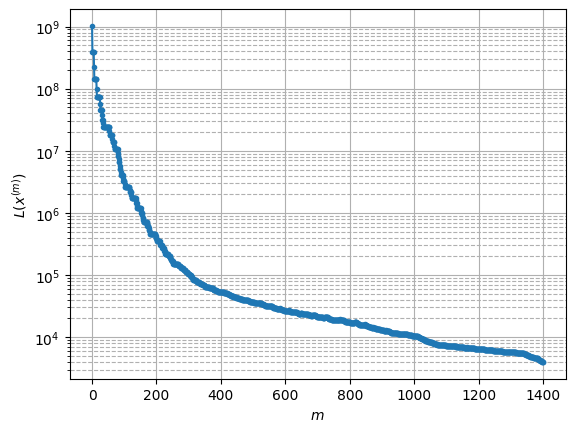

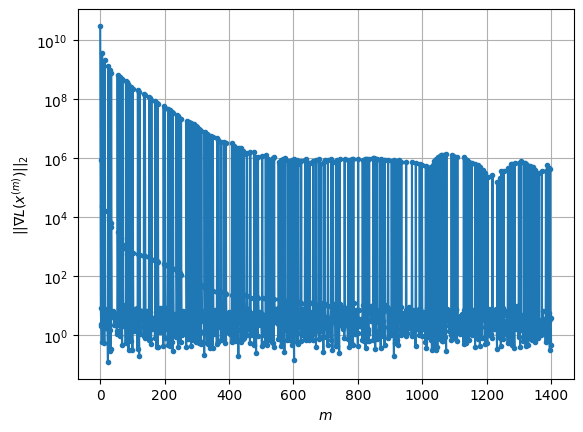

Windows:  29%|██▉       | 86/296 [54:10<44:37, 12.75s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3883.4760324420013
Gradient norm: 472610.7255474826
Deviation from touching point norm = 0.0
Global relative error: 104.34341249131116
Position relative errors: 0.05634474428301063 m, 55.45431182840108 m, 52.094512545919635 m, 71.40395128486867 m

Iteration 1
Cost function: 3863.7853434740637 (-0.51%)
Gradient norm: 6.9095277011616405 (-100.00%)
Deviation from touching point norm = 0.5372593617718383 (537259361771.84%)
Global relative error = 104.13723101572238 (-0.20%)
Position relative errors: 0.065586243532605 m, 55.43873477863918 m, 51.94489851186536 m, 71.22381230833085 m

STOP on Iteration 2
Cost function = 3863.7853431970407 (-0.00%)
Gradient norm = 0.4295602441806651 (-93.78%)
Deviation from touching point norm = 0.5372593495103845 (-0.00%)
Global relative error = 104.13723102506783 (0.00%)
Final position relative errors: 0.06558624361126061 m, 55.43873477882504 m, 51.94489850869895 m, 71.223812

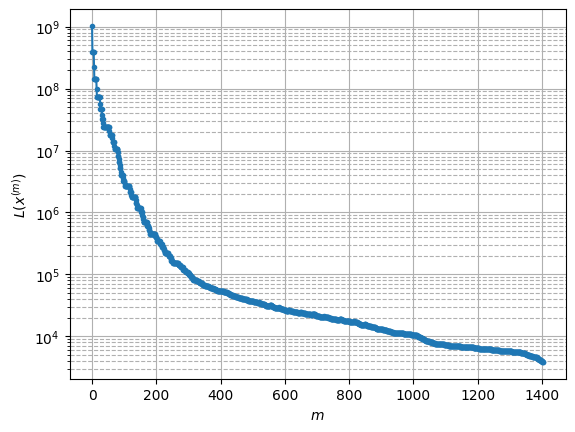

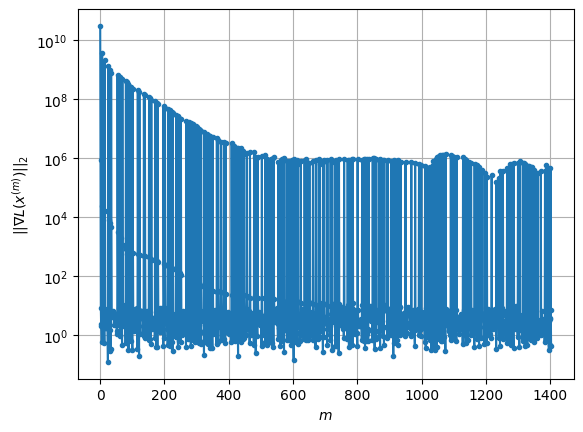

Windows:  29%|██▉       | 87/296 [54:17<38:54, 11.17s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3804.2743110522706
Gradient norm: 611745.6556578374
Deviation from touching point norm = 0.0
Global relative error: 105.81014859814515
Position relative errors: 0.06447036317102439 m, 56.96351080048004 m, 53.0556667440284 m, 71.66615058915693 m

Iteration 1
Cost function: 3785.4425171754997 (-0.50%)
Gradient norm: 3.3716237999493344 (-100.00%)
Deviation from touching point norm = 0.5304316710805607 (530431671080.56%)
Global relative error = 105.60737646076967 (-0.19%)
Position relative errors: 0.06096320155634011 m, 56.9394871684569 m, 52.90143370891718 m, 71.4999752142373 m

Iteration 2
Cost function: 3785.44251873299 (0.00%)
Gradient norm: 1.3627240562352816 (-59.58%)
Deviation from touching point norm = 0.5304316690710406 (-0.00%)
Global relative error = 105.60737646941446 (0.00%)
Position relative errors: 0.060963197346508825 m, 56.93948716973774 m, 52.9014337066565 m, 71.49997522766209 m

STOP on I

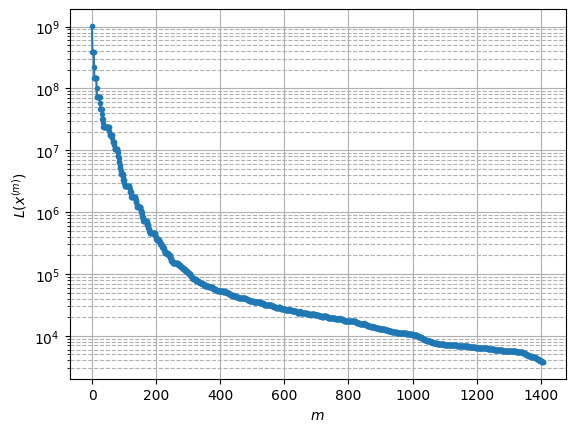

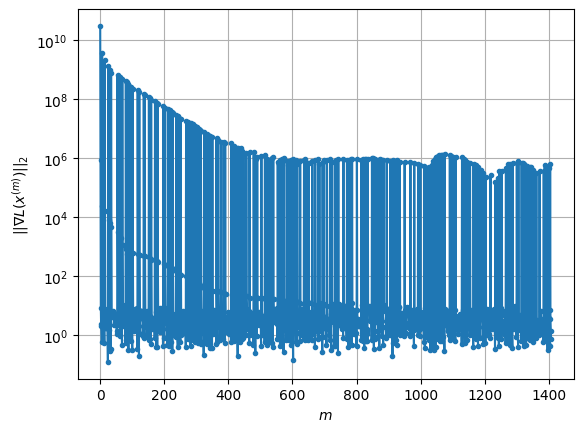

Windows:  30%|██▉       | 88/296 [54:27<36:59, 10.67s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3674.6609023156957
Gradient norm: 524682.4080565926
Deviation from touching point norm = 0.0
Global relative error: 106.82920909895265
Position relative errors: 0.060063650811312284 m, 58.21255388792833 m, 53.78300083582267 m, 71.63213746917833 m

Iteration 1
Cost function: 3652.88141085633 (-0.59%)
Gradient norm: 2.9098273573889917 (-100.00%)
Deviation from touching point norm = 0.5998741355642995 (599874135564.30%)
Global relative error = 106.63134141667732 (-0.19%)
Position relative errors: 0.06949370719566592 m, 58.18146884714201 m, 53.62754742721365 m, 71.47895081712873 m

Iteration 2
Cost function: 3652.881410266837 (-0.00%)
Gradient norm: 3.764437415171669 (29.37%)
Deviation from touching point norm = 0.5998741309606681 (-0.00%)
Global relative error = 106.63134142426826 (0.00%)
Position relative errors: 0.06949370935026068 m, 58.18146884885765 m, 53.62754742463978 m, 71.4789508289853 m

Iteratio

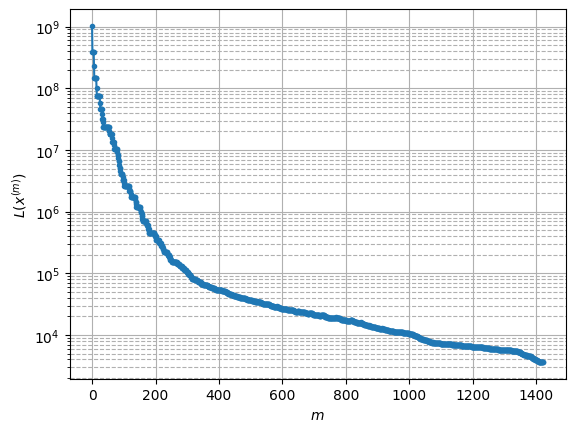

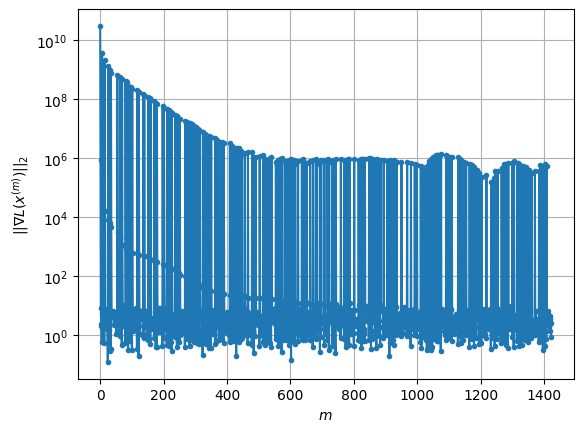

Windows:  30%|███       | 89/296 [55:01<1:01:25, 17.81s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3592.3155805937545
Gradient norm: 711954.0162607956
Deviation from touching point norm = 0.0
Global relative error: 107.39730286313589
Position relative errors: 0.06855925542682896 m, 59.19725668060766 m, 54.27681901252906 m, 71.30138366939778 m

Iteration 1
Cost function: 3570.7600178850503 (-0.60%)
Gradient norm: 5.481667935652976 (-100.00%)
Deviation from touching point norm = 0.5911044826346995 (591104482634.70%)
Global relative error = 107.20517102624088 (-0.18%)
Position relative errors: 0.0695864854870756 m, 59.16008156379501 m, 54.11847355673231 m, 71.16332666079687 m

Iteration 2
Cost function: 3570.7600180849654 (0.00%)
Gradient norm: 6.795006083641735 (23.96%)
Deviation from touching point norm = 0.5911044866333796 (0.00%)
Global relative error = 107.20517103277919 (0.00%)
Position relative errors: 0.06958647549568901 m, 59.160081565710975 m, 54.11847355495417 m, 71.16332667041583 m

Iteratio

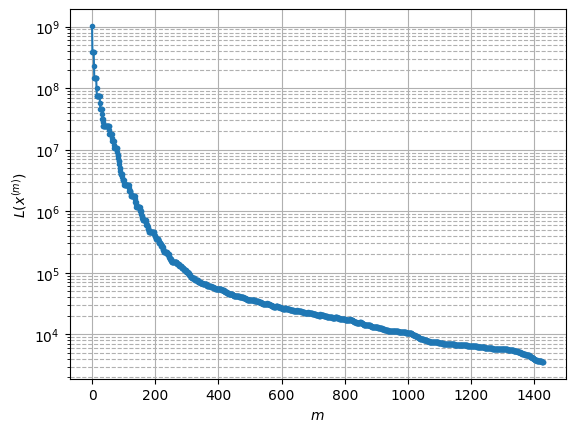

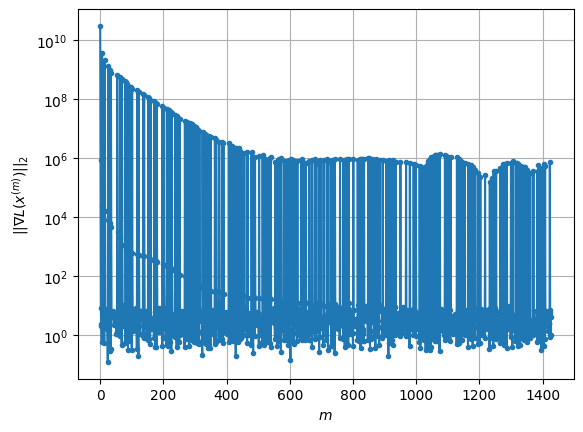

Windows:  30%|███       | 90/296 [55:13<55:07, 16.05s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3516.9764731361633
Gradient norm: 469624.91046718194
Deviation from touching point norm = 0.0
Global relative error: 107.51276208541421
Position relative errors: 0.0689129044276536 m, 59.91428804684038 m, 54.533832525244705 m, 70.67763567458672 m

Iteration 1
Cost function: 3495.472210293939 (-0.61%)
Gradient norm: 3.4914642374302187 (-100.00%)
Deviation from touching point norm = 0.5886832743197207 (588683274319.72%)
Global relative error = 107.32774491815609 (-0.17%)
Position relative errors: 0.0769957630270271 m, 59.87155108757431 m, 54.3791068295628 m, 70.5517451442574 m

Iteration 2
Cost function: 3495.4722106128434 (0.00%)
Gradient norm: 1.3965428279005605 (-60.00%)
Deviation from touching point norm = 0.5886832730896355 (-0.00%)
Global relative error = 107.3277449249957 (0.00%)
Position relative errors: 0.07699575500606382 m, 59.87155109043738 m, 54.37910682820159 m, 70.55174515329053 m

Iteratio

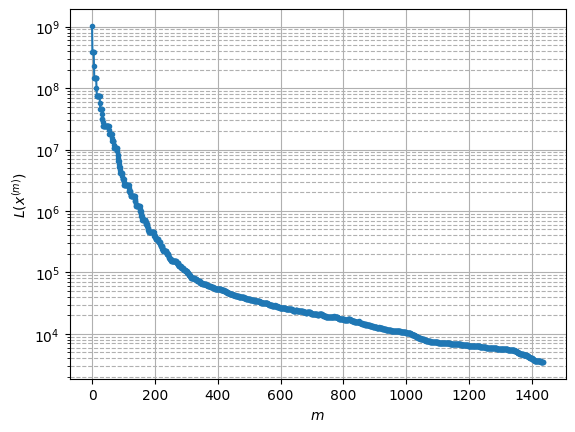

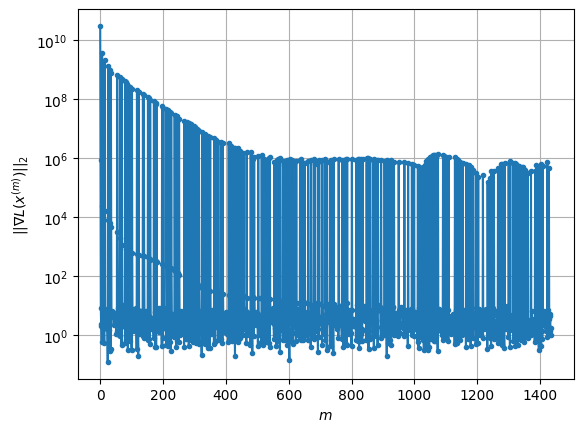

Windows:  31%|███       | 91/296 [55:32<57:42, 16.89s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3474.6923602981838
Gradient norm: 487006.79866449157
Deviation from touching point norm = 0.0
Global relative error: 107.17645637492234
Position relative errors: 0.07605893704912299 m, 60.361085909407436 m, 54.55927253648593 m, 69.76110520469034 m

Iteration 1
Cost function: 3452.538691173279 (-0.64%)
Gradient norm: 2.5904599767299965 (-100.00%)
Deviation from touching point norm = 0.5837570360268564 (583757036026.86%)
Global relative error = 106.99775615551687 (-0.17%)
Position relative errors: 0.07525581500736955 m, 60.31453710905781 m, 54.405555670353344 m, 69.64700988576695 m

Iteration 2
Cost function: 3452.5386903387916 (-0.00%)
Gradient norm: 1.7992772522204625 (-30.54%)
Deviation from touching point norm = 0.5837570313035659 (-0.00%)
Global relative error = 106.99775616246654 (0.00%)
Position relative errors: 0.07525582005929807 m, 60.31453711199933 m, 54.405555669280346 m, 69.64700989472898 m



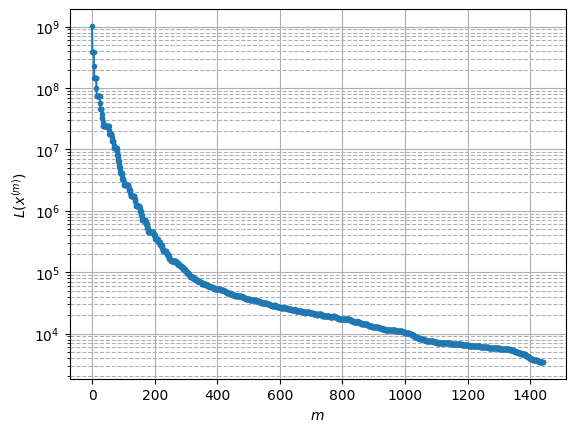

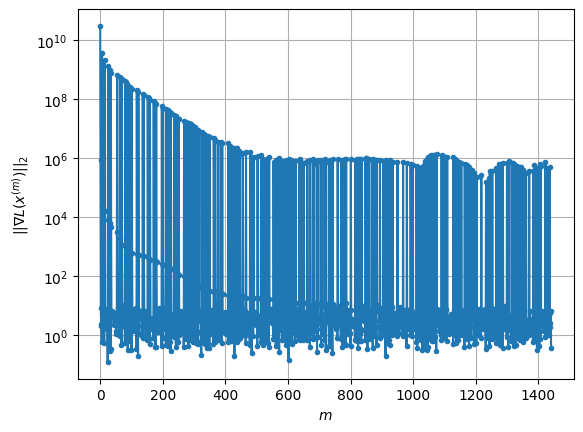

Windows:  31%|███       | 92/296 [55:46<54:48, 16.12s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3426.7626309480197
Gradient norm: 476973.41974060214
Deviation from touching point norm = 0.0
Global relative error: 106.38934702064428
Position relative errors: 0.07421861662259632 m, 60.5372346262964 m, 54.35079803564942 m, 68.55597110261674 m

Iteration 1
Cost function: 3403.7894418539026 (-0.67%)
Gradient norm: 7.810699637228824 (-100.00%)
Deviation from touching point norm = 0.5972676206202515 (597267620620.25%)
Global relative error = 106.21760326293423 (-0.16%)
Position relative errors: 0.0787222169980934 m, 60.48694394380386 m, 54.20119894336257 m, 68.4524086045654 m

Iteration 2
Cost function: 3403.7894408810826 (-0.00%)
Gradient norm: 7.041928010123222 (-9.84%)
Deviation from touching point norm = 0.5972676205797945 (-0.00%)
Global relative error = 106.21760326968823 (0.00%)
Position relative errors: 0.07872221287098884 m, 60.486943947261786 m, 54.20119894095325 m, 68.45240861390249 m

STOP on

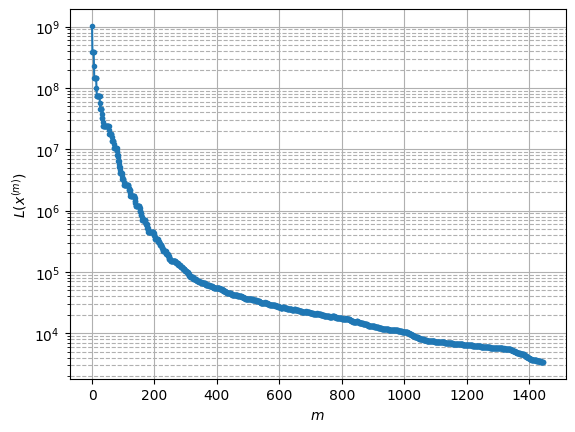

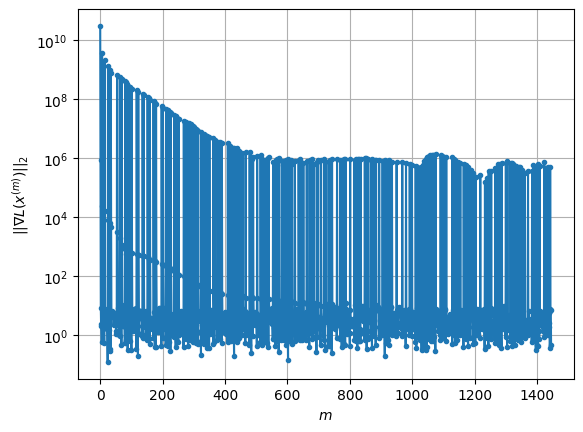

Windows:  31%|███▏      | 93/296 [55:56<48:04, 14.21s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3410.2249593663637
Gradient norm: 753776.0333566685
Deviation from touching point norm = 0.0
Global relative error: 105.15597658861492
Position relative errors: 0.07754505713629421 m, 60.441929445397 m, 53.912640791356594 m, 67.06692931594809 m

Iteration 1
Cost function: 3387.4165514262213 (-0.67%)
Gradient norm: 2.6780347098881028 (-100.00%)
Deviation from touching point norm = 0.566545863015144 (566545863015.14%)
Global relative error = 104.99147704232941 (-0.16%)
Position relative errors: 0.06654809100555617 m, 60.3901454658044 m, 53.76753270709375 m, 66.97229179243517 m

Iteration 2
Cost function: 3387.416548585436 (-0.00%)
Gradient norm: 1.302347639814898 (-51.37%)
Deviation from touching point norm = 0.5665458634210289 (0.00%)
Global relative error = 104.99147704945484 (0.00%)
Position relative errors: 0.06654808067880041 m, 60.39014546934662 m, 53.76753270427771 m, 66.9722918026826 m

Iteration 

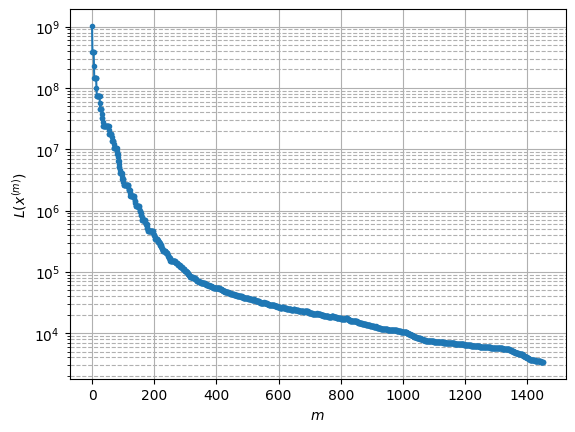

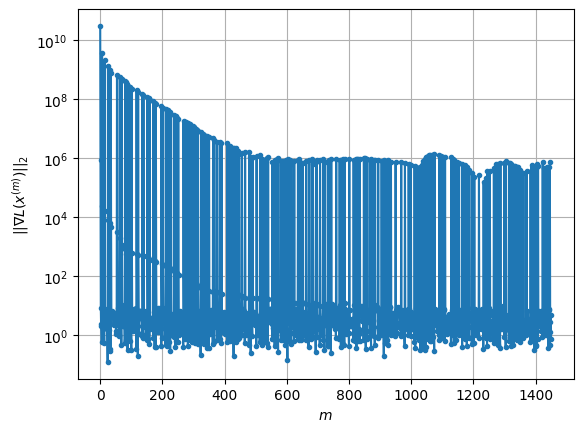

Windows:  32%|███▏      | 94/296 [56:08<46:01, 13.67s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3411.6756702564758
Gradient norm: 541622.6630069575
Deviation from touching point norm = 0.0
Global relative error: 103.48265697238148
Position relative errors: 0.06598132498777226 m, 60.07772637222704 m, 53.24739027473153 m, 65.29959470817315 m

Iteration 1
Cost function: 3389.1592837932103 (-0.66%)
Gradient norm: 1.6281630221265346 (-100.00%)
Deviation from touching point norm = 0.5423045553695732 (542304555369.57%)
Global relative error = 103.32464761680997 (-0.15%)
Position relative errors: 0.06199436813342854 m, 60.023961663724776 m, 53.107421461838236 m, 65.21275708862244 m

STOP on Iteration 2
Cost function = 3389.15928411891 (0.00%)
Gradient norm = 0.7987462069592534 (-50.94%)
Deviation from touching point norm = 0.5423045472322942 (-0.00%)
Global relative error = 103.32464762530931 (0.00%)
Final position relative errors: 0.061994364606962456 m, 60.0239616671917 m, 53.10742146006252 m, 65.212757

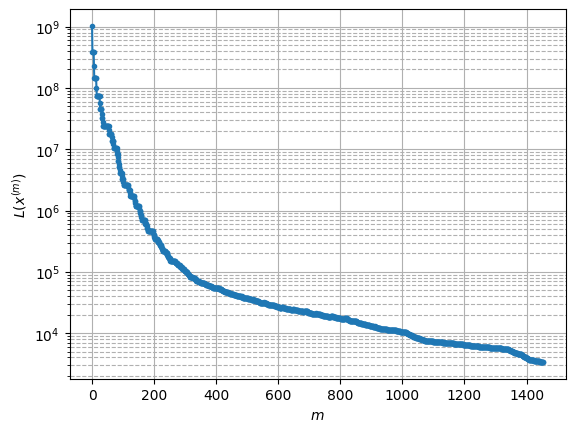

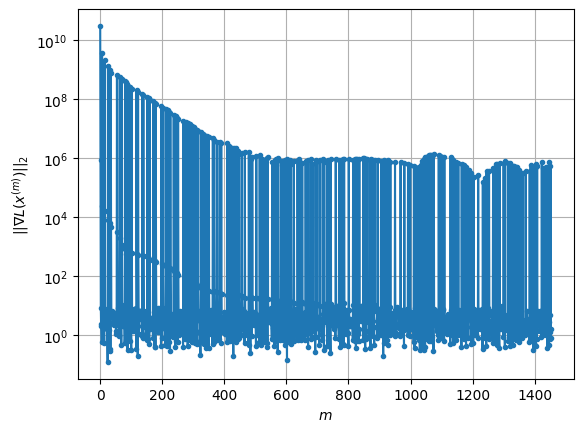

Windows:  32%|███▏      | 95/296 [56:16<39:31, 11.80s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3406.4265408935553
Gradient norm: 575344.1812707267
Deviation from touching point norm = 0.0
Global relative error: 101.37685091112186
Position relative errors: 0.06153804340241614 m, 59.44563718827836 m, 52.35913570545654 m, 63.261344193532246 m

Iteration 1
Cost function: 3387.364385344145 (-0.56%)
Gradient norm: 3.2576514685268596 (-100.00%)
Deviation from touching point norm = 0.4715888027172264 (471588802717.23%)
Global relative error = 101.22630731955505 (-0.15%)
Position relative errors: 0.05001682707378624 m, 59.39047034547936 m, 52.227557914154865 m, 63.18081556325633 m

Iteration 2
Cost function: 3387.3643831052423 (-0.00%)
Gradient norm: 2.4022035231001695 (-26.26%)
Deviation from touching point norm = 0.471588801369549 (-0.00%)
Global relative error = 101.22630732823683 (0.00%)
Position relative errors: 0.05001682176055654 m, 59.39047034875001 m, 52.22755791129049 m, 63.18081557646358 m

Ite

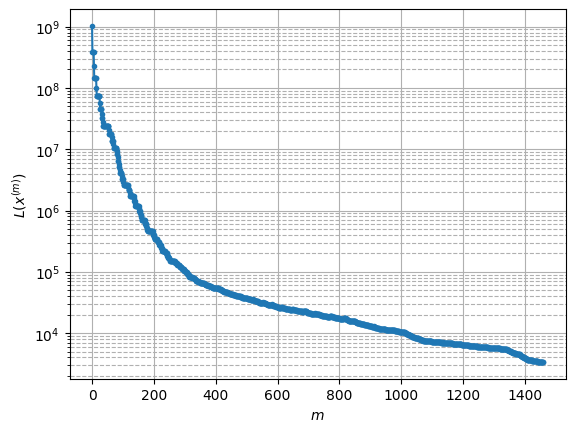

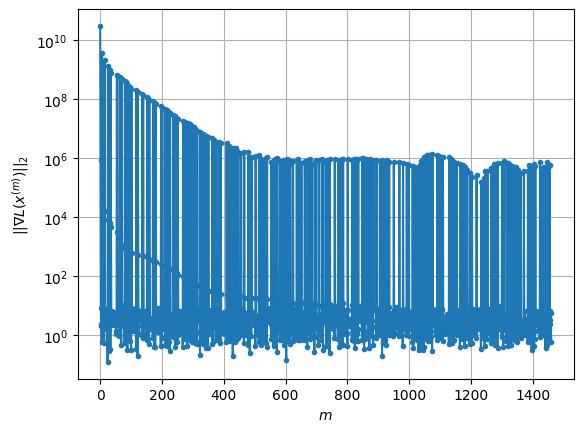

Windows:  32%|███▏      | 96/296 [56:30<42:05, 12.63s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3416.773823022883
Gradient norm: 538974.9951359887
Deviation from touching point norm = 0.0
Global relative error: 98.84964930336993
Position relative errors: 0.04999890277779307 m, 58.549090035110126 m, 51.255063970683345 m, 60.96040516907556 m

Iteration 1
Cost function: 3398.624793651576 (-0.53%)
Gradient norm: 4.534979273944966 (-100.00%)
Deviation from touching point norm = 0.41931984137390693 (419319841373.91%)
Global relative error = 98.70566222311325 (-0.15%)
Position relative errors: 0.03710561296794577 m, 58.49358370699243 m, 51.130642875457916 m, 60.88482791544645 m

Iteration 2
Cost function: 3398.6247918085164 (-0.00%)
Gradient norm: 5.661298829090285 (24.84%)
Deviation from touching point norm = 0.4193198373338869 (-0.00%)
Global relative error = 98.70566223369563 (0.00%)
Position relative errors: 0.03710561044469621 m, 58.49358371080675 m, 51.1306428725727 m, 60.884827931362494 m

Iterati

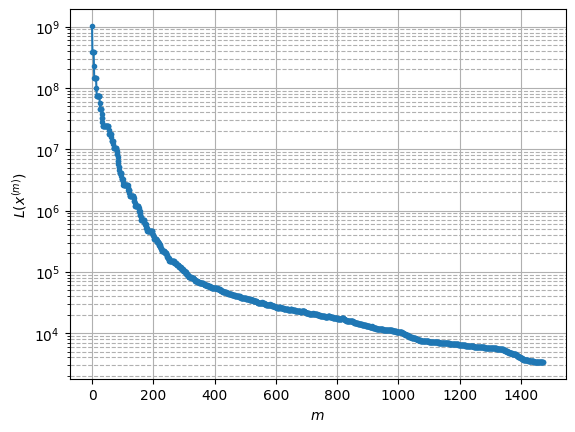

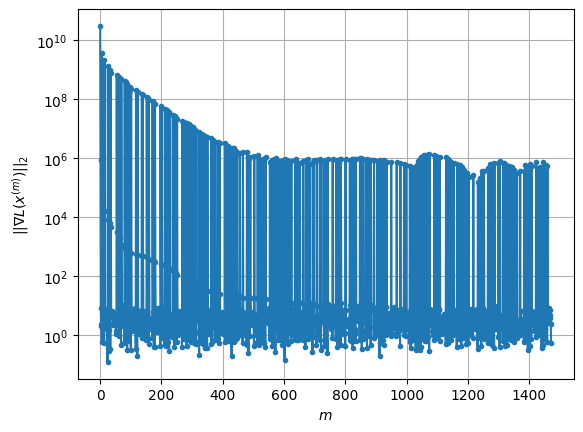

Windows:  33%|███▎      | 97/296 [57:01<59:52, 18.05s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3437.8323622324006
Gradient norm: 629632.6479656544
Deviation from touching point norm = 0.0
Global relative error: 95.91237219334045
Position relative errors: 0.03741016423727829 m, 57.39332970030863 m, 49.93901685283229 m, 58.4061576131232 m

Iteration 1
Cost function: 3419.2511655123353 (-0.54%)
Gradient norm: 1.4877011714854544 (-100.00%)
Deviation from touching point norm = 0.39078262263034635 (390782622630.35%)
Global relative error = 95.77437250718063 (-0.14%)
Position relative errors: 0.029438640573963913 m, 57.33733197887371 m, 49.82204145752029 m, 58.33456373968144 m

Iteration 2
Cost function: 3419.2511658548297 (0.00%)
Gradient norm: 1.0665824492707516 (-28.31%)
Deviation from touching point norm = 0.3907826134864678 (-0.00%)
Global relative error = 95.7743725187498 (0.00%)
Position relative errors: 0.029438640325991187 m, 57.337331981809605 m, 49.82204145412615 m, 58.33456375868914 m

STOP 

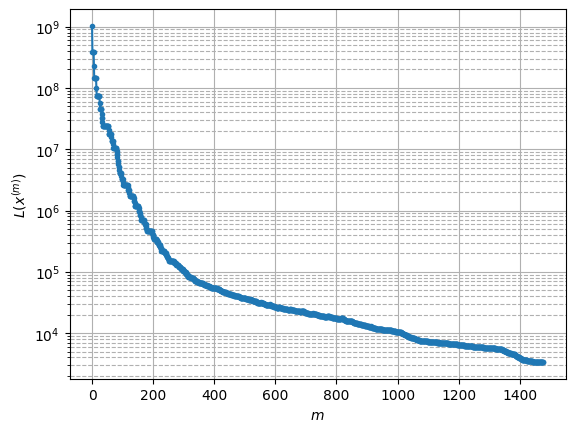

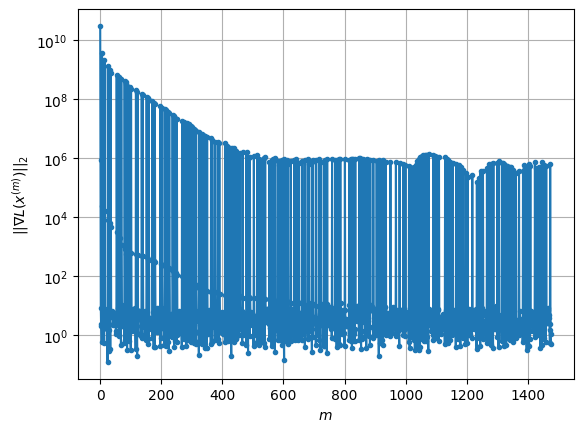

Windows:  33%|███▎      | 98/296 [57:11<51:27, 15.59s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3440.5091262775672
Gradient norm: 623880.3978146098
Deviation from touching point norm = 0.0
Global relative error: 92.57886433439297
Position relative errors: 0.029829610222040306 m, 55.9835797868496 m, 48.417779438051554 m, 55.60934403409142 m

Iteration 1
Cost function: 3421.970257460606 (-0.54%)
Gradient norm: 3.2228017776895945 (-100.00%)
Deviation from touching point norm = 0.37960203406939275 (379602034069.39%)
Global relative error = 92.44742275525552 (-0.14%)
Position relative errors: 0.02420640676926681 m, 55.92669108224976 m, 48.311180967677565 m, 55.540587903016714 m

Iteration 2
Cost function: 3421.970258797988 (0.00%)
Gradient norm: 5.552924025716587 (72.30%)
Deviation from touching point norm = 0.379602021930517 (-0.00%)
Global relative error = 92.44742276666359 (0.00%)
Position relative errors: 0.024206407628651606 m, 55.92669108435008 m, 48.311180963812774 m, 55.54058792325189 m

Iterat

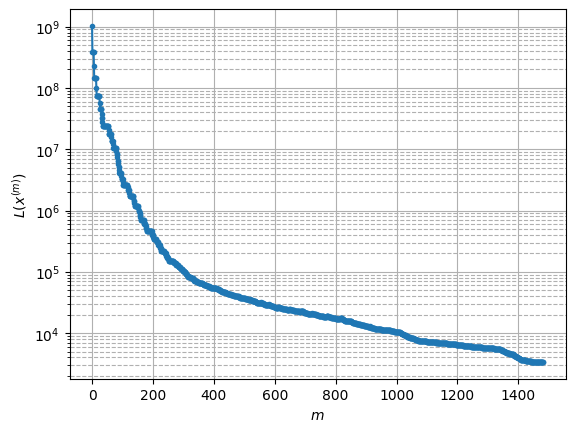

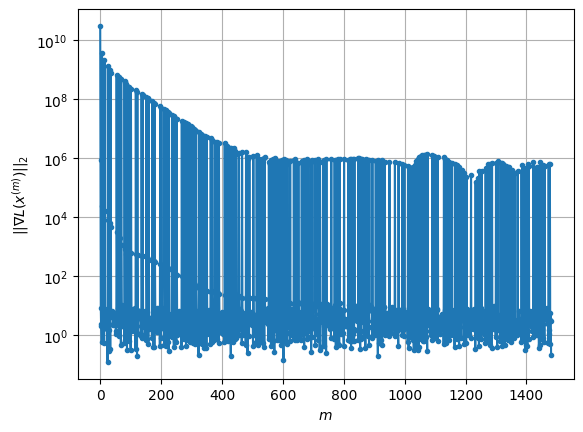

Windows:  33%|███▎      | 99/296 [57:23<48:02, 14.63s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3415.5171837594257
Gradient norm: 526494.423868213
Deviation from touching point norm = 0.0
Global relative error: 88.86609677789984
Position relative errors: 0.02413337937387448 m, 54.325934163788496 m, 46.701794932072445 m, 52.58149396963014 m

STOP on Iteration 1
Cost function = 3400.2052250841434 (-0.45%)
Gradient norm = 0.927846034878415 (-100.00%)
Deviation from touching point norm = 0.3464335722207186 (346433572220.72%)
Global relative error = 88.74200793265669 (-0.14%)
Final position relative errors: 0.020563688433929736 m, 54.2668755594031 m, 46.605084607148875 m, 52.5186783779611 m

Majorization-Minimization converged after 1 iterations


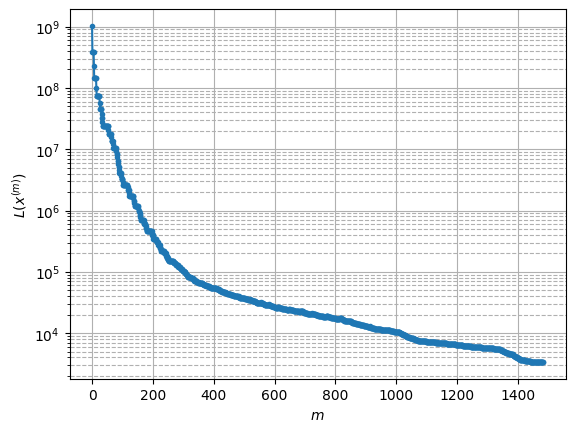

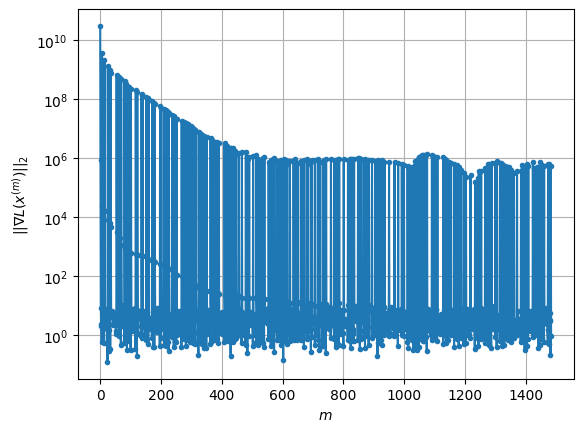

Windows:  34%|███▍      | 100/296 [57:29<38:33, 11.80s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3395.783181603965
Gradient norm: 570164.9313603768
Deviation from touching point norm = 0.0
Global relative error: 84.79314908759
Position relative errors: 0.01997108809390759 m, 52.42679314967611 m, 44.798838966253065 m, 49.33931504384348 m

Iteration 1
Cost function: 3381.0086327160634 (-0.44%)
Gradient norm: 2.6426954297577065 (-100.00%)
Deviation from touching point norm = 0.34284573568899057 (342845735688.99%)
Global relative error = 84.6766656580769 (-0.14%)
Position relative errors: 0.02331044858663632 m, 52.36506213926078 m, 44.71172441980491 m, 49.28381111553027 m

STOP on Iteration 2
Cost function = 3381.0086334365897 (0.00%)
Gradient norm = 0.41958489431119944 (-84.12%)
Deviation from touching point norm = 0.34284573333448337 (-0.00%)
Global relative error = 84.67666566971006 (0.00%)
Final position relative errors: 0.023310447625254378 m, 52.365062141257006 m, 44.71172441539253 m, 49.28381113

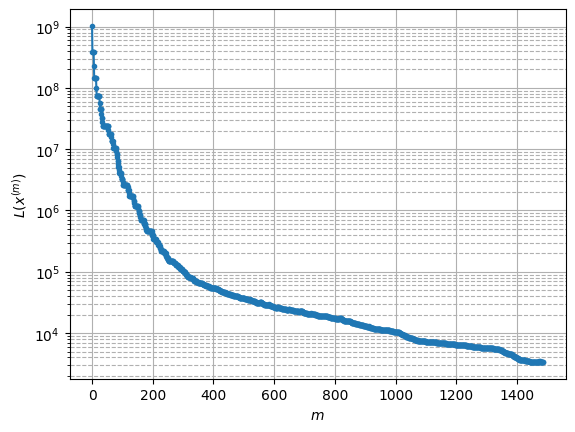

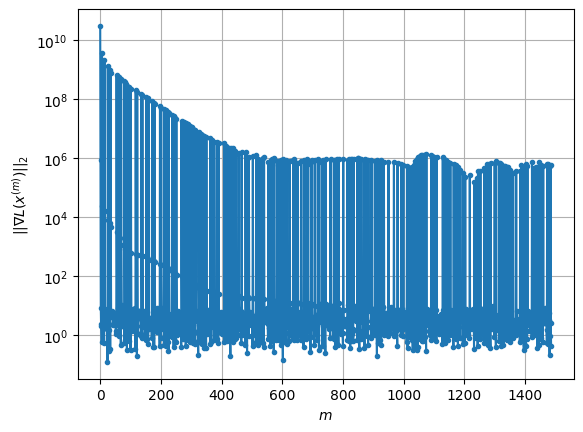

Windows:  34%|███▍      | 101/296 [57:36<34:23, 10.58s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3360.3308300445424
Gradient norm: 520640.6178125466
Deviation from touching point norm = 0.0
Global relative error: 80.38060342476936
Position relative errors: 0.021571910276753186 m, 50.294517967688634 m, 42.7179505705939 m, 45.898509200080795 m

Iteration 1
Cost function: 3344.847626631398 (-0.46%)
Gradient norm: 1.2250015198621254 (-100.00%)
Deviation from touching point norm = 0.3759825681234072 (375982568123.41%)
Global relative error = 80.27317977593351 (-0.13%)
Position relative errors: 0.023264091234121667 m, 50.23250935827527 m, 42.64044316175692 m, 45.850458299955086 m

STOP on Iteration 2
Cost function = 3344.847626193211 (-0.00%)
Gradient norm = 0.9347669805600198 (-23.69%)
Deviation from touching point norm = 0.3759825624476624 (-0.00%)
Global relative error = 80.2731797869089 (0.00%)
Final position relative errors: 0.023264094860778763 m, 50.23250935991651 m, 42.64044315658506 m, 45.850458

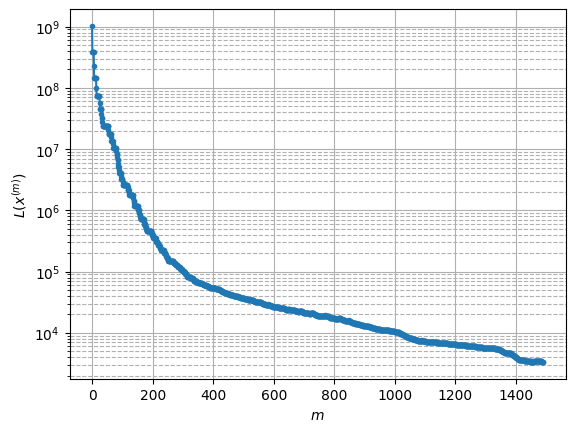

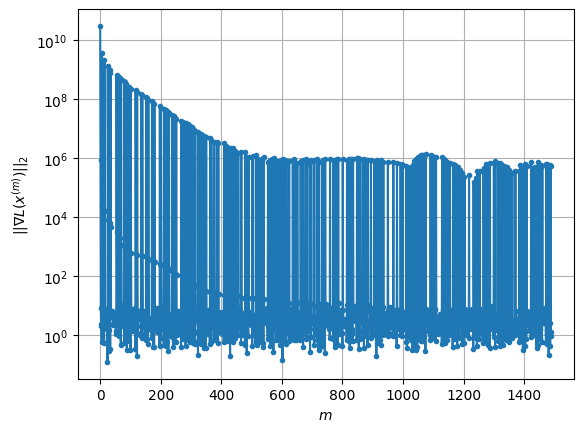

Windows:  34%|███▍      | 102/296 [57:44<31:20,  9.69s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3329.8388558557144
Gradient norm: 531640.3420528668
Deviation from touching point norm = 0.0
Global relative error: 75.65232347628931
Position relative errors: 0.021576355521899584 m, 47.94151294524101 m, 40.4693605023407 m, 42.27421160557032 m

Iteration 1
Cost function: 3315.5639887248253 (-0.43%)
Gradient norm: 1.358636504106278 (-100.00%)
Deviation from touching point norm = 0.3633802806227747 (363380280622.77%)
Global relative error = 75.55293373823689 (-0.13%)
Position relative errors: 0.023580532009315074 m, 47.877765906835215 m, 40.40012746876775 m, 42.23491073816486 m

Iteration 2
Cost function: 3315.5639870620303 (-0.00%)
Gradient norm: 1.8201186337675057 (33.97%)
Deviation from touching point norm = 0.3633802776681186 (-0.00%)
Global relative error = 75.55293374904282 (0.00%)
Position relative errors: 0.023580540629603505 m, 47.877765908924204 m, 40.40012746404374 m, 42.23491075964118 m

Iter

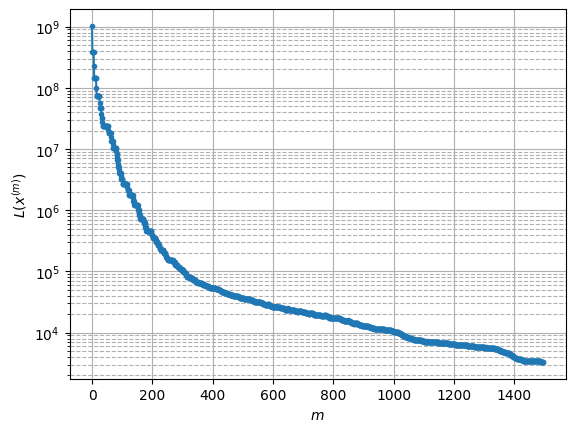

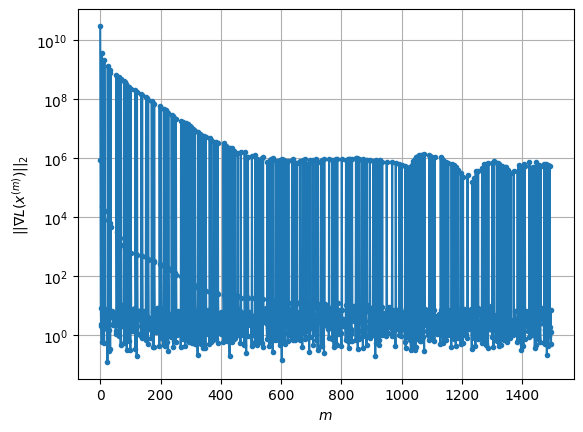

Windows:  35%|███▍      | 103/296 [57:58<35:48, 11.13s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3265.2072577912795
Gradient norm: 446968.3766240254
Deviation from touching point norm = 0.0
Global relative error: 70.63189945175566
Position relative errors: 0.02152310980715752 m, 45.37732787254078 m, 38.06275055265133 m, 38.48353191972309 m

Iteration 1
Cost function: 3250.5817277713886 (-0.45%)
Gradient norm: 5.4712340895308404 (-100.00%)
Deviation from touching point norm = 0.4100718428534054 (410071842853.41%)
Global relative error = 70.54323879389877 (-0.13%)
Position relative errors: 0.02503638073962974 m, 45.3116215582082 m, 38.001153050985344 m, 38.459193886058586 m

STOP on Iteration 2
Cost function = 3250.5817270419025 (-0.00%)
Gradient norm = 0.42441262779243966 (-92.24%)
Deviation from touching point norm = 0.4100718442142814 (0.00%)
Global relative error = 70.54323880357295 (0.00%)
Final position relative errors: 0.025036393243224767 m, 45.31162155969408 m, 38.00115304560592 m, 38.459193

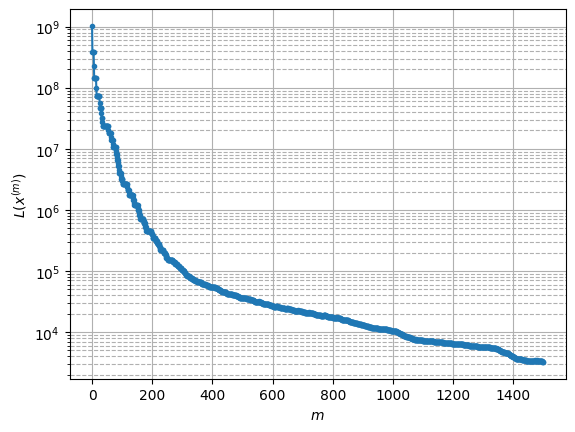

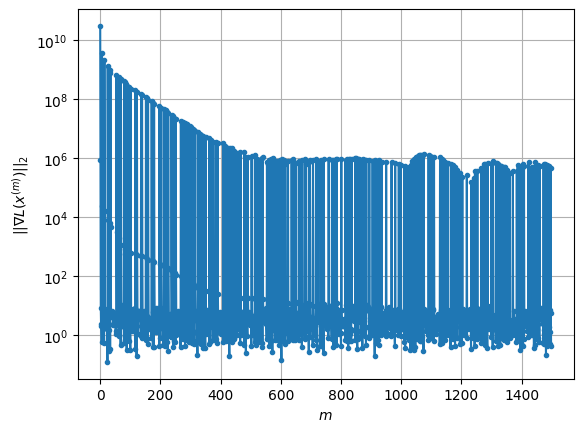

Windows:  35%|███▌      | 104/296 [58:06<32:07, 10.04s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3187.962422651528
Gradient norm: 462412.82566427864
Deviation from touching point norm = 0.0
Global relative error: 65.34922006206502
Position relative errors: 0.022837770307085326 m, 42.61376407760199 m, 35.50963667271924 m, 34.5491586009372 m

Iteration 1
Cost function: 3171.6474418225457 (-0.51%)
Gradient norm: 1.4838085480898813 (-100.00%)
Deviation from touching point norm = 0.4726916606047549 (472691660604.75%)
Global relative error = 65.27352479759718 (-0.12%)
Position relative errors: 0.020805669487706097 m, 42.548264274111794 m, 35.45710927806928 m, 34.54074040902138 m

Iteration 2
Cost function: 3171.6474405992117 (-0.00%)
Gradient norm: 1.0154508151193047 (-31.56%)
Deviation from touching point norm = 0.4726916576893691 (-0.00%)
Global relative error = 65.27352480616999 (0.00%)
Position relative errors: 0.02080566647756312 m, 42.54826427524835 m, 35.45710927284362 m, 34.540740429187956 m

Ite

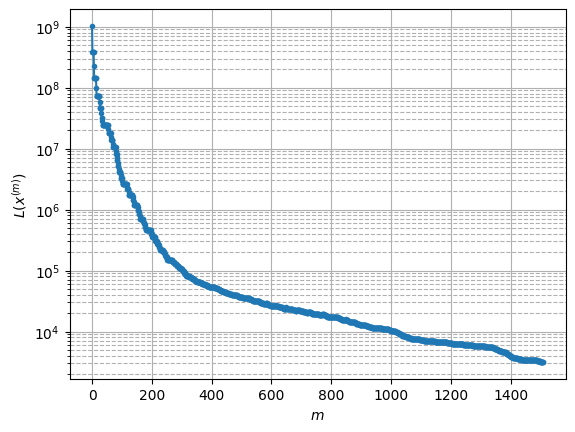

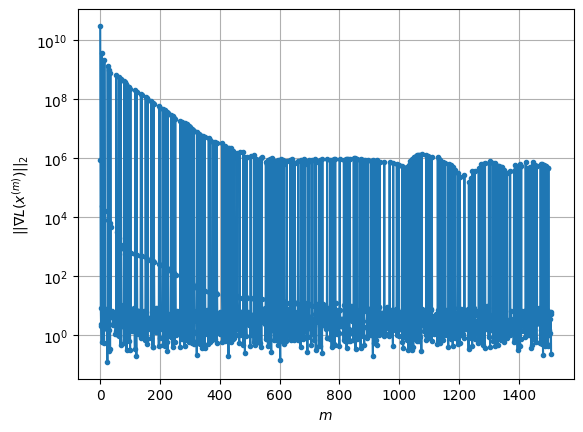

Windows:  35%|███▌      | 105/296 [58:30<44:57, 14.12s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3129.303242648536
Gradient norm: 490494.8556906172
Deviation from touching point norm = 0.0
Global relative error: 59.83689076206727
Position relative errors: 0.018976712140334886 m, 39.665891737394546 m, 32.824816759821 m, 30.48921578052115 m

Iteration 1
Cost function: 3114.112025417769 (-0.49%)
Gradient norm: 1.712999851855346 (-100.00%)
Deviation from touching point norm = 0.4583516239794097 (458351623979.41%)
Global relative error = 59.77269271200187 (-0.11%)
Position relative errors: 0.015431082399507653 m, 39.597108562321154 m, 32.78390688624179 m, 30.496716777832578 m

Iteration 2
Cost function: 3114.112026472729 (0.00%)
Gradient norm: 6.3804939655830255 (272.47%)
Deviation from touching point norm = 0.4583516107125615 (-0.00%)
Global relative error = 59.77269271864059 (0.00%)
Position relative errors: 0.015431086123116505 m, 39.59710856358575 m, 32.7839068806665 m, 30.496716795193837 m

Iterati

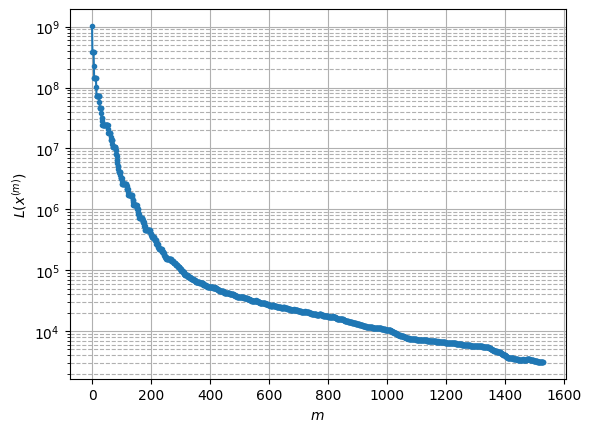

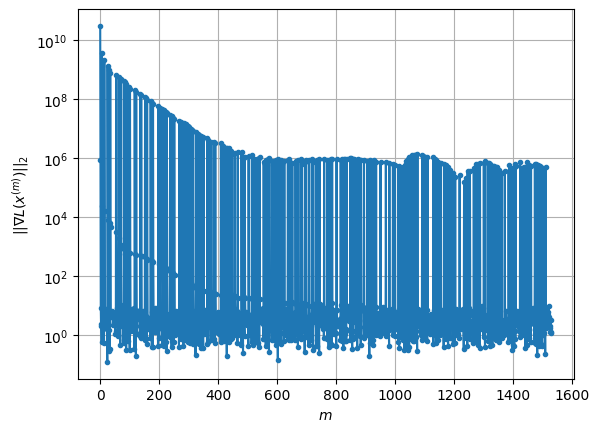

Windows:  36%|███▌      | 106/296 [59:17<1:16:16, 24.09s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3038.7172280955942
Gradient norm: 383984.69365908345
Deviation from touching point norm = 0.0
Global relative error: 54.127985399990486
Position relative errors: 0.014036354538543573 m, 36.543897278016225 m, 30.02538595043611 m, 26.32201229541655 m

Iteration 1
Cost function: 3022.8374315034816 (-0.52%)
Gradient norm: 2.3484107482012884 (-100.00%)
Deviation from touching point norm = 0.4869098715124034 (486909871512.40%)
Global relative error = 54.077339202132976 (-0.09%)
Position relative errors: 0.016606504965558568 m, 36.473891903112204 m, 29.994695370648362 m, 26.349986419332975 m

STOP on Iteration 2
Cost function = 3022.8374316752406 (0.00%)
Gradient norm = 0.17935122985047028 (-92.36%)
Deviation from touching point norm = 0.48690987533654156 (0.00%)
Global relative error = 54.07733920788301 (0.00%)
Final position relative errors: 0.016606497200148226 m, 36.47389190377517 m, 29.994695364840947 m, 

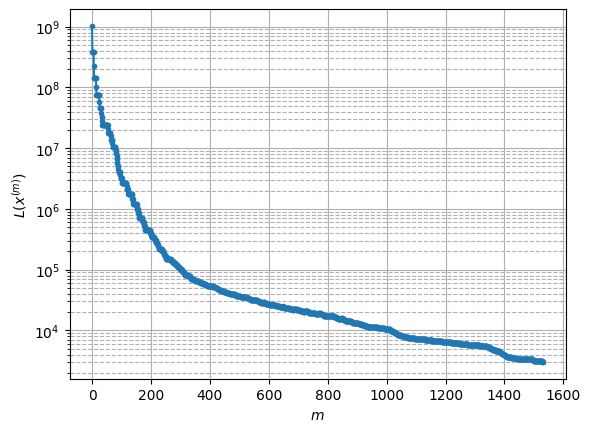

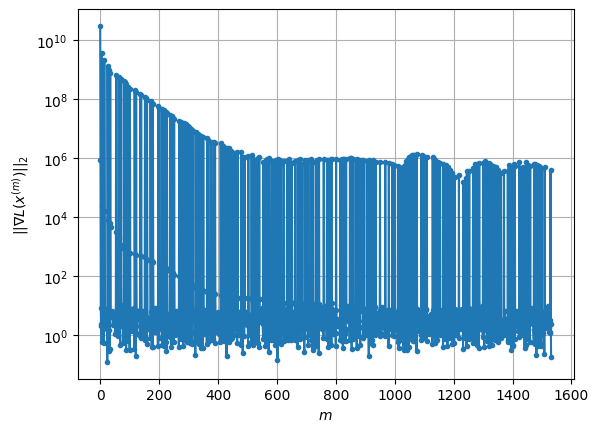

Windows:  36%|███▌      | 107/296 [59:25<1:00:28, 19.20s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2949.2037103671505
Gradient norm: 395780.0484469236
Deviation from touching point norm = 0.0
Global relative error: 48.26495412770155
Position relative errors: 0.01526291926020191 m, 33.2642766510129 m, 27.125752054637637 m, 22.072070639945395 m

Iteration 1
Cost function: 2934.3287923786147 (-0.50%)
Gradient norm: 3.9826635378092297 (-100.00%)
Deviation from touching point norm = 0.47440074231427637 (474400742314.28%)
Global relative error = 48.22578243182283 (-0.08%)
Position relative errors: 0.018965777649539526 m, 33.194067293600625 m, 27.102558044965736 m, 22.1205848021255 m

Iteration 2
Cost function: 2934.3287923429193 (-0.00%)
Gradient norm: 10.991196681944329 (175.98%)
Deviation from touching point norm = 0.47440073890492995 (-0.00%)
Global relative error = 48.22578243591808 (0.00%)
Position relative errors: 0.018965781642209203 m, 33.194067294824805 m, 27.102558039089526 m, 22.120584816412865 

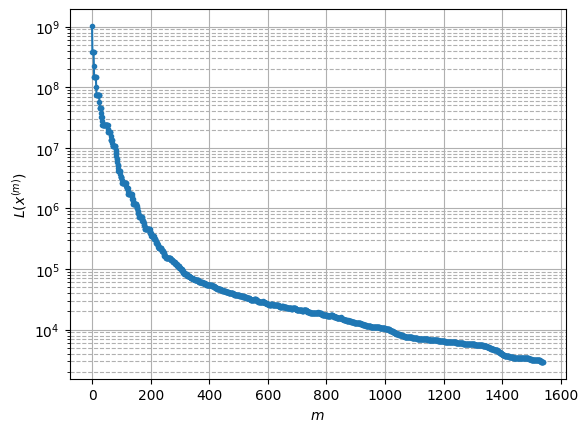

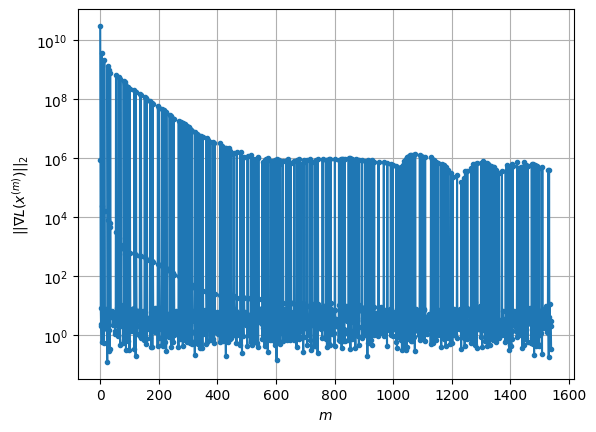

Windows:  36%|███▋      | 108/296 [59:44<1:00:32, 19.32s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2886.142635502154
Gradient norm: 478723.3804243083
Deviation from touching point norm = 0.0
Global relative error: 42.2952562760518
Position relative errors: 0.017185663246995973 m, 29.843329777620475 m, 24.139974954037143 m, 17.762723073642178 m

Iteration 1
Cost function: 2871.8230044179772 (-0.50%)
Gradient norm: 2.1722002706974273 (-100.00%)
Deviation from touching point norm = 0.4636143863034357 (463614386303.44%)
Global relative error = 42.26686998681565 (-0.07%)
Position relative errors: 0.009797185071432941 m, 29.77232097020087 m, 24.12486399896396 m, 17.834705577603394 m

Iteration 2
Cost function: 2871.8230043768767 (-0.00%)
Gradient norm: 2.9702078766517954 (36.74%)
Deviation from touching point norm = 0.46361439709297336 (0.00%)
Global relative error = 42.266869990563556 (0.00%)
Position relative errors: 0.009797187149004405 m, 29.772320971383245 m, 24.1248639931996 m, 17.834705592308115 m



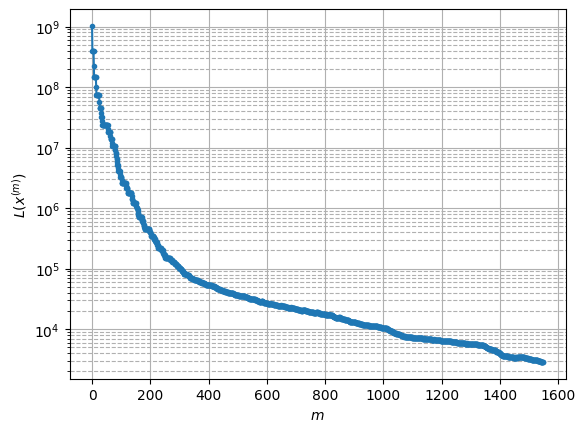

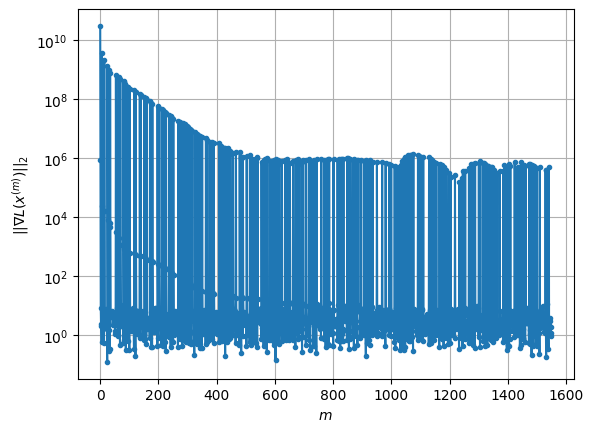

Windows:  37%|███▋      | 109/296 [1:00:07<1:02:56, 20.20s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2823.7791442720813
Gradient norm: 286807.92836851696
Deviation from touching point norm = 0.0
Global relative error: 36.284651340904816
Position relative errors: 0.009350055894012044 m, 26.29628110530485 m, 21.08892719051548 m, 13.428577589203575 m

Iteration 1
Cost function: 2810.551994553602 (-0.47%)
Gradient norm: 1.7793905892240458 (-100.00%)
Deviation from touching point norm = 0.43516624463486847 (435166244634.87%)
Global relative error = 36.26689596742344 (-0.05%)
Position relative errors: 0.008282535746997808 m, 26.225122297487086 m, 21.081725869426585 m, 13.53069157094162 m

Iteration 2
Cost function: 2810.551994560123 (0.00%)
Gradient norm: 2.7333777231546157 (53.61%)
Deviation from touching point norm = 0.43516624681109445 (0.00%)
Global relative error = 36.2668959689071 (0.00%)
Position relative errors: 0.008282527470354602 m, 26.225122298491673 m, 21.08172586364478 m, 13.53069158198473 m

I

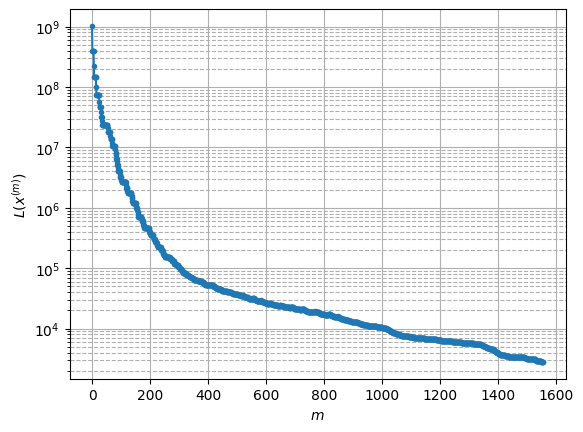

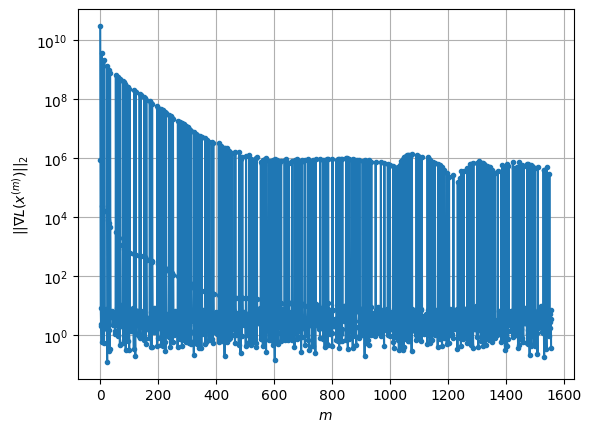

Windows:  37%|███▋      | 110/296 [1:00:24<59:40, 19.25s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2763.3880645401264
Gradient norm: 317930.24099616427
Deviation from touching point norm = 0.0
Global relative error: 30.3312840882634
Position relative errors: 0.00753853255334292 m, 22.640621028794047 m, 17.997342211230894 m, 9.136320787464625 m

Iteration 1
Cost function: 2750.6662568361385 (-0.46%)
Gradient norm: 3.422454990627885 (-100.00%)
Deviation from touching point norm = 0.4190274641920745 (419027464192.07%)
Global relative error = 30.325357881580814 (-0.02%)
Position relative errors: 0.0042784479297307285 m, 22.5714241673522 m, 17.997490875299412 m, 9.286341992158173 m

Iteration 2
Cost function: 2750.666256346564 (-0.00%)
Gradient norm: 2.4836046970274532 (-27.43%)
Deviation from touching point norm = 0.419027472143147 (0.00%)
Global relative error = 30.325357883297745 (0.00%)
Position relative errors: 0.004278452473118114 m, 22.571424168538513 m, 17.997490870196334 m, 9.286342004769425 m

I

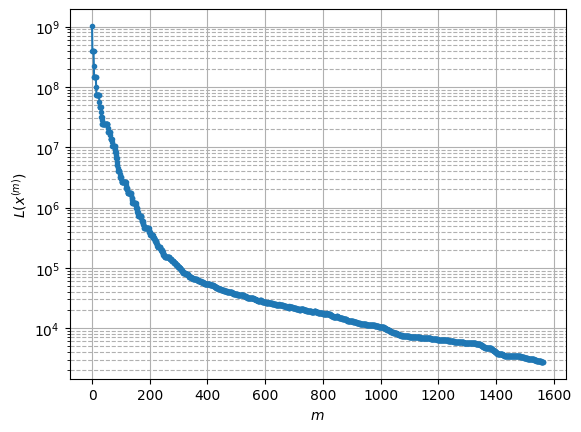

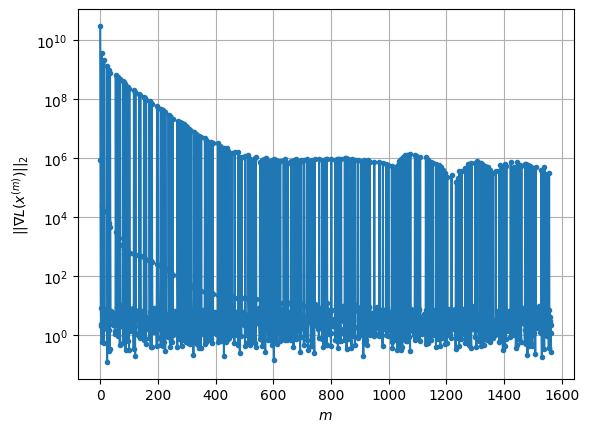

Windows:  38%|███▊      | 111/296 [1:00:43<59:24, 19.27s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2733.6767212340083
Gradient norm: 360797.477862898
Deviation from touching point norm = 0.0
Global relative error: 24.602176978343625
Position relative errors: 0.004062043956120526 m, 18.89637265523919 m, 14.899262248992219 m, 5.117958886083066 m

Iteration 1
Cost function: 2721.7926002295108 (-0.43%)
Gradient norm: 1.987785161197824 (-100.00%)
Deviation from touching point norm = 0.3873879428383334 (387387942838.33%)
Global relative error = 24.59980491314106 (-0.01%)
Position relative errors: 0.008773015371568901 m, 18.82578221298047 m, 14.910338122796684 m, 5.330049147634342 m

STOP on Iteration 2
Cost function = 2721.79260067356 (0.00%)
Gradient norm = 0.7300101923888552 (-63.28%)
Deviation from touching point norm = 0.38738794680659816 (0.00%)
Global relative error = 24.599804911641765 (-0.00%)
Final position relative errors: 0.008773008163631473 m, 18.82578221407879 m, 14.910338117154419 m, 5.33004

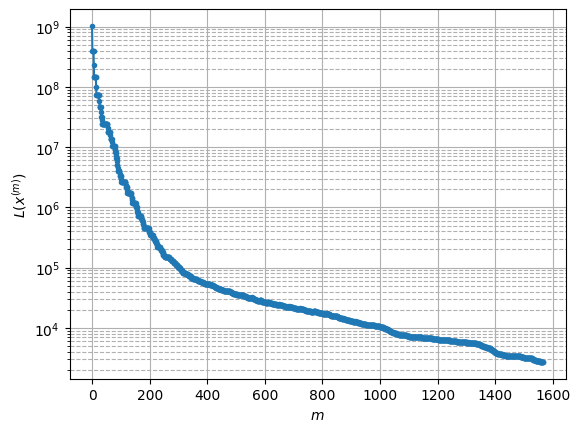

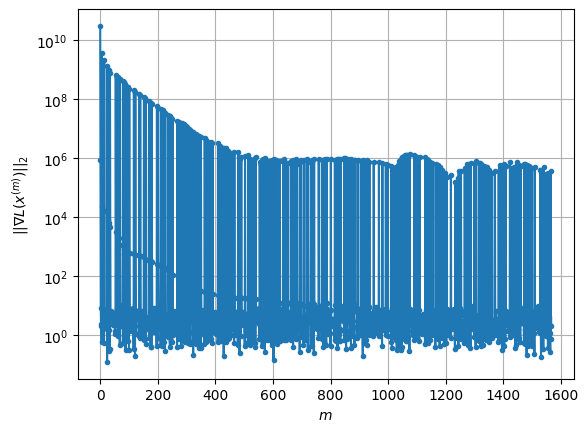

Windows:  38%|███▊      | 112/296 [1:00:50<48:16, 15.74s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2703.7317593442467
Gradient norm: 389450.18265362066
Deviation from touching point norm = 0.0
Global relative error: 19.407791975643953
Position relative errors: 0.008956874913647678 m, 15.078810208658787 m, 11.85488724103262 m, 2.9564376094122484 m

Iteration 1
Cost function: 2691.8571112607647 (-0.44%)
Gradient norm: 2.4081307854293095 (-100.00%)
Deviation from touching point norm = 0.3757692199020954 (375769219902.10%)
Global relative error = 19.410996808468354 (0.02%)
Position relative errors: 0.016671832104787156 m, 15.009120772616374 m, 11.873827555361007 m, 3.242244579217896 m

Iteration 2
Cost function: 2691.857112087254 (0.00%)
Gradient norm: 3.6237003943449504 (50.48%)
Deviation from touching point norm = 0.3757692242592797 (0.00%)
Global relative error = 19.4109968079979 (-0.00%)
Position relative errors: 0.016671833397902267 m, 15.009120774298804 m, 11.873827552981428 m, 3.2422445773207147 m

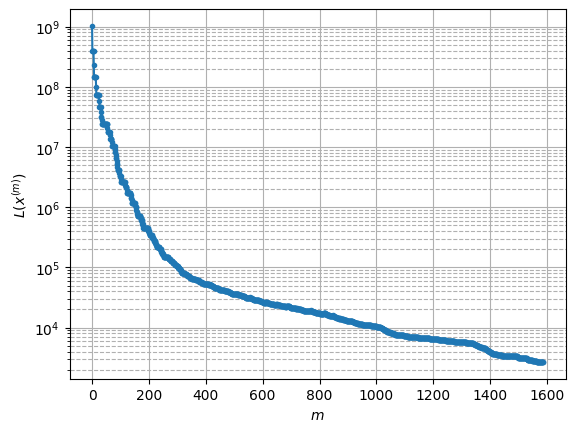

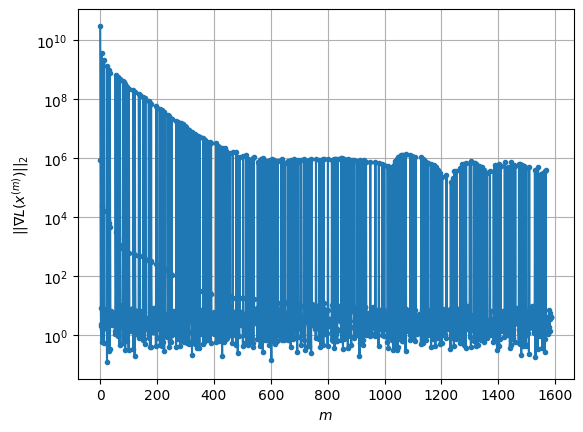

Windows:  38%|███▊      | 113/296 [1:01:38<1:17:13, 25.32s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2703.1182052361128
Gradient norm: 422880.54910242703
Deviation from touching point norm = 0.0
Global relative error: 15.413399464362989
Position relative errors: 0.016221066304973938 m, 11.213326697174384 m, 8.973855789803286 m, 5.59381693216516 m

Iteration 1
Cost function: 2691.5354475699123 (-0.43%)
Gradient norm: 5.282328580358713 (-100.00%)
Deviation from touching point norm = 0.3402364809467057 (340236480946.71%)
Global relative error = 15.411800758375579 (-0.01%)
Position relative errors: 0.011306243601154403 m, 11.144092638600025 m, 9.004856046802205 m, 5.677343345673678 m

STOP on Iteration 2
Cost function = 2691.5354466456506 (-0.00%)
Gradient norm = 0.44592347853359815 (-91.56%)
Deviation from touching point norm = 0.34023648173311216 (0.00%)
Global relative error = 15.411800751733251 (-0.00%)
Final position relative errors: 0.011306250051539355 m, 11.144092640644006 m, 9.00485603728262 m, 5.

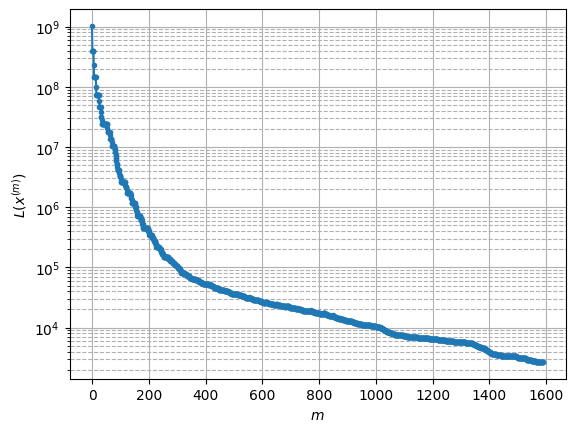

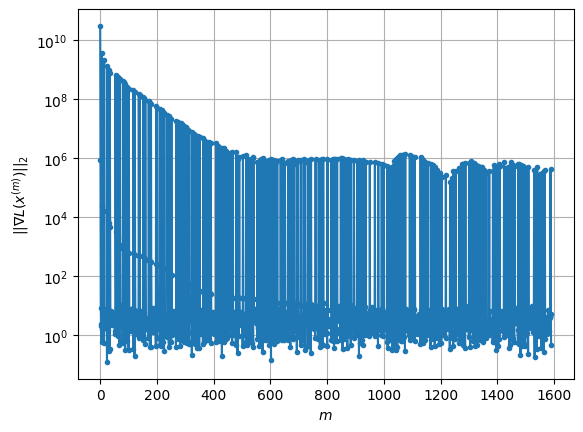

Windows:  39%|███▊      | 114/296 [1:01:46<1:00:36, 19.98s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2713.8628878923955
Gradient norm: 525495.4981218384
Deviation from touching point norm = 0.0
Global relative error: 13.763661669996027
Position relative errors: 0.010968152211081564 m, 7.334926504546682 m, 6.537178924799978 m, 9.637911432891176 m

Iteration 1
Cost function: 2702.3664129271633 (-0.42%)
Gradient norm: 7.244770591686165 (-100.00%)
Deviation from touching point norm = 0.3028318538729739 (302831853872.97%)
Global relative error = 13.736897831215854 (-0.19%)
Position relative errors: 0.02002241640694372 m, 7.259987002377237 m, 6.57798700178723 m, 9.628686335219818 m

Iteration 2
Cost function: 2702.3664144634818 (0.00%)
Gradient norm: 7.089222100742163 (-2.15%)
Deviation from touching point norm = 0.30283185743733443 (0.00%)
Global relative error = 13.736897826093175 (-0.00%)
Position relative errors: 0.02002240646391823 m, 7.259987003218508 m, 6.577986998495204 m, 9.628686329546792 m

Iterat

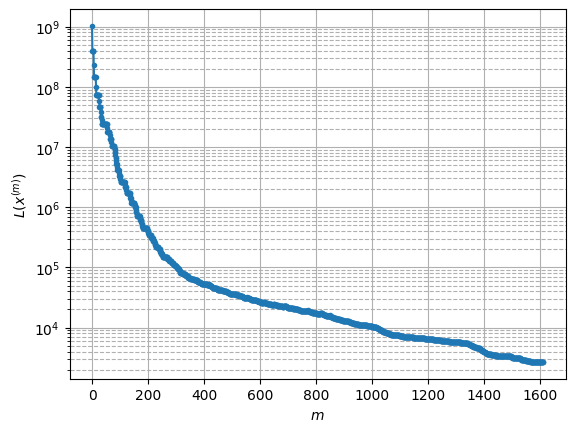

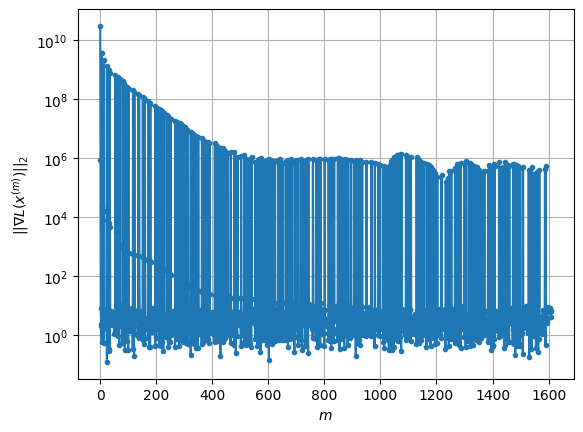

Windows:  39%|███▉      | 115/296 [1:02:33<1:24:59, 28.18s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2736.2062766074873
Gradient norm: 450143.616134434
Deviation from touching point norm = 0.0
Global relative error: 15.234126882174083
Position relative errors: 0.019008957191322548 m, 3.5466943611624604 m, 5.240115886323375 m, 13.85739597893817 m

Iteration 1
Cost function: 2724.98490136002 (-0.41%)
Gradient norm: 1.808765440219949 (-100.00%)
Deviation from touching point norm = 0.28504723238851404 (285047232388.51%)
Global relative error = 15.194989747491295 (-0.26%)
Position relative errors: 0.020761655934263146 m, 3.4512704001508174 m, 5.301503588106014 m, 13.815104985396108 m

Iteration 2
Cost function: 2724.9849010381886 (-0.00%)
Gradient norm: 2.1166902227622844 (17.02%)
Deviation from touching point norm = 0.2850472318938381 (-0.00%)
Global relative error = 15.194989738820507 (-0.00%)
Position relative errors: 0.020761654249507665 m, 3.451270399423433 m, 5.3015035798319365 m, 13.815104979218624 m

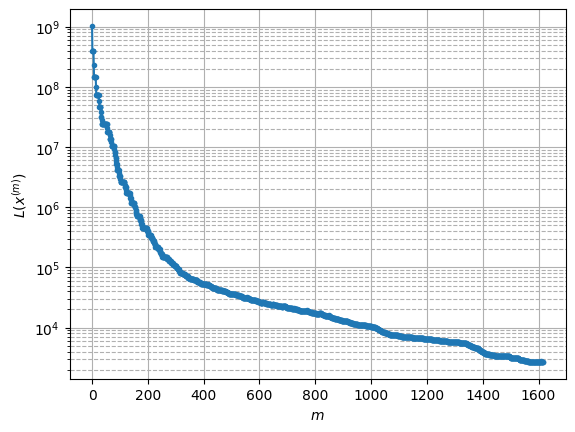

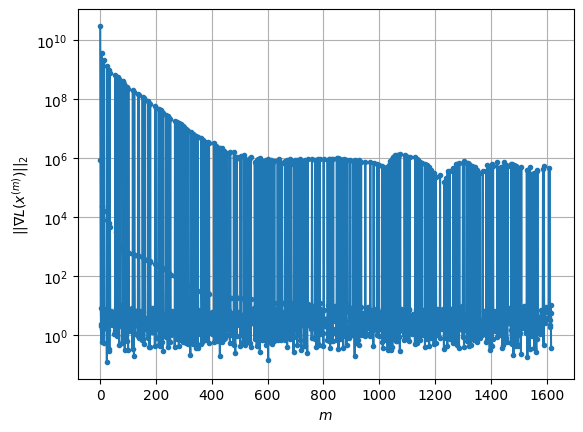

Windows:  39%|███▉      | 116/296 [1:02:50<1:14:22, 24.79s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2758.797850466387
Gradient norm: 556776.1841936804
Deviation from touching point norm = 0.0
Global relative error: 19.09019942651703
Position relative errors: 0.019621837173151333 m, 1.6128405391339686 m, 5.9062498760473625 m, 18.081413151615436 m

Iteration 1
Cost function: 2747.466780195921 (-0.41%)
Gradient norm: 4.572219763333945 (-100.00%)
Deviation from touching point norm = 0.24490579782535057 (244905797825.35%)
Global relative error = 19.02186440809476 (-0.36%)
Position relative errors: 0.027478861494092916 m, 1.485576465621496 m, 5.943288331401846 m, 18.008003879920636 m

Iteration 2
Cost function: 2747.466779455774 (-0.00%)
Gradient norm: 3.069181626181152 (-32.87%)
Deviation from touching point norm = 0.24490580125139905 (0.00%)
Global relative error = 19.021864405323537 (-0.00%)
Position relative errors: 0.027478853853370896 m, 1.4855764604821804 m, 5.943288331614634 m, 18.008003877358775 m


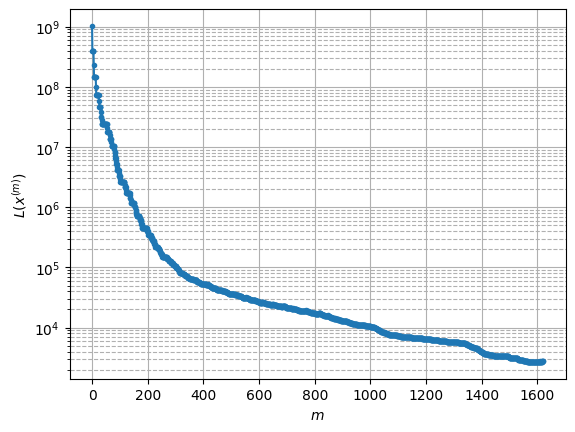

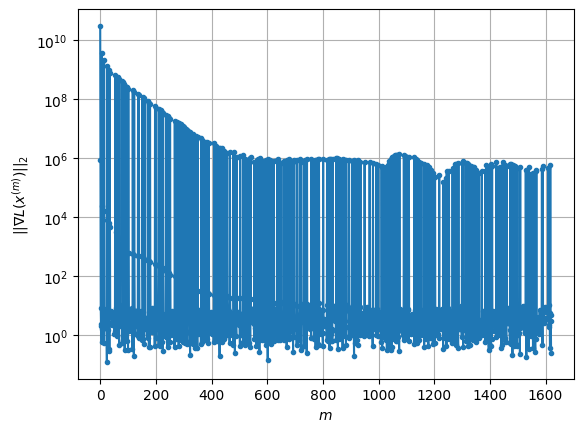

Windows:  40%|███▉      | 117/296 [1:02:59<1:00:19, 20.22s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2796.5332900501503
Gradient norm: 554175.0457550487
Deviation from touching point norm = 0.0
Global relative error: 24.14137869677542
Position relative errors: 0.025987865450307613 m, 4.8718375814219455 m, 8.022878181849048 m, 22.24166428971826 m

Iteration 1
Cost function: 2783.6790218694487 (-0.46%)
Gradient norm: 2.754077941861143 (-100.00%)
Deviation from touching point norm = 0.2579860636041039 (257986063604.10%)
Global relative error = 24.0588724960795 (-0.34%)
Position relative errors: 0.03730309492932835 m, 4.842821161294816 m, 8.038462412679765 m, 22.1527810139873 m

Iteration 2
Cost function: 2783.6790204909867 (-0.00%)
Gradient norm: 2.079952143755202 (-24.48%)
Deviation from touching point norm = 0.25798606192844237 (-0.00%)
Global relative error = 24.05887249042361 (-0.00%)
Position relative errors: 0.03730309814549959 m, 4.842821158413134 m, 8.038462405947342 m, 22.15278101091226 m

STOP o

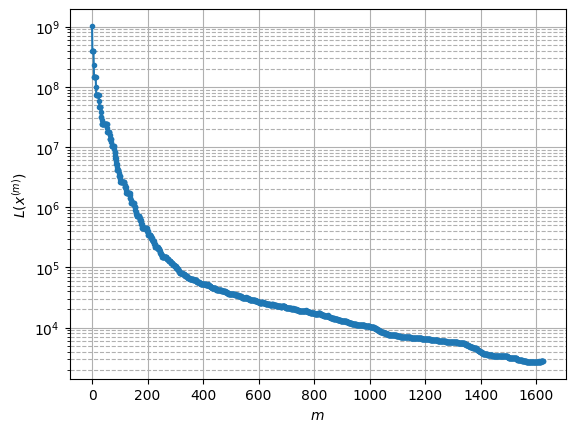

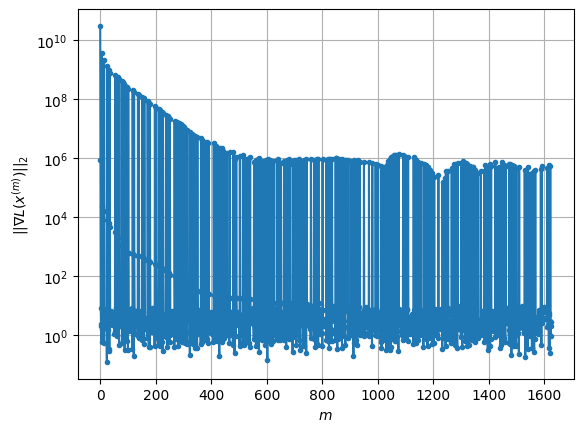

Windows:  40%|███▉      | 118/296 [1:03:09<50:44, 17.10s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2844.310321426218
Gradient norm: 660573.454753674
Deviation from touching point norm = 0.0
Global relative error: 29.71447825557049
Position relative errors: 0.03533037600688188 m, 8.677714345315623 m, 10.733935651921007 m, 26.31381359091829 m

Iteration 1
Cost function: 2830.906903473966 (-0.47%)
Gradient norm: 1.3373559771762347 (-100.00%)
Deviation from touching point norm = 0.23825122106295296 (238251221062.95%)
Global relative error = 29.616540044307612 (-0.33%)
Position relative errors: 0.05125084288972526 m, 8.663297266483704 m, 10.716746809270548 m, 26.214945788110697 m

Iteration 2
Cost function: 2830.906903968668 (0.00%)
Gradient norm: 1.770016845450472 (32.35%)
Deviation from touching point norm = 0.23825121047694256 (-0.00%)
Global relative error = 29.616540041851614 (-0.00%)
Position relative errors: 0.05125082580048457 m, 8.663297265177535 m, 10.716746807172504 m, 26.21494578665876 m

Iter

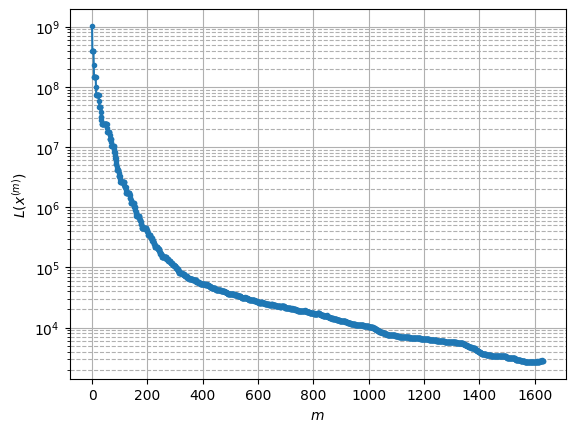

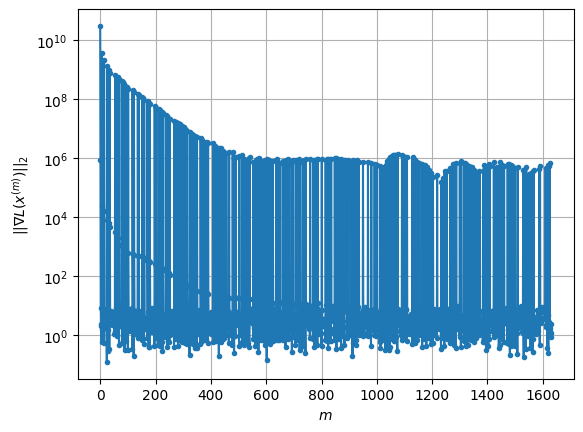

Windows:  40%|████      | 119/296 [1:03:24<48:05, 16.30s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2899.1038824650673
Gradient norm: 656159.6666137623
Deviation from touching point norm = 0.0
Global relative error: 35.47883489096774
Position relative errors: 0.0483774883981247 m, 12.496987704459347 m, 13.6358999011491 m, 30.275754771820758 m

Iteration 1
Cost function: 2884.4734721921013 (-0.50%)
Gradient norm: 2.1195476328132403 (-100.00%)
Deviation from touching point norm = 0.2634777408558516 (263477740855.85%)
Global relative error = 35.36840497136415 (-0.31%)
Position relative errors: 0.049409495580429605 m, 12.479973316798246 m, 13.599234552966069 m, 30.16987161631595 m

Iteration 2
Cost function: 2884.4734721288432 (-0.00%)
Gradient norm: 3.2956405907850073 (55.49%)
Deviation from touching point norm = 0.26347773792342727 (-0.00%)
Global relative error = 35.36840497134484 (-0.00%)
Position relative errors: 0.04940949415560729 m, 12.479973315141098 m, 13.599234553399755 m, 30.16987161678564 m



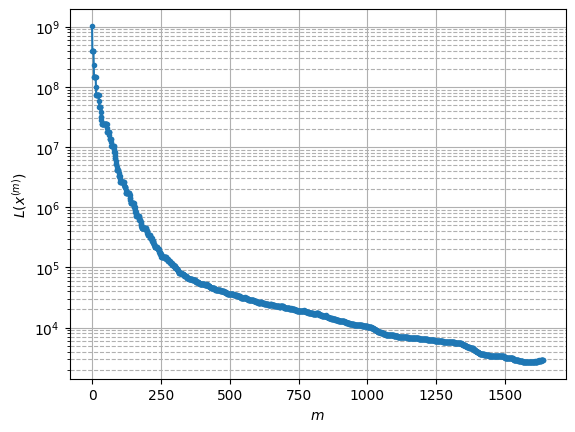

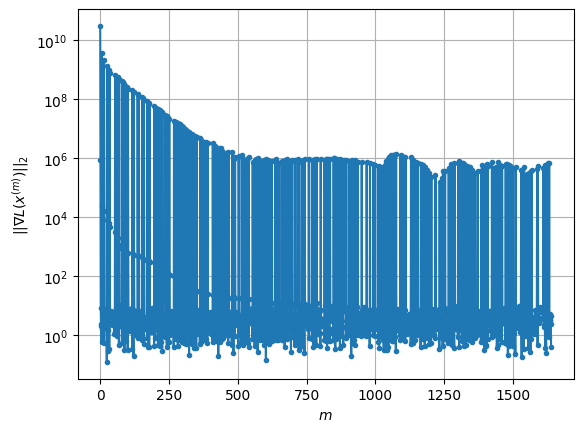

Windows:  41%|████      | 120/296 [1:03:43<50:06, 17.08s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2932.7612792537743
Gradient norm: 681522.0031068113
Deviation from touching point norm = 0.0
Global relative error: 41.268123266866596
Position relative errors: 0.04656932746503945 m, 16.26649706720591 m, 16.586469717361798 m, 34.107695785703804 m

Iteration 1
Cost function: 2916.593998356347 (-0.55%)
Gradient norm: 4.737985353347206 (-100.00%)
Deviation from touching point norm = 0.2830835520566121 (283083552056.61%)
Global relative error = 41.15126198601209 (-0.28%)
Position relative errors: 0.05639687819235884 m, 16.24164991150514 m, 16.543356786213355 m, 33.999093383105524 m

Iteration 2
Cost function: 2916.5939987286697 (0.00%)
Gradient norm: 3.034715780529963 (-35.95%)
Deviation from touching point norm = 0.28308354970079275 (-0.00%)
Global relative error = 41.15126198598533 (-0.00%)
Position relative errors: 0.05639687494682182 m, 16.24164991008464 m, 16.543356786040867 m, 33.999093383841036 m

I

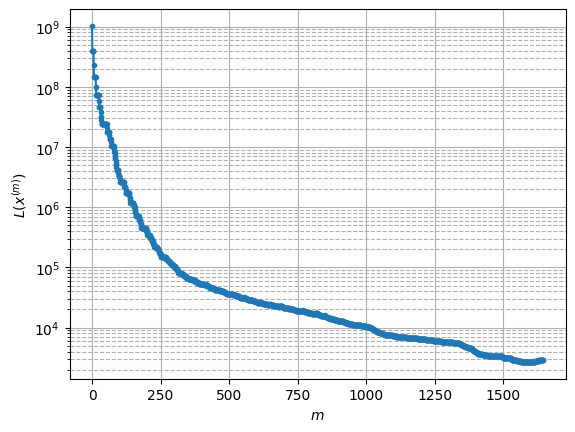

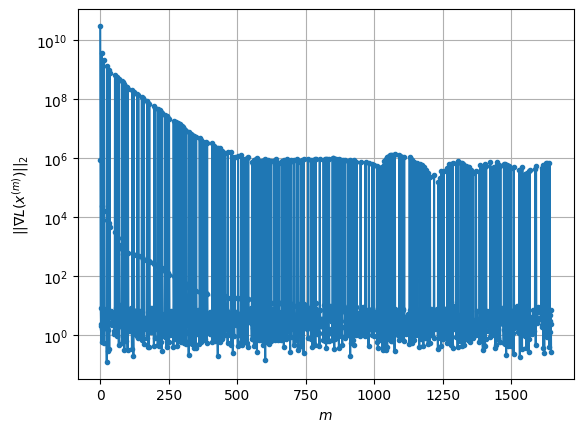

Windows:  41%|████      | 121/296 [1:03:59<49:21, 16.93s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3009.345797843631
Gradient norm: 826834.4408593782
Deviation from touching point norm = 0.0
Global relative error: 46.98859986344812
Position relative errors: 0.052986829343255104 m, 19.95852072398285 m, 19.525395257041012 m, 37.793276355277825 m

Iteration 1
Cost function: 2991.006311561819 (-0.61%)
Gradient norm: 1.3401537007822966 (-100.00%)
Deviation from touching point norm = 0.2831616116571758 (283161611657.18%)
Global relative error = 46.862538485676126 (-0.27%)
Position relative errors: 0.06798641233952006 m, 19.92670741221797 m, 19.47619959218813 m, 37.67872788542985 m

Iteration 2
Cost function: 2991.006311783779 (0.00%)
Gradient norm: 1.0393288081326582 (-22.45%)
Deviation from touching point norm = 0.2831616031875898 (-0.00%)
Global relative error = 46.862538488006514 (0.00%)
Position relative errors: 0.06798640740600019 m, 19.92670741169324 m, 19.476199591683702 m, 37.67872788887541 m

Iter

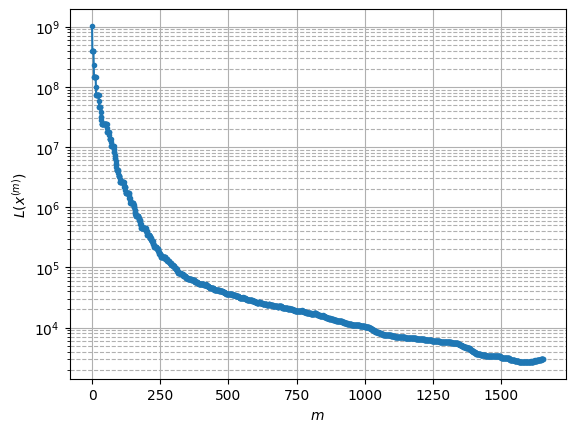

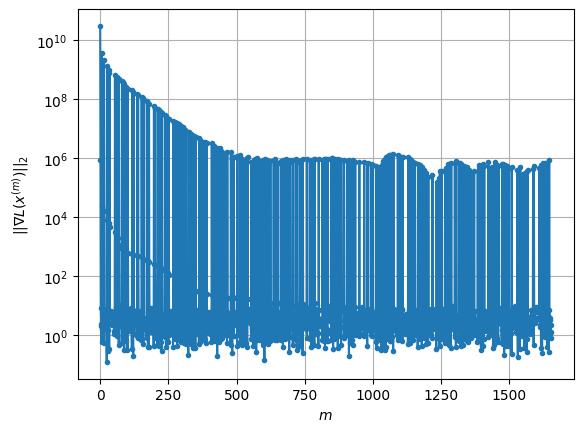

Windows:  41%|████      | 122/296 [1:04:18<50:47, 17.51s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3138.983921414984
Gradient norm: 827347.4142796032
Deviation from touching point norm = 0.0
Global relative error: 52.5715508473112
Position relative errors: 0.06385748867806801 m, 23.55584803862203 m, 22.411629021105647 m, 41.310956646321294 m

Iteration 1
Cost function: 3119.647776996476 (-0.62%)
Gradient norm: 2.6308717287206305 (-100.00%)
Deviation from touching point norm = 0.2681100544812954 (268110054481.30%)
Global relative error = 52.430471416976275 (-0.27%)
Position relative errors: 0.05927985388300158 m, 23.516801079005806 m, 22.335871721883635 m, 41.19478237095459 m

Iteration 2
Cost function: 3119.6477774244854 (0.00%)
Gradient norm: 3.783679620564978 (43.82%)
Deviation from touching point norm = 0.2681100503841806 (-0.00%)
Global relative error = 52.43047142049148 (0.00%)
Position relative errors: 0.05927984259777783 m, 23.51680107834379 m, 22.3358717240762 m, 41.194782374633895 m

STOP on

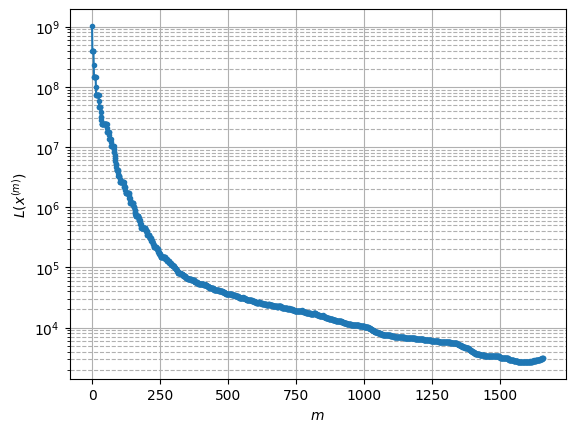

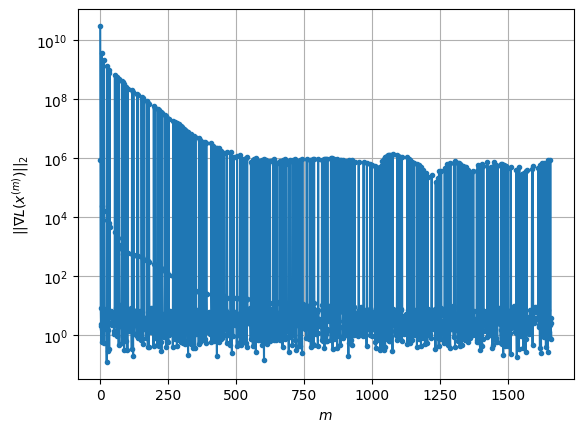

Windows:  42%|████▏     | 123/296 [1:04:28<43:45, 15.18s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3244.175339654561
Gradient norm: 888976.5693720258
Deviation from touching point norm = 0.0
Global relative error: 57.96312009180712
Position relative errors: 0.055586679634867096 m, 27.041906937931923 m, 25.19862006900672 m, 44.648360897279716 m

STOP on Iteration 1
Cost function = 3221.820489677226 (-0.69%)
Gradient norm = 0.749385126034754 (-100.00%)
Deviation from touching point norm = 0.3188329722357503 (318832972235.75%)
Global relative error = 57.80336957755099 (-0.28%)
Final position relative errors: 0.054651835151669 m, 26.99581517751927 m, 25.088680383681222 m, 44.53090796470117 m

Majorization-Minimization converged after 1 iterations


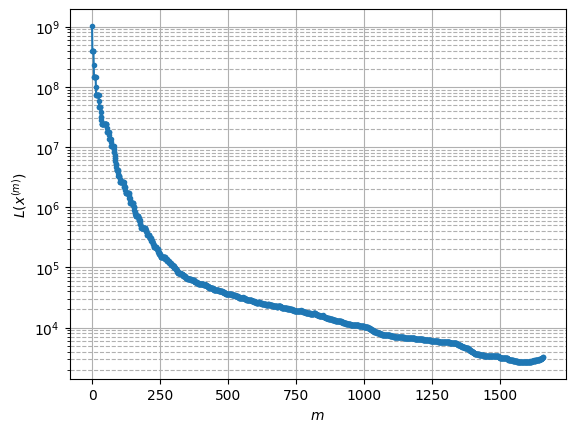

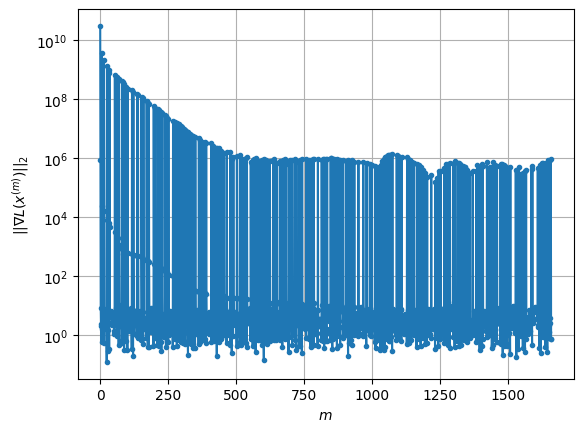

Windows:  42%|████▏     | 124/296 [1:04:33<34:52, 12.17s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3337.105608272904
Gradient norm: 903102.3016326299
Deviation from touching point norm = 0.0
Global relative error: 63.122182215554716
Position relative errors: 0.0513312705204481 m, 30.401633112647815 m, 27.860107549654977 m, 47.79073424985224 m

Iteration 1
Cost function: 3312.8037376230354 (-0.73%)
Gradient norm: 2.8138917568877027 (-100.00%)
Deviation from touching point norm = 0.35879600105429965 (358796001054.30%)
Global relative error = 62.94925233586461 (-0.27%)
Position relative errors: 0.052751982634776706 m, 30.350817570562807 m, 27.722030421623288 m, 47.67509230318398 m

Iteration 2
Cost function: 3312.8037386798314 (0.00%)
Gradient norm: 1.6286176267011758 (-42.12%)
Deviation from touching point norm = 0.3587959982541054 (-0.00%)
Global relative error = 62.949252341368805 (0.00%)
Position relative errors: 0.05275197722020679 m, 30.350817570460705 m, 27.722030423395534 m, 47.67509230949209 m


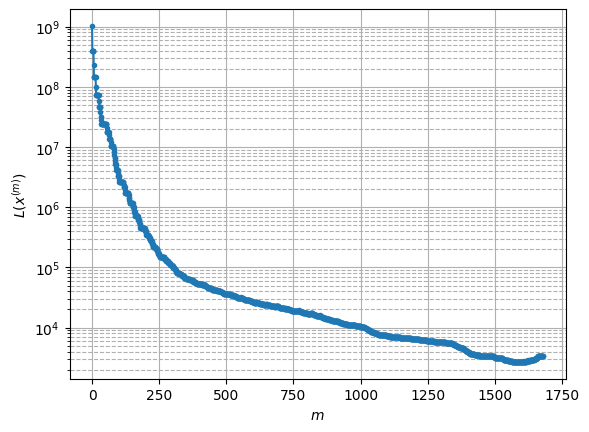

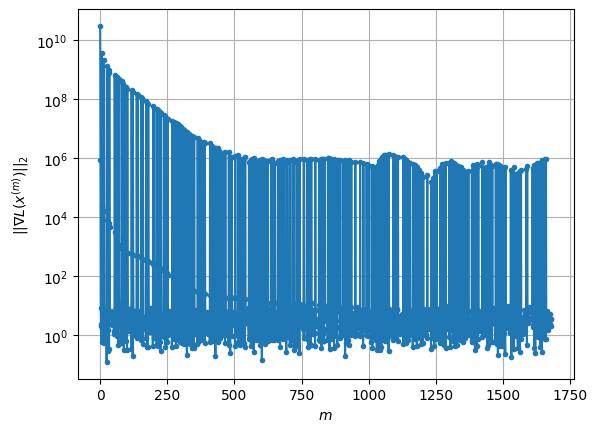

Windows:  42%|████▏     | 125/296 [1:05:18<1:03:11, 22.18s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3512.816510621332
Gradient norm: 958854.7076969505
Deviation from touching point norm = 0.0
Global relative error: 68.02176893535446
Position relative errors: 0.0494805597628024 m, 33.622893361674926 m, 30.384919602515865 m, 50.72680795448825 m

Iteration 1
Cost function: 3486.8261499605555 (-0.74%)
Gradient norm: 4.468860718376408 (-100.00%)
Deviation from touching point norm = 0.3770562764111804 (377056276411.18%)
Global relative error = 67.83240303080902 (-0.28%)
Position relative errors: 0.060021586558920405 m, 33.566475832180544 m, 30.21182387786584 m, 50.61384650288176 m

Iteration 2
Cost function: 3486.826151458782 (0.00%)
Gradient norm: 1.2130449807117287 (-72.86%)
Deviation from touching point norm = 0.37705627855713786 (0.00%)
Global relative error = 67.83240303696189 (0.00%)
Position relative errors: 0.060021594356141905 m, 33.5664758333378 m, 30.21182387889139 m, 50.61384650973895 m

Iterati

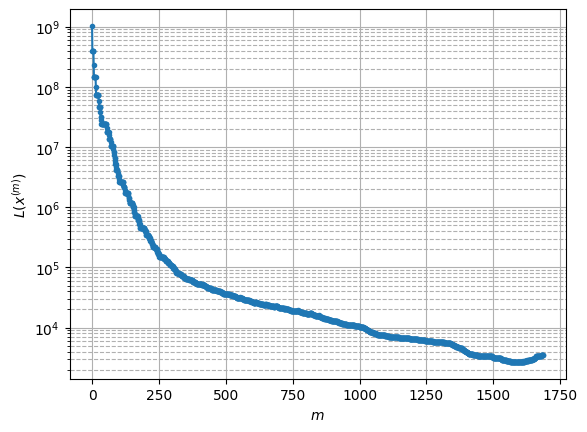

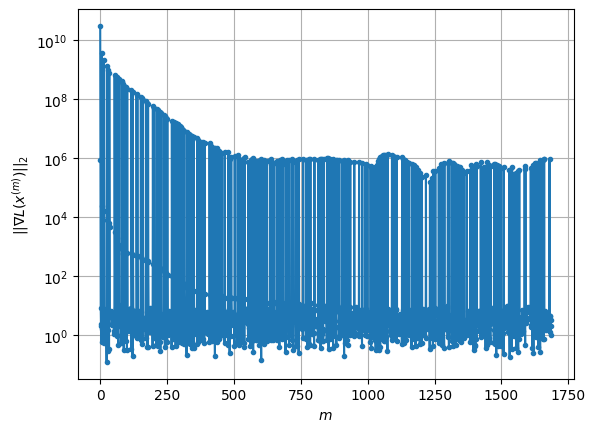

Windows:  43%|████▎     | 126/296 [1:05:35<57:48, 20.40s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3709.632724049556
Gradient norm: 936816.8667137475
Deviation from touching point norm = 0.0
Global relative error: 72.63055763903068
Position relative errors: 0.05617727828257692 m, 36.69080783316703 m, 32.7519539177295 m, 53.44419949517918 m

Iteration 1
Cost function: 3680.176588185812 (-0.79%)
Gradient norm: 1.5791216369381957 (-100.00%)
Deviation from touching point norm = 0.4413329724168052 (441332972416.81%)
Global relative error = 72.42247659841325 (-0.29%)
Position relative errors: 0.05879292028565786 m, 36.634490081742356 m, 32.53364988992785 m, 53.333676198064126 m

Iteration 2
Cost function: 3680.1765888680115 (0.00%)
Gradient norm: 2.4344372730841335 (54.16%)
Deviation from touching point norm = 0.4413329728430885 (0.00%)
Global relative error = 72.4224766046004 (0.00%)
Position relative errors: 0.058792917470720185 m, 36.63449008206999 m, 32.53364989094452 m, 53.33367620562361 m

STOP on It

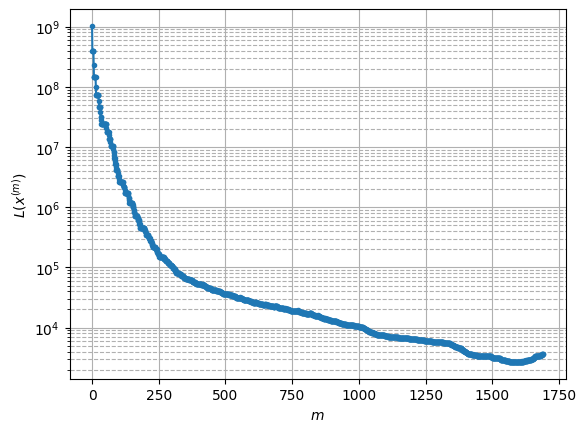

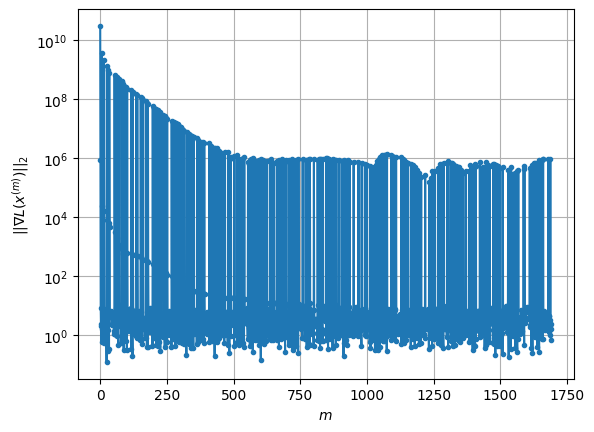

Windows:  43%|████▎     | 127/296 [1:05:44<48:29, 17.21s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3943.129433831443
Gradient norm: 972801.4553040426
Deviation from touching point norm = 0.0
Global relative error: 76.92157350992608
Position relative errors: 0.05522005457889265 m, 39.59785884478294 m, 34.93831664275497 m, 55.93070208934124 m

Iteration 1
Cost function: 3909.060745235961 (-0.86%)
Gradient norm: 3.0277697542256403 (-100.00%)
Deviation from touching point norm = 0.5089631297910463 (508963129791.05%)
Global relative error = 76.69395463713829 (-0.30%)
Position relative errors: 0.05338002503519539 m, 39.54167804522187 m, 34.67216409784449 m, 55.8233910474791 m

Iteration 2
Cost function: 3909.0607462109056 (0.00%)
Gradient norm: 2.6547986754496216 (-12.32%)
Deviation from touching point norm = 0.5089631271327187 (-0.00%)
Global relative error = 76.69395464148948 (0.00%)
Position relative errors: 0.05338002509861227 m, 39.54167804552542 m, 34.672164096649595 m, 55.823391053984125 m

Iteratio

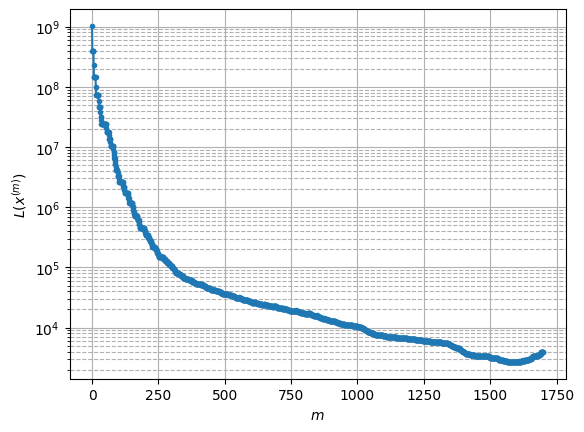

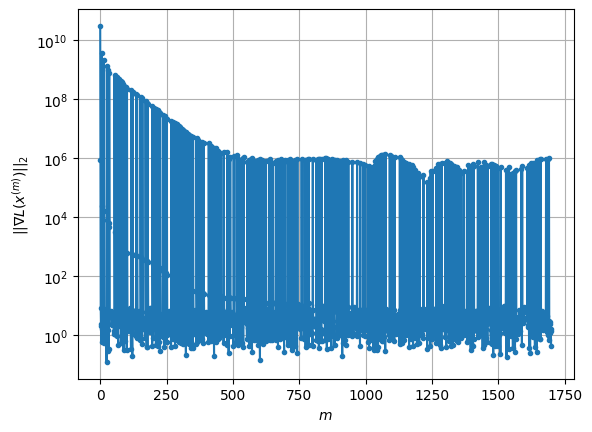

Windows:  43%|████▎     | 128/296 [1:06:06<51:47, 18.50s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4218.0791366420235
Gradient norm: 941370.2036195667
Deviation from touching point norm = 0.0
Global relative error: 80.871871369864
Position relative errors: 0.05010136048497905 m, 42.331493011383266 m, 36.929998286891674 m, 58.17621693827767 m

Iteration 1
Cost function: 4178.823891824919 (-0.93%)
Gradient norm: 6.01189298027887 (-100.00%)
Deviation from touching point norm = 0.5590151917930903 (559015191793.09%)
Global relative error = 80.62367327593618 (-0.31%)
Position relative errors: 0.044573530919754537 m, 42.275239609377884 m, 36.611914301248234 m, 58.073589433953174 m

Iteration 2
Cost function: 4178.823889786869 (-0.00%)
Gradient norm: 4.629443075400219 (-23.00%)
Deviation from touching point norm = 0.5590152006068643 (0.00%)
Global relative error = 80.62367328130604 (0.00%)
Position relative errors: 0.04457351973063183 m, 42.27523961015353 m, 36.61191430061621 m, 58.07358944125055 m

Iteratio

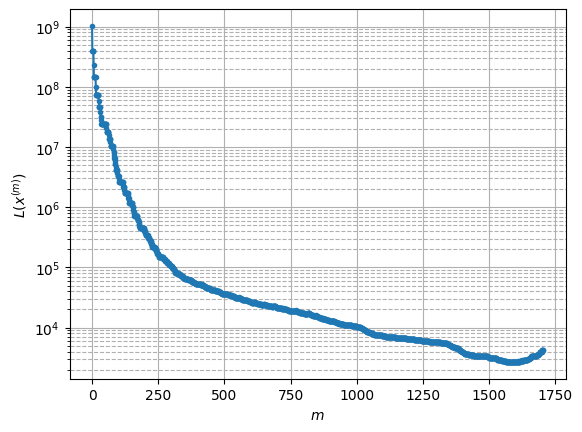

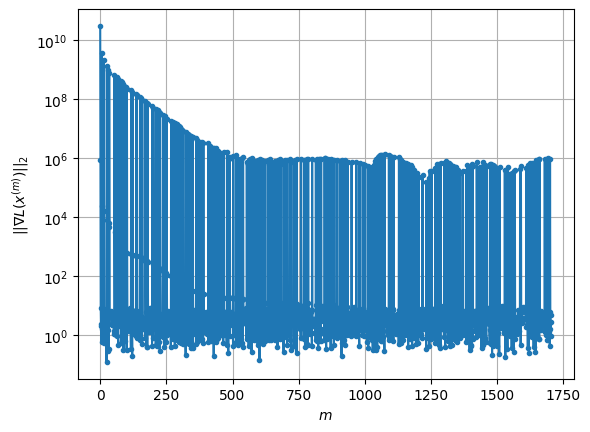

Windows:  44%|████▎     | 129/296 [1:06:18<45:57, 16.51s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4622.245183860352
Gradient norm: 932912.1879750906
Deviation from touching point norm = 0.0
Global relative error: 84.46044962060326
Position relative errors: 0.04230118938695277 m, 44.879671005803566 m, 38.71236276137746 m, 60.17250089859986 m

Iteration 1
Cost function: 4577.480782691024 (-0.97%)
Gradient norm: 8.588418018650705 (-100.00%)
Deviation from touching point norm = 0.5644031460697719 (564403146069.77%)
Global relative error = 84.18669348784485 (-0.32%)
Position relative errors: 0.041190282256919696 m, 44.82736425306724 m, 38.33245794213359 m, 60.07098935411498 m

Iteration 2
Cost function: 4577.480782408507 (-0.00%)
Gradient norm: 1.6036393575551335 (-81.33%)
Deviation from touching point norm = 0.5644031483621118 (0.00%)
Global relative error = 84.18669349493362 (0.00%)
Position relative errors: 0.04119026889292159 m, 44.82736425447223 m, 38.332457945434754 m, 60.07098936090372 m

Iteratio

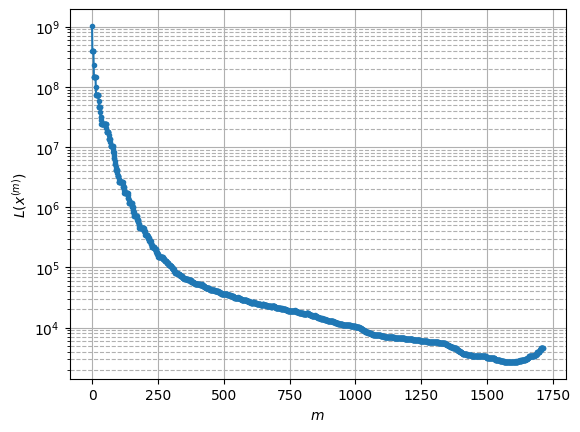

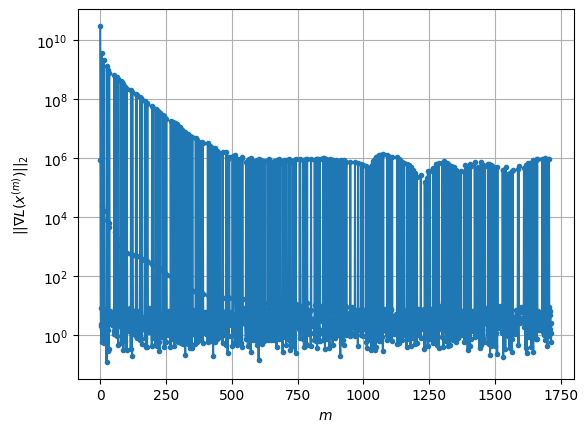

Windows:  44%|████▍     | 130/296 [1:06:39<49:30, 17.90s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5109.072840480106
Gradient norm: 891763.2399860339
Deviation from touching point norm = 0.0
Global relative error: 87.66453471504762
Position relative errors: 0.04033450620556102 m, 47.23538971421133 m, 40.2657658947111 m, 61.90760708580683 m

Iteration 1
Cost function: 5052.3162354636615 (-1.11%)
Gradient norm: 4.97083889074075 (-100.00%)
Deviation from touching point norm = 0.6918968860075158 (691896886007.52%)
Global relative error = 87.35803623259856 (-0.35%)
Position relative errors: 0.038456042929591275 m, 47.18266879533896 m, 39.8065217370925 m, 61.81147432673806 m

Iteration 2
Cost function: 5052.316234002494 (-0.00%)
Gradient norm: 4.068105225478316 (-18.16%)
Deviation from touching point norm = 0.6918968948611647 (0.00%)
Global relative error = 87.35803623759861 (0.00%)
Position relative errors: 0.03845604611170638 m, 47.18266879543125 m, 39.806521738408115 m, 61.811474332884906 m

Iteration 3

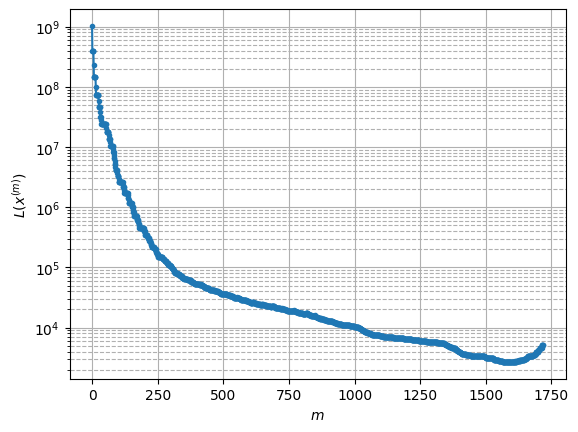

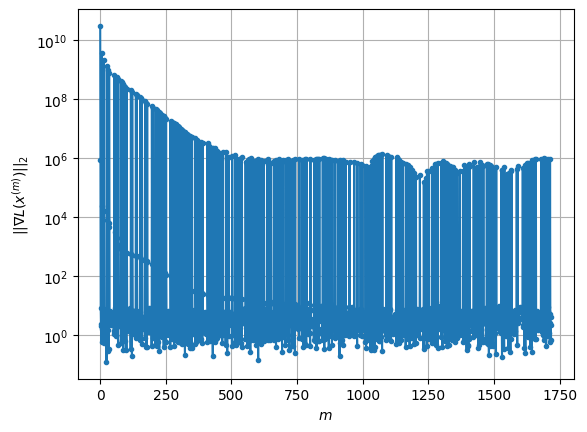

Windows:  44%|████▍     | 131/296 [1:06:51<44:33, 16.21s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5713.851505376976
Gradient norm: 825696.6088847631
Deviation from touching point norm = 0.0
Global relative error: 90.46164362098523
Position relative errors: 0.03872186789547193 m, 49.38412218414772 m, 41.56544043294386 m, 63.37844683773098 m

Iteration 1
Cost function: 5644.657415266016 (-1.21%)
Gradient norm: 5.455762310694562 (-100.00%)
Deviation from touching point norm = 0.7562640607399981 (756264060740.00%)
Global relative error = 90.11843030040271 (-0.38%)
Position relative errors: 0.04140389793502148 m, 49.33253170663507 m, 41.016682103751606 m, 63.287125843382675 m

STOP on Iteration 2
Cost function = 5644.657414929755 (-0.00%)
Gradient norm = 0.5240026738374852 (-90.40%)
Deviation from touching point norm = 0.756264071517402 (0.00%)
Global relative error = 90.11843030669716 (0.00%)
Final position relative errors: 0.04140389132184651 m, 49.332531706491764 m, 41.01668210895106 m, 63.28712584909

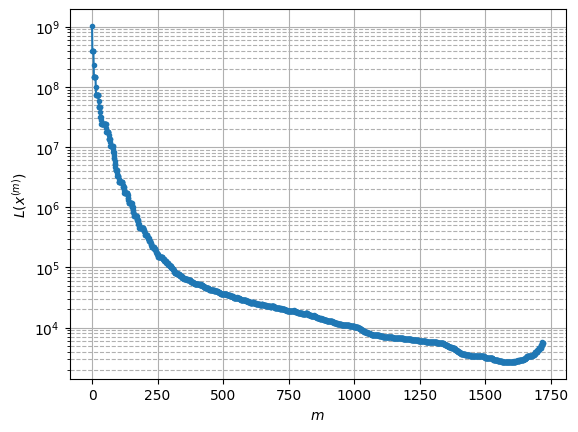

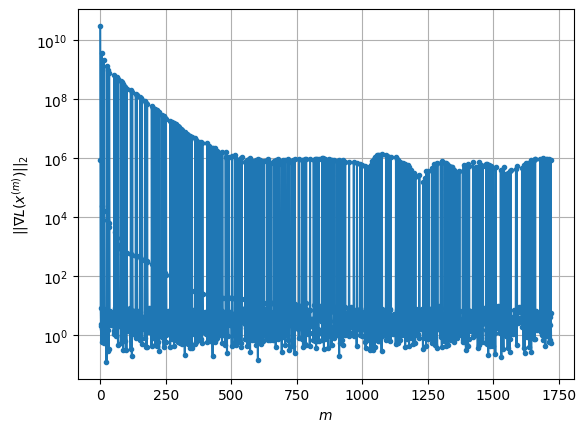

Windows:  45%|████▍     | 132/296 [1:06:59<37:14, 13.62s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6423.207025921332
Gradient norm: 752996.921119704
Deviation from touching point norm = 0.0
Global relative error: 92.83436417913818
Position relative errors: 0.04192976455755375 m, 51.318105528667914 m, 42.59450029958293 m, 64.57844867018788 m

Iteration 1
Cost function: 6334.824418721202 (-1.38%)
Gradient norm: 6.725969170088395 (-100.00%)
Deviation from touching point norm = 0.844607704501691 (844607704501.69%)
Global relative error = 92.44790875720851 (-0.42%)
Position relative errors: 0.04942016793734051 m, 51.26730204022568 m, 41.94098569722058 m, 64.49208391236505 m

Iteration 2
Cost function: 6334.824415367118 (-0.00%)
Gradient norm: 7.325369875020063 (8.91%)
Deviation from touching point norm = 0.8446077101936778 (0.00%)
Global relative error = 92.44790876508763 (0.00%)
Position relative errors: 0.04942016571600943 m, 51.26730204011629 m, 41.940985707656274 m, 64.49208391696162 m

Iteration 3
Co

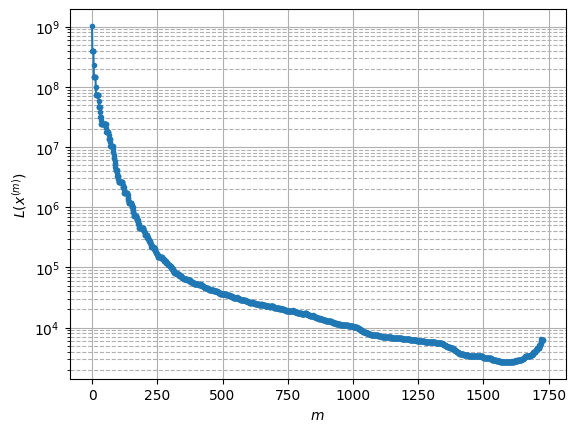

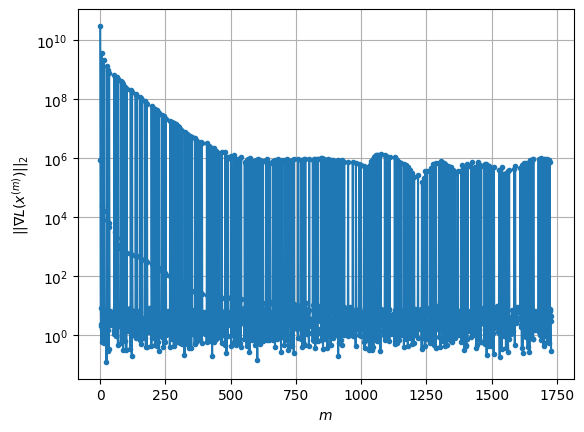

Windows:  45%|████▍     | 133/296 [1:07:15<39:19, 14.48s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7226.207956594276
Gradient norm: 765905.8914724365
Deviation from touching point norm = 0.0
Global relative error: 94.76477445700675
Position relative errors: 0.0502965567517688 m, 53.028634752886624 m, 43.33238552144676 m, 65.50287604742051 m

Iteration 1
Cost function: 7113.6137125769965 (-1.56%)
Gradient norm: 8.143617144582247 (-100.00%)
Deviation from touching point norm = 0.9114961110577242 (911496111057.72%)
Global relative error = 94.32929722016205 (-0.46%)
Position relative errors: 0.055778548544478036 m, 52.98044972703466 m, 42.55945240868345 m, 65.42000249362816 m

STOP on Iteration 2
Cost function = 7113.613713105982 (0.00%)
Gradient norm = 0.7906338579147005 (-90.29%)
Deviation from touching point norm = 0.9114961173889984 (0.00%)
Global relative error = 94.3292972317694 (0.00%)
Final position relative errors: 0.05577854832139942 m, 52.98044972742749 m, 42.55945242652835 m, 65.4200024984377

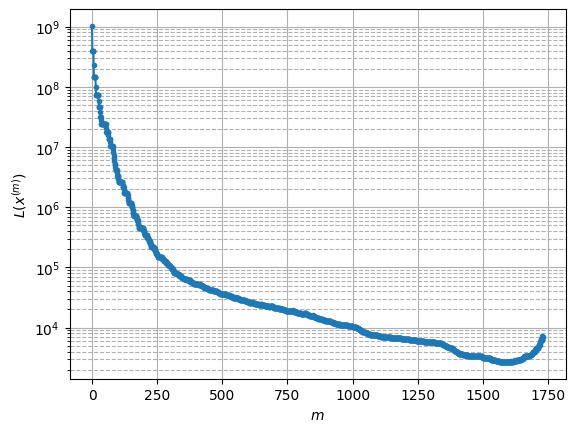

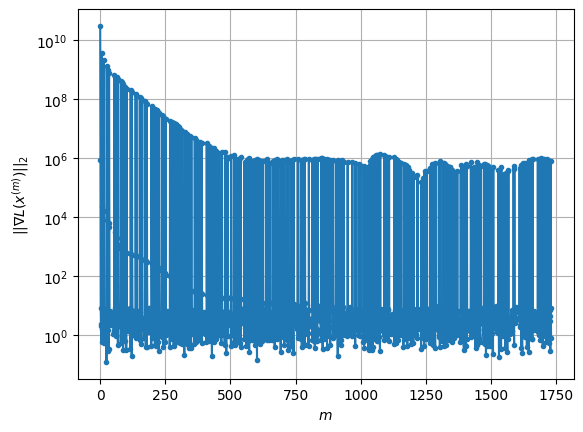

Windows:  45%|████▌     | 134/296 [1:07:23<33:23, 12.37s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7988.084209523833
Gradient norm: 769382.4320019395
Deviation from touching point norm = 0.0
Global relative error: 96.23793528351926
Position relative errors: 0.056958441311216704 m, 54.51011575728602 m, 43.76066920547729 m, 66.14670861573644 m

Iteration 1
Cost function: 7849.670425740073 (-1.73%)
Gradient norm: 11.71397267676074 (-100.00%)
Deviation from touching point norm = 0.966730775291002 (966730775291.00%)
Global relative error = 95.75543683835912 (-0.50%)
Position relative errors: 0.06299879962485563 m, 54.46454672089452 m, 42.867965389543265 m, 66.0685206341949 m

Iteration 2
Cost function: 7849.670423635249 (-0.00%)
Gradient norm: 2.455834004153984 (-79.04%)
Deviation from touching point norm = 0.9667307681679792 (-0.00%)
Global relative error = 95.75543685503465 (0.00%)
Position relative errors: 0.06299879979315812 m, 54.46454672126121 m, 42.86796542061944 m, 66.06852063789736 m

Iteration 3

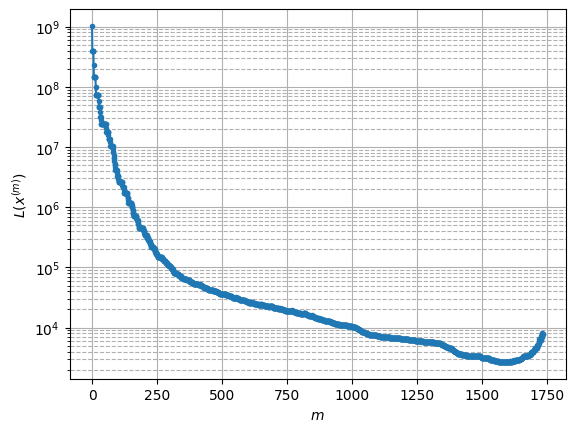

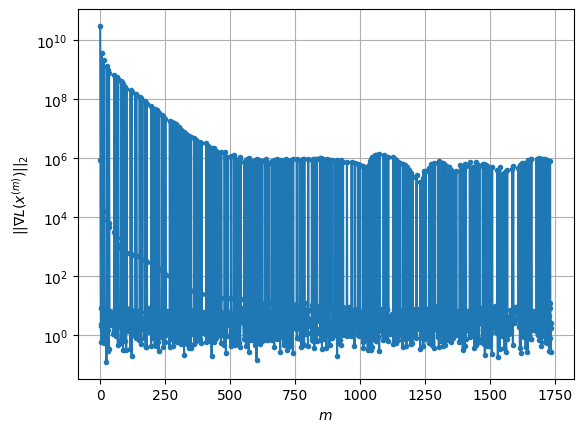

Windows:  46%|████▌     | 135/296 [1:07:34<32:44, 12.20s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 8377.024701503242
Gradient norm: 526900.6211694201
Deviation from touching point norm = 0.0
Global relative error: 97.24909558595652
Position relative errors: 0.06406433708646114 m, 55.756005543246054 m, 43.8773464689026 m, 66.5088577527608 m

Iteration 1
Cost function: 8223.8099828743 (-1.83%)
Gradient norm: 7.00002288037621 (-100.00%)
Deviation from touching point norm = 0.9972601915391146 (997260191539.11%)
Global relative error = 96.74095044599711 (-0.52%)
Position relative errors: 0.07172244930040995 m, 55.71017049189052 m, 42.91665068119745 m, 66.43300164302127 m

Iteration 2
Cost function: 8223.80998377135 (0.00%)
Gradient norm: 1.7852004805139043 (-74.50%)
Deviation from touching point norm = 0.9972601727217392 (-0.00%)
Global relative error = 96.7409504660441 (0.00%)
Position relative errors: 0.07172244963373374 m, 55.71017049181241 m, 42.916650719703235 m, 66.4330016474039 m

Iteration 3
Cost 

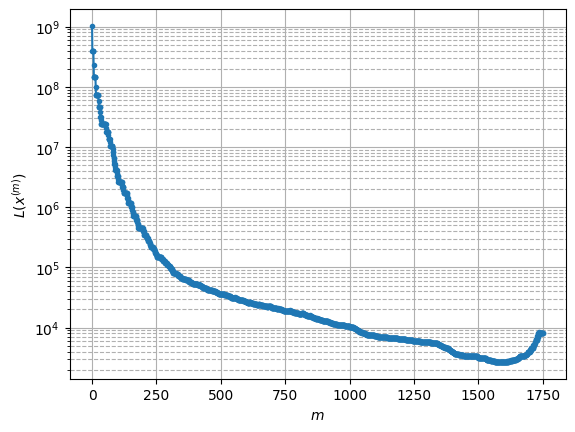

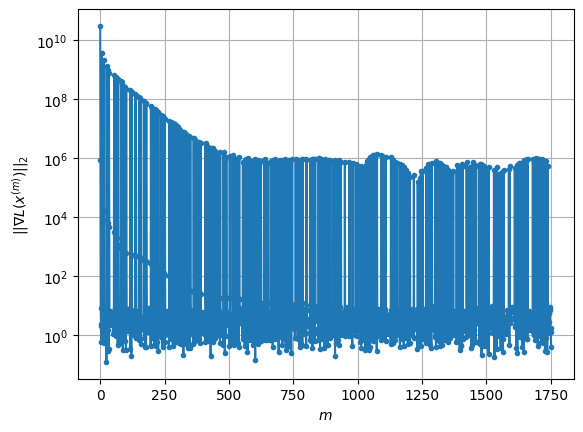

Windows:  46%|████▌     | 136/296 [1:08:09<50:10, 18.81s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 8356.161311549298
Gradient norm: 433821.603868555
Deviation from touching point norm = 0.0
Global relative error: 97.8159697766172
Position relative errors: 0.0726775248100872 m, 56.75795011070007 m, 43.735563825158785 m, 66.58598824764849 m

Iteration 1
Cost function: 8202.554018435294 (-1.84%)
Gradient norm: 7.139886938986801 (-100.00%)
Deviation from touching point norm = 0.9899644040637664 (989964404063.77%)
Global relative error = 97.30811833958305 (-0.52%)
Position relative errors: 0.07280518414844397 m, 56.712393010375585 m, 42.76319688299546 m, 66.51223706102145 m

STOP on Iteration 2
Cost function = 8202.554019371242 (0.00%)
Gradient norm = 0.4957083321777218 (-93.06%)
Deviation from touching point norm = 0.9899643740982196 (-0.00%)
Global relative error = 97.3081183605541 (0.00%)
Final position relative errors: 0.07280518457918259 m, 56.71239301089632 m, 42.76319692401925 m, 66.51223706488211 

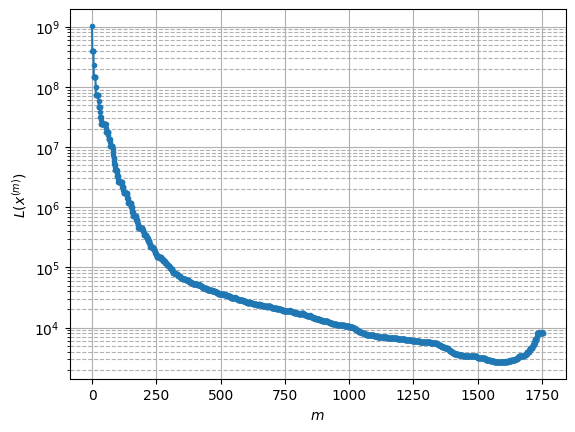

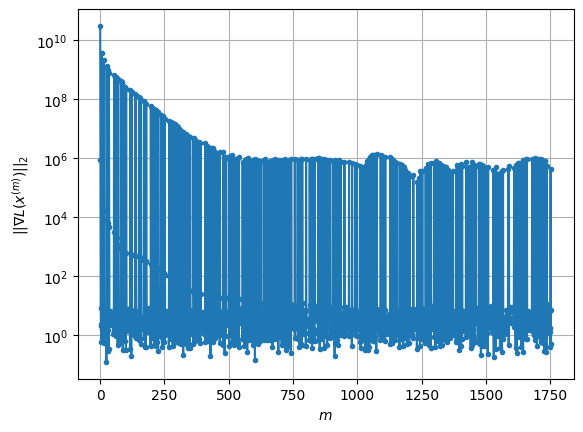

Windows:  46%|████▋     | 137/296 [1:08:16<40:55, 15.44s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 8076.903269374632
Gradient norm: 380194.2472966497
Deviation from touching point norm = 0.0
Global relative error: 97.96363768563262
Position relative errors: 0.0735184904432935 m, 57.512155535941986 m, 43.395501435349544 m, 66.37809196354922 m

Iteration 1
Cost function: 7929.132260434016 (-1.83%)
Gradient norm: 7.699189682216622 (-100.00%)
Deviation from touching point norm = 0.9677863698233958 (967786369823.40%)
Global relative error = 97.4710820327189 (-0.50%)
Position relative errors: 0.07611006820844403 m, 57.46581021041573 m, 42.445641097975475 m, 66.30726970599953 m

Iteration 2
Cost function: 7929.132260998736 (0.00%)
Gradient norm: 2.922632864789597 (-62.04%)
Deviation from touching point norm = 0.9677863432053284 (-0.00%)
Global relative error = 97.47108205138298 (0.00%)
Position relative errors: 0.07611006678314036 m, 57.46581021077498 m, 42.44564113306913 m, 66.30726971066117 m

Iteration 3

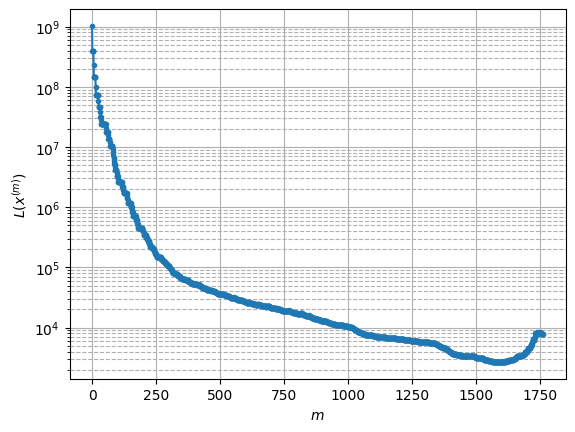

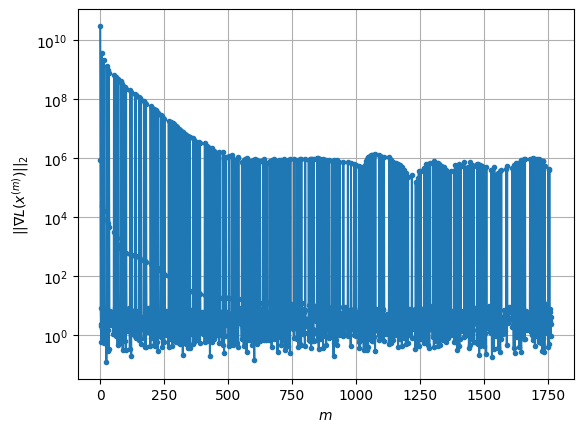

Windows:  47%|████▋     | 138/296 [1:08:35<43:15, 16.42s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7809.52793969697
Gradient norm: 426229.2482971535
Deviation from touching point norm = 0.0
Global relative error: 97.70841130909355
Position relative errors: 0.07653372991899418 m, 58.01430737448351 m, 42.8967104883878 m, 65.88732788345075 m

Iteration 1
Cost function: 7669.703364323568 (-1.79%)
Gradient norm: 6.278299682037644 (-100.00%)
Deviation from touching point norm = 0.9334815993180618 (933481599318.06%)
Global relative error = 97.23392400172312 (-0.49%)
Position relative errors: 0.07520512416340144 m, 57.96672655360777 m, 41.979048360971326 m, 65.81829726588892 m

STOP on Iteration 2
Cost function = 7669.703363053298 (-0.00%)
Gradient norm = 0.9083995063765321 (-85.53%)
Deviation from touching point norm = 0.9334815829268958 (-0.00%)
Global relative error = 97.23392401801955 (0.00%)
Final position relative errors: 0.07520512239833982 m, 57.96672655372847 m, 41.979048389336675 m, 65.818297271768

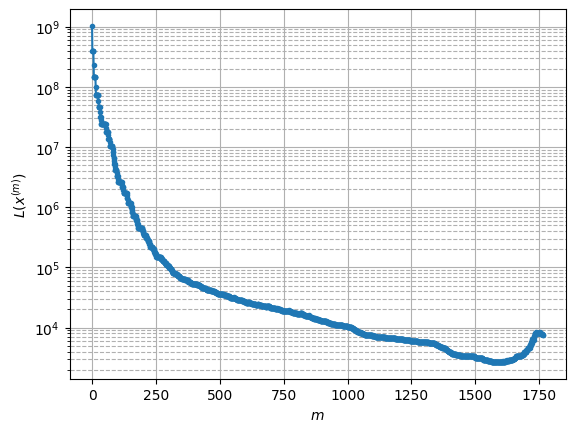

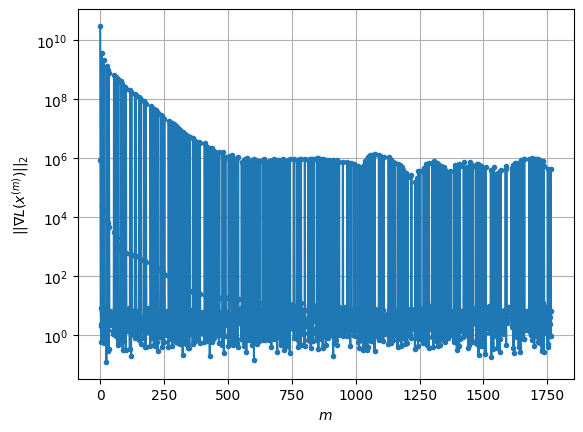

Windows:  47%|████▋     | 139/296 [1:08:42<35:56, 13.74s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7553.564027194679
Gradient norm: 584622.05202768
Deviation from touching point norm = 0.0
Global relative error: 97.05625419613318
Position relative errors: 0.0752053947407804 m, 58.26180037315821 m, 42.2548573504683 m, 65.11528431109339 m

Iteration 1
Cost function: 7420.12402453335 (-1.77%)
Gradient norm: 5.44731618569396 (-100.00%)
Deviation from touching point norm = 0.9024047326138526 (902404732613.85%)
Global relative error = 96.60091350298799 (-0.47%)
Position relative errors: 0.07159307253267218 m, 58.21361855685411 m, 41.371208233975246 m, 65.04866554282702 m

STOP on Iteration 2
Cost function = 7420.124023402882 (-0.00%)
Gradient norm = 0.5854854379335648 (-89.25%)
Deviation from touching point norm = 0.9024047213473484 (-0.00%)
Global relative error = 96.60091351757217 (0.00%)
Final position relative errors: 0.07159307368732762 m, 58.21361855767792 m, 41.37120825856936 m, 65.04866554810486 m


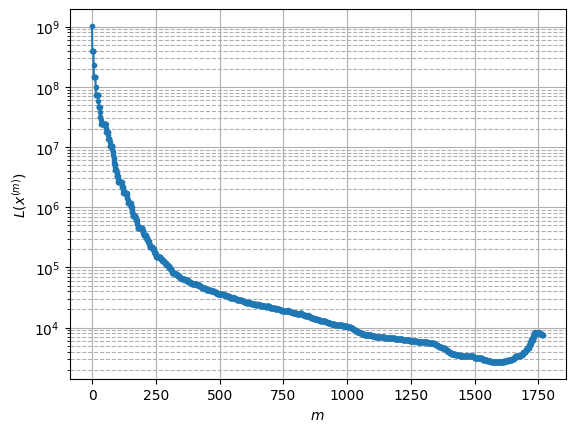

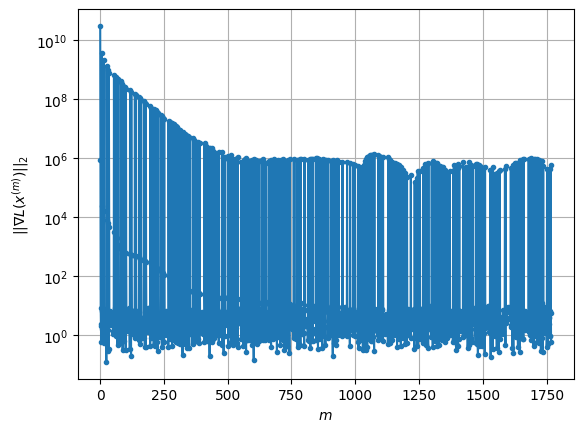

Windows:  47%|████▋     | 140/296 [1:08:50<30:44, 11.82s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7320.851702810707
Gradient norm: 590074.803973282
Deviation from touching point norm = 0.0
Global relative error: 96.01306419248994
Position relative errors: 0.07126323593146248 m, 58.254289381952226 m, 41.478105267937465 m, 64.0664312466999 m

Iteration 1
Cost function: 7191.823364332108 (-1.76%)
Gradient norm: 6.466402869970369 (-100.00%)
Deviation from touching point norm = 0.8788253067086602 (878825306708.66%)
Global relative error = 95.57736547318672 (-0.45%)
Position relative errors: 0.07733280257089317 m, 58.204356719822485 m, 40.632301618559545 m, 64.00230761709769 m

Iteration 2
Cost function: 7191.82336446332 (0.00%)
Gradient norm: 1.640973705500343 (-74.62%)
Deviation from touching point norm = 0.878825302342161 (-0.00%)
Global relative error = 95.57736548703997 (0.00%)
Position relative errors: 0.07733280479403748 m, 58.20435672071343 m, 40.632301639030004 m, 64.00230762397659 m

Iteration 3

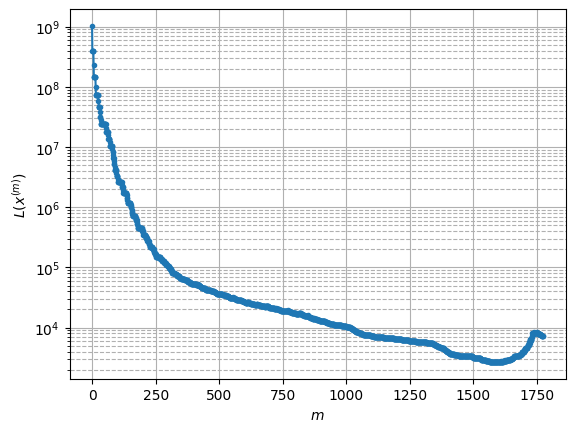

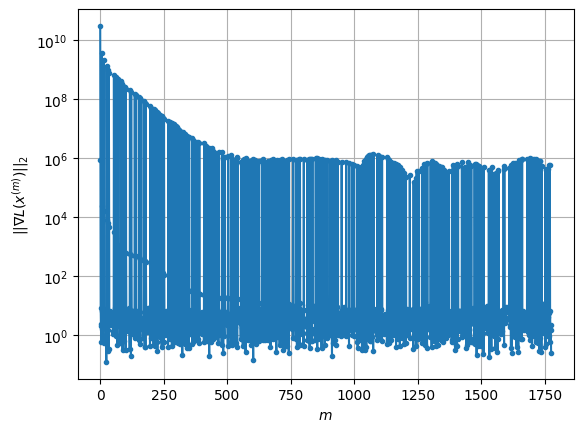

Windows:  48%|████▊     | 141/296 [1:09:04<32:15, 12.49s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7087.776609449257
Gradient norm: 675222.867897056
Deviation from touching point norm = 0.0
Global relative error: 94.5857814350958
Position relative errors: 0.07635311211115138 m, 57.99077318581772 m, 40.576917988756385 m, 62.74589698610747 m

Iteration 1
Cost function: 6962.236180757226 (-1.77%)
Gradient norm: 5.625915907982603 (-100.00%)
Deviation from touching point norm = 0.8574132487590205 (857413248759.02%)
Global relative error = 94.17040532924082 (-0.44%)
Position relative errors: 0.09126861606832537 m, 57.93933467221855 m, 39.770396074559 m, 62.68496969314481 m

Iteration 2
Cost function: 6962.23617762621 (-0.00%)
Gradient norm: 1.38972505964076 (-75.30%)
Deviation from touching point norm = 0.8574132517788018 (0.00%)
Global relative error = 94.17040534285954 (0.00%)
Position relative errors: 0.09126861866912331 m, 57.939334673323664 m, 39.77039609379774 m, 62.68496970037269 m

Iteration 3
Cost

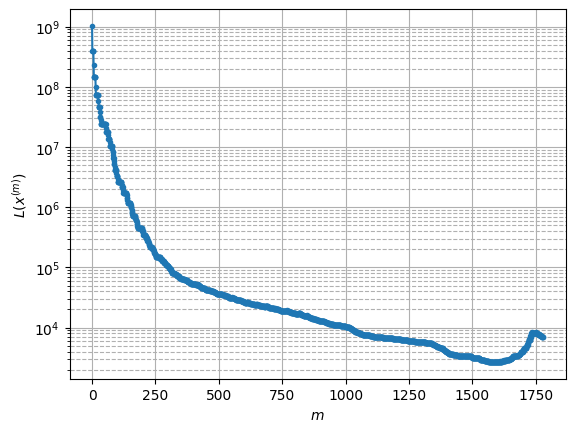

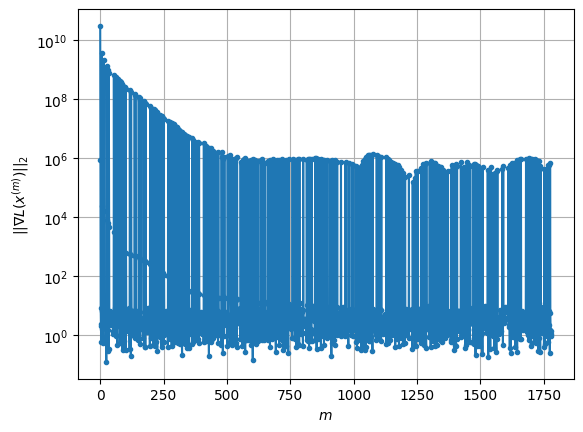

Windows:  48%|████▊     | 142/296 [1:09:16<31:34, 12.30s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6911.253877937986
Gradient norm: 677060.2344371495
Deviation from touching point norm = 0.0
Global relative error: 92.7830983197538
Position relative errors: 0.0894107962855862 m, 57.472805581290395 m, 39.559578526803755 m, 61.16053312127512 m

Iteration 1
Cost function: 6789.622617395629 (-1.76%)
Gradient norm: 4.520137615380277 (-100.00%)
Deviation from touching point norm = 0.8153583078736292 (815358307873.63%)
Global relative error = 92.38593133183689 (-0.43%)
Position relative errors: 0.09520084713749656 m, 57.42016674104511 m, 38.78858680786121 m, 61.10253959185401 m

Iteration 2
Cost function: 6789.622613618265 (-0.00%)
Gradient norm: 9.29542234124868 (105.64%)
Deviation from touching point norm = 0.8153583081007872 (0.00%)
Global relative error = 92.38593134649014 (0.00%)
Position relative errors: 0.09520085232564728 m, 57.42016674192896 m, 38.7885868281384 m, 61.10253960029861 m

Iteration 3
Co

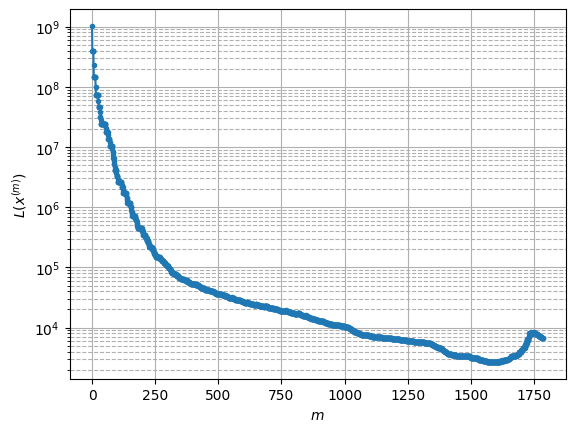

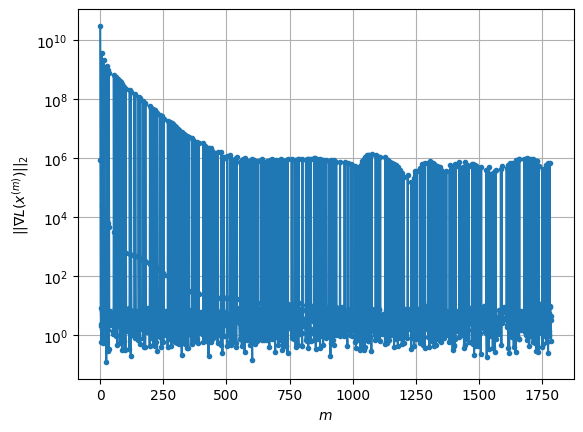

Windows:  48%|████▊     | 143/296 [1:09:32<34:40, 13.60s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6746.001602811354
Gradient norm: 819544.7548379971
Deviation from touching point norm = 0.0
Global relative error: 90.61258624994211
Position relative errors: 0.09270929513669747 m, 56.703160283019436 m, 38.429375784231965 m, 59.31749829067545 m

Iteration 1
Cost function: 6626.328594432423 (-1.77%)
Gradient norm: 5.194272677077724 (-100.00%)
Deviation from touching point norm = 0.7843252397399673 (784325239739.97%)
Global relative error = 90.23430587207534 (-0.42%)
Position relative errors: 0.09057307130740877 m, 56.64924271071063 m, 37.696975421388075 m, 59.26231373824653 m

Iteration 2
Cost function: 6626.3285930286265 (-0.00%)
Gradient norm: 3.1731503091672426 (-38.91%)
Deviation from touching point norm = 0.7843252376317191 (-0.00%)
Global relative error = 90.23430588828417 (0.00%)
Position relative errors: 0.09057307023055483 m, 56.649242712428425 m, 37.696975441963 m, 59.262313748198316 m

Iterat

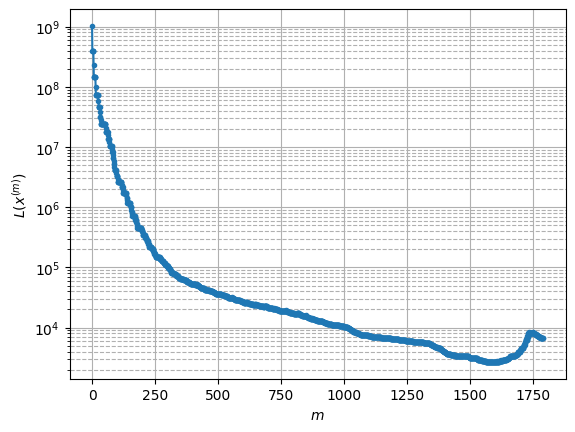

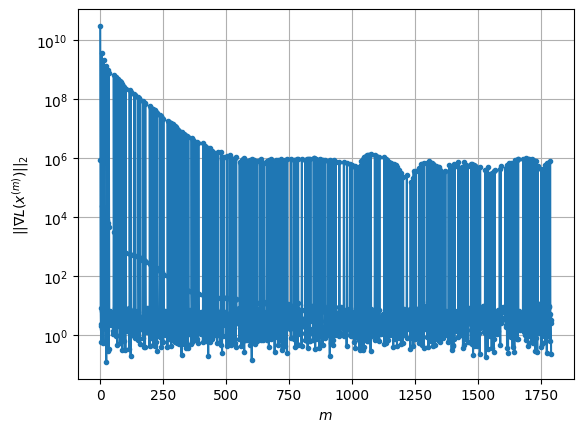

Windows:  49%|████▊     | 144/296 [1:09:45<33:22, 13.17s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6587.975494239233
Gradient norm: 850188.7345990699
Deviation from touching point norm = 0.0
Global relative error: 88.08620485083385
Position relative errors: 0.08785580851365099 m, 55.68532384670375 m, 37.19673960538508 m, 57.22514573735225 m

Iteration 1
Cost function: 6470.463893052129 (-1.78%)
Gradient norm: 6.964735375437086 (-100.00%)
Deviation from touching point norm = 0.7550421915455168 (755042191545.52%)
Global relative error = 87.72722858203178 (-0.41%)
Position relative errors: 0.0821937677591387 m, 55.63083493611336 m, 36.50359552231824 m, 57.17303455419356 m

Iteration 2
Cost function: 6470.463892521459 (-0.00%)
Gradient norm: 8.373310907726088 (20.22%)
Deviation from touching point norm = 0.7550421896466428 (-0.00%)
Global relative error = 87.7272285990708 (0.00%)
Position relative errors: 0.08219376661130022 m, 55.630834937757335 m, 36.50359554296356 m, 57.17303456555898 m

Iteration 3
C

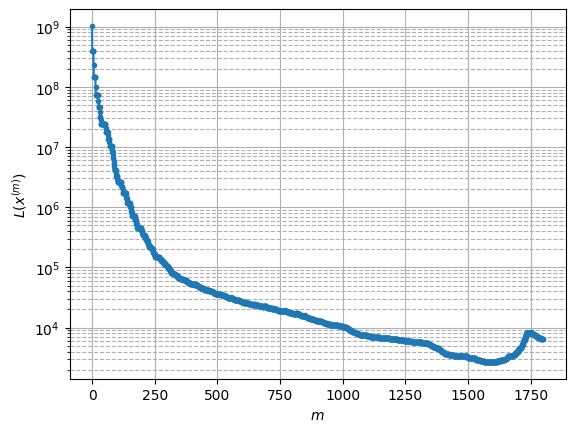

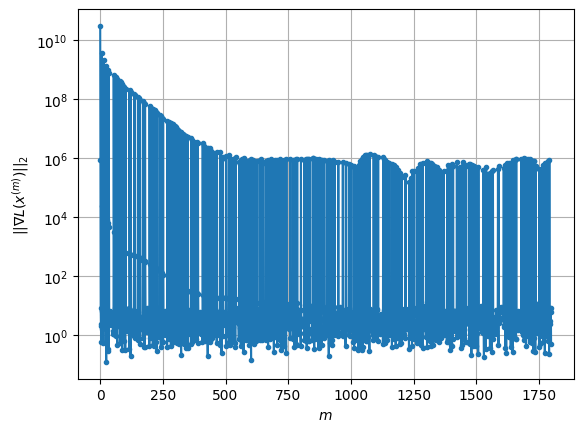

Windows:  49%|████▉     | 145/296 [1:10:03<37:23, 14.85s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6433.438026731113
Gradient norm: 948698.5481113589
Deviation from touching point norm = 0.0
Global relative error: 85.21724627423954
Position relative errors: 0.07943827327917011 m, 54.42468625587592 m, 35.869949304648216 m, 54.89326708329762 m

Iteration 1
Cost function: 6316.397929045144 (-1.82%)
Gradient norm: 4.277885642739615 (-100.00%)
Deviation from touching point norm = 0.7382733531171835 (738273353117.18%)
Global relative error = 84.87895219468967 (-0.40%)
Position relative errors: 0.08292820377935223 m, 54.37010322894156 m, 35.22010903307649 m, 54.84398981410505 m

Iteration 2
Cost function: 6316.397930602543 (0.00%)
Gradient norm: 6.102898028895957 (42.66%)
Deviation from touching point norm = 0.7382733499513662 (-0.00%)
Global relative error = 84.87895221287401 (0.00%)
Position relative errors: 0.08292819966338097 m, 54.37010323098862 m, 35.22010905454344 m, 54.84398982643898 m

Iteration 3


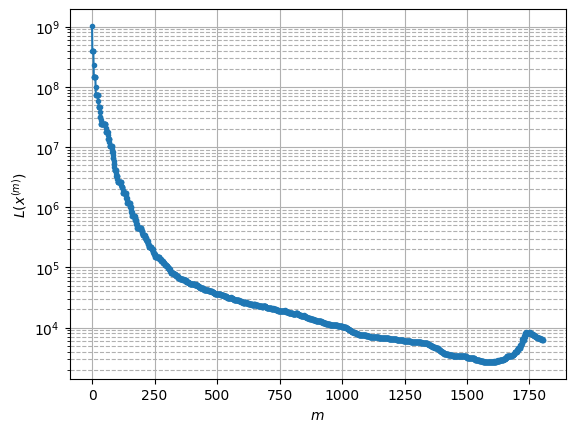

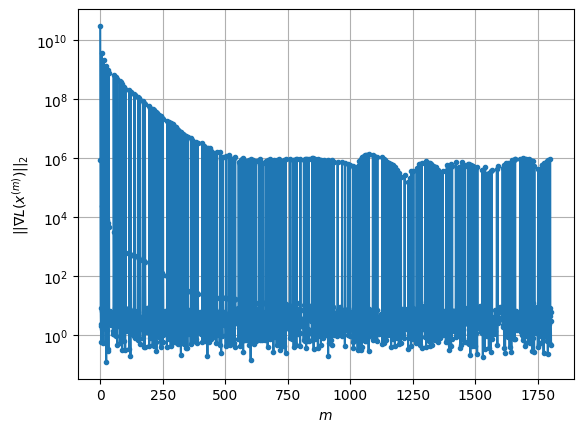

Windows:  49%|████▉     | 146/296 [1:10:15<34:51, 13.95s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6293.925113473663
Gradient norm: 1011490.7454737996
Deviation from touching point norm = 0.0
Global relative error: 82.02151046755952
Position relative errors: 0.07989013498272084 m, 52.927510507880726 m, 34.460769420001526 m, 52.3321411395572 m

Iteration 1
Cost function: 6178.8706644935555 (-1.83%)
Gradient norm: 7.56811232030124 (-100.00%)
Deviation from touching point norm = 0.7076839122360968 (707683912236.10%)
Global relative error = 81.7036820784031 (-0.39%)
Position relative errors: 0.08650038019821919 m, 52.873711850973464 m, 33.853464817369414 m, 52.285704722249946 m

Iteration 2
Cost function: 6178.8706662191435 (0.00%)
Gradient norm: 6.262390139593096 (-17.25%)
Deviation from touching point norm = 0.7076839070763105 (-0.00%)
Global relative error = 81.70368209738136 (0.00%)
Position relative errors: 0.08650038270126442 m, 52.87371185335605 m, 33.85346483828659 m, 52.28570473594934 m

STOP on

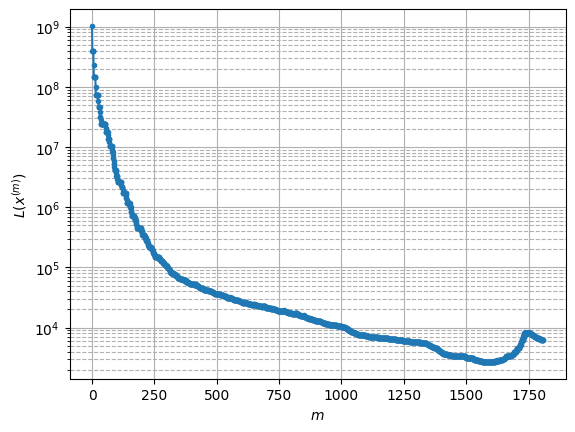

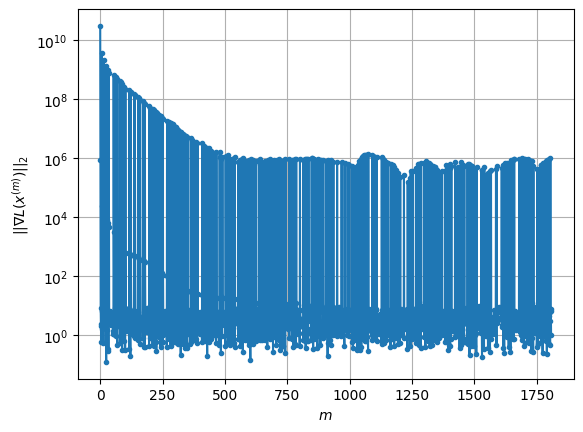

Windows:  50%|████▉     | 147/296 [1:10:25<31:28, 12.68s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6134.823365061682
Gradient norm: 1116164.571679789
Deviation from touching point norm = 0.0
Global relative error: 78.51477574530118
Position relative errors: 0.08307768945691929 m, 51.20147378211666 m, 32.976364661907745 m, 49.55328612152928 m

Iteration 1
Cost function: 6022.208624621029 (-1.84%)
Gradient norm: 3.6949187812494704 (-100.00%)
Deviation from touching point norm = 0.6764914376402577 (676491437640.26%)
Global relative error = 78.21844855519424 (-0.38%)
Position relative errors: 0.09831745744390327 m, 51.14939964421517 m, 32.41140932965261 m, 49.51113125344483 m

Iteration 2
Cost function: 6022.208624699022 (0.00%)
Gradient norm: 3.2379656567072894 (-12.37%)
Deviation from touching point norm = 0.6764914355976592 (-0.00%)
Global relative error = 78.21844857488139 (0.00%)
Position relative errors: 0.09831745944628638 m, 51.1493996461354 m, 32.41140935229698 m, 49.511131267735486 m

Iteration

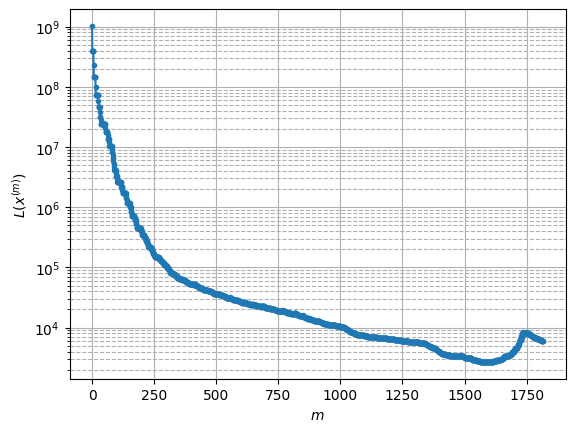

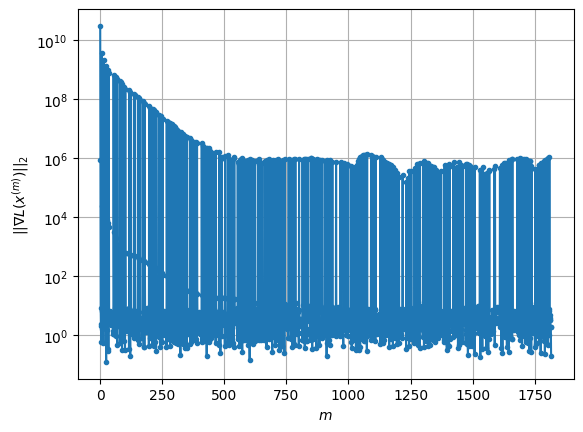

Windows:  50%|█████     | 148/296 [1:10:44<35:47, 14.51s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5926.167182810879
Gradient norm: 1076756.4731849076
Deviation from touching point norm = 0.0
Global relative error: 74.7157156480629
Position relative errors: 0.09420411247422873 m, 49.255358739810184 m, 31.424559820966895 m, 46.57071982576481 m

Iteration 1
Cost function: 5818.153372858901 (-1.82%)
Gradient norm: 5.827573067600531 (-100.00%)
Deviation from touching point norm = 0.6465944030254624 (646594403025.46%)
Global relative error = 74.44317282249095 (-0.36%)
Position relative errors: 0.1169334738930956 m, 49.205445742659386 m, 30.902854630108447 m, 46.53607205910148 m

Iteration 2
Cost function: 5818.153371738511 (-0.00%)
Gradient norm: 4.73860266878708 (-18.69%)
Deviation from touching point norm = 0.6465944037292152 (0.00%)
Global relative error = 74.44317284222738 (0.00%)
Position relative errors: 0.11693348438574278 m, 49.20544574498233 m, 30.90285465130623 m, 46.53607207411441 m

Iteration 

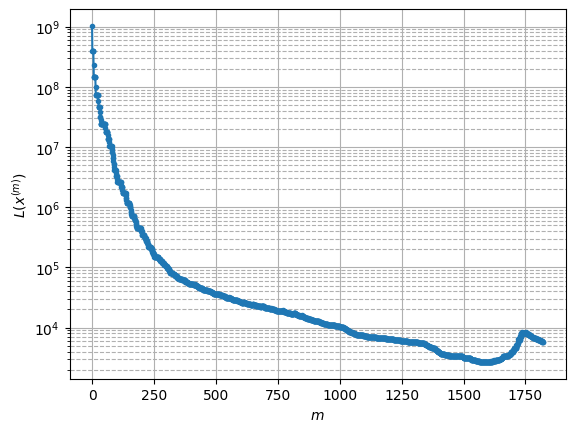

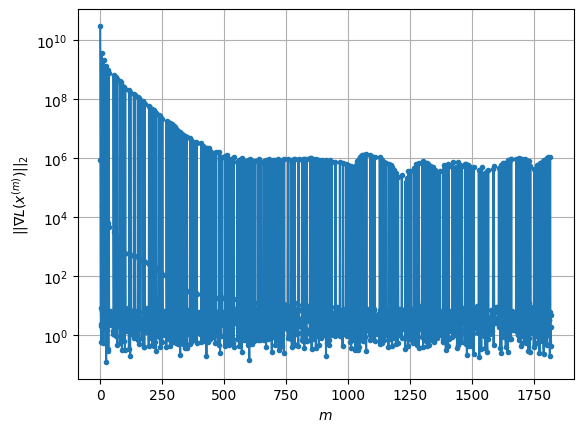

Windows:  50%|█████     | 149/296 [1:10:56<33:42, 13.76s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5738.2652857940675
Gradient norm: 1098384.345992228
Deviation from touching point norm = 0.0
Global relative error: 70.64596878317663
Position relative errors: 0.1119788620517042 m, 47.09839897673509 m, 29.814447403448046 m, 43.40132774120913 m

Iteration 1
Cost function: 5634.470261024935 (-1.81%)
Gradient norm: 3.5465378337844276 (-100.00%)
Deviation from touching point norm = 0.6088299368429659 (608829936842.97%)
Global relative error = 70.3957814024777 (-0.35%)
Position relative errors: 0.11563861426529118 m, 47.0512128527557 m, 29.33342280353993 m, 43.37374462424198 m

Iteration 2
Cost function: 5634.470261096721 (0.00%)
Gradient norm: 3.0963521454599783 (-12.69%)
Deviation from touching point norm = 0.6088299321596453 (-0.00%)
Global relative error = 70.39578142162864 (0.00%)
Position relative errors: 0.11563861078998022 m, 47.05121285476156 m, 29.333422821561143 m, 43.37374464096974 m

Iteration 

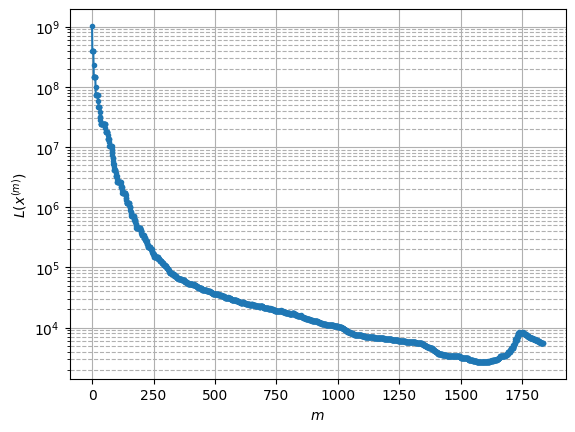

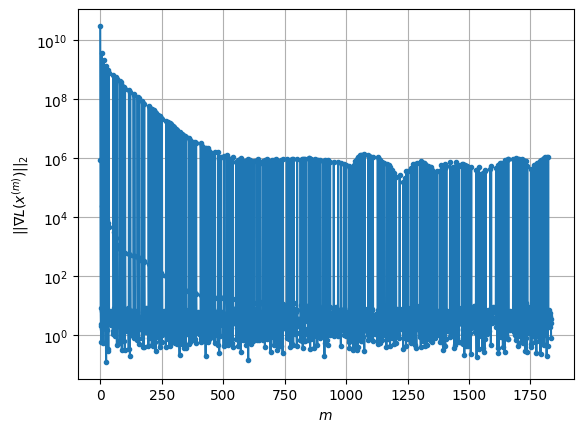

Windows:  51%|█████     | 150/296 [1:11:25<45:02, 18.51s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5536.392776592822
Gradient norm: 1101811.4759801424
Deviation from touching point norm = 0.0
Global relative error: 66.32519265865056
Position relative errors: 0.11040071623616794 m, 44.74094462076226 m, 28.151905953601368 m, 40.05910339410214 m

Iteration 1
Cost function: 5436.500740475433 (-1.80%)
Gradient norm: 5.15250413907006 (-100.00%)
Deviation from touching point norm = 0.5961522989581922 (596152298958.19%)
Global relative error = 66.09941951659364 (-0.34%)
Position relative errors: 0.11597507661734317 m, 44.69741590721058 m, 27.709575837296555 m, 40.042914161754645 m

Iteration 2
Cost function: 5436.500739627395 (-0.00%)
Gradient norm: 1.4747410771251084 (-71.38%)
Deviation from touching point norm = 0.5961522883252014 (-0.00%)
Global relative error = 66.09941953364844 (0.00%)
Position relative errors: 0.11597508417863571 m, 44.697415909043485 m, 27.709575851236945 m, 40.042914178192724 m

Iter

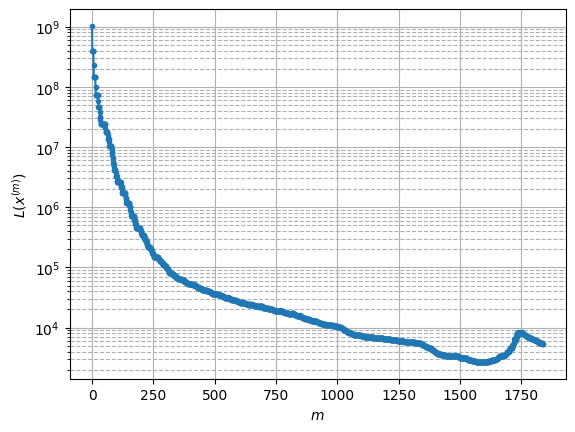

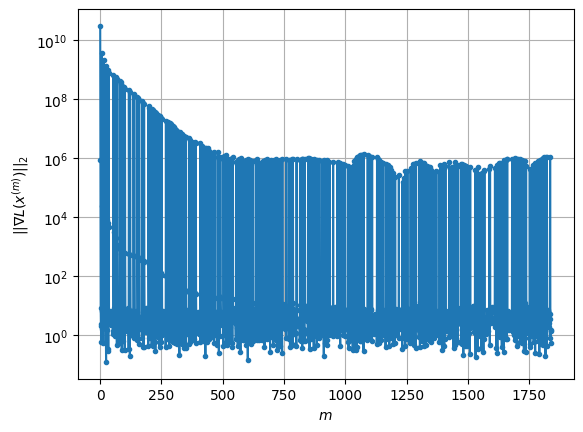

Windows:  51%|█████     | 151/296 [1:11:37<40:07, 16.60s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5350.02713156593
Gradient norm: 1064473.8621065144
Deviation from touching point norm = 0.0
Global relative error: 61.778488287023215
Position relative errors: 0.11075122720214385 m, 42.19454475135694 m, 26.443426722893108 m, 36.56403975636315 m

Iteration 1
Cost function: 5255.732414419817 (-1.76%)
Gradient norm: 4.782240586068082 (-100.00%)
Deviation from touching point norm = 0.5438970331989753 (543897033198.98%)
Global relative error = 61.57570749693198 (-0.33%)
Position relative errors: 0.1184462980997358 m, 42.15799358210682 m, 26.040722516189444 m, 36.55314204659786 m

Iteration 2
Cost function: 5255.7324163512185 (0.00%)
Gradient norm: 5.002759379643046 (4.61%)
Deviation from touching point norm = 0.5438970251336352 (-0.00%)
Global relative error = 61.575707513563714 (0.00%)
Position relative errors: 0.11844629527941637 m, 42.157993584166846 m, 26.040722529543903 m, 36.5531420627343 m

STOP on I

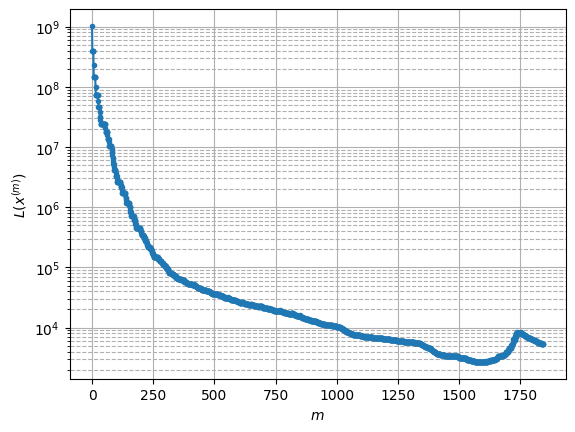

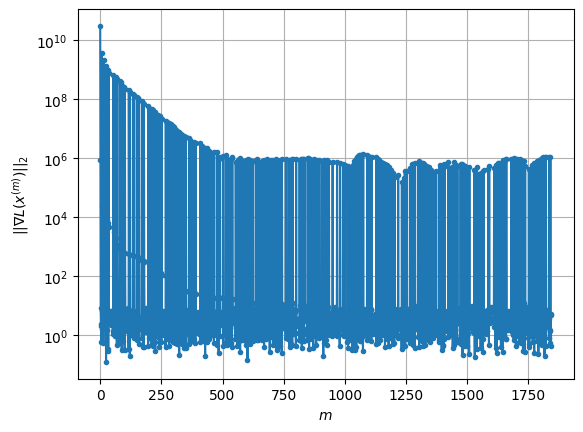

Windows:  51%|█████▏    | 152/296 [1:11:47<34:47, 14.50s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5158.756916662369
Gradient norm: 1018675.9766439965
Deviation from touching point norm = 0.0
Global relative error: 57.02959335398335
Position relative errors: 0.11305210450175966 m, 39.47400061856868 m, 24.698376110285817 m, 32.92641340253562 m

Iteration 1
Cost function: 5069.203248771269 (-1.74%)
Gradient norm: 3.6446866188224476 (-100.00%)
Deviation from touching point norm = 0.5289372520737532 (528937252073.75%)
Global relative error = 56.85218616731316 (-0.31%)
Position relative errors: 0.10645266149651696 m, 39.44218624672141 m, 24.333834254422502 m, 32.92919237705485 m

Iteration 2
Cost function: 5069.203249539185 (0.00%)
Gradient norm: 3.5903124096438024 (-1.49%)
Deviation from touching point norm = 0.528937251776145 (-0.00%)
Global relative error = 56.852186182013874 (0.00%)
Position relative errors: 0.10645265236140736 m, 39.44218624870792 m, 24.333834262201435 m, 32.92919239433729 m

STOP on

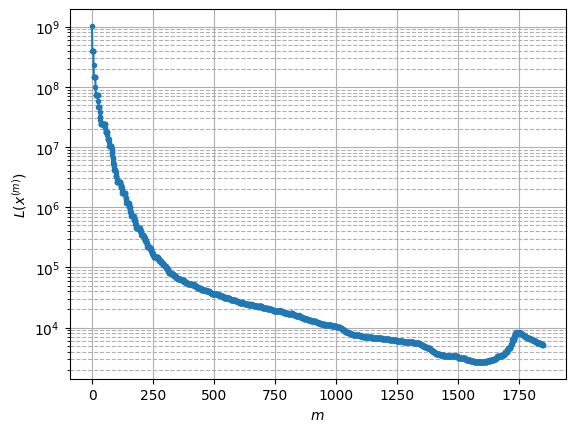

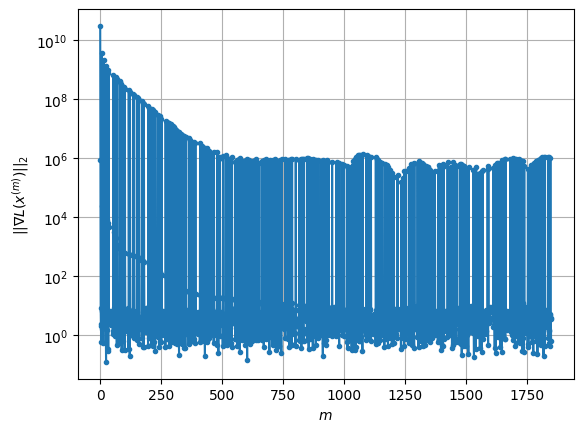

Windows:  52%|█████▏    | 153/296 [1:11:57<31:20, 13.15s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4983.659299849529
Gradient norm: 1042877.7798590873
Deviation from touching point norm = 0.0
Global relative error: 52.109042554041295
Position relative errors: 0.10125202069112615 m, 36.589319134993666 m, 22.923686923620245 m, 29.172954240299525 m

Iteration 1
Cost function: 4897.902330449435 (-1.72%)
Gradient norm: 4.8641843447116715 (-100.00%)
Deviation from touching point norm = 0.5078102253033812 (507810225303.38%)
Global relative error = 51.9568856541052 (-0.29%)
Position relative errors: 0.08648143873470292 m, 36.564222770331426 m, 22.59685445677585 m, 29.188066245897872 m

STOP on Iteration 2
Cost function = 4897.902328458176 (-0.00%)
Gradient norm = 0.5857448696389284 (-87.96%)
Deviation from touching point norm = 0.5078102290665102 (0.00%)
Global relative error = 51.956885667593966 (0.00%)
Final position relative errors: 0.08648144040061126 m, 36.56422277276874 m, 22.596854462129976 m, 29.1880

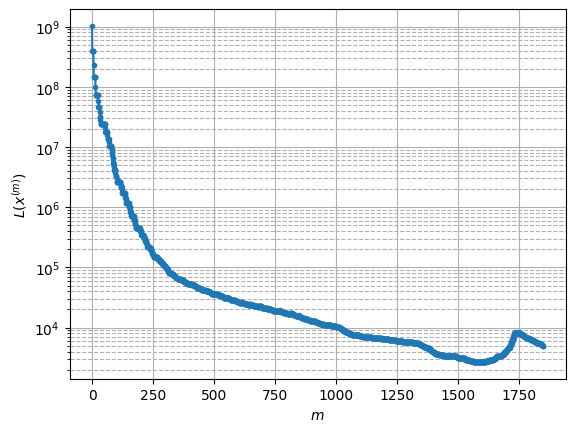

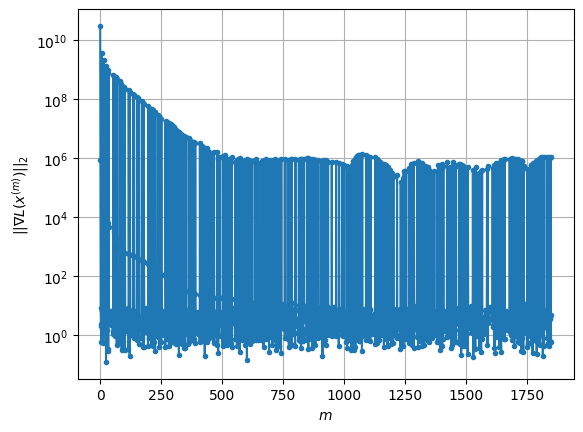

Windows:  52%|█████▏    | 154/296 [1:12:05<27:11, 11.49s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4793.604795662314
Gradient norm: 976427.9511407018
Deviation from touching point norm = 0.0
Global relative error: 47.04872510185791
Position relative errors: 0.08191184505927851 m, 33.555390737544236 m, 21.12734406444361 m, 25.322702555959506 m

Iteration 1
Cost function: 4711.981485392107 (-1.70%)
Gradient norm: 4.7476936925251865 (-100.00%)
Deviation from touching point norm = 0.5139436356742534 (513943635674.25%)
Global relative error = 46.92459792641589 (-0.26%)
Position relative errors: 0.08068075810424309 m, 33.535228791577275 m, 20.836205954632018 m, 25.36029848524258 m

Iteration 2
Cost function: 4711.98148661745 (0.00%)
Gradient norm: 4.369655674886387 (-7.96%)
Deviation from touching point norm = 0.5139436356519506 (-0.00%)
Global relative error = 46.924597937160854 (0.00%)
Position relative errors: 0.08068075737943511 m, 33.53522879441884 m, 20.836205956500443 m, 25.360298499833785 m

Iterat

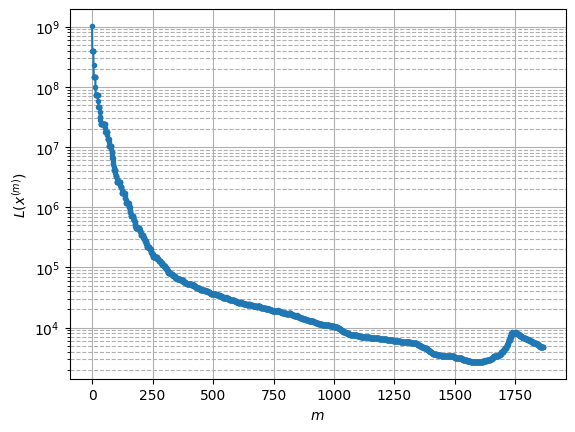

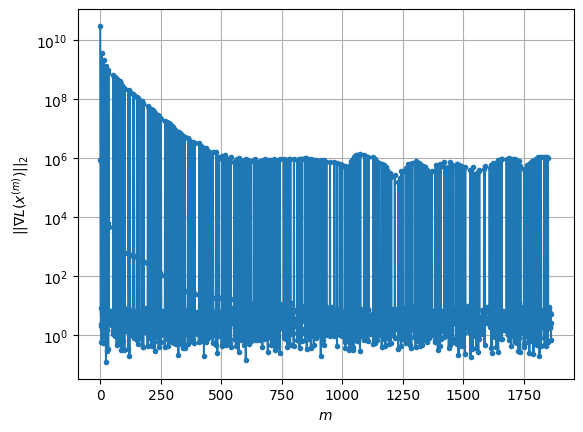

Windows:  52%|█████▏    | 155/296 [1:12:37<41:50, 17.81s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4603.16171373288
Gradient norm: 885249.4210132334
Deviation from touching point norm = 0.0
Global relative error: 41.88942350532867
Position relative errors: 0.07624738984572152 m, 30.38406025254354 m, 19.31546881469373 m, 21.411011258089573 m

Iteration 1
Cost function: 4525.447425306281 (-1.69%)
Gradient norm: 4.4229794467559405 (-100.00%)
Deviation from touching point norm = 0.5143762671034601 (514376267103.46%)
Global relative error = 41.7934640483635 (-0.23%)
Position relative errors: 0.07673546493972436 m, 30.371084974381354 m, 19.05904690886872 m, 21.47159980987906 m

STOP on Iteration 2
Cost function = 4525.4474254747 (0.00%)
Gradient norm = 0.34463734319657074 (-92.21%)
Deviation from touching point norm = 0.5143762771515192 (0.00%)
Global relative error = 41.793464056400566 (0.00%)
Final position relative errors: 0.07673546569336558 m, 30.371084976169104 m, 19.05904690579542 m, 21.471599825719

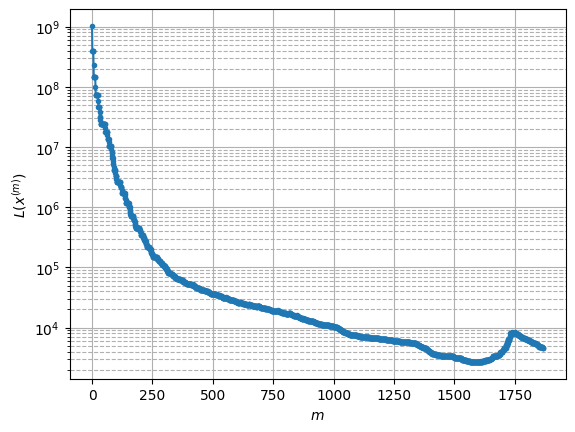

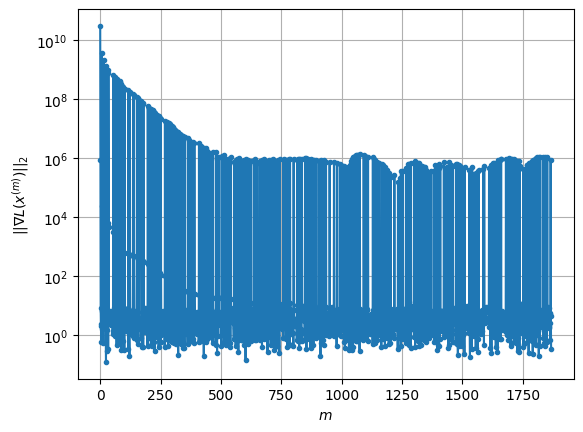

Windows:  53%|█████▎    | 156/296 [1:12:45<34:22, 14.74s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4421.190483230337
Gradient norm: 901600.9666181401
Deviation from touching point norm = 0.0
Global relative error: 36.67884409528891
Position relative errors: 0.07228739075478852 m, 27.09186945790661 m, 17.495135257894603 m, 17.472111171897772 m

Iteration 1
Cost function: 4347.849398243507 (-1.66%)
Gradient norm: 3.3368558002799786 (-100.00%)
Deviation from touching point norm = 0.49504812387225156 (495048123872.25%)
Global relative error = 36.61329101203304 (-0.18%)
Position relative errors: 0.06925303592801267 m, 27.084868160660502 m, 17.278067300821778 m, 17.561266535772763 m

Iteration 2
Cost function: 4347.849400163215 (0.00%)
Gradient norm: 7.949185390751633 (138.22%)
Deviation from touching point norm = 0.4950481268562597 (0.00%)
Global relative error = 36.613291017266455 (0.00%)
Position relative errors: 0.06925304320334677 m, 27.084868162549622 m, 17.27806729623023 m, 17.561266548259034 m

Ite

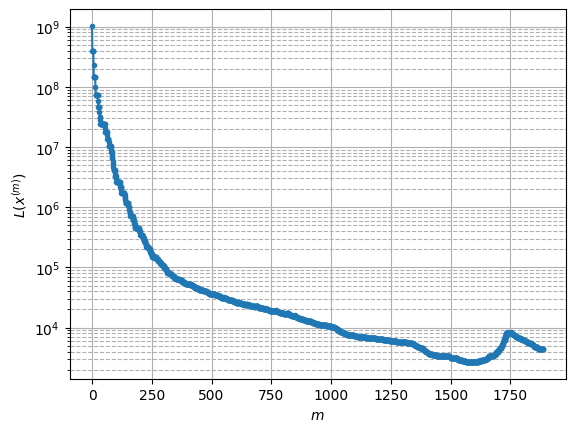

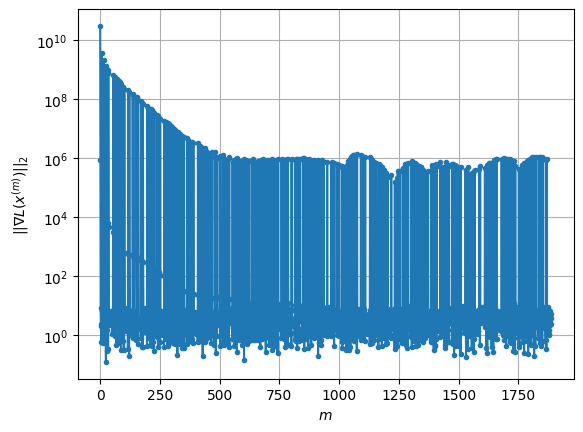

Windows:  53%|█████▎    | 157/296 [1:13:32<56:28, 24.38s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4243.300057973732
Gradient norm: 795527.3553921465
Deviation from touching point norm = 0.0
Global relative error: 31.48396379288006
Position relative errors: 0.06500035247190608 m, 23.69268412984741 m, 15.678726163883494 m, 13.566911552790172 m

Iteration 1
Cost function: 4174.676465356878 (-1.62%)
Gradient norm: 3.496701236018304 (-100.00%)
Deviation from touching point norm = 0.47552125109789034 (475521251097.89%)
Global relative error = 31.44993835987031 (-0.11%)
Position relative errors: 0.0640427729129457 m, 23.691877674652975 m, 15.500046731782193 m, 13.69412768207881 m

STOP on Iteration 2
Cost function = 4174.676465757366 (0.00%)
Gradient norm = 0.316800917076163 (-90.94%)
Deviation from touching point norm = 0.4755212553367477 (0.00%)
Global relative error = 31.44993836409464 (0.00%)
Final position relative errors: 0.06404277810580473 m, 23.69187767748869 m, 15.500046726167504 m, 13.6941276932

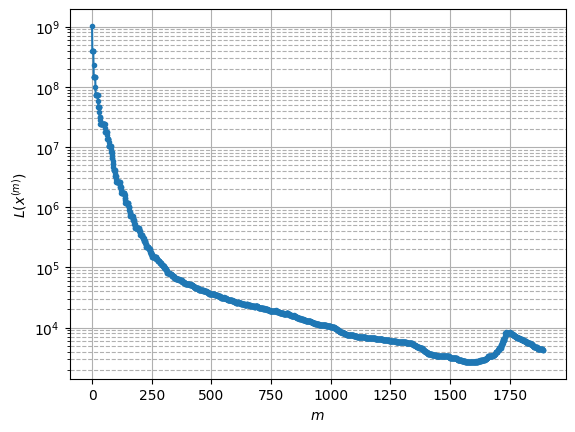

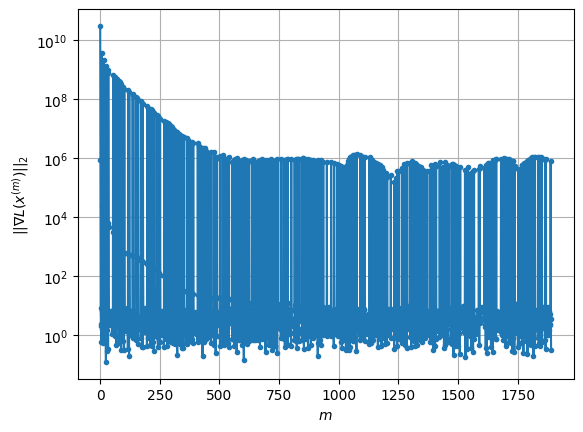

Windows:  53%|█████▎    | 158/296 [1:13:39<44:16, 19.25s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4080.6508994659266
Gradient norm: 697338.2426422387
Deviation from touching point norm = 0.0
Global relative error: 26.403303671450075
Position relative errors: 0.0598003225821493 m, 20.202679789462728 m, 13.872750222998482 m, 9.824468333554476 m

Iteration 1
Cost function: 4016.3055389925735 (-1.58%)
Gradient norm: 3.0796344809224396 (-100.00%)
Deviation from touching point norm = 0.4595307754675202 (459530775467.52%)
Global relative error = 26.40414921145519 (0.00%)
Position relative errors: 0.05684862725841794 m, 20.2065701501977 m, 13.73431245719693 m, 10.011487466197877 m

STOP on Iteration 2
Cost function = 4016.305539404877 (0.00%)
Gradient norm = 0.6822612817184148 (-77.85%)
Deviation from touching point norm = 0.4595307880736802 (0.00%)
Global relative error = 26.40414921387075 (0.00%)
Final position relative errors: 0.05684861926091396 m, 20.20657015257964 m, 13.734312449709961 m, 10.011487478

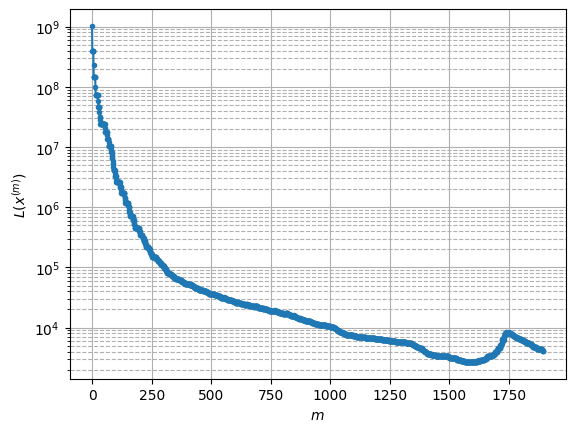

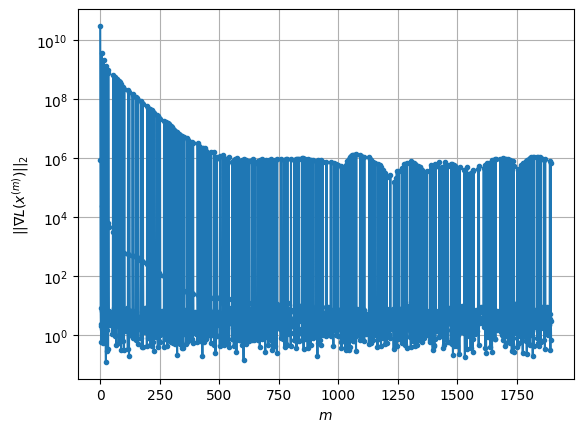

Windows:  54%|█████▎    | 159/296 [1:13:46<35:50, 15.70s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3935.860796897628
Gradient norm: 600413.5141756559
Deviation from touching point norm = 0.0
Global relative error: 21.60509854748411
Position relative errors: 0.05267193571857422 m, 16.637594602344834 m, 12.08639248733395 m, 6.624019203408274 m

Iteration 1
Cost function: 3876.138385989234 (-1.52%)
Gradient norm: 3.433024924799736 (-100.00%)
Deviation from touching point norm = 0.4262129649430583 (426212964943.06%)
Global relative error = 21.64095226811042 (0.17%)
Position relative errors: 0.058271565937864075 m, 16.647887571343226 m, 11.988871310080482 m, 6.8871501337918986 m

Iteration 2
Cost function: 3876.1383844296543 (-0.00%)
Gradient norm: 6.892938670004235 (100.78%)
Deviation from touching point norm = 0.4262129676872276 (0.00%)
Global relative error = 21.640952265635917 (-0.00%)
Position relative errors: 0.058271564112736346 m, 16.647887573059556 m, 11.988871302195076 m, 6.887150135609666 m

It

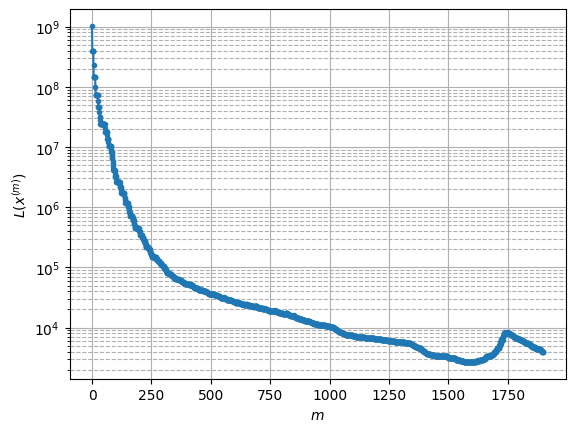

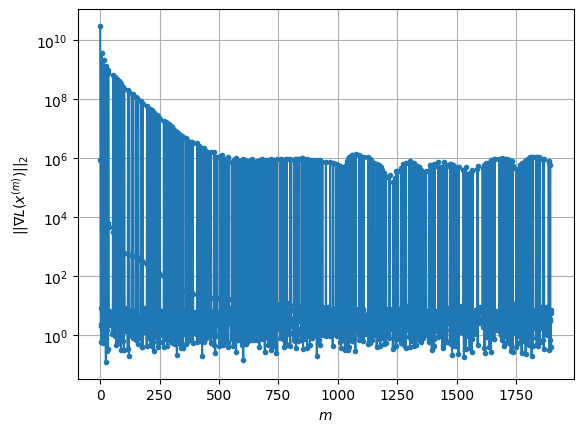

Windows:  54%|█████▍    | 160/296 [1:13:58<33:09, 14.63s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3806.284136621376
Gradient norm: 534793.732622957
Deviation from touching point norm = 0.0
Global relative error: 17.396913265798705
Position relative errors: 0.053982713041731537 m, 13.019228466785172 m, 10.327398518099628 m, 5.146321464841181 m

Iteration 1
Cost function: 3751.412957501891 (-1.44%)
Gradient norm: 2.94284013333014 (-100.00%)
Deviation from touching point norm = 0.3674865431599928 (367486543159.99%)
Global relative error = 17.46442223591539 (0.39%)
Position relative errors: 0.049764392119333166 m, 13.039471612760533 m, 10.27447321617744 m, 5.422307552915599 m

Iteration 2
Cost function: 3751.412957099104 (-0.00%)
Gradient norm: 1.3630180507635716 (-53.68%)
Deviation from touching point norm = 0.36748654713368195 (0.00%)
Global relative error = 17.464422234432828 (-0.00%)
Position relative errors: 0.049764389433509464 m, 13.039471615227091 m, 10.274473210165082 m, 5.422307553626069 m

ST

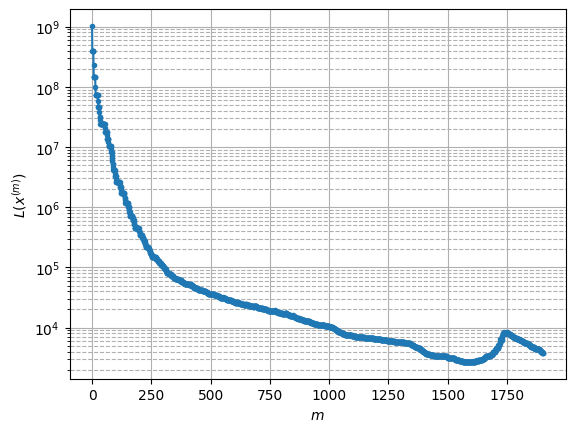

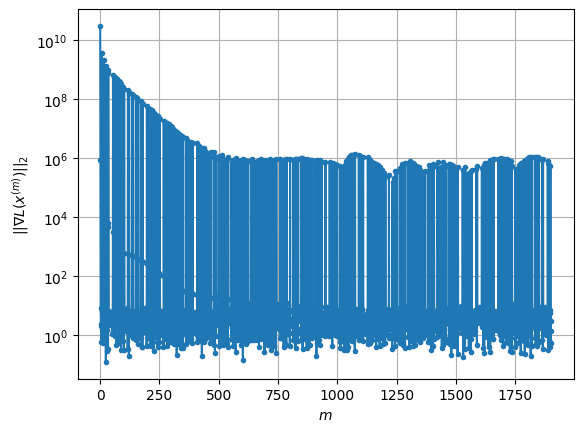

Windows:  54%|█████▍    | 161/296 [1:14:08<29:33, 13.14s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3683.139273576473
Gradient norm: 482748.05864325457
Deviation from touching point norm = 0.0
Global relative error: 14.355547581290784
Position relative errors: 0.045676759391313125 m, 9.379445538868056 m, 8.606338162938567 m, 6.635281568589731 m

Iteration 1
Cost function: 3630.1240555685754 (-1.44%)
Gradient norm: 6.3136162367089685 (-100.00%)
Deviation from touching point norm = 0.38032143991537204 (380321439915.37%)
Global relative error = 14.464416621776126 (0.76%)
Position relative errors: 0.050208697777362206 m, 9.410912889791634 m, 8.588296391121604 m, 6.8471249451230936 m

Iteration 2
Cost function: 3630.124054873601 (-0.00%)
Gradient norm: 8.335231432957134 (32.02%)
Deviation from touching point norm = 0.3803214576550935 (0.00%)
Global relative error = 14.46441662150005 (-0.00%)
Position relative errors: 0.05020869739367383 m, 9.410912893475368 m, 8.588296384787347 m, 6.847124947424608 m

Iter

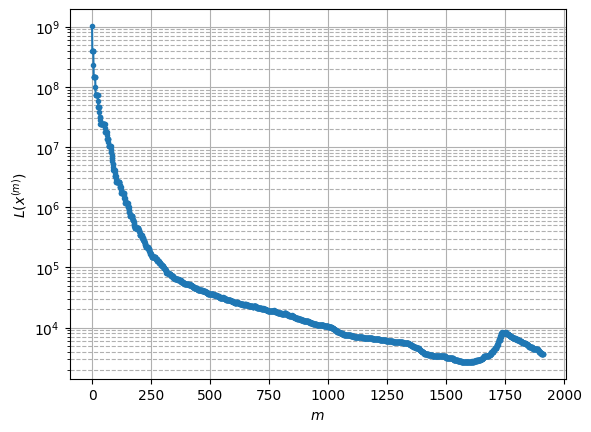

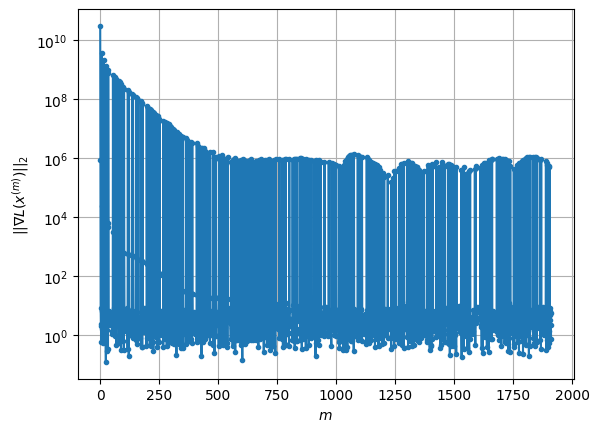

Windows:  55%|█████▍    | 162/296 [1:14:27<33:09, 14.85s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3583.3056201306704
Gradient norm: 660450.1648228811
Deviation from touching point norm = 0.0
Global relative error: 13.3375321830642
Position relative errors: 0.04603809433989423 m, 5.781474463268398 m, 6.919856062911734 m, 9.82691032520265 m

Iteration 1
Cost function: 3532.7420332006614 (-1.41%)
Gradient norm: 2.44074465535056 (-100.00%)
Deviation from touching point norm = 0.34448069850706287 (344480698507.06%)
Global relative error = 13.447645496349809 (0.83%)
Position relative errors: 0.036969800362141966 m, 5.839968052548883 m, 6.939975248012623 m, 9.927726147319047 m

Iteration 2
Cost function: 3532.7420324048476 (-0.00%)
Gradient norm: 1.177505608377229 (-51.76%)
Deviation from touching point norm = 0.34448071046759665 (0.00%)
Global relative error = 13.447645490782547 (-0.00%)
Position relative errors: 0.03696979607193255 m, 5.839968057554748 m, 6.939975242919646 m, 9.92772614040939 m

Iteratio

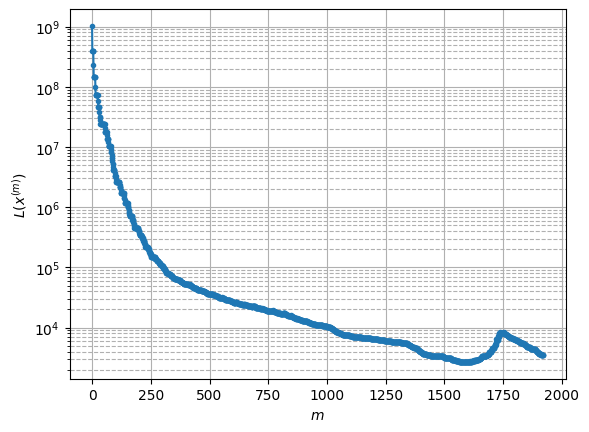

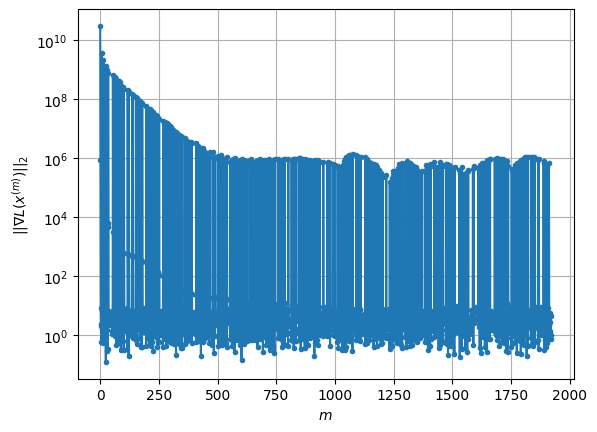

Windows:  55%|█████▌    | 163/296 [1:14:51<39:05, 17.63s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3495.7942775251886
Gradient norm: 406048.87823453423
Deviation from touching point norm = 0.0
Global relative error: 14.725322522444296
Position relative errors: 0.03345008659958062 m, 2.591821251861302 m, 5.277786044281146 m, 13.500071014259074 m

Iteration 1
Cost function: 3447.868986438091 (-1.37%)
Gradient norm: 2.698722782282682 (-100.00%)
Deviation from touching point norm = 0.33308740270814413 (333087402708.14%)
Global relative error = 14.811118066540754 (0.58%)
Position relative errors: 0.03646088889166062 m, 2.7178885948902356 m, 5.333929162746949 m, 13.546981030719984 m

Iteration 2
Cost function: 3447.8689874638676 (0.00%)
Gradient norm: 1.8294558284594669 (-32.21%)
Deviation from touching point norm = 0.3330874057269385 (0.00%)
Global relative error = 14.811118059937296 (-0.00%)
Position relative errors: 0.03646088876178704 m, 2.7178885870499983 m, 5.333929159458575 m, 13.546981026368368 m



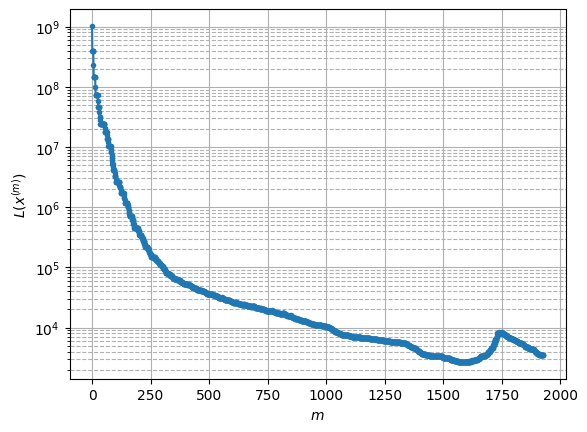

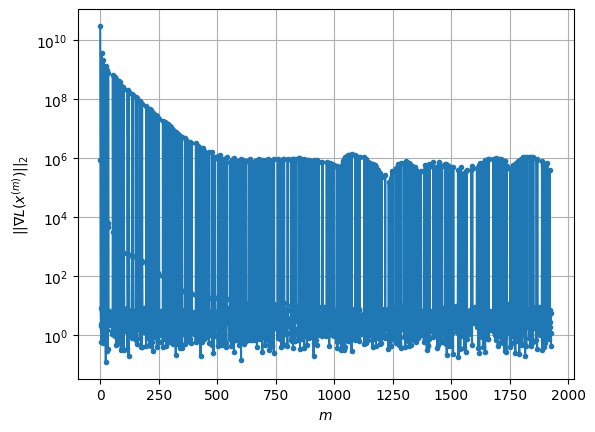

Windows:  55%|█████▌    | 164/296 [1:15:08<38:21, 17.44s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3429.584186832633
Gradient norm: 433362.0714215141
Deviation from touching point norm = 0.0
Global relative error: 17.923962940074077
Position relative errors: 0.033058286485750474 m, 2.848852020049895 m, 3.684873365190933 m, 17.30791028274053 m

Iteration 1
Cost function: 3384.294262624886 (-1.32%)
Gradient norm: 2.0742701578248957 (-100.00%)
Deviation from touching point norm = 0.2845462486696365 (284546248669.64%)
Global relative error = 17.960889297883426 (0.21%)
Position relative errors: 0.03450384431319469 m, 2.939943482233192 m, 3.776032278867459 m, 17.311307482279236 m

Iteration 2
Cost function: 3384.2942630102775 (0.00%)
Gradient norm: 3.43999174941789 (65.84%)
Deviation from touching point norm = 0.28454626091074176 (0.00%)
Global relative error = 17.960889298096628 (0.00%)
Position relative errors: 0.03450384475415178 m, 2.939943482171877 m, 3.7760322809307456 m, 17.311307482059895 m

Iterat

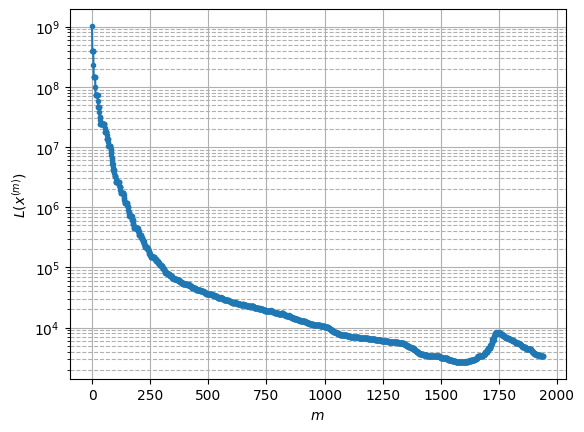

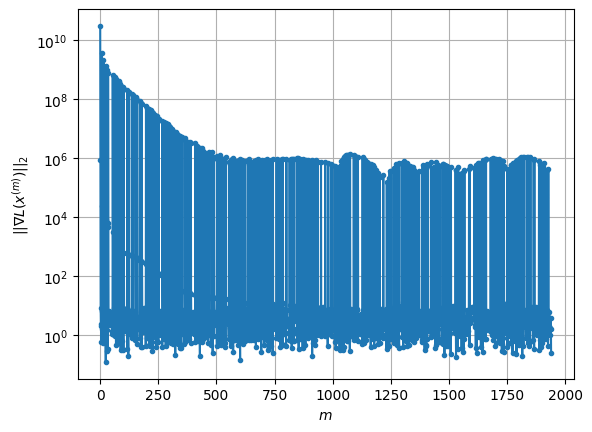

Windows:  56%|█████▌    | 165/296 [1:15:39<46:43, 21.40s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3366.6394256084027
Gradient norm: 647588.4097467257
Deviation from touching point norm = 0.0
Global relative error: 22.088794110005914
Position relative errors: 0.03139205505994718 m, 6.114110659233366 m, 2.150560319105409 m, 21.116284863822816 m

Iteration 1
Cost function: 3323.5891477465416 (-1.28%)
Gradient norm: 2.483632673538255 (-100.00%)
Deviation from touching point norm = 0.25791454871926567 (257914548719.27%)
Global relative error = 22.08713505723895 (-0.01%)
Position relative errors: 0.03291488664955967 m, 6.140306247586687 m, 2.271933466283941 m, 21.094225737597917 m

Iteration 2
Cost function: 3323.5891483886735 (0.00%)
Gradient norm: 3.2249612838021324 (29.85%)
Deviation from touching point norm = 0.2579145605185735 (0.00%)
Global relative error = 22.087135056818617 (-0.00%)
Position relative errors: 0.032914885230147906 m, 6.1403062468112495 m, 2.2719334711464696 m, 21.094225736862004 m



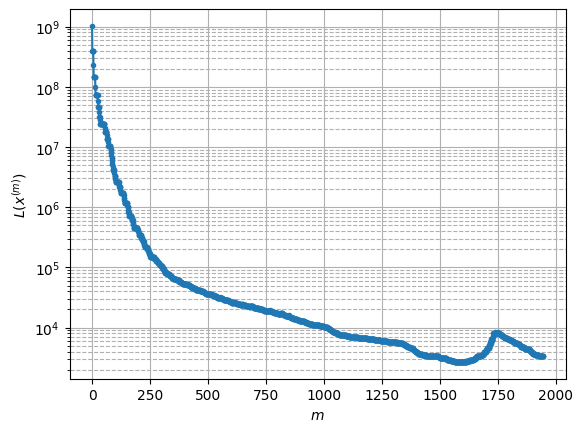

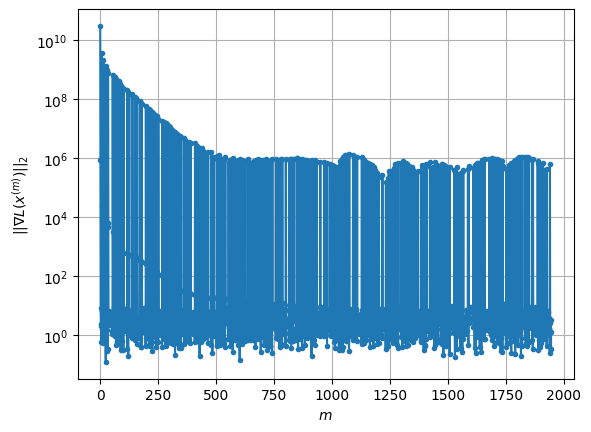

Windows:  56%|█████▌    | 166/296 [1:15:53<42:03, 19.41s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3331.148473136829
Gradient norm: 587808.4089761522
Deviation from touching point norm = 0.0
Global relative error: 26.70294459230146
Position relative errors: 0.029632673497611447 m, 9.68744544731004 m, 0.7169009186233558 m, 24.87321960327659 m

Iteration 1
Cost function: 3289.264139674638 (-1.26%)
Gradient norm: 1.5173576606832835 (-100.00%)
Deviation from touching point norm = 0.2448651030520663 (244865103052.07%)
Global relative error = 26.665822829198646 (-0.14%)
Position relative errors: 0.03072375756353646 m, 9.696965992812242 m, 0.8497959701647382 m, 24.825453287679817 m

Iteration 2
Cost function: 3289.264139471514 (-0.00%)
Gradient norm: 3.2250276247440657 (112.54%)
Deviation from touching point norm = 0.24486511462761362 (0.00%)
Global relative error = 26.66582283037976 (0.00%)
Position relative errors: 0.030723758046049467 m, 9.696965992266058 m, 0.8497959817856208 m, 24.82545328876342 m

Ite

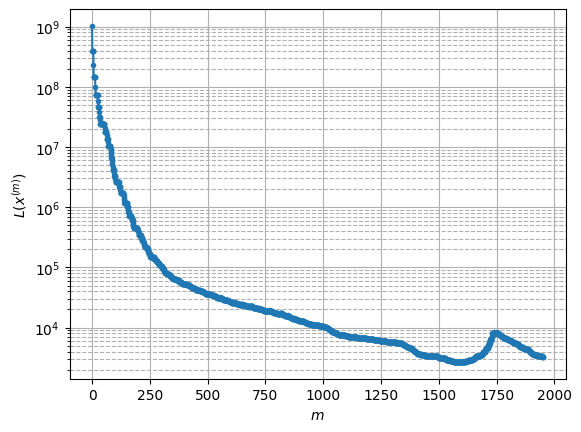

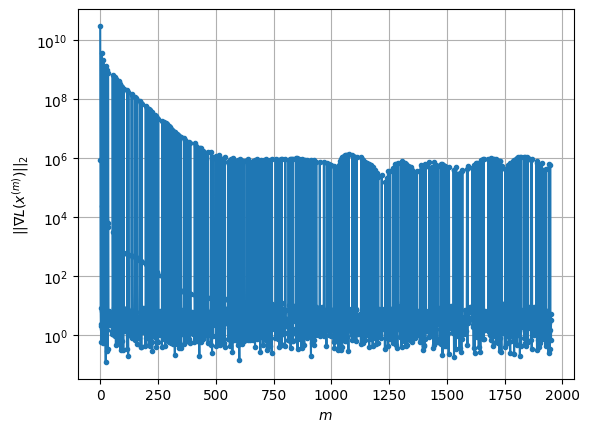

Windows:  56%|█████▋    | 167/296 [1:16:06<37:09, 17.29s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3279.0071011493455
Gradient norm: 484258.03228870995
Deviation from touching point norm = 0.0
Global relative error: 31.49054674062073
Position relative errors: 0.02750184854796396 m, 13.285662282760812 m, 0.8737892217348969 m, 28.537222404320932 m

Iteration 1
Cost function: 3239.3731639044563 (-1.21%)
Gradient norm: 2.4362038255851948 (-100.00%)
Deviation from touching point norm = 0.24271776560450728 (242717765604.51%)
Global relative error = 31.427416673351512 (-0.20%)
Position relative errors: 0.030018553774458306 m, 13.284219935514178 m, 0.7089285499207781 m, 28.472797428874813 m

Iteration 2
Cost function: 3239.373161965094 (-0.00%)
Gradient norm: 2.4881483236270348 (2.13%)
Deviation from touching point norm = 0.2427177715931927 (0.00%)
Global relative error = 31.427416671906602 (-0.00%)
Position relative errors: 0.030018554924326164 m, 13.2842199348348 m, 0.7089285436977076 m, 28.472797427750653

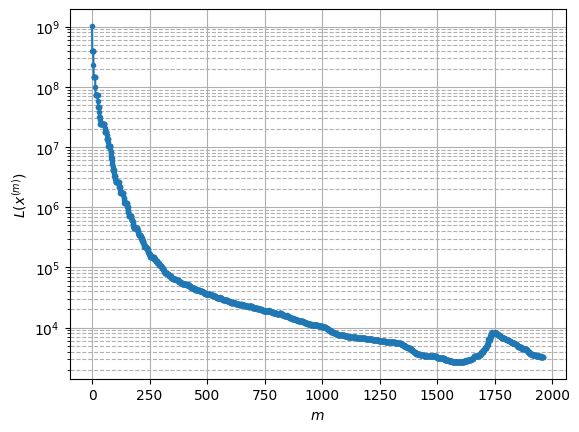

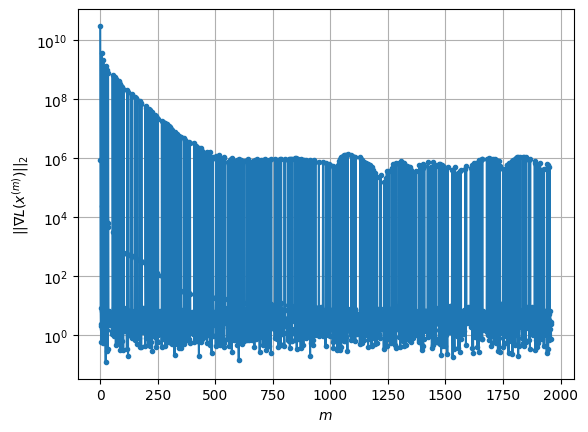

Windows:  57%|█████▋    | 168/296 [1:16:25<38:05, 17.86s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3240.41562415754
Gradient norm: 516901.8942123227
Deviation from touching point norm = 0.0
Global relative error: 36.307930774422346
Position relative errors: 0.026801817828252278 m, 16.84517826705893 m, 2.2132177696672914 m, 32.087362224151484 m

Iteration 1
Cost function: 3202.089407825713 (-1.18%)
Gradient norm: 2.4113071967136506 (-100.00%)
Deviation from touching point norm = 0.25076366295970254 (250763662959.70%)
Global relative error = 36.22214949851515 (-0.24%)
Position relative errors: 0.028129843901137788 m, 16.837064190306876 m, 2.017976044532431 m, 32.007443854193546 m

Iteration 2
Cost function: 3202.089409057343 (0.00%)
Gradient norm: 2.5885719775262612 (7.35%)
Deviation from touching point norm = 0.2507636641765036 (0.00%)
Global relative error = 36.22214950114585 (0.00%)
Position relative errors: 0.028129839907129476 m, 16.837064189434262 m, 2.0179760328464997 m, 32.00744385836993 m

Ite

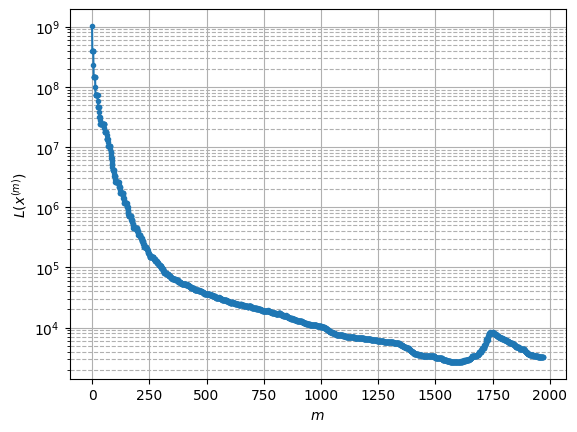

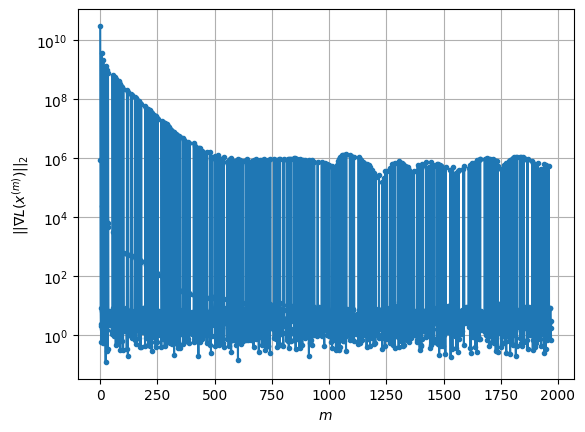

Windows:  57%|█████▋    | 169/296 [1:16:52<43:25, 20.52s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3215.018922349911
Gradient norm: 526748.7243925864
Deviation from touching point norm = 0.0
Global relative error: 41.06637869988104
Position relative errors: 0.02556940410844515 m, 20.338222184255564 m, 3.529465541266398 m, 35.50125281670699 m

Iteration 1
Cost function: 3176.7986307699757 (-1.19%)
Gradient norm: 1.4617479582907094 (-100.00%)
Deviation from touching point norm = 0.2808931035991844 (280893103599.18%)
Global relative error = 40.96024700530544 (-0.26%)
Position relative errors: 0.023543928002327054 m, 20.326196660914654 m, 3.3140323956564455 m, 35.40616879190444 m

Iteration 2
Cost function: 3176.798629356218 (-0.00%)
Gradient norm: 4.305718483470183 (194.56%)
Deviation from touching point norm = 0.2808931066547089 (0.00%)
Global relative error = 40.960247006813816 (0.00%)
Position relative errors: 0.023543928108415563 m, 20.326196660246094 m, 3.3140323824554443 m, 35.40616879526877 m

It

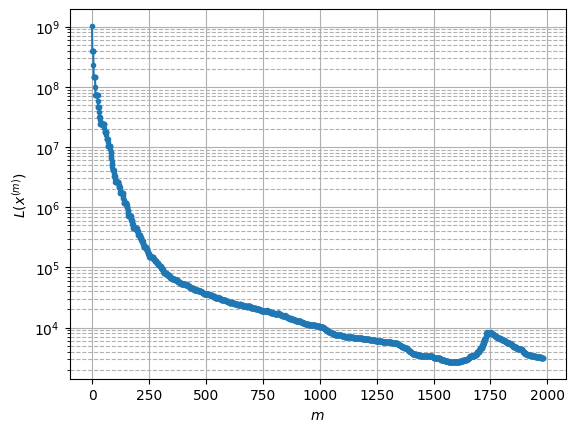

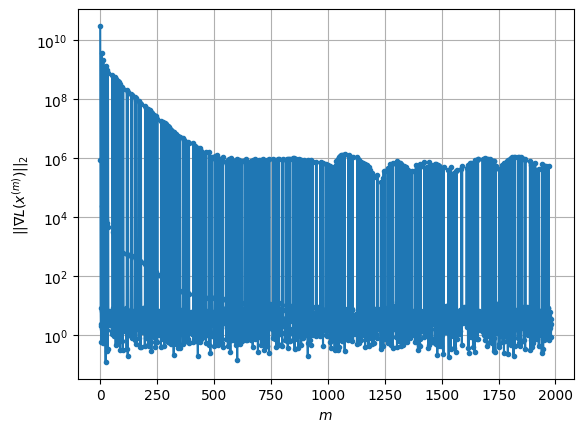

Windows:  57%|█████▋    | 170/296 [1:17:18<46:52, 22.32s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3182.5887001681544
Gradient norm: 546823.4098743575
Deviation from touching point norm = 0.0
Global relative error: 45.70674005989736
Position relative errors: 0.021182404353461047 m, 23.74523991564339 m, 4.791530045395818 m, 38.75956076738161 m

Iteration 1
Cost function: 3145.7777149675026 (-1.16%)
Gradient norm: 4.025960278222321 (-100.00%)
Deviation from touching point norm = 0.2897010126245763 (289701012624.58%)
Global relative error = 45.58797658236255 (-0.26%)
Position relative errors: 0.02111213960342593 m, 23.72465586983488 m, 4.56270682798391 m, 38.659781388731936 m

Iteration 2
Cost function: 3145.7777156722277 (0.00%)
Gradient norm: 3.139530305094125 (-22.02%)
Deviation from touching point norm = 0.2897010130596952 (0.00%)
Global relative error = 45.58797658476214 (0.00%)
Position relative errors: 0.021112139277320984 m, 23.724655869882323 m, 4.562706814127089 m, 38.65978139316801 m

Iterati

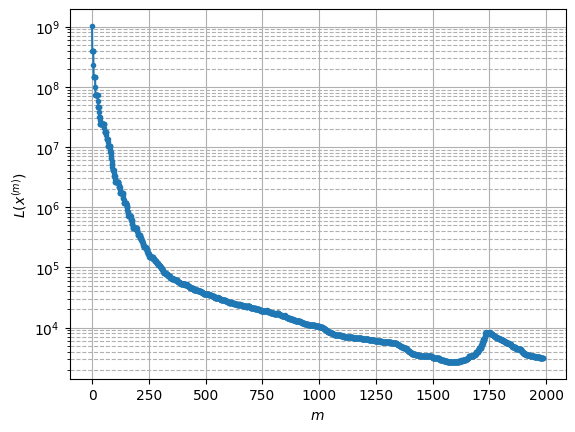

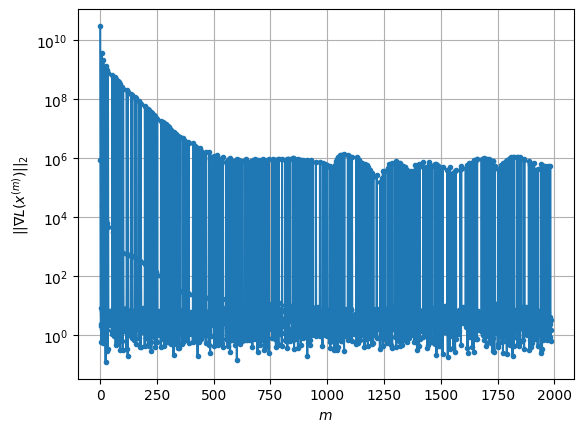

Windows:  58%|█████▊    | 171/296 [1:17:31<40:23, 19.39s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3144.7659855084125
Gradient norm: 610495.2877025597
Deviation from touching point norm = 0.0
Global relative error: 50.19096641873872
Position relative errors: 0.01879198578953668 m, 27.044238186118488 m, 5.99796704255174 m, 41.854031947393636 m

Iteration 1
Cost function: 3108.1669070341845 (-1.16%)
Gradient norm: 5.729769400459443 (-100.00%)
Deviation from touching point norm = 0.3276265662909561 (327626566290.96%)
Global relative error = 50.058200750525025 (-0.26%)
Position relative errors: 0.024495880245721705 m, 27.020002611155185 m, 5.756671811549129 m, 41.7444216819971 m

Iteration 2
Cost function: 3108.1669093841306 (0.00%)
Gradient norm: 2.6479236280769967 (-53.79%)
Deviation from touching point norm = 0.32762656642013016 (0.00%)
Global relative error = 50.058200754274324 (0.00%)
Position relative errors: 0.024495881429453706 m, 27.02000261162463 m, 5.75667179700452 m, 41.744421688194286 m

Ite

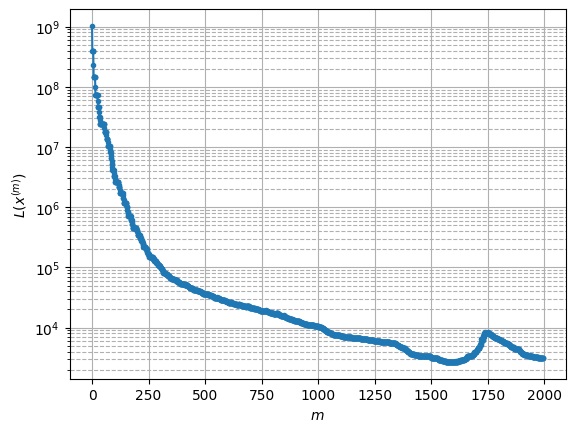

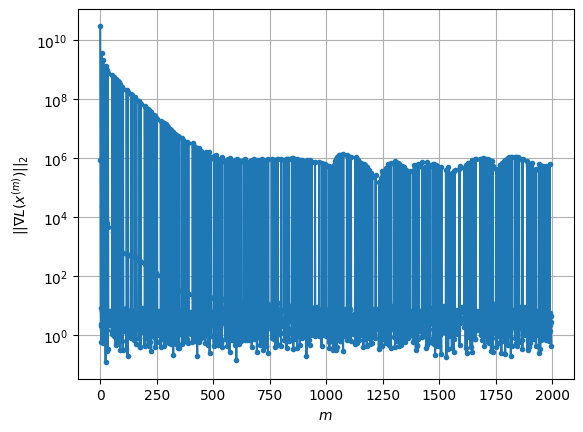

Windows:  58%|█████▊    | 172/296 [1:17:50<40:02, 19.38s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3103.4518854043918
Gradient norm: 567917.9281298926
Deviation from touching point norm = 0.0
Global relative error: 54.482481430366676
Position relative errors: 0.022941977365785335 m, 30.223780794227963 m, 7.145020765457568 m, 44.76389463948315 m

Iteration 1
Cost function: 3068.5829813112796 (-1.12%)
Gradient norm: 4.203063792779309 (-100.00%)
Deviation from touching point norm = 0.33637660481478787 (336376604814.79%)
Global relative error = 54.341700783219494 (-0.26%)
Position relative errors: 0.030348429591048304 m, 30.194656396053677 m, 6.893133832481805 m, 44.65177750981848 m

Iteration 2
Cost function: 3068.582982455715 (0.00%)
Gradient norm: 1.2413330605476276 (-70.47%)
Deviation from touching point norm = 0.3363766042295606 (-0.00%)
Global relative error = 54.34170078674757 (0.00%)
Position relative errors: 0.030348426764746538 m, 30.194656396968544 m, 6.893133817642476 m, 44.65177751578628 m



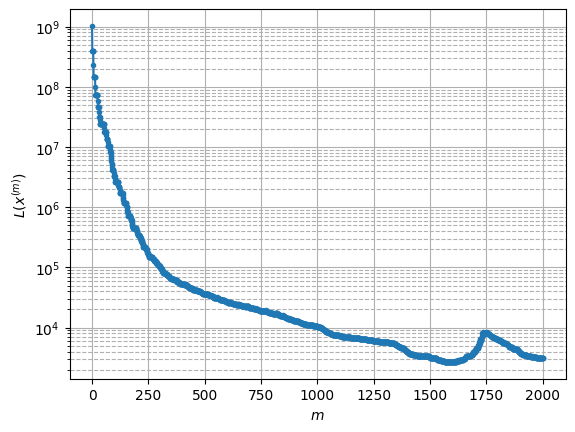

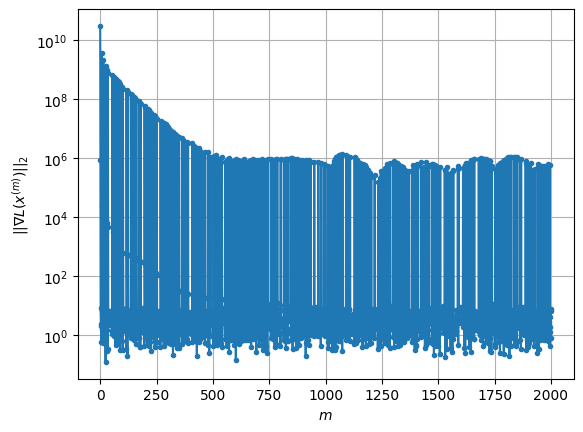

Windows:  58%|█████▊    | 173/296 [1:18:07<38:20, 18.70s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3044.574794836065
Gradient norm: 548988.3275628425
Deviation from touching point norm = 0.0
Global relative error: 58.55758931634388
Position relative errors: 0.029594107267878693 m, 33.267926474377006 m, 8.23115194482232 m, 47.48134851291277 m

Iteration 1
Cost function: 3011.7117812090396 (-1.08%)
Gradient norm: 2.1739047785226924 (-100.00%)
Deviation from touching point norm = 0.3568749305227337 (356874930522.73%)
Global relative error = 58.41134544334786 (-0.25%)
Position relative errors: 0.03898169724519216 m, 33.23518695503131 m, 7.9699971302864485 m, 47.368556390307276 m

Iteration 2
Cost function: 3011.711778889856 (-0.00%)
Gradient norm: 1.8607973169749028 (-14.40%)
Deviation from touching point norm = 0.356874933852804 (0.00%)
Global relative error = 58.41134544627805 (0.00%)
Position relative errors: 0.03898169592699669 m, 33.23518695532361 m, 7.969997115782066 m, 47.36855639615698 m

Iterati

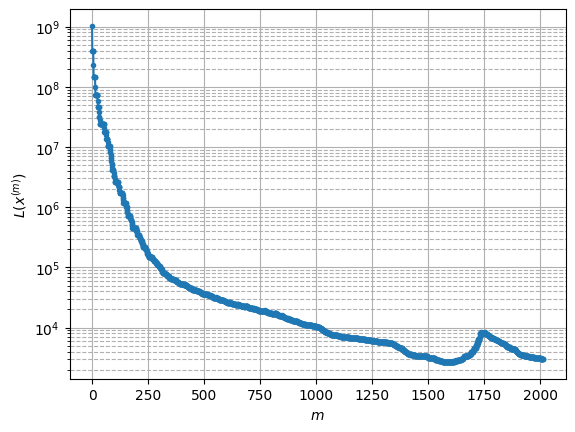

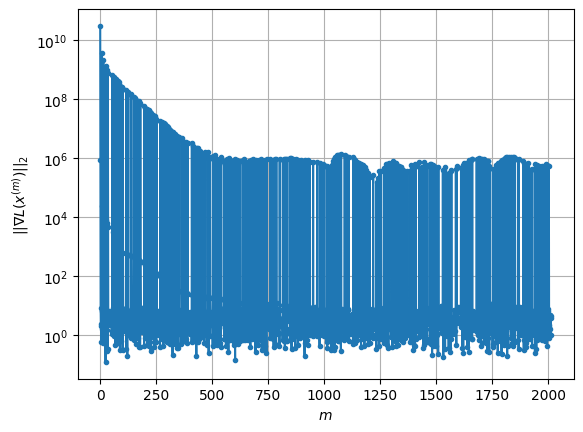

Windows:  59%|█████▉    | 174/296 [1:18:33<42:24, 20.86s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3006.022497777625
Gradient norm: 591740.0784187987
Deviation from touching point norm = 0.0
Global relative error: 62.393523966854175
Position relative errors: 0.03892128777701976 m, 36.163881391798434 m, 9.254567345879984 m, 49.99472425362793 m

Iteration 1
Cost function: 2972.773110197477 (-1.11%)
Gradient norm: 1.304360737591535 (-100.00%)
Deviation from touching point norm = 0.39636071393481864 (396360713934.82%)
Global relative error = 62.24013451768812 (-0.25%)
Position relative errors: 0.04905127292761828 m, 36.12886487557948 m, 8.984910026862261 m, 49.87789032794357 m

Iteration 2
Cost function: 2972.7731093574885 (-0.00%)
Gradient norm: 1.8625475817520862 (42.79%)
Deviation from touching point norm = 0.3963607169880989 (0.00%)
Global relative error = 62.240134522191354 (0.00%)
Position relative errors: 0.04905127616786215 m, 36.12886487638574 m, 8.984910013158713 m, 49.87789033544426 m

Iterati

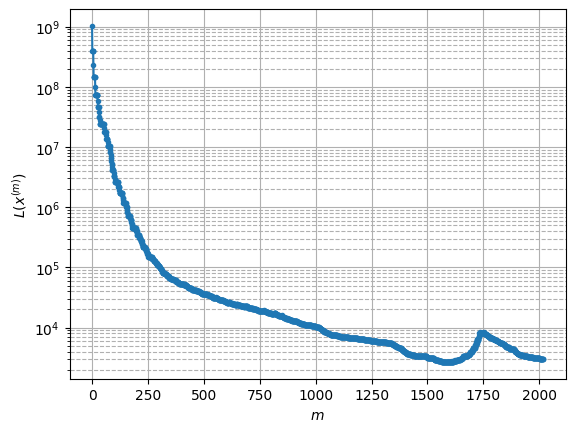

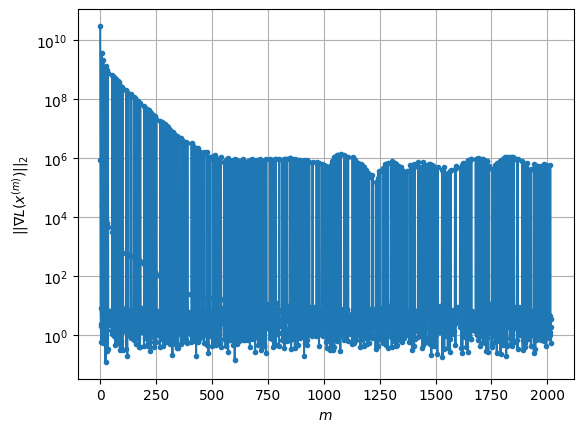

Windows:  59%|█████▉    | 175/296 [1:18:45<36:46, 18.24s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2971.2270349996447
Gradient norm: 601926.921433431
Deviation from touching point norm = 0.0
Global relative error: 65.96687077522373
Position relative errors: 0.048643193343300535 m, 38.899383849645616 m, 10.213408881743694 m, 52.28906157364782 m

Iteration 1
Cost function: 2937.9385667152983 (-1.12%)
Gradient norm: 1.6866629770774346 (-100.00%)
Deviation from touching point norm = 0.4164903251849236 (416490325184.92%)
Global relative error = 65.8087059729901 (-0.24%)
Position relative errors: 0.0658275504410622 m, 38.86322689162393 m, 9.935794575991103 m, 52.1699829406061 m

Iteration 2
Cost function: 2937.938567855805 (0.00%)
Gradient norm: 1.8871371525481633 (11.89%)
Deviation from touching point norm = 0.41649031607969894 (-0.00%)
Global relative error = 65.80870597868686 (0.00%)
Position relative errors: 0.06582754329156353 m, 38.8632268920863 m, 9.93579456349829 m, 52.169982949836005 m

Iteration 

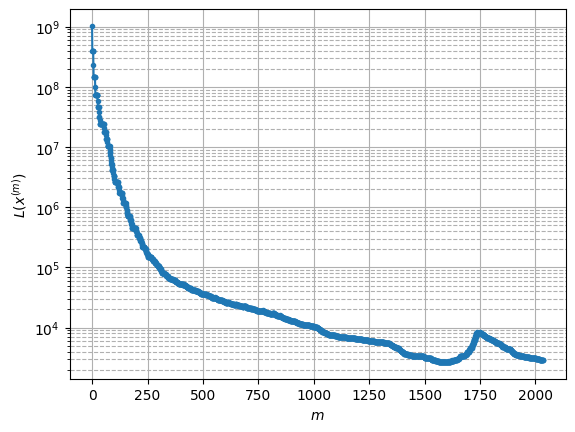

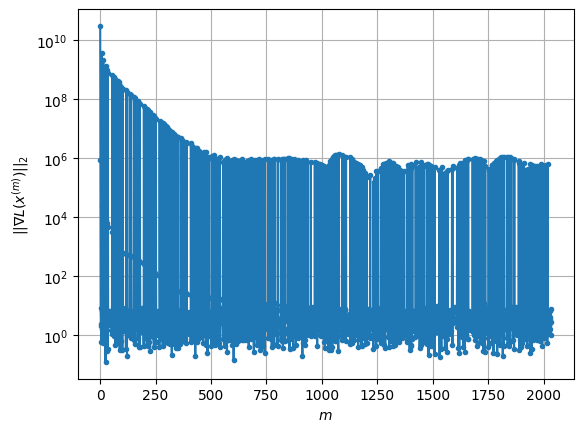

Windows:  59%|█████▉    | 176/296 [1:19:25<49:40, 24.84s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2904.8336643963517
Gradient norm: 627057.8575757226
Deviation from touching point norm = 0.0
Global relative error: 69.26070839095281
Position relative errors: 0.06525647583224871 m, 41.463201622124 m, 11.106085520204777 m, 54.35527482076502 m

Iteration 1
Cost function: 2870.4479232876515 (-1.18%)
Gradient norm: 1.5457271202766296 (-100.00%)
Deviation from touching point norm = 0.4728883873173842 (472888387317.38%)
Global relative error = 69.09829292856404 (-0.23%)
Position relative errors: 0.08028180315840092 m, 41.42394686989123 m, 10.822703899180583 m, 54.23550515513212 m

Iteration 2
Cost function: 2870.4479205503053 (-0.00%)
Gradient norm: 1.735403273352641 (12.27%)
Deviation from touching point norm = 0.47288839221774254 (0.00%)
Global relative error = 69.09829293525263 (0.00%)
Position relative errors: 0.0802818067145445 m, 41.423946871051236 m, 10.822703887749801 m, 54.23550516504341 m

Iterati

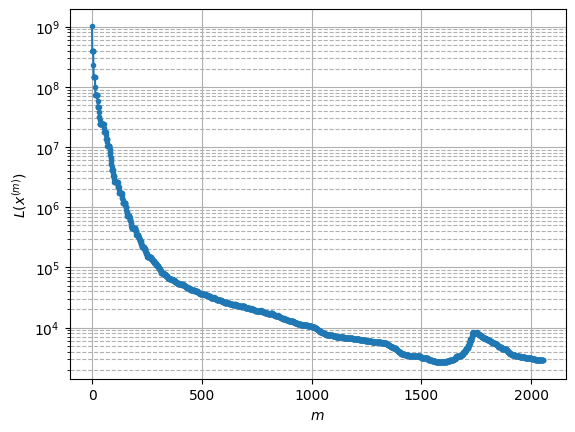

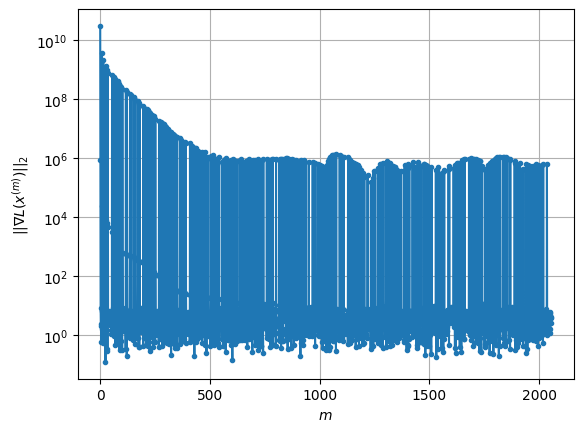

Windows:  60%|█████▉    | 177/296 [1:20:13<1:02:41, 31.61s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2840.8905066032507
Gradient norm: 633377.93945126
Deviation from touching point norm = 0.0
Global relative error: 72.25875607110052
Position relative errors: 0.07910881284833725 m, 43.84212795382887 m, 11.932806690721026 m, 56.185360440209074 m

Iteration 1
Cost function: 2808.0324650323178 (-1.16%)
Gradient norm: 1.8991444754896822 (-100.00%)
Deviation from touching point norm = 0.48169491172668105 (481694911726.68%)
Global relative error = 72.09634550492919 (-0.22%)
Position relative errors: 0.07689076870045995 m, 43.799828281387796 m, 11.645854157195027 m, 56.069808952430726 m

Iteration 2
Cost function: 2808.0324652860895 (0.00%)
Gradient norm: 1.429603852698685 (-24.72%)
Deviation from touching point norm = 0.4816949142689591 (0.00%)
Global relative error = 72.09634551152031 (0.00%)
Position relative errors: 0.07689076738866313 m, 43.79982828318853 m, 11.645854145932965 m, 56.06980896184009 m

Iter

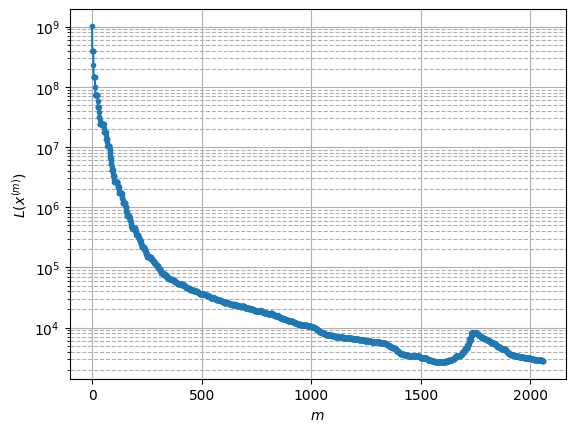

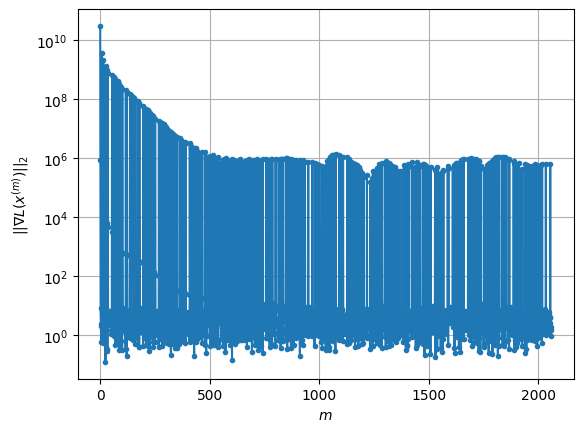

Windows:  60%|██████    | 178/296 [1:20:25<50:41, 25.78s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2754.8220292258075
Gradient norm: 594793.9170366757
Deviation from touching point norm = 0.0
Global relative error: 74.95002469495931
Position relative errors: 0.0754043855200376 m, 46.02577315528358 m, 12.693897697408815 m, 57.775353069179175 m

Iteration 1
Cost function: 2724.5596768654705 (-1.10%)
Gradient norm: 1.6266624144964614 (-100.00%)
Deviation from touching point norm = 0.4909137491102774 (490913749110.28%)
Global relative error = 74.7896274859599 (-0.21%)
Position relative errors: 0.08559681434895773 m, 45.98069284731542 m, 12.402412467835562 m, 57.66658350742134 m

Iteration 2
Cost function: 2724.5596760940216 (-0.00%)
Gradient norm: 5.123920950496173 (215.00%)
Deviation from touching point norm = 0.49091375328366105 (0.00%)
Global relative error = 74.7896274920024 (0.00%)
Position relative errors: 0.08559682004306336 m, 45.98069284865551 m, 12.402412457161283 m, 57.6665835164768 m

Iterati

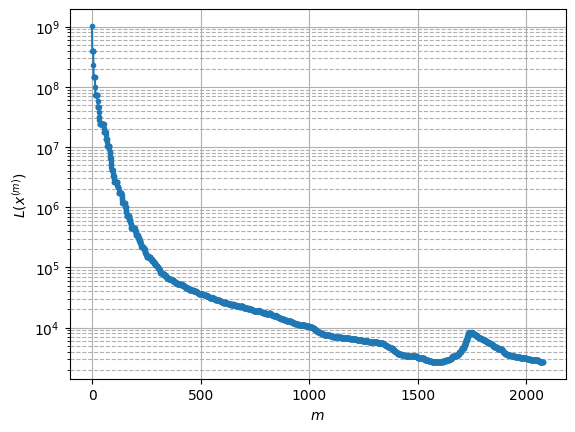

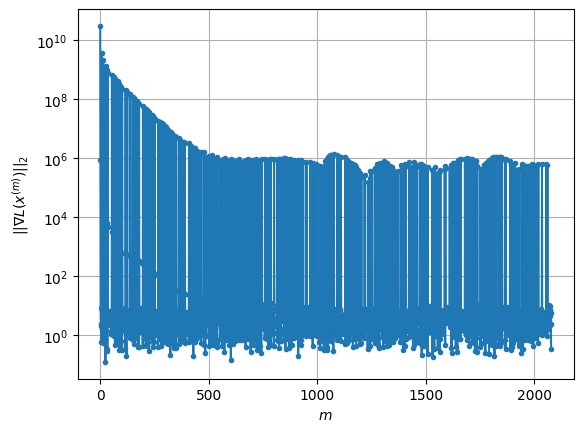

Windows:  60%|██████    | 179/296 [1:21:08<1:00:19, 30.93s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2671.0878437014917
Gradient norm: 639868.2179241865
Deviation from touching point norm = 0.0
Global relative error: 77.32319778680397
Position relative errors: 0.08393918166307253 m, 48.004832787301474 m, 13.386857137613909 m, 59.12018415187735 m

Iteration 1
Cost function: 2641.7031225702963 (-1.10%)
Gradient norm: 2.3095721777121585 (-100.00%)
Deviation from touching point norm = 0.5008722531633788 (500872253163.38%)
Global relative error = 77.16488522335338 (-0.20%)
Position relative errors: 0.08723410067638271 m, 47.957646147165526 m, 13.092232294934549 m, 59.01752077799265 m

STOP on Iteration 2
Cost function = 2641.7031213851537 (-0.00%)
Gradient norm = 0.7582190176360355 (-67.17%)
Deviation from touching point norm = 0.500872255033781 (0.00%)
Global relative error = 77.1648852292928 (0.00%)
Final position relative errors: 0.08723409550631542 m, 47.95764614870935 m, 13.092232285252567 m, 59.017520

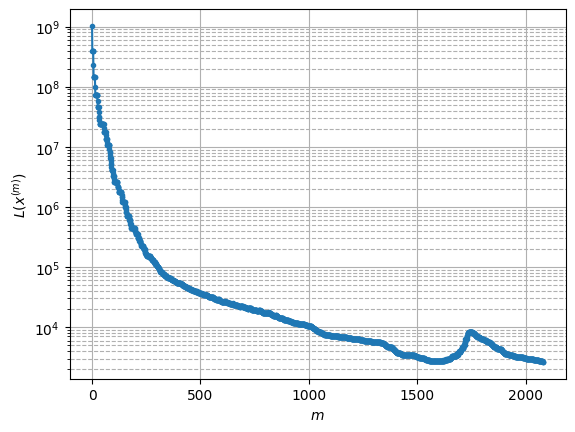

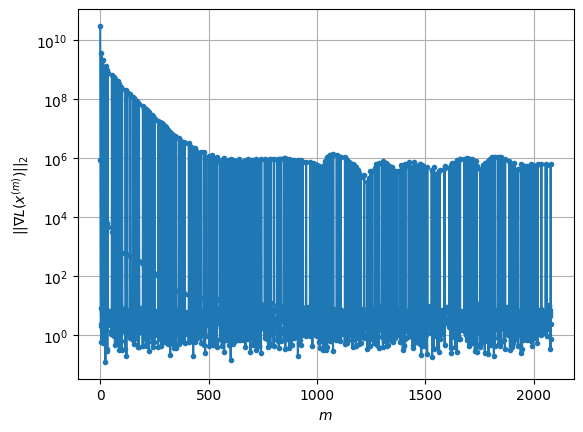

Windows:  61%|██████    | 180/296 [1:21:16<46:15, 23.92s/it]  


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2597.220665131607
Gradient norm: 494112.50810082565
Deviation from touching point norm = 0.0
Global relative error: 79.36695133587608
Position relative errors: 0.08545601880456115 m, 49.77126422195142 m, 14.011780787671464 m, 60.21291858858061 m

Iteration 1
Cost function: 2568.1532786708 (-1.12%)
Gradient norm: 1.5095073473589826 (-100.00%)
Deviation from touching point norm = 0.5161285340953642 (516128534095.36%)
Global relative error = 79.2109047861603 (-0.20%)
Position relative errors: 0.09858863357758534 m, 49.72318033551232 m, 13.716854734373893 m, 60.11496988081187 m

STOP on Iteration 2
Cost function = 2568.153278641422 (-0.00%)
Gradient norm = 0.49524115124609774 (-67.19%)
Deviation from touching point norm = 0.5161285347025087 (0.00%)
Global relative error = 79.21090479195013 (0.00%)
Final position relative errors: 0.09858862700559365 m, 49.72318033799682 m, 13.71685472499675 m, 60.11496988853

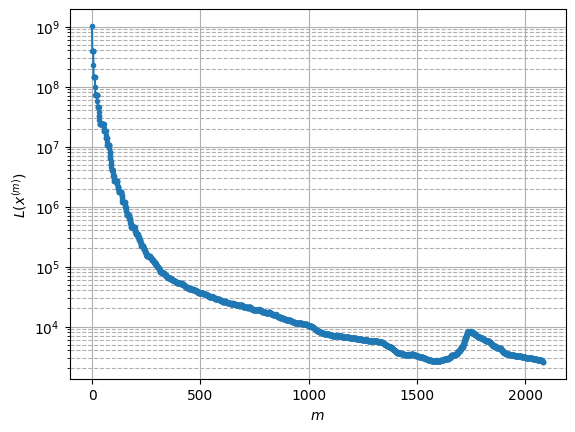

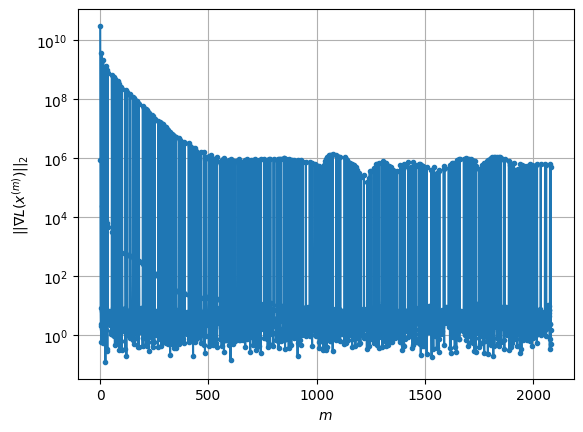

Windows:  61%|██████    | 181/296 [1:21:23<36:37, 19.11s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2514.4891738481597
Gradient norm: 479685.1616371852
Deviation from touching point norm = 0.0
Global relative error: 81.07192533661005
Position relative errors: 0.09640018398436571 m, 51.31858020916388 m, 14.57022860233712 m, 61.047183096715465 m

Iteration 1
Cost function: 2486.6894002225285 (-1.11%)
Gradient norm: 5.486788925098684 (-100.00%)
Deviation from touching point norm = 0.5159872432880054 (515987243288.01%)
Global relative error = 80.91946100390514 (-0.19%)
Position relative errors: 0.1064791203013672 m, 51.27079106396504 m, 14.273629440464903 m, 60.955035376502984 m

Iteration 2
Cost function: 2486.6894013473575 (0.00%)
Gradient norm: 1.5302458269450971 (-72.11%)
Deviation from touching point norm = 0.5159872474091265 (0.00%)
Global relative error = 80.91946100895474 (0.00%)
Position relative errors: 0.10647911854132838 m, 51.27079106583266 m, 14.273629432089283 m, 60.955035383599935 m

Itera

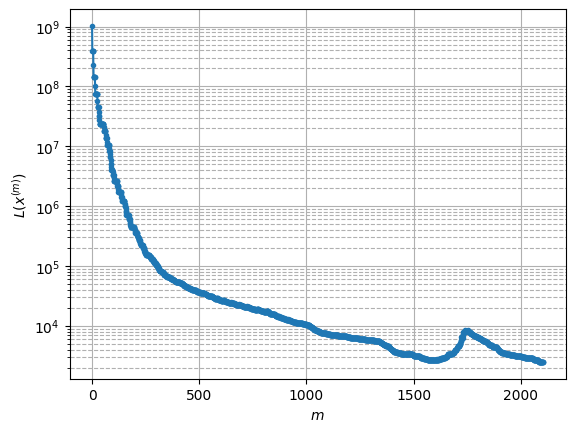

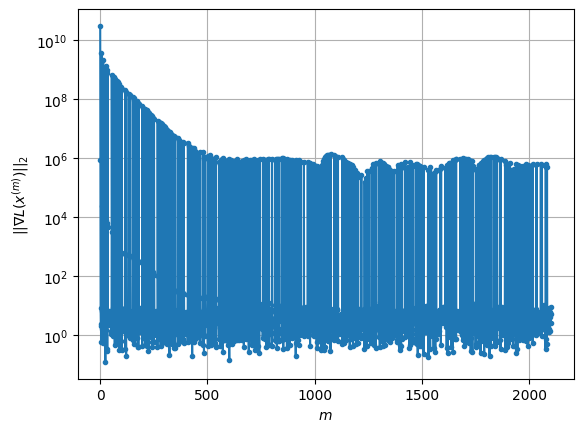

Windows:  61%|██████▏   | 182/296 [1:22:10<52:12, 27.48s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2436.1065325946342
Gradient norm: 452621.8759041669
Deviation from touching point norm = 0.0
Global relative error: 82.43158815455027
Position relative errors: 0.1040539951804839 m, 52.64106508753394 m, 15.06008039339701 m, 61.62034942908245 m

Iteration 1
Cost function: 2409.64780280671 (-1.09%)
Gradient norm: 5.534732183919465 (-100.00%)
Deviation from touching point norm = 0.5188672821841815 (518867282184.18%)
Global relative error = 82.28338787241408 (-0.18%)
Position relative errors: 0.11781701217703153 m, 52.5928533084825 m, 14.766230633067758 m, 61.534474695306066 m

Iteration 2
Cost function: 2409.647804261096 (0.00%)
Gradient norm: 4.461362296798146 (-19.39%)
Deviation from touching point norm = 0.5188672841035239 (0.00%)
Global relative error = 82.2833878767576 (0.00%)
Position relative errors: 0.11781700150299793 m, 52.592853310288135 m, 14.766230624431522 m, 61.53447470166378 m

Iteration 3


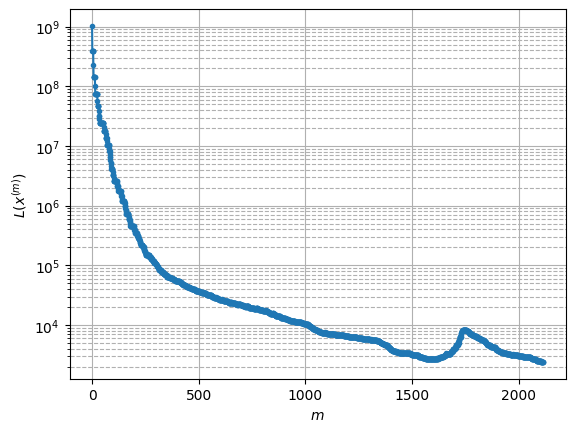

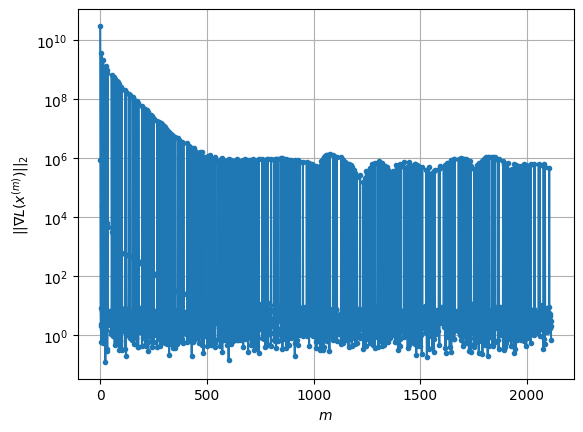

Windows:  62%|██████▏   | 183/296 [1:22:35<50:08, 26.62s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2363.4182387283613
Gradient norm: 544765.3523284553
Deviation from touching point norm = 0.0
Global relative error: 83.44050395007406
Position relative errors: 0.11499126673650843 m, 53.73217356116469 m, 15.484738368401844 m, 61.93044836686529 m

Iteration 1
Cost function: 2337.573057839299 (-1.09%)
Gradient norm: 3.9549813263784466 (-100.00%)
Deviation from touching point norm = 0.5176180024986755 (517618002498.68%)
Global relative error = 83.29633088615526 (-0.17%)
Position relative errors: 0.10476717781486193 m, 53.68388876324637 m, 15.19295337577338 m, 61.85047757407136 m

Iteration 2
Cost function: 2337.573059004644 (0.00%)
Gradient norm: 4.162160406073613 (5.24%)
Deviation from touching point norm = 0.5176180098926957 (0.00%)
Global relative error = 83.29633089006887 (0.00%)
Position relative errors: 0.10476718094545137 m, 53.68388876534266 m, 15.192953366987465 m, 61.85047757967534 m

Iteration 3

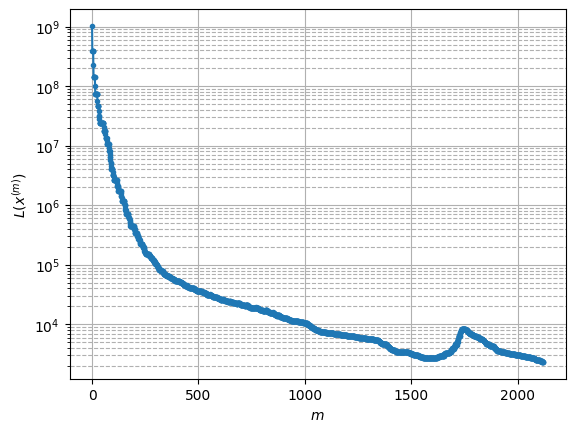

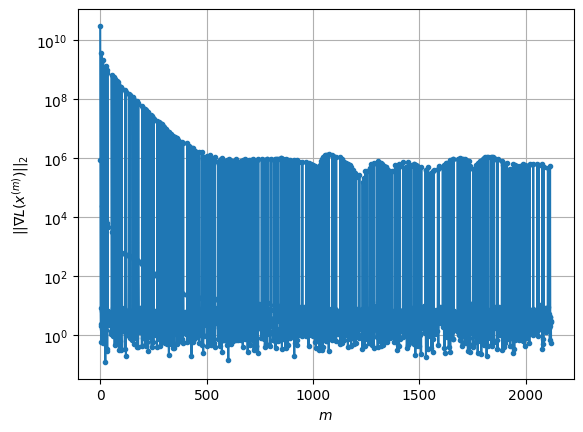

Windows:  62%|██████▏   | 184/296 [1:22:50<43:07, 23.10s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2303.9095263188046
Gradient norm: 390131.82243357913
Deviation from touching point norm = 0.0
Global relative error: 84.09412052729502
Position relative errors: 0.10286403516346104 m, 54.5874443526664 m, 15.843065588118819 m, 61.97595048568478 m

Iteration 1
Cost function: 2279.144199608645 (-1.07%)
Gradient norm: 2.01159232903935 (-100.00%)
Deviation from touching point norm = 0.5025661046967078 (502566104696.71%)
Global relative error = 83.95373690267974 (-0.17%)
Position relative errors: 0.10044319964729337 m, 54.53948049809507 m, 15.554024661813768 m, 61.90102548713334 m

Iteration 2
Cost function: 2279.144201797077 (0.00%)
Gradient norm: 1.08535659205337 (-46.04%)
Deviation from touching point norm = 0.5025661019932268 (-0.00%)
Global relative error = 83.95373690656693 (0.00%)
Position relative errors: 0.1004431960515358 m, 54.53948050029633 m, 15.554024654134295 m, 61.901025492401374 m

STOP on It

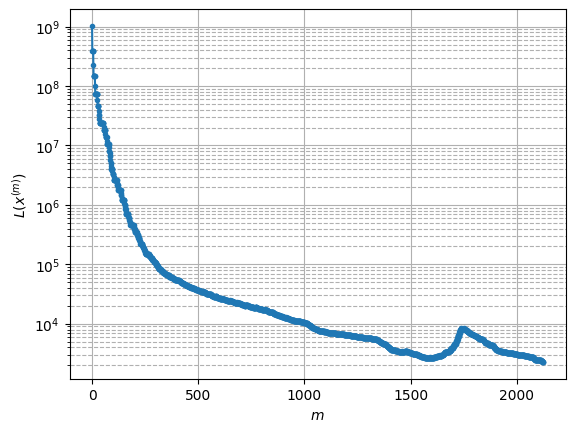

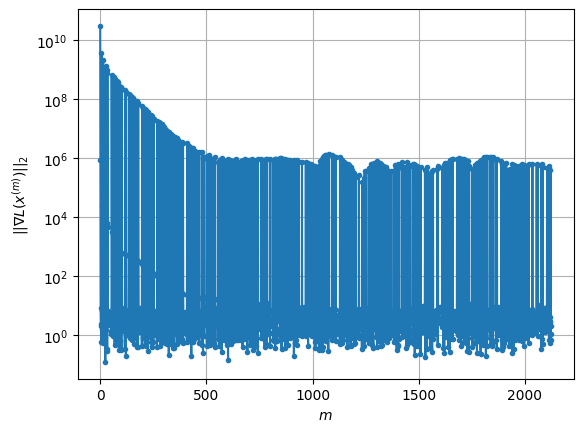

Windows:  62%|██████▎   | 185/296 [1:23:00<35:41, 19.29s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2246.3230769480215
Gradient norm: 388844.6978355488
Deviation from touching point norm = 0.0
Global relative error: 84.38961852267508
Position relative errors: 0.09856274346081055 m, 55.2035028700894 m, 16.135559854940073 m, 61.756091112245905 m

Iteration 1
Cost function: 2222.803574069481 (-1.05%)
Gradient norm: 1.2507783161673753 (-100.00%)
Deviation from touching point norm = 0.4859187718561879 (485918771856.19%)
Global relative error = 84.25351166735197 (-0.16%)
Position relative errors: 0.1084485042563996 m, 55.15548858525322 m, 15.850330332697276 m, 61.686962848432024 m

Iteration 2
Cost function: 2222.803574977062 (0.00%)
Gradient norm: 3.806517489684313 (204.33%)
Deviation from touching point norm = 0.48591876327294153 (-0.00%)
Global relative error = 84.25351167028943 (0.00%)
Position relative errors: 0.10844849542467086 m, 55.155488586740034 m, 15.850330325135442 m, 61.686962853073204 m

Iter

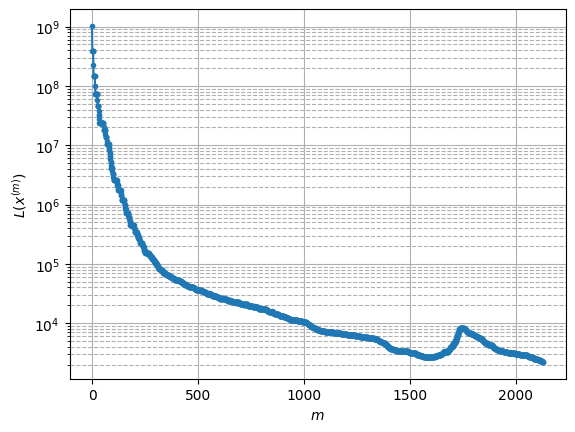

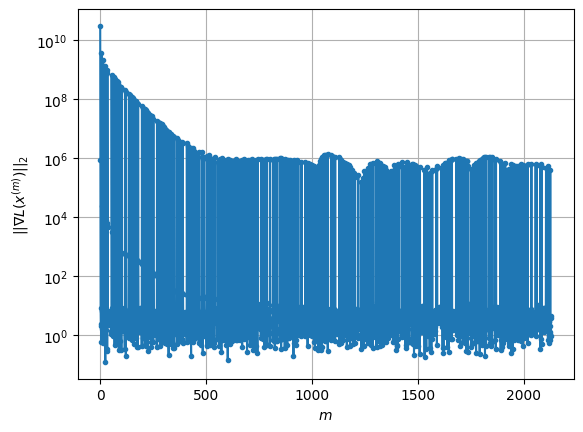

Windows:  63%|██████▎   | 186/296 [1:23:13<31:34, 17.23s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2187.9245653064127
Gradient norm: 372754.027630879
Deviation from touching point norm = 0.0
Global relative error: 84.32660402690466
Position relative errors: 0.10652463695659364 m, 55.57728207488962 m, 16.36330535175497 m, 61.272935137008574 m

Iteration 1
Cost function: 2166.3543449481617 (-0.99%)
Gradient norm: 1.6203893529746047 (-100.00%)
Deviation from touching point norm = 0.469486669608962 (469486669608.96%)
Global relative error = 84.19451175497419 (-0.16%)
Position relative errors: 0.11416180481203929 m, 55.52989055476613 m, 16.083929464375434 m, 61.208178136827044 m

STOP on Iteration 2
Cost function = 2166.3543444871466 (-0.00%)
Gradient norm = 0.7030780349405346 (-56.61%)
Deviation from touching point norm = 0.4694866845078036 (0.00%)
Global relative error = 84.19451175826109 (0.00%)
Final position relative errors: 0.11416179536899579 m, 55.529890556376984 m, 16.083929456345146 m, 61.208178

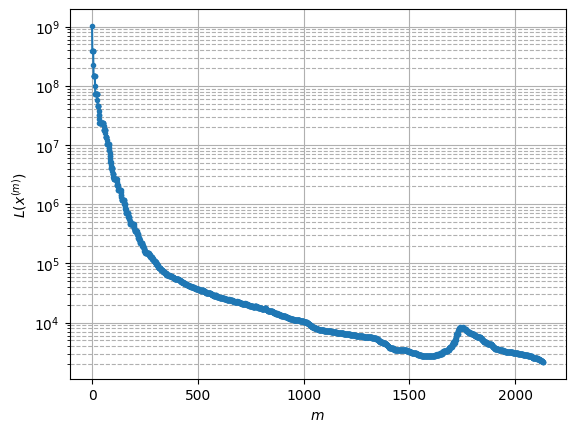

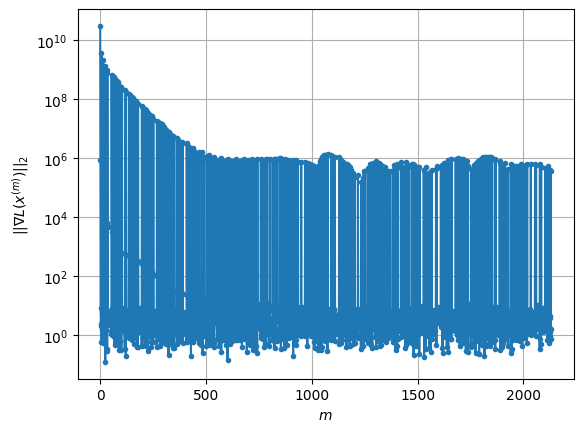

Windows:  63%|██████▎   | 187/296 [1:23:21<26:10, 14.41s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2173.3138174487135
Gradient norm: 478274.76196200645
Deviation from touching point norm = 0.0
Global relative error: 83.905689402991
Position relative errors: 0.1120777124742606 m, 55.70788595333206 m, 16.528497702372377 m, 60.52761457530569 m

Iteration 1
Cost function: 2152.121783643641 (-0.98%)
Gradient norm: 2.552820110886543 (-100.00%)
Deviation from touching point norm = 0.43539512963151017 (435395129631.51%)
Global relative error = 83.77773156950961 (-0.15%)
Position relative errors: 0.10030310997309021 m, 55.66160988748867 m, 16.256110629364127 m, 60.4667021222701 m

Iteration 2
Cost function: 2152.1217843494346 (0.00%)
Gradient norm: 3.637997395139679 (42.51%)
Deviation from touching point norm = 0.43539514007870966 (0.00%)
Global relative error = 83.77773157297192 (0.00%)
Position relative errors: 0.1003031141293693 m, 55.66160988977344 m, 16.2561106212694 m, 60.4667021271333 m

Iteration 3
Co

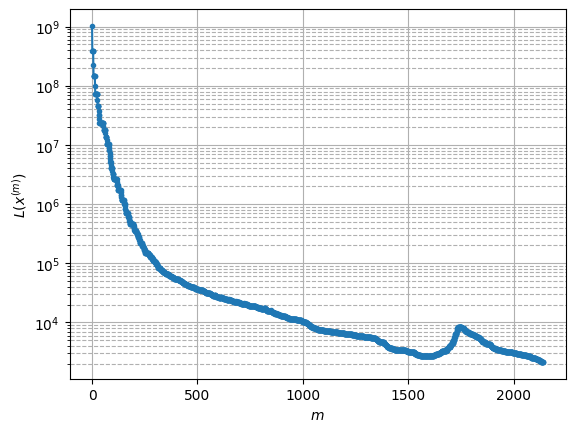

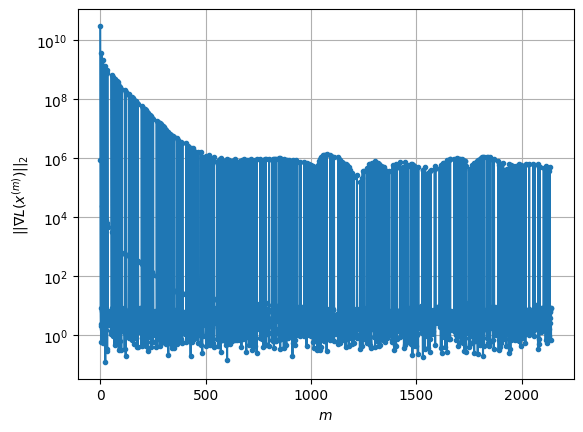

Windows:  64%|██████▎   | 188/296 [1:23:40<28:48, 16.01s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2151.4434520659906
Gradient norm: 455802.2711358455
Deviation from touching point norm = 0.0
Global relative error: 83.1295588644122
Position relative errors: 0.0989629018705168 m, 55.59529635506344 m, 16.632638102269084 m, 59.52337164606464 m

Iteration 1
Cost function: 2131.412791645116 (-0.93%)
Gradient norm: 4.646031643673546 (-100.00%)
Deviation from touching point norm = 0.4108382218575343 (410838221857.53%)
Global relative error = 83.00471317787917 (-0.15%)
Position relative errors: 0.09965051408404864 m, 55.54919574937941 m, 16.368584569001722 m, 59.46535467805374 m

Iteration 2
Cost function: 2131.4127922885277 (0.00%)
Gradient norm: 1.095674857279807 (-76.42%)
Deviation from touching point norm = 0.41083822588239605 (0.00%)
Global relative error = 83.00471318120618 (0.00%)
Position relative errors: 0.09965052481831019 m, 55.54919575148017 m, 16.368584560865518 m, 59.46535468295694 m

Iteration

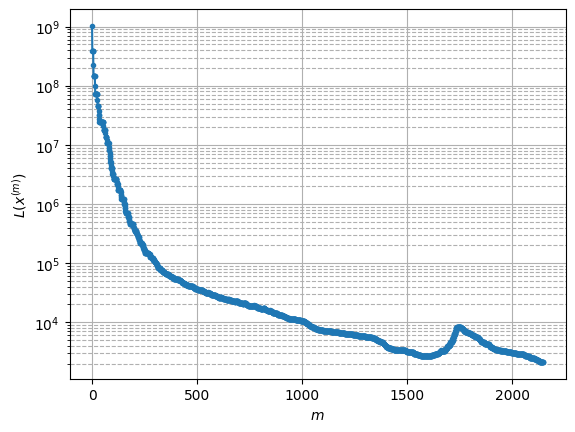

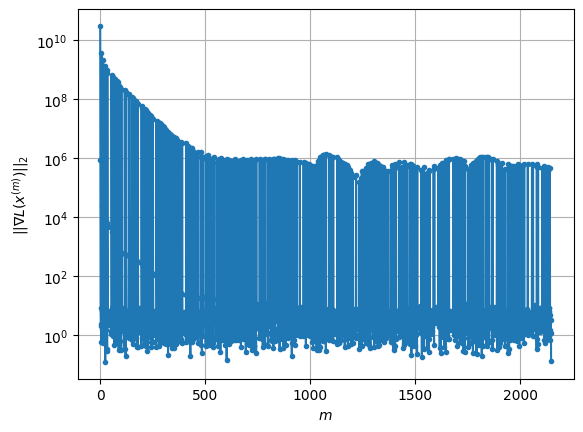

Windows:  64%|██████▍   | 189/296 [1:23:57<28:51, 16.18s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2133.221479657592
Gradient norm: 338702.97044159
Deviation from touching point norm = 0.0
Global relative error: 82.00148417060711
Position relative errors: 0.09836682915374759 m, 55.239240489707754 m, 16.67754564319573 m, 58.26421669378729 m

Iteration 1
Cost function: 2115.736461895461 (-0.82%)
Gradient norm: 2.1545732925787635 (-100.00%)
Deviation from touching point norm = 0.36401629505875466 (364016295058.75%)
Global relative error = 81.87977587281974 (-0.15%)
Position relative errors: 0.08847495175449621 m, 55.193196786803156 m, 16.42521807271814 m, 58.2083546055406 m

Iteration 2
Cost function: 2115.7364631089094 (0.00%)
Gradient norm: 2.4325409681037655 (12.90%)
Deviation from touching point norm = 0.364016309323632 (0.00%)
Global relative error = 81.87977587636043 (0.00%)
Position relative errors: 0.08847494970047298 m, 55.193196788608155 m, 16.425218063006458 m, 58.208354611553226 m

Iteration

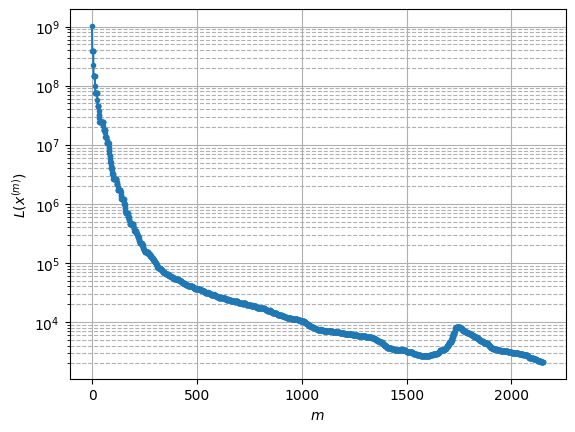

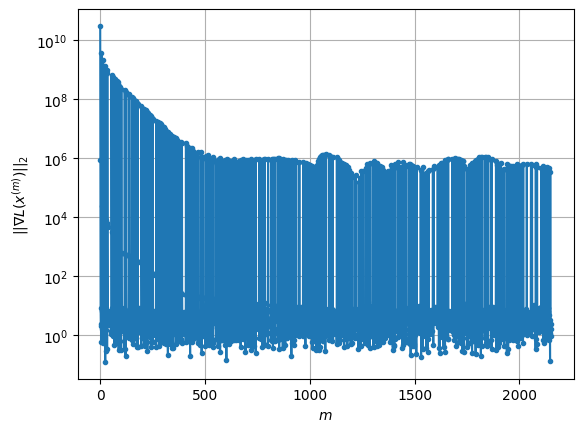

Windows:  64%|██████▍   | 190/296 [1:24:09<26:26, 14.97s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2113.9823970354596
Gradient norm: 323574.43293089163
Deviation from touching point norm = 0.0
Global relative error: 80.5274363323932
Position relative errors: 0.08795360309860643 m, 54.64132330264161 m, 16.667041243290413 m, 56.75557206352799 m

Iteration 1
Cost function: 2097.444209677203 (-0.78%)
Gradient norm: 1.2613730781646155 (-100.00%)
Deviation from touching point norm = 0.3521400809872997 (352140080987.30%)
Global relative error = 80.40994465678396 (-0.15%)
Position relative errors: 0.08721044181519787 m, 54.59686439521458 m, 16.42750326671639 m, 56.701589935086275 m

STOP on Iteration 2
Cost function = 2097.4442111203384 (0.00%)
Gradient norm = 0.2900015933154373 (-77.01%)
Deviation from touching point norm = 0.3521400797121822 (-0.00%)
Global relative error = 80.40994466042449 (0.00%)
Final position relative errors: 0.08721044231057386 m, 54.596864396835066 m, 16.427503256988242 m, 56.701589

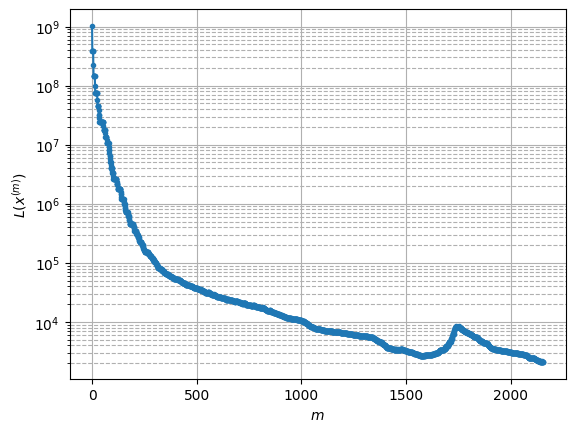

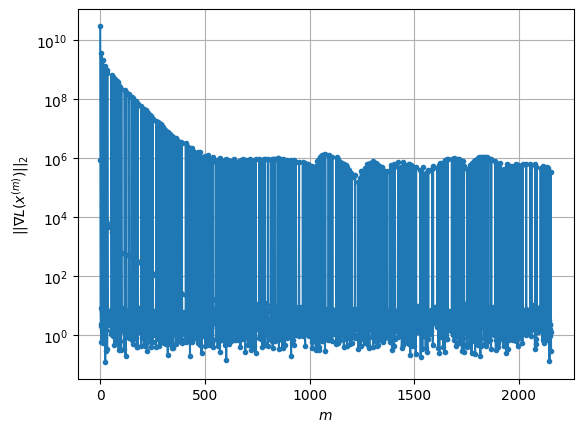

Windows:  65%|██████▍   | 191/296 [1:24:17<22:26, 12.82s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2113.99052618403
Gradient norm: 509441.65117457364
Deviation from touching point norm = 0.0
Global relative error: 78.71595057100278
Position relative errors: 0.08661395898461675 m, 53.805828457227406 m, 16.602780948945394 m, 55.00429715759489 m

Iteration 1
Cost function: 2098.0456948062047 (-0.75%)
Gradient norm: 5.620991701201741 (-100.00%)
Deviation from touching point norm = 0.32925411276944155 (329254112769.44%)
Global relative error = 78.60203706160345 (-0.14%)
Position relative errors: 0.08571718282466088 m, 53.76273066408036 m, 16.375334399570516 m, 54.9516964813581 m

Iteration 2
Cost function: 2098.0456973683827 (0.00%)
Gradient norm: 6.668981847232793 (18.64%)
Deviation from touching point norm = 0.32925411510911057 (0.00%)
Global relative error = 78.60203706580049 (0.00%)
Position relative errors: 0.08571718767746675 m, 53.762730665960376 m, 16.375334389211353 m, 54.951696488601534 m

STOP 

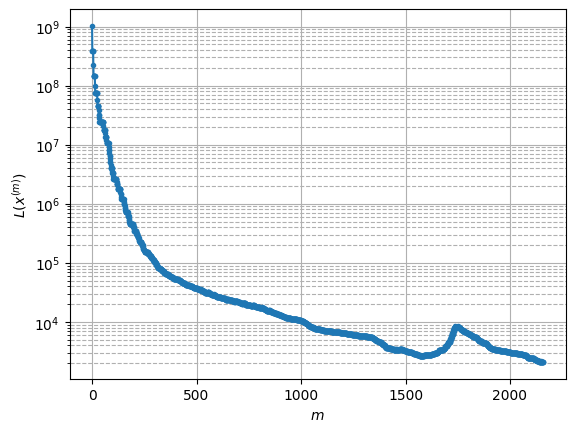

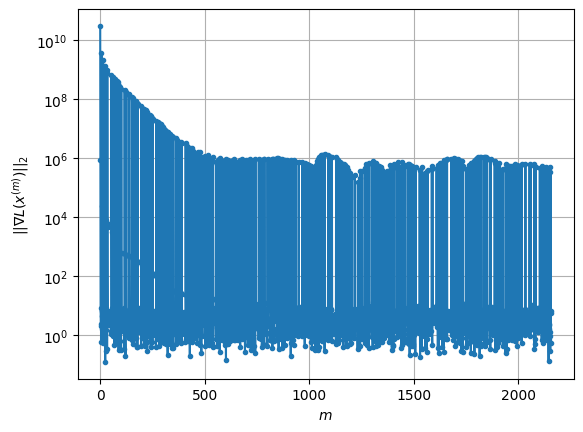

Windows:  65%|██████▍   | 192/296 [1:24:27<20:49, 12.01s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2125.4287957775323
Gradient norm: 463850.10231972055
Deviation from touching point norm = 0.0
Global relative error: 76.57555249764583
Position relative errors: 0.08497307213501665 m, 52.73642184240061 m, 16.48497100260333 m, 53.018129242434334 m

Iteration 1
Cost function: 2109.6666817424707 (-0.74%)
Gradient norm: 1.0412137984148002 (-100.00%)
Deviation from touching point norm = 0.2974130112121984 (297413011212.20%)
Global relative error = 76.46478755003679 (-0.14%)
Position relative errors: 0.08009452982240371 m, 52.69449978306829 m, 16.270494422032858 m, 52.96618256317974 m

Iteration 2
Cost function: 2109.666681474826 (-0.00%)
Gradient norm: 1.5022131431918913 (44.28%)
Deviation from touching point norm = 0.29741301610517673 (0.00%)
Global relative error = 76.46478755438733 (0.00%)
Position relative errors: 0.08009452756538463 m, 52.694499784396264 m, 16.270494410867467 m, 52.96618257157251 m

Ite

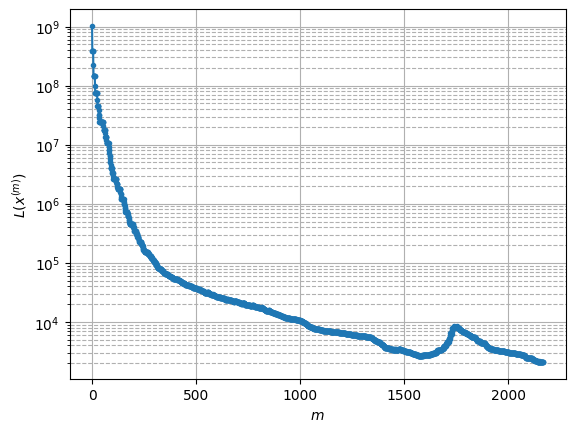

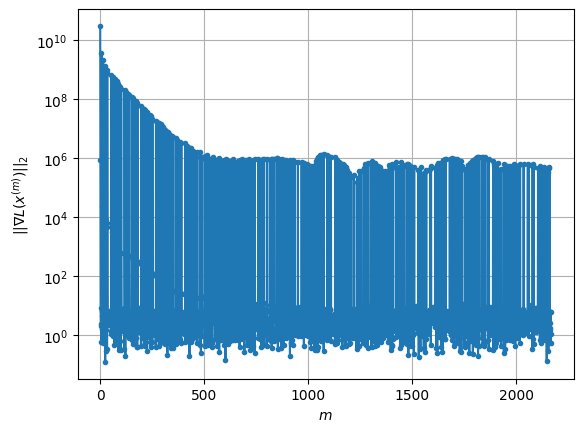

Windows:  65%|██████▌   | 193/296 [1:24:49<25:44, 14.99s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2109.8474326037117
Gradient norm: 382886.7777268978
Deviation from touching point norm = 0.0
Global relative error: 74.11660745539743
Position relative errors: 0.07923038723677706 m, 51.437935228646275 m, 16.315594488372525 m, 50.805545570802394 m

Iteration 1
Cost function: 2096.1395753993593 (-0.65%)
Gradient norm: 4.615323429453883 (-100.00%)
Deviation from touching point norm = 0.2737431551198439 (273743155119.84%)
Global relative error = 74.01019821657931 (-0.14%)
Position relative errors: 0.06564929588094252 m, 51.396800103912085 m, 16.114239826473867 m, 50.756313820845406 m

Iteration 2
Cost function: 2096.1395750968422 (-0.00%)
Gradient norm: 1.5558669138473427 (-66.29%)
Deviation from touching point norm = 0.2737431606096421 (0.00%)
Global relative error = 74.01019822122863 (0.00%)
Position relative errors: 0.0656492958800885 m, 51.39680010539729 m, 16.11423981515675 m, 50.75631382971385 m

Ite

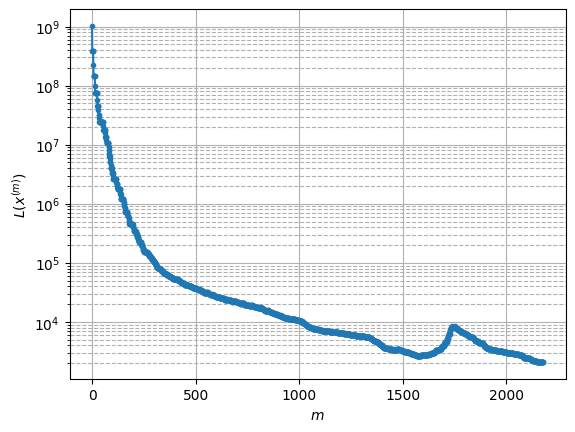

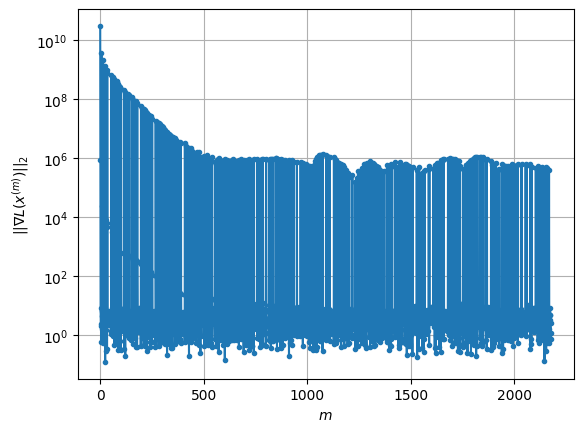

Windows:  66%|██████▌   | 194/296 [1:25:15<30:55, 18.19s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2118.322219259968
Gradient norm: 391069.82587805105
Deviation from touching point norm = 0.0
Global relative error: 71.3526671656993
Position relative errors: 0.0656925474237214 m, 49.9160072321439 m, 16.096058698737775 m, 48.37877108260682 m

Iteration 1
Cost function: 2104.43054717031 (-0.66%)
Gradient norm: 1.0074207478039972 (-100.00%)
Deviation from touching point norm = 0.28099755728458853 (280997557284.59%)
Global relative error = 71.24968942663469 (-0.14%)
Position relative errors: 0.06451611484158762 m, 49.874218824762636 m, 15.909296139134593 m, 48.331855557021015 m

Iteration 2
Cost function: 2104.430546785202 (-0.00%)
Gradient norm: 3.426512373404791 (240.13%)
Deviation from touching point norm = 0.2809975577770718 (0.00%)
Global relative error = 71.24968943165723 (0.00%)
Position relative errors: 0.06451611357872093 m, 49.87421882622235 m, 15.909296127269998 m, 48.33185556682597 m

Iteratio

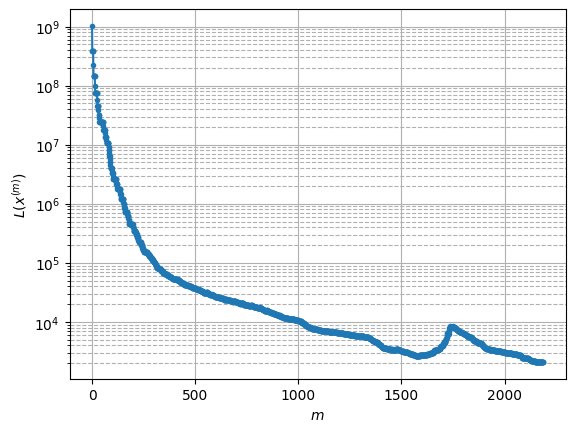

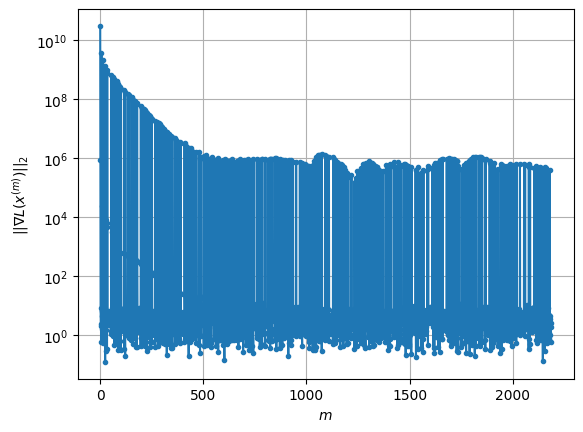

Windows:  66%|██████▌   | 195/296 [1:25:34<31:25, 18.67s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2141.2875842488907
Gradient norm: 490311.23948200553
Deviation from touching point norm = 0.0
Global relative error: 68.29676150821041
Position relative errors: 0.06431027553892495 m, 48.176275728113815 m, 15.82934065825666 m, 45.74843182743009 m

Iteration 1
Cost function: 2126.293446146749 (-0.70%)
Gradient norm: 1.0095015146812234 (-100.00%)
Deviation from touching point norm = 0.27115060220948256 (271150602209.48%)
Global relative error = 68.19740748665106 (-0.15%)
Position relative errors: 0.05877583941338044 m, 48.1353470145339 m, 15.6587452839231 m, 45.70199223356311 m

STOP on Iteration 2
Cost function = 2126.2934449018403 (-0.00%)
Gradient norm = 0.6987885500738671 (-30.78%)
Deviation from touching point norm = 0.27115060783450357 (0.00%)
Global relative error = 68.1974074918248 (0.00%)
Final position relative errors: 0.05877583822588893 m, 48.13534701593843 m, 15.658745271288995 m, 45.70199224

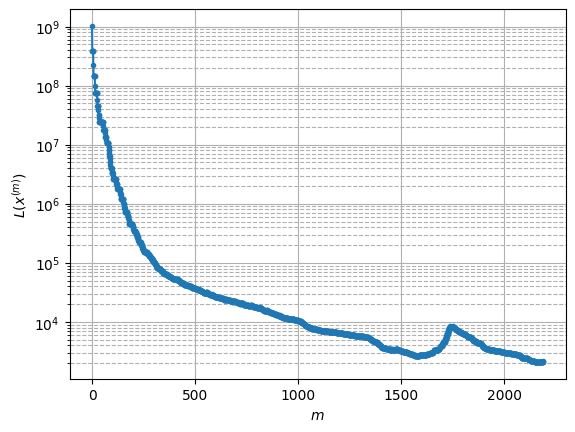

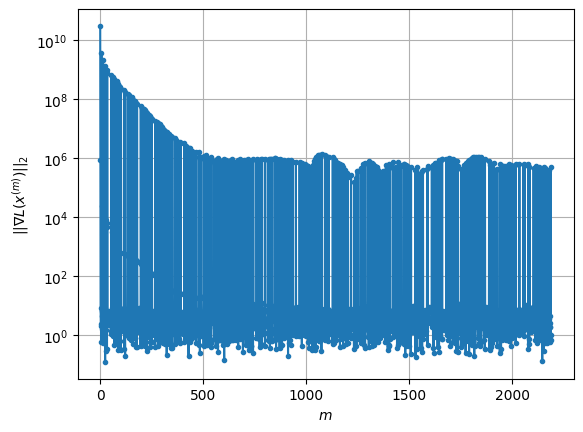

Windows:  66%|██████▌   | 196/296 [1:25:42<25:23, 15.24s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2144.6446464344303
Gradient norm: 596313.9033391709
Deviation from touching point norm = 0.0
Global relative error: 64.96457850583238
Position relative errors: 0.05882037663195381 m, 46.2282396875577 m, 15.518651558161613 m, 42.92447883829156 m

Iteration 1
Cost function: 2128.9583575485817 (-0.73%)
Gradient norm: 3.89069641609762 (-100.00%)
Deviation from touching point norm = 0.3080991627181382 (308099162718.14%)
Global relative error = 64.8704919868048 (-0.14%)
Position relative errors: 0.05456944556293463 m, 46.18783747760166 m, 15.364185568988887 m, 42.881229101655016 m

Iteration 2
Cost function: 2128.9583596126413 (0.00%)
Gradient norm: 5.89713588704834 (51.57%)
Deviation from touching point norm = 0.308099158334717 (-0.00%)
Global relative error = 64.87049199270794 (0.00%)
Position relative errors: 0.0545694470334745 m, 46.18783747981533 m, 15.36418555611227 m, 42.88122911281267 m

Iteration 3
C

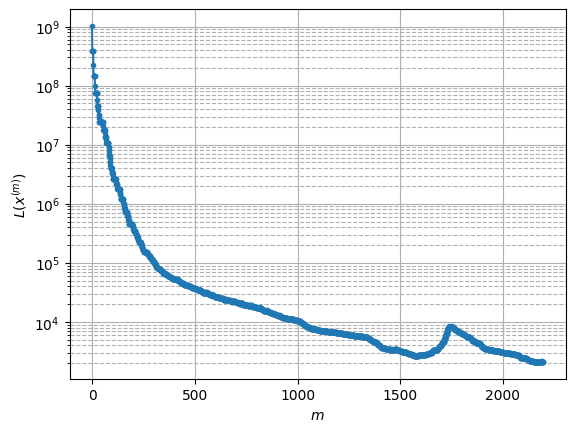

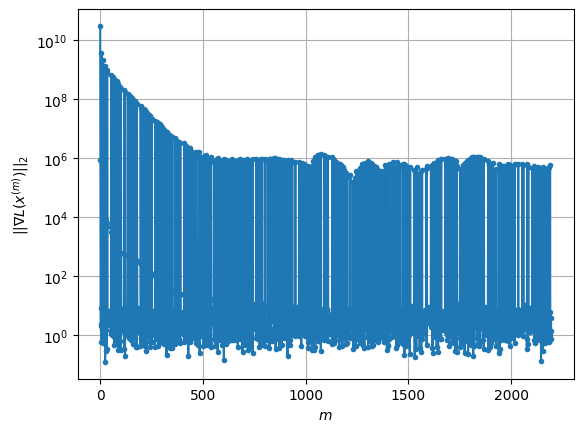

Windows:  67%|██████▋   | 197/296 [1:25:56<24:47, 15.02s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2116.50512472658
Gradient norm: 457486.5283961357
Deviation from touching point norm = 0.0
Global relative error: 61.374964662188454
Position relative errors: 0.05468394130230614 m, 44.08045154262009 m, 15.16572762634598 m, 39.922347672401855 m

Iteration 1
Cost function: 2100.3151000505895 (-0.76%)
Gradient norm: 1.8022565783305384 (-100.00%)
Deviation from touching point norm = 0.3592994171462664 (359299417146.27%)
Global relative error = 61.288655670717276 (-0.14%)
Position relative errors: 0.0468345361106173 m, 44.0404875718973 m, 15.027727056027878 m, 39.88603837123048 m

STOP on Iteration 2
Cost function = 2100.3150982702978 (-0.00%)
Gradient norm = 0.33800407925434606 (-81.25%)
Deviation from touching point norm = 0.3592994147482648 (-0.00%)
Global relative error = 61.288655675831656 (0.00%)
Final position relative errors: 0.04683453563671671 m, 44.04048757365674 m, 15.027727042111463 m, 39.88603

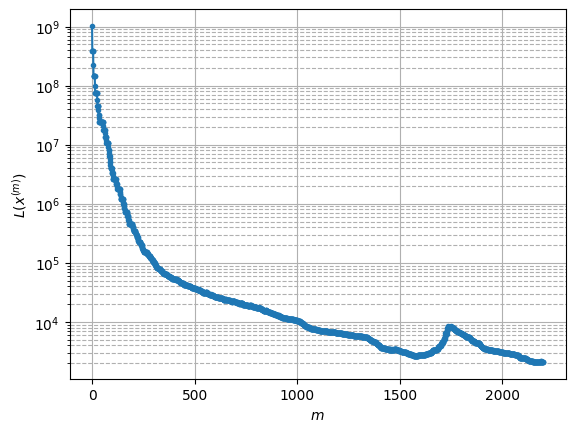

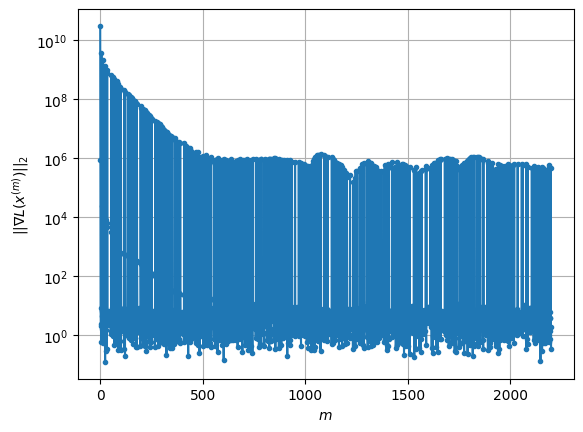

Windows:  67%|██████▋   | 198/296 [1:26:04<20:46, 12.72s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2101.468868888132
Gradient norm: 554067.1876165066
Deviation from touching point norm = 0.0
Global relative error: 57.54937635579936
Position relative errors: 0.04686192174282077 m, 41.74252654401328 m, 14.772904765346428 m, 36.75930913674899 m

Iteration 1
Cost function: 2083.3681663222537 (-0.86%)
Gradient norm: 1.2550248065341594 (-100.00%)
Deviation from touching point norm = 0.41188696567507993 (411886965675.08%)
Global relative error = 57.47120419036195 (-0.14%)
Position relative errors: 0.044387501320836145 m, 41.70337446432681 m, 14.6518315410187 m, 36.729896116024825 m

Iteration 2
Cost function: 2083.3681631296254 (-0.00%)
Gradient norm: 3.70784648478793 (195.44%)
Deviation from touching point norm = 0.41188696828605464 (0.00%)
Global relative error = 57.47120419586471 (0.00%)
Position relative errors: 0.04438750269406462 m, 41.70337446641879 m, 14.651831527095363 m, 36.72989612781218 m

Itera

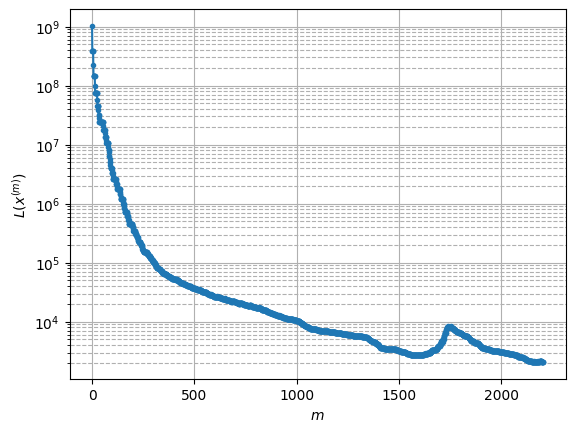

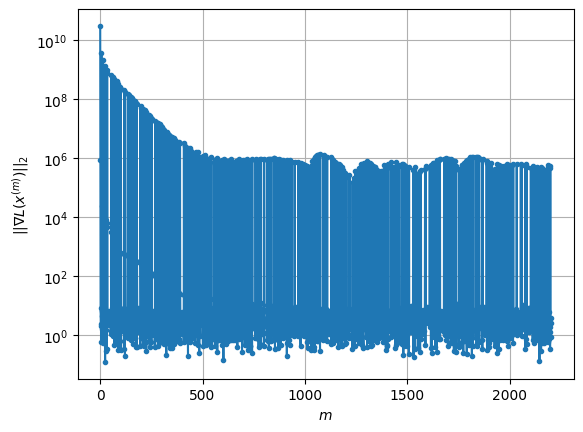

Windows:  67%|██████▋   | 199/296 [1:26:16<20:19, 12.57s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2086.960669235918
Gradient norm: 510261.1137870134
Deviation from touching point norm = 0.0
Global relative error: 53.50914180044668
Position relative errors: 0.04427061277814778 m, 39.22544149778872 m, 14.342838672080429 m, 33.44949951277713 m

Iteration 1
Cost function: 2069.132408529736 (-0.85%)
Gradient norm: 2.500766268278139 (-100.00%)
Deviation from touching point norm = 0.3948114656803967 (394811465680.40%)
Global relative error = 53.43849560150346 (-0.13%)
Position relative errors: 0.048418127166869926 m, 39.18838720712365 m, 14.237746735674571 m, 33.424876400576515 m

Iteration 2
Cost function: 2069.1324118755792 (0.00%)
Gradient norm: 2.1979982958284254 (-12.11%)
Deviation from touching point norm = 0.39481145502897375 (-0.00%)
Global relative error = 53.438495605783444 (0.00%)
Position relative errors: 0.04841812316094852 m, 39.188387209080794 m, 14.237746721949934 m, 33.42487641097655 m

It

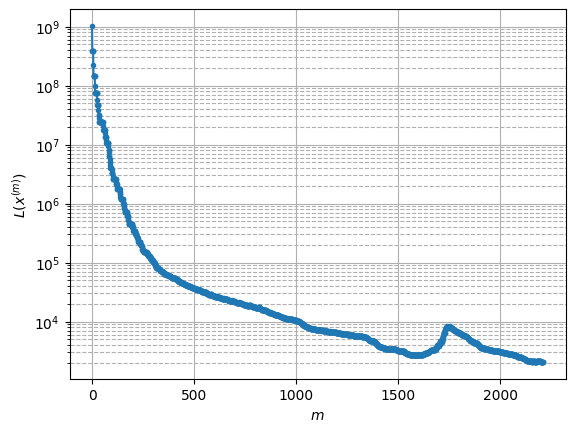

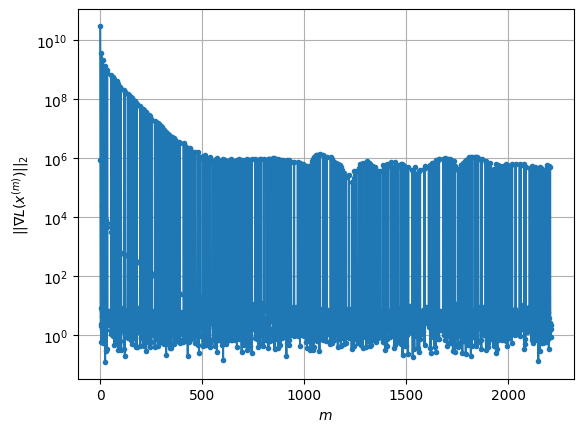

Windows:  68%|██████▊   | 200/296 [1:26:30<21:06, 13.19s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2035.6828941848414
Gradient norm: 430996.01674364036
Deviation from touching point norm = 0.0
Global relative error: 49.277017143621684
Position relative errors: 0.0480132436325752 m, 36.54181809276295 m, 13.876988991276287 m, 30.005688129954006 m

Iteration 1
Cost function: 2019.393319843629 (-0.80%)
Gradient norm: 3.159008360332736 (-100.00%)
Deviation from touching point norm = 0.38670408815078927 (386704088150.79%)
Global relative error = 49.21651287892485 (-0.12%)
Position relative errors: 0.057992195395536884 m, 36.50674988820782 m, 13.787181552397696 m, 29.990450657925248 m

STOP on Iteration 2
Cost function = 2019.3933196152566 (-0.00%)
Gradient norm = 0.793834180424435 (-74.87%)
Deviation from touching point norm = 0.3867040946908469 (0.00%)
Global relative error = 49.216512883498226 (0.00%)
Final position relative errors: 0.05799219999952695 m, 36.506749890662434 m, 13.78718153957203 m, 29.990

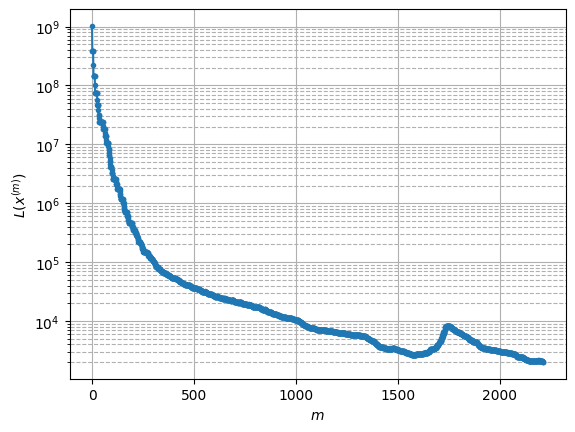

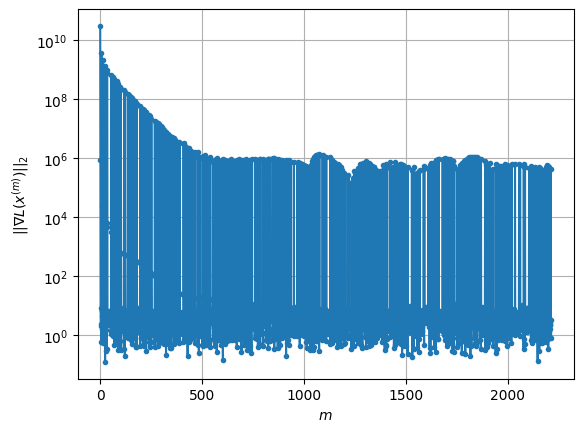

Windows:  68%|██████▊   | 201/296 [1:26:38<18:20, 11.59s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1985.8447198830136
Gradient norm: 433651.7112354183
Deviation from touching point norm = 0.0
Global relative error: 44.88225494035951
Position relative errors: 0.056989949568240085 m, 33.703587412774006 m, 13.377204865608347 m, 26.44855700950917 m

Iteration 1
Cost function: 1969.234423766434 (-0.84%)
Gradient norm: 4.857216600139953 (-100.00%)
Deviation from touching point norm = 0.4198114375017607 (419811437501.76%)
Global relative error = 44.83468969726993 (-0.11%)
Position relative errors: 0.06214209903563203 m, 33.66884055390271 m, 13.305635966368042 m, 26.448228765160167 m

Iteration 2
Cost function: 1969.2344217693358 (-0.00%)
Gradient norm: 2.507623777019264 (-48.37%)
Deviation from touching point norm = 0.41981144893795463 (0.00%)
Global relative error = 44.83468970136626 (0.00%)
Position relative errors: 0.06214209717294778 m, 33.66884055630939 m, 13.3056359534209 m, 26.448228775558338 m

STOP

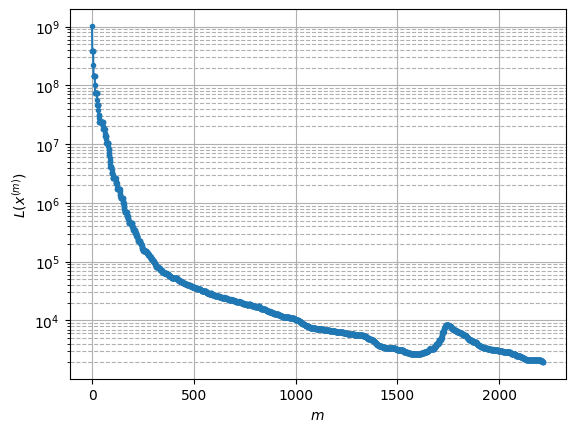

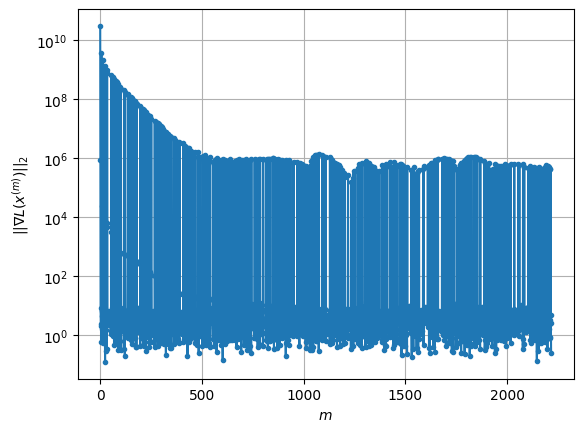

Windows:  68%|██████▊   | 202/296 [1:26:48<17:18, 11.04s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1940.764477907895
Gradient norm: 409930.8494710282
Deviation from touching point norm = 0.0
Global relative error: 40.35880531345059
Position relative errors: 0.06105381757308609 m, 30.721737361012554 m, 12.849062865320757 m, 22.80130374686451 m

Iteration 1
Cost function: 1924.1614477741373 (-0.86%)
Gradient norm: 1.4742446498990571 (-100.00%)
Deviation from touching point norm = 0.4199207626660354 (419920762666.04%)
Global relative error = 40.32407934450215 (-0.09%)
Position relative errors: 0.06163213179064269 m, 30.689313151269037 m, 12.791717975000855 m, 22.81576605310175 m

Iteration 2
Cost function: 1924.1614479524162 (0.00%)
Gradient norm: 1.0814605412705418 (-26.64%)
Deviation from touching point norm = 0.419920763703289 (0.00%)
Global relative error = 40.32407934825447 (0.00%)
Position relative errors: 0.06163212740885246 m, 30.689313154063388 m, 12.791717962714124 m, 22.81576606287527 m

Iter

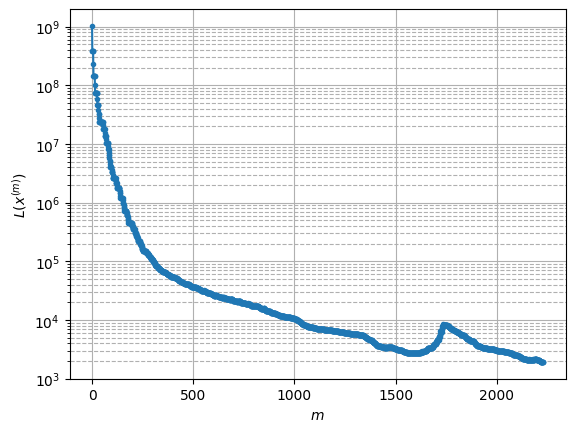

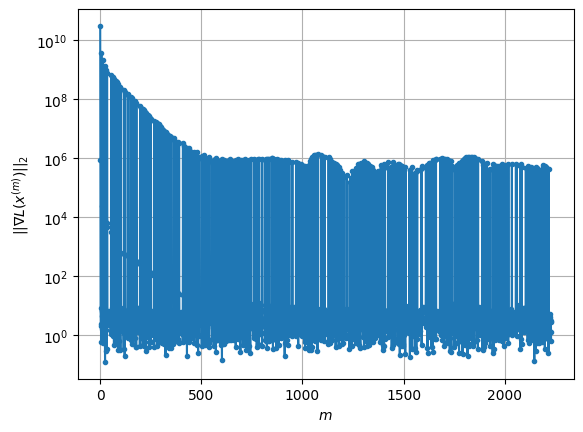

Windows:  69%|██████▊   | 203/296 [1:27:19<26:31, 17.12s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1915.5345554545547
Gradient norm: 436422.9632095146
Deviation from touching point norm = 0.0
Global relative error: 35.74466301618232
Position relative errors: 0.060300039971147815 m, 27.611517201558485 m, 12.291481956521745 m, 19.083869103776998 m

Iteration 1
Cost function: 1899.3428717605495 (-0.85%)
Gradient norm: 6.3159302425829615 (-100.00%)
Deviation from touching point norm = 0.398779328760571 (398779328760.57%)
Global relative error = 35.7207586124237 (-0.07%)
Position relative errors: 0.06332641026932036 m, 27.580226530952963 m, 12.2451987314174 m, 19.11407830417825 m

Iteration 2
Cost function: 1899.3428737956165 (0.00%)
Gradient norm: 2.5532858697367153 (-59.57%)
Deviation from touching point norm = 0.3987793234396892 (-0.00%)
Global relative error = 35.720758614168474 (0.00%)
Position relative errors: 0.06332641471123036 m, 27.580226533462334 m, 12.245198719288366 m, 19.11407831157366 m

ST

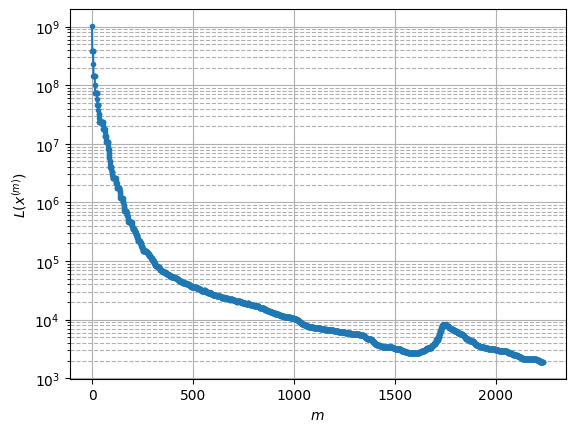

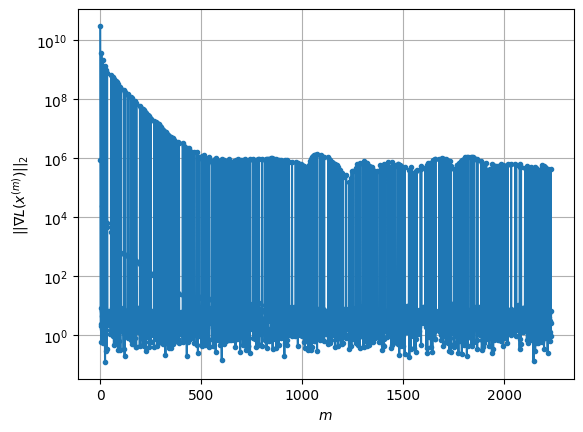

Windows:  69%|██████▉   | 204/296 [1:27:29<22:57, 14.98s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1857.255453566325
Gradient norm: 384017.89029891836
Deviation from touching point norm = 0.0
Global relative error: 31.087449276073997
Position relative errors: 0.061753989250304585 m, 24.38557790729947 m, 11.704369373827461 m, 15.3222006738249 m

Iteration 1
Cost function: 1841.3863753215371 (-0.85%)
Gradient norm: 6.66852961248058 (-100.00%)
Deviation from touching point norm = 0.4125122344622005 (412512234462.20%)
Global relative error = 31.082700035318915 (-0.02%)
Position relative errors: 0.06928777512821319 m, 24.358360449135546 m, 11.669453689923849 m, 15.382340621687348 m

Iteration 2
Cost function: 1841.3863727903474 (-0.00%)
Gradient norm: 8.05135235627223 (20.74%)
Deviation from touching point norm = 0.41251223426489736 (-0.00%)
Global relative error = 31.082700037726266 (0.00%)
Position relative errors: 0.0692877780771567 m, 24.35836045196151 m, 11.669453681185479 m, 15.382340628692676 m

It

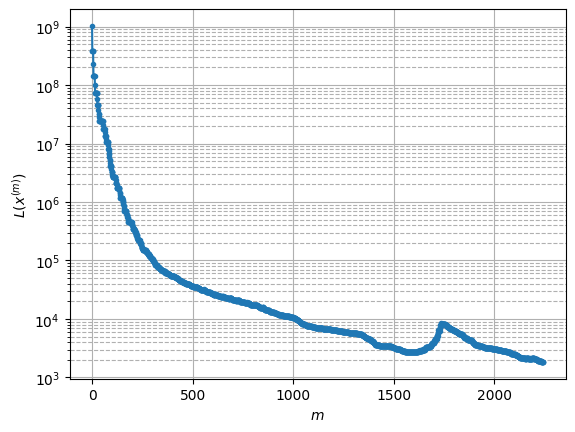

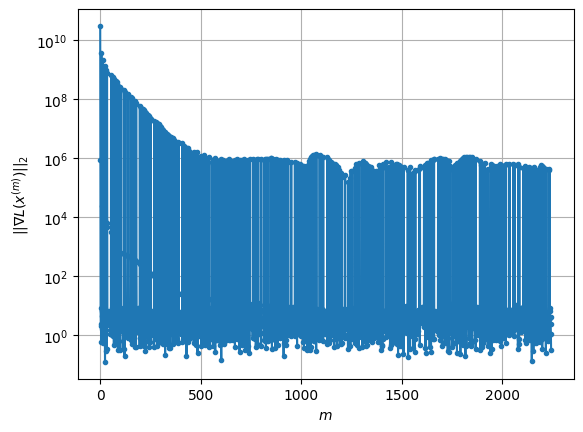

Windows:  69%|██████▉   | 205/296 [1:27:51<25:42, 16.96s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1813.1303909292585
Gradient norm: 415664.32892982056
Deviation from touching point norm = 0.0
Global relative error: 26.46684339760426
Position relative errors: 0.0673785681941179 m, 21.061234407650737 m, 11.091116455016543 m, 11.571227904926758 m

Iteration 1
Cost function: 1797.8578156998108 (-0.84%)
Gradient norm: 1.6559197707830153 (-100.00%)
Deviation from touching point norm = 0.4033989181751792 (403398918175.18%)
Global relative error = 26.47991948092999 (0.05%)
Position relative errors: 0.07303703665676821 m, 21.03923880461785 m, 11.070963836232677 m, 11.660082549566276 m

Iteration 2
Cost function: 1797.857817432551 (0.00%)
Gradient norm: 2.588219857067001 (56.30%)
Deviation from touching point norm = 0.40339890884221463 (-0.00%)
Global relative error = 26.479919480743817 (-0.00%)
Position relative errors: 0.0730370343608401 m, 21.039238807171863 m, 11.070963827172928 m, 11.660082553151423 m

I

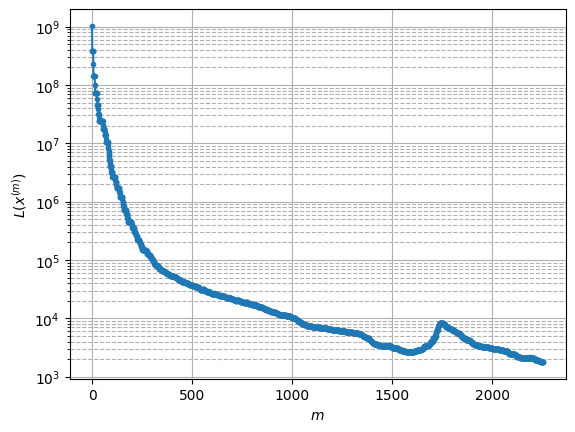

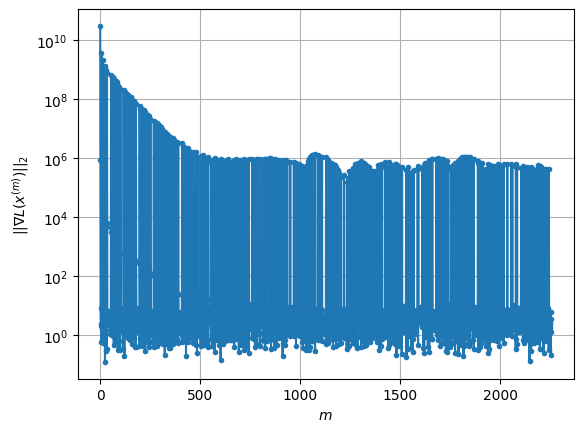

Windows:  70%|██████▉   | 206/296 [1:28:19<30:31, 20.35s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1755.389688789218
Gradient norm: 321059.3368182807
Deviation from touching point norm = 0.0
Global relative error: 21.994986349046542
Position relative errors: 0.0705443726326106 m, 17.654785652361607 m, 10.45838913352741 m, 7.918166436432325 m

Iteration 1
Cost function: 1740.1143432947115 (-0.87%)
Gradient norm: 2.216692033493227 (-100.00%)
Deviation from touching point norm = 0.4183739480420855 (418373948042.09%)
Global relative error = 22.034040269371 (0.18%)
Position relative errors: 0.08930341532214972 m, 17.638907311707246 m, 10.45330402844488 m, 8.067256613505341 m

Iteration 2
Cost function: 1740.1143432069964 (-0.00%)
Gradient norm: 1.3778619488194985 (-37.84%)
Deviation from touching point norm = 0.4183739476631668 (-0.00%)
Global relative error = 22.034040269541105 (0.00%)
Position relative errors: 0.08930340750134244 m, 17.638907314593745 m, 10.453304020801673 m, 8.067256617649022 m

Iterat

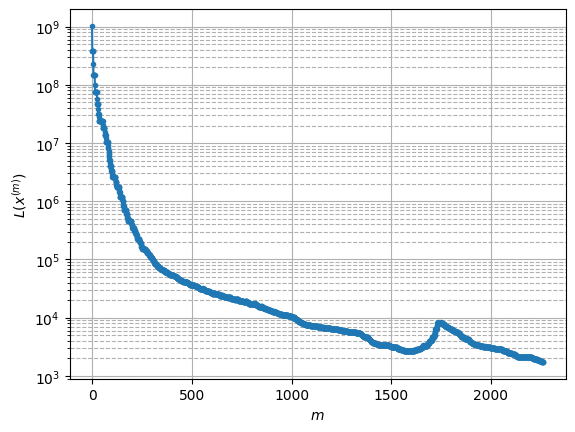

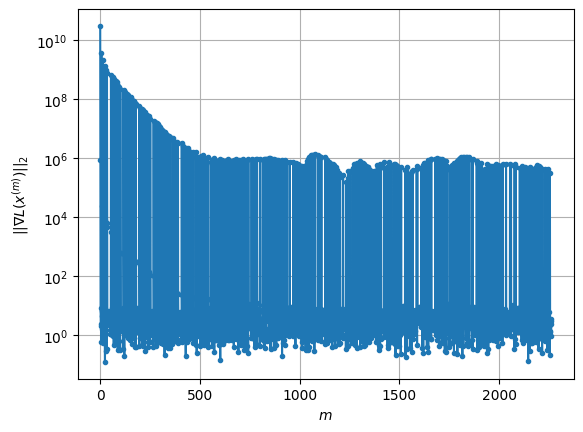

Windows:  70%|██████▉   | 207/296 [1:28:36<28:36, 19.28s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1732.1686940697812
Gradient norm: 632428.0984849486
Deviation from touching point norm = 0.0
Global relative error: 17.88231667558647
Position relative errors: 0.08628291636720098 m, 14.183298995181586 m, 9.809927691154686 m, 4.7287677211509624 m

Iteration 1
Cost function: 1717.6397739607257 (-0.84%)
Gradient norm: 5.069103652644132 (-100.00%)
Deviation from touching point norm = 0.3825063756792623 (382506375679.26%)
Global relative error = 17.941103268611624 (0.33%)
Position relative errors: 0.08313555035518033 m, 14.1734780632735 m, 9.816862342787031 m, 4.960858594452547 m

Iteration 2
Cost function: 1717.6397747618882 (0.00%)
Gradient norm: 2.2613256597963316 (-55.39%)
Deviation from touching point norm = 0.38250637828696804 (0.00%)
Global relative error = 17.94110326835764 (-0.00%)
Position relative errors: 0.0831355408585938 m, 14.173478065972782 m, 9.816862334811558 m, 4.960858601763414 m

Iterat

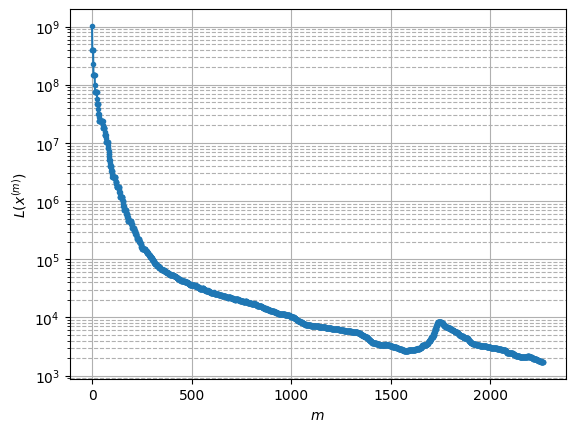

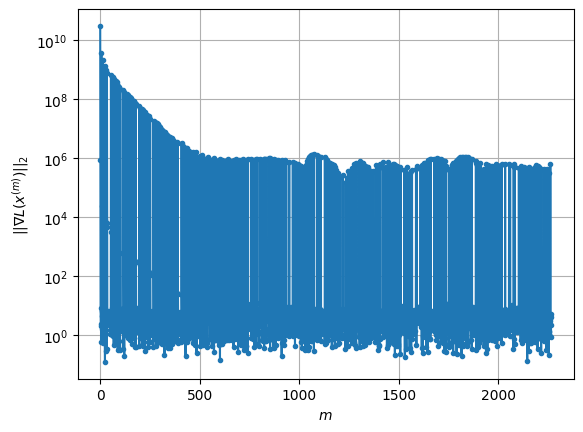

Windows:  70%|███████   | 208/296 [1:28:48<25:02, 17.07s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1694.8174958483073
Gradient norm: 479810.61392812786
Deviation from touching point norm = 0.0
Global relative error: 14.50552188856696
Position relative errors: 0.08053860783430103 m, 10.664992637964481 m, 9.146661295617193 m, 3.6044659049850365 m

Iteration 1
Cost function: 1681.4561743585712 (-0.79%)
Gradient norm: 1.0055859911771408 (-100.00%)
Deviation from touching point norm = 0.3657553099897733 (365755309989.77%)
Global relative error = 14.588790947729112 (0.57%)
Position relative errors: 0.07554231163601005 m, 10.665976848567013 m, 9.163490912667992 m, 3.8841320629558216 m

Iteration 2
Cost function: 1681.456173017875 (-0.00%)
Gradient norm: 3.2662781316289804 (224.81%)
Deviation from touching point norm = 0.36575531508389497 (0.00%)
Global relative error = 14.588790948165038 (0.00%)
Position relative errors: 0.0755423055816927 m, 10.665976851060325 m, 9.16349090758896 m, 3.88413206984657 m

STO

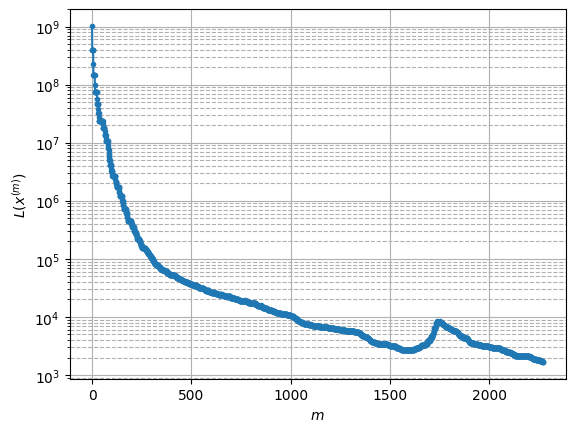

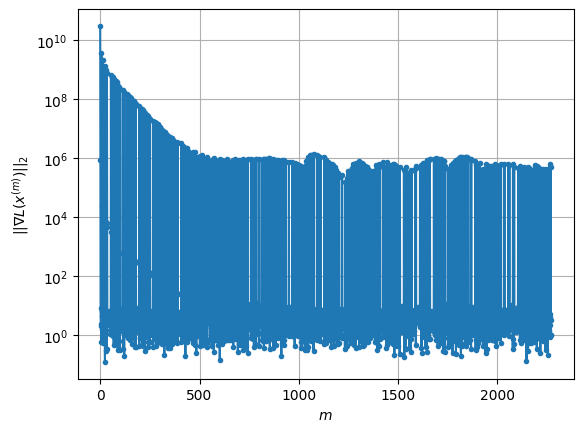

Windows:  71%|███████   | 209/296 [1:28:58<21:39, 14.94s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1667.767207013187
Gradient norm: 321026.07027642167
Deviation from touching point norm = 0.0
Global relative error: 12.538473268062175
Position relative errors: 0.07325324693539768 m, 7.131059479476853 m, 8.470374895967232 m, 5.882228774238299 m

STOP on Iteration 1
Cost function = 1655.5025847895556 (-0.74%)
Gradient norm = 0.9718998702282715 (-100.00%)
Deviation from touching point norm = 0.3354888685081419 (335488868508.14%)
Global relative error = 12.628895878552944 (0.72%)
Final position relative errors: 0.08352838624891126 m, 7.156141819092307 m, 8.493412121749309 m, 6.010454815113898 m

Majorization-Minimization converged after 1 iterations


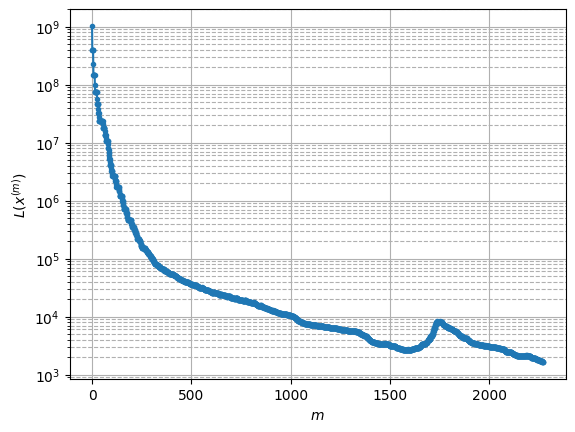

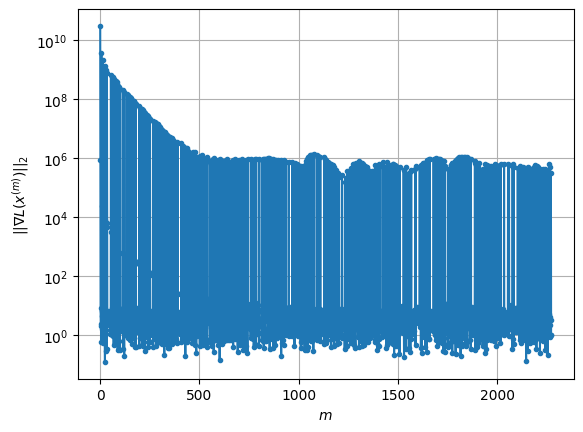

Windows:  71%|███████   | 210/296 [1:29:03<17:13, 12.02s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1661.454084754687
Gradient norm: 408946.14930344786
Deviation from touching point norm = 0.0
Global relative error: 12.664212093276646
Position relative errors: 0.08082575422813844 m, 3.674887426549292 m, 7.781890197725873 m, 9.290052411697937 m

STOP on Iteration 1
Cost function = 1650.6267421567736 (-0.65%)
Gradient norm = 0.9355745657649155 (-100.00%)
Deviation from touching point norm = 0.2762335790634192 (276233579063.42%)
Global relative error = 12.727983417939395 (0.50%)
Final position relative errors: 0.08150080192018909 m, 3.742458190568338 m, 7.810710858804957 m, 9.325968688900314 m

Majorization-Minimization converged after 1 iterations


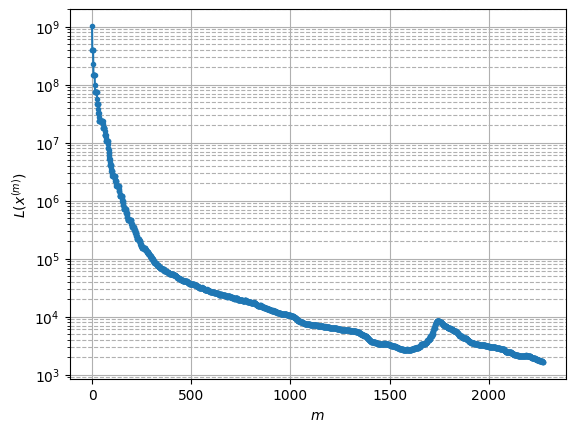

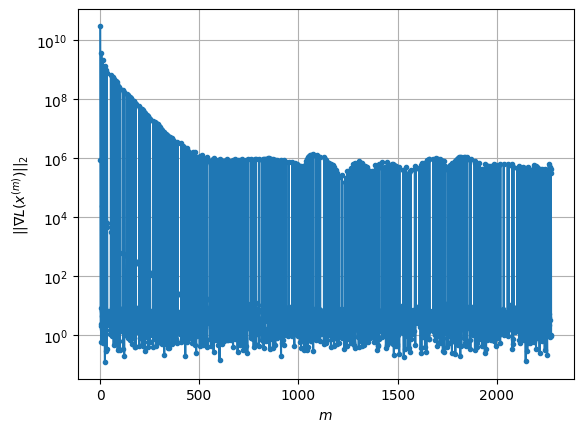

Windows:  71%|███████▏  | 211/296 [1:29:08<14:14, 10.06s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1653.405828153862
Gradient norm: 290740.8257220391
Deviation from touching point norm = 0.0
Global relative error: 14.802513185780342
Position relative errors: 0.07897939691308192 m, 1.4341792451888022 m, 7.085494282078989 m, 12.916621099895414 m

Iteration 1
Cost function: 1643.7156888060797 (-0.59%)
Gradient norm: 4.716428253297755 (-100.00%)
Deviation from touching point norm = 0.25100335446771227 (251003354467.71%)
Global relative error = 14.841276081334739 (0.26%)
Position relative errors: 0.08173964008643382 m, 1.626163190347046 m, 7.128391170173328 m, 12.914739108676198 m

Iteration 2
Cost function: 1643.715689483763 (0.00%)
Gradient norm: 5.130783606049978 (8.79%)
Deviation from touching point norm = 0.25100334524513324 (-0.00%)
Global relative error = 14.84127607719555 (-0.00%)
Position relative errors: 0.08173963369664608 m, 1.6261631815319044 m, 7.12839116879242 m, 12.914739105832131 m

STOP 

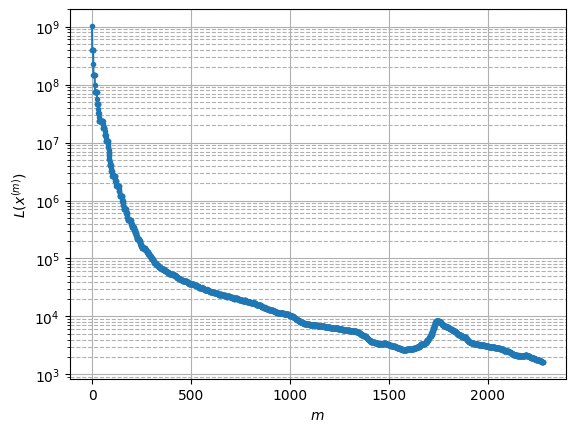

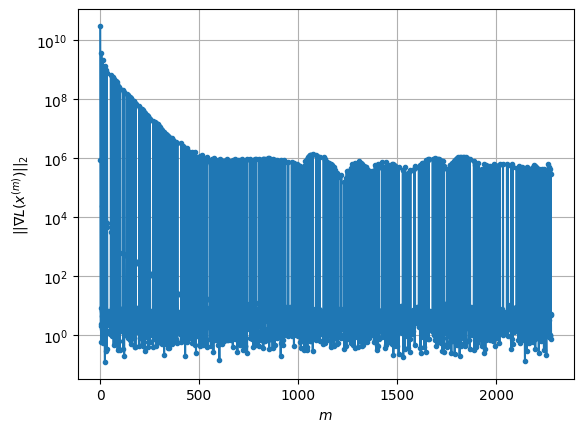

Windows:  72%|███████▏  | 212/296 [1:29:18<13:58,  9.98s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1657.9685554029136
Gradient norm: 357233.4480116736
Deviation from touching point norm = 0.0
Global relative error: 18.229463864124853
Position relative errors: 0.07917591683190722 m, 4.068902067820078 m, 6.395240814402938 m, 16.578426093542372 m

Iteration 1
Cost function: 1648.3028117301794 (-0.58%)
Gradient norm: 1.4751832728725638 (-100.00%)
Deviation from touching point norm = 0.22409929058270472 (224099290582.70%)
Global relative error = 18.238878813900637 (0.05%)
Position relative errors: 0.08535226169128683 m, 4.142042180604377 m, 6.436703167356616 m, 16.55457547291332 m

STOP on Iteration 2
Cost function = 1648.302811416845 (-0.00%)
Gradient norm = 0.37906582655507853 (-74.30%)
Deviation from touching point norm = 0.22409928852011152 (-0.00%)
Global relative error = 18.23887881299661 (-0.00%)
Final position relative errors: 0.0853522661760707 m, 4.142042177641591 m, 6.436703167955948 m, 16.5545

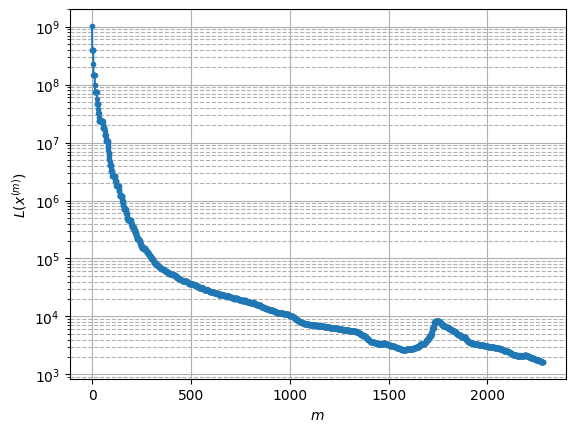

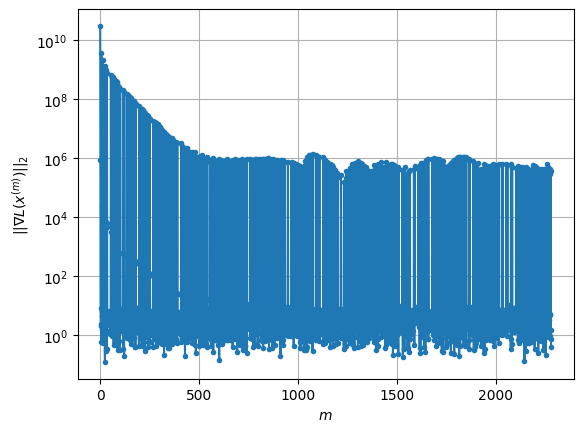

Windows:  72%|███████▏  | 213/296 [1:29:26<12:49,  9.27s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1665.9727581017435
Gradient norm: 421536.7409388362
Deviation from touching point norm = 0.0
Global relative error: 22.303153344677394
Position relative errors: 0.08259983681011729 m, 7.522024725231191 m, 5.702316935091915 m, 20.206903970298484 m

Iteration 1
Cost function: 1655.9689354993993 (-0.60%)
Gradient norm: 4.689052656656153 (-100.00%)
Deviation from touching point norm = 0.22816921879148455 (228169218791.48%)
Global relative error = 22.292020430175846 (-0.05%)
Position relative errors: 0.08218472125243592 m, 7.563123665914656 m, 5.760079225169235 m, 20.16284954295308 m

Iteration 2
Cost function: 1655.9689335550497 (-0.00%)
Gradient norm: 6.240389315177401 (33.08%)
Deviation from touching point norm = 0.22816920826320553 (-0.00%)
Global relative error = 22.29202042706495 (-0.00%)
Position relative errors: 0.0821847145506004 m, 7.563123662690511 m, 5.760079221965897 m, 20.162849541665487 m

STO

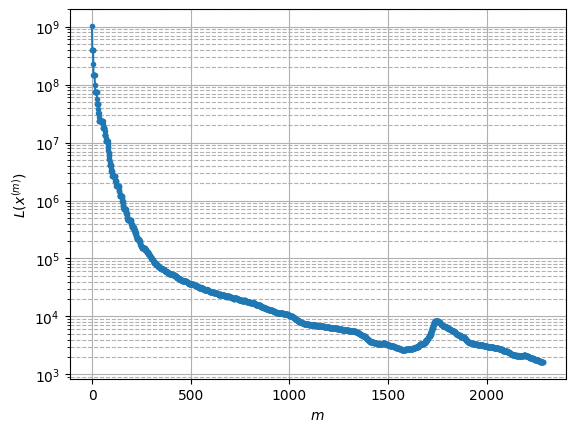

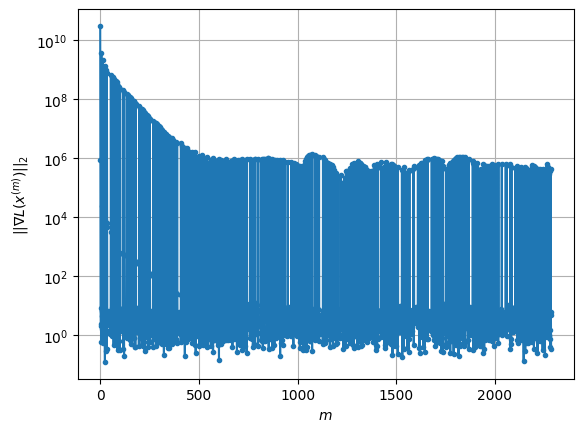

Windows:  72%|███████▏  | 214/296 [1:29:36<13:05,  9.58s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1667.7762140389063
Gradient norm: 376662.2854981088
Deviation from touching point norm = 0.0
Global relative error: 26.670578427165903
Position relative errors: 0.0795757151687646 m, 11.015925169824259 m, 5.034453482476448 m, 23.761519031371616 m

STOP on Iteration 1
Cost function = 1658.3747033630793 (-0.56%)
Gradient norm = 0.9105164388972378 (-100.00%)
Deviation from touching point norm = 0.21794207162649434 (217942071626.49%)
Global relative error = 26.64196354629074 (-0.11%)
Final position relative errors: 0.07543970815727821 m, 11.039586932703385 m, 5.090978654807841 m, 23.70634300075193 m

Majorization-Minimization converged after 1 iterations


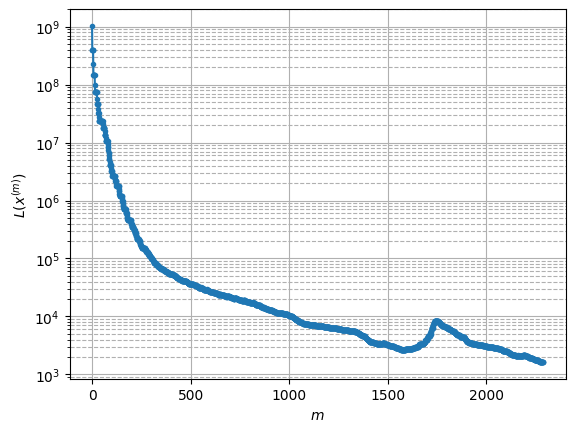

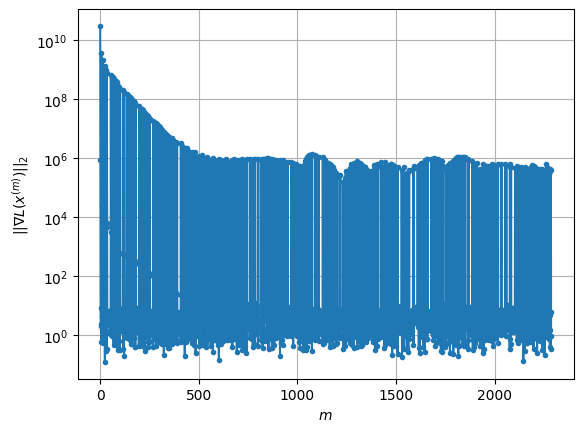

Windows:  73%|███████▎  | 215/296 [1:29:41<11:09,  8.27s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1679.3027320630047
Gradient norm: 494007.1216964455
Deviation from touching point norm = 0.0
Global relative error: 31.142463933206713
Position relative errors: 0.07318028685253469 m, 14.475493042205724 m, 4.385950909954352 m, 27.222495619789328 m

Iteration 1
Cost function: 1670.5891485297184 (-0.52%)
Gradient norm: 1.4121651679879723 (-100.00%)
Deviation from touching point norm = 0.1790392881646319 (179039288164.63%)
Global relative error = 31.09935117602777 (-0.14%)
Position relative errors: 0.06796082936101557 m, 14.482438285379216 m, 4.446216362180446 m, 27.159679856449966 m

Iteration 2
Cost function: 1670.5891480564865 (-0.00%)
Gradient norm: 3.581933817946879 (153.65%)
Deviation from touching point norm = 0.1790392880334516 (-0.00%)
Global relative error = 31.099351175413968 (-0.00%)
Position relative errors: 0.06796082355673655 m, 14.482438284419679 m, 4.446216361622261 m, 27.159679856364676 m

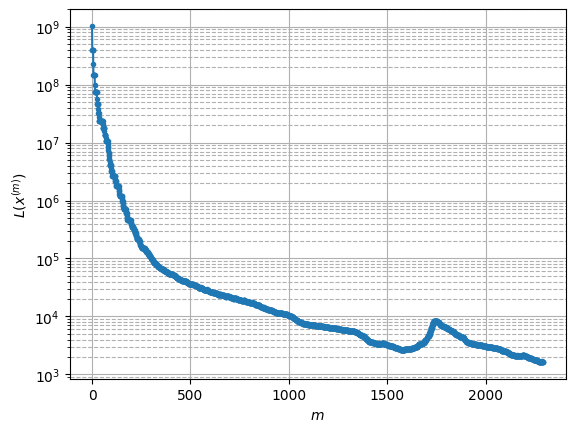

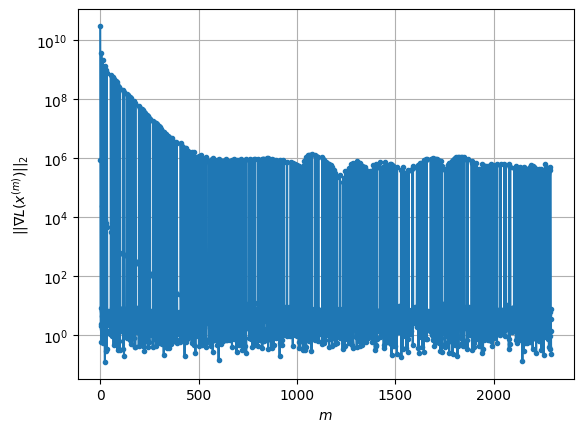

Windows:  73%|███████▎  | 216/296 [1:29:54<12:40,  9.50s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1707.6727265674153
Gradient norm: 433035.3514413524
Deviation from touching point norm = 0.0
Global relative error: 35.611738535656016
Position relative errors: 0.06624711964884006 m, 17.870104274312748 m, 3.779715474239184 m, 30.570542457527925 m

Iteration 1
Cost function: 1698.0020505686682 (-0.57%)
Gradient norm: 2.012160540209799 (-100.00%)
Deviation from touching point norm = 0.1907380418770431 (190738041877.04%)
Global relative error = 35.55153965385453 (-0.17%)
Position relative errors: 0.061264235876742255 m, 17.86734249539481 m, 3.8108313317470413 m, 30.498152079048747 m

STOP on Iteration 2
Cost function = 1698.0020502566767 (-0.00%)
Gradient norm = 0.9616334274887519 (-52.21%)
Deviation from touching point norm = 0.19073804332925118 (0.00%)
Global relative error = 35.55153965553516 (0.00%)
Final position relative errors: 0.06126423417224055 m, 17.867342495552514 m, 3.8108313338804733 m, 30.4

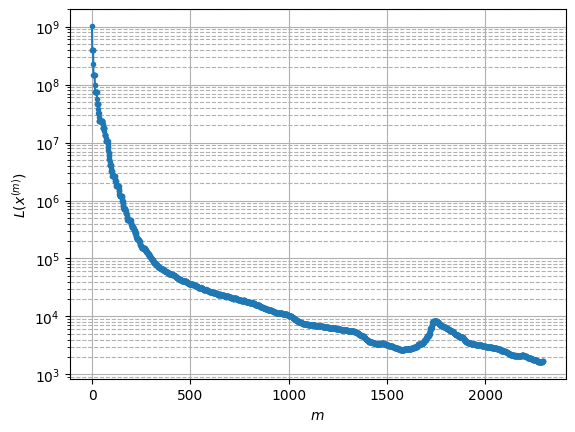

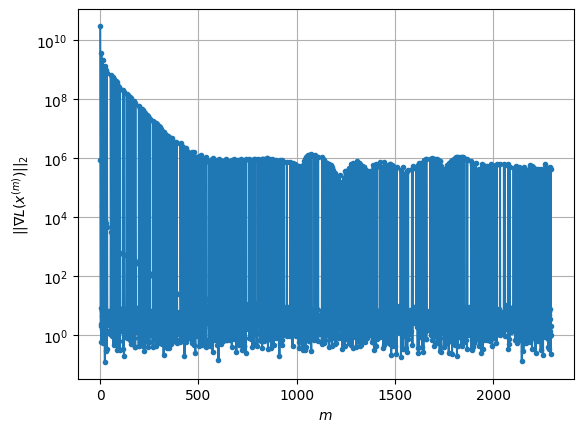

Windows:  73%|███████▎  | 217/296 [1:30:02<11:48,  8.97s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1717.5050557723182
Gradient norm: 422187.5388509072
Deviation from touching point norm = 0.0
Global relative error: 40.00681325484695
Position relative errors: 0.05972808789015007 m, 21.185049594959317 m, 3.2069704017372596 m, 33.78526879001619 m

Iteration 1
Cost function: 1707.7111052519058 (-0.57%)
Gradient norm: 1.1760666101585047 (-100.00%)
Deviation from touching point norm = 0.2268159064477735 (226815906447.77%)
Global relative error = 39.9403143176736 (-0.17%)
Position relative errors: 0.05984428966351922 m, 21.177656393116173 m, 3.2334332280302434 m, 33.708615428107244 m

STOP on Iteration 2
Cost function = 1707.7111064470462 (0.00%)
Gradient norm = 0.9861978083394345 (-16.14%)
Deviation from touching point norm = 0.22681591008942104 (0.00%)
Global relative error = 39.94031432023193 (0.00%)
Final position relative errors: 0.059844287595421174 m, 21.17765639312501 m, 3.233433230399058 m, 33.7086

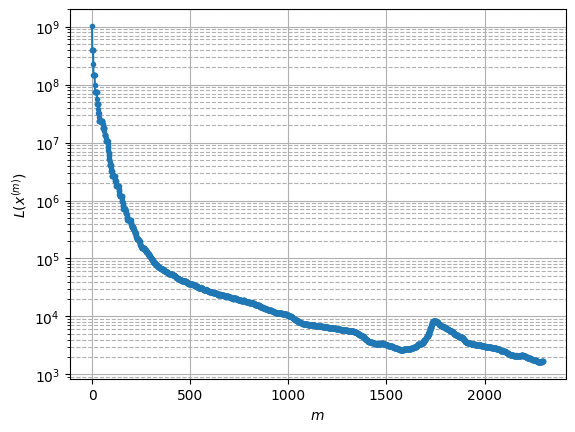

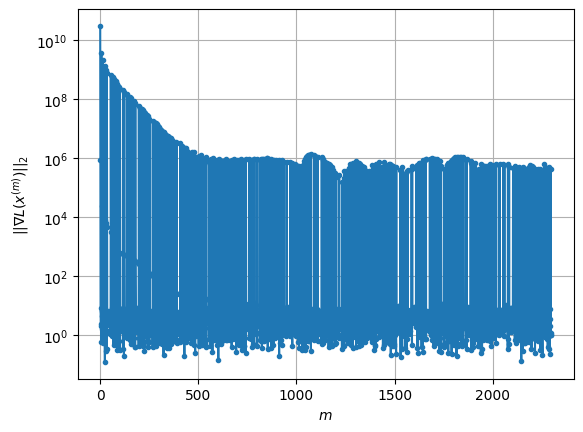

Windows:  74%|███████▎  | 218/296 [1:30:09<11:10,  8.60s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1727.6262250802781
Gradient norm: 419672.84277082165
Deviation from touching point norm = 0.0
Global relative error: 44.28857539193985
Position relative errors: 0.05859014601198087 m, 24.407047650799488 m, 2.733815289202773 m, 36.85500031998887 m

Iteration 1
Cost function: 1718.5402564510537 (-0.53%)
Gradient norm: 2.093213455569053 (-100.00%)
Deviation from touching point norm = 0.22344240827090803 (223442408270.91%)
Global relative error = 44.21608645834895 (-0.16%)
Position relative errors: 0.05628605122574778 m, 24.392306658417706 m, 2.731723273919282 m, 36.77779906051042 m

STOP on Iteration 2
Cost function = 1718.5402563854425 (-0.00%)
Gradient norm = 0.38514560021368194 (-81.60%)
Deviation from touching point norm = 0.22344240477785698 (-0.00%)
Global relative error = 44.21608646138132 (0.00%)
Final position relative errors: 0.0562860601113218 m, 24.39230665806723 m, 2.7317232775343694 m, 36.777

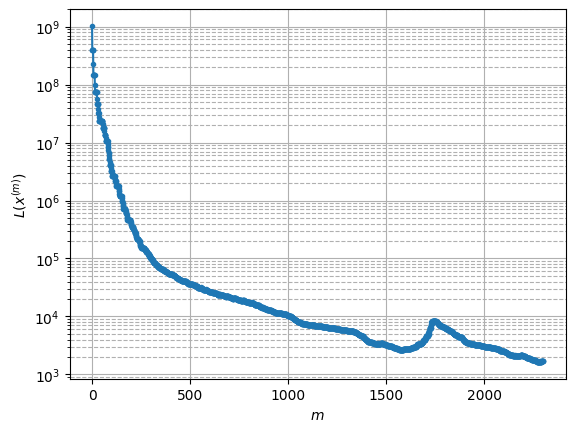

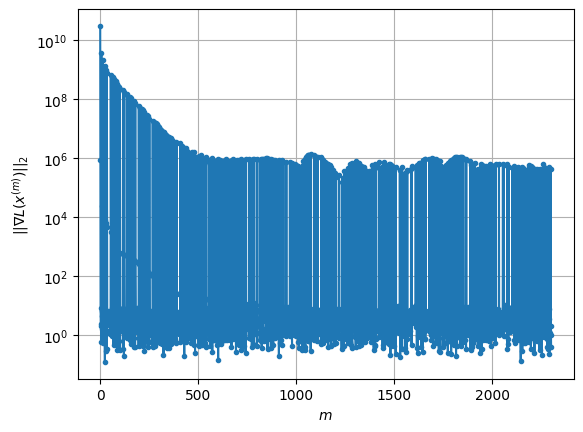

Windows:  74%|███████▍  | 219/296 [1:30:17<10:43,  8.36s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1735.3521684560756
Gradient norm: 412476.17082604516
Deviation from touching point norm = 0.0
Global relative error: 48.41965510890035
Position relative errors: 0.05492844335890688 m, 27.518173433099488 m, 2.3949004501987528 m, 39.7676922187894 m

Iteration 1
Cost function: 1725.8495762049756 (-0.55%)
Gradient norm: 2.665173411313774 (-100.00%)
Deviation from touching point norm = 0.25198538715751245 (251985387157.51%)
Global relative error = 48.34258135258886 (-0.16%)
Position relative errors: 0.055689446650031456 m, 27.49955027435457 m, 2.3610997002132694 m, 39.68874909180446 m

Iteration 2
Cost function: 1725.8495742993268 (-0.00%)
Gradient norm: 1.3568092414355715 (-49.09%)
Deviation from touching point norm = 0.2519853911515468 (0.00%)
Global relative error = 48.3425813562595 (0.00%)
Position relative errors: 0.05568943882266939 m, 27.499550274754416 m, 2.3610996958438015 m, 39.688749096269326 m

I

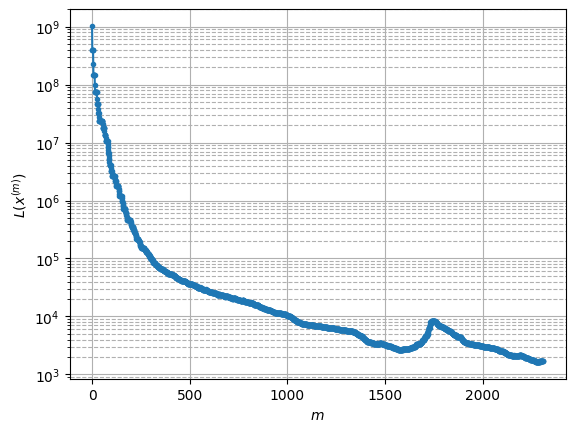

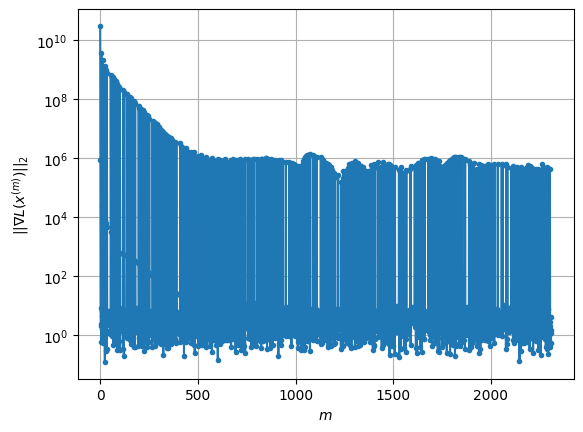

Windows:  74%|███████▍  | 220/296 [1:30:34<13:47, 10.89s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1728.764778352156
Gradient norm: 418024.7195786665
Deviation from touching point norm = 0.0
Global relative error: 52.37095954907153
Position relative errors: 0.05440606786854532 m, 30.507178773836497 m, 2.254997679728815 m, 42.508078702609005 m

Iteration 1
Cost function: 1718.6989364356962 (-0.58%)
Gradient norm: 1.1070487930745911 (-100.00%)
Deviation from touching point norm = 0.28218229548928425 (282182295489.28%)
Global relative error = 52.29199543427626 (-0.15%)
Position relative errors: 0.05000698158762391 m, 30.486946428941057 m, 2.184580947581841 m, 42.428991070724074 m

Iteration 2
Cost function: 1718.6989372038117 (0.00%)
Gradient norm: 3.8216996134826866 (245.22%)
Deviation from touching point norm = 0.28218229641127274 (0.00%)
Global relative error = 52.291995438159155 (0.00%)
Position relative errors: 0.05000698058854872 m, 30.486946429624936 m, 2.184580950598236 m, 42.42899107486406 m

I

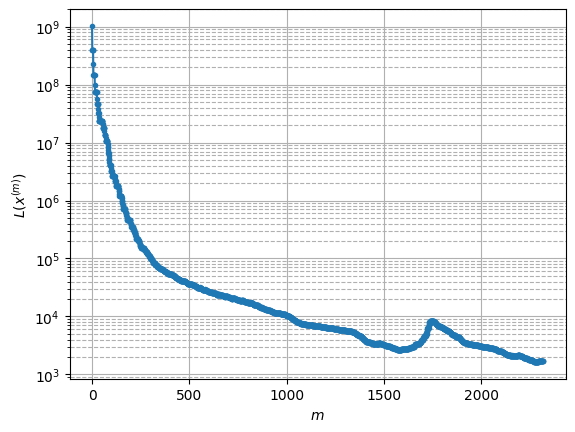

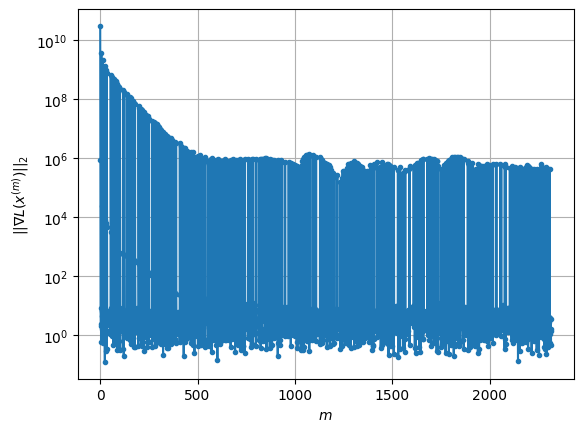

Windows:  75%|███████▍  | 221/296 [1:30:53<16:53, 13.51s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1719.5015486099421
Gradient norm: 379051.56156447274
Deviation from touching point norm = 0.0
Global relative error: 56.11916064292646
Position relative errors: 0.049101705712988816 m, 33.3622728521327 m, 2.342271087598135 m, 45.064687868582624 m

Iteration 1
Cost function: 1709.27038587438 (-0.60%)
Gradient norm: 5.287876546921163 (-100.00%)
Deviation from touching point norm = 0.31644664824998375 (316446648249.98%)
Global relative error = 56.03577606355805 (-0.15%)
Position relative errors: 0.03820058232977556 m, 33.33603132436905 m, 2.219155744484728 m, 44.986519204572126 m

Iteration 2
Cost function: 1709.2703855991501 (-0.00%)
Gradient norm: 7.674393306414263 (45.13%)
Deviation from touching point norm = 0.3164466481723391 (-0.00%)
Global relative error = 56.035776067868696 (0.00%)
Position relative errors: 0.03820057560034518 m, 33.336031324263864 m, 2.2191557420470387 m, 44.98651921014543 m

Iter

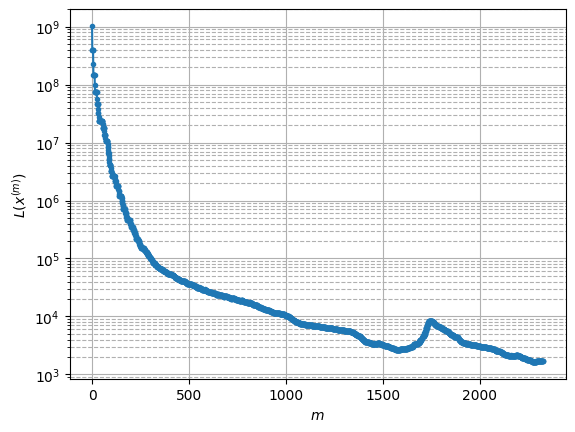

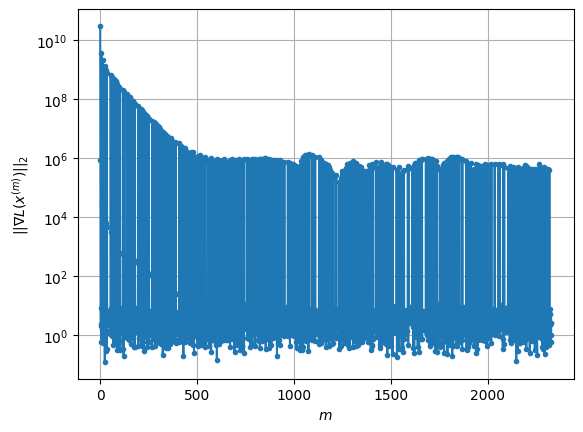

Windows:  75%|███████▌  | 222/296 [1:31:17<20:28, 16.60s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1705.3215261378446
Gradient norm: 436794.4596355984
Deviation from touching point norm = 0.0
Global relative error: 59.63981788715084
Position relative errors: 0.03808377112914341 m, 36.06674917224731 m, 2.606012774279947 m, 47.426796648420805 m

Iteration 1
Cost function: 1695.043308410698 (-0.60%)
Gradient norm: 1.2150388834318842 (-100.00%)
Deviation from touching point norm = 0.32309470651195876 (323094706511.96%)
Global relative error = 59.554518427486315 (-0.14%)
Position relative errors: 0.03883331706355796 m, 36.03586019179775 m, 2.4726689611758683 m, 47.35016543739846 m

STOP on Iteration 2
Cost function = 1695.043307393808 (-0.00%)
Gradient norm = 0.3804697878256238 (-68.69%)
Deviation from touching point norm = 0.32309470636947335 (-0.00%)
Global relative error = 59.554518431879 (0.00%)
Final position relative errors: 0.038833316409783734 m, 36.03586019195173 m, 2.472668955117897 m, 47.350165

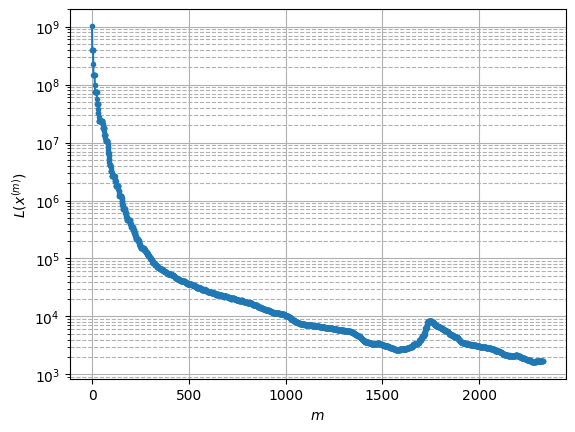

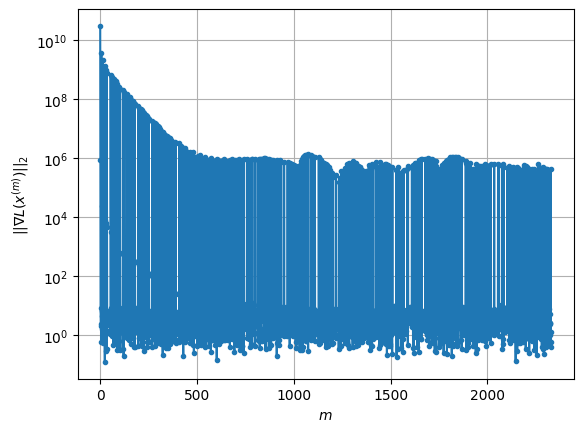

Windows:  75%|███████▌  | 223/296 [1:31:25<17:04, 14.03s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1669.735461314498
Gradient norm: 358801.2561878832
Deviation from touching point norm = 0.0
Global relative error: 62.91595493096963
Position relative errors: 0.038756434774056776 m, 38.61028755297059 m, 3.0124841955960746 m, 49.58410366576508 m

Iteration 1
Cost function: 1659.2526747831532 (-0.63%)
Gradient norm: 1.4771649204021382 (-100.00%)
Deviation from touching point norm = 0.3663175411277162 (366317541127.72%)
Global relative error = 62.83081948929269 (-0.14%)
Position relative errors: 0.03955064321942106 m, 38.57768816509058 m, 2.858896605138835 m, 49.51056278916216 m

Iteration 2
Cost function: 1659.2526747265508 (-0.00%)
Gradient norm: 2.819232439697292 (90.85%)
Deviation from touching point norm = 0.3663175447037542 (0.00%)
Global relative error = 62.830819494167734 (0.00%)
Position relative errors: 0.03955064233560082 m, 38.577688165722414 m, 2.8588965998335474 m, 49.51056279516351 m

Itera

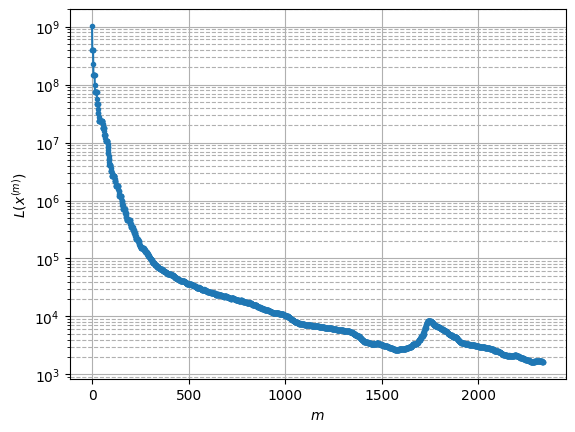

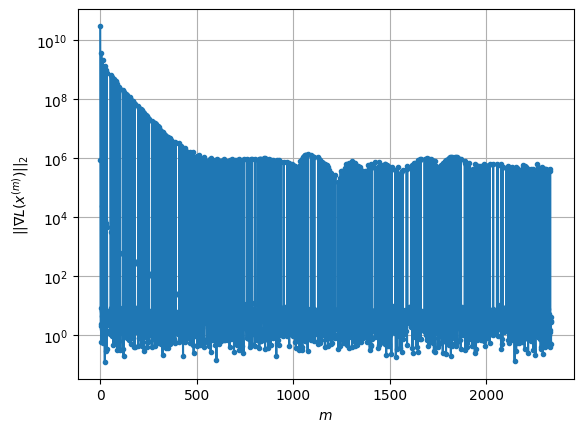

Windows:  76%|███████▌  | 224/296 [1:31:40<17:07, 14.27s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1644.4991750536194
Gradient norm: 345955.5229895735
Deviation from touching point norm = 0.0
Global relative error: 65.93216513031132
Position relative errors: 0.03930363805949278 m, 40.98444351359644 m, 3.4859781051521823 m, 51.528336979466985 m

STOP on Iteration 1
Cost function = 1634.589185629333 (-0.60%)
Gradient norm = 0.9331693300939047 (-100.00%)
Deviation from touching point norm = 0.3547856127129051 (354785612712.91%)
Global relative error = 65.84782595670093 (-0.13%)
Final position relative errors: 0.03686265386808785 m, 40.94930348168775 m, 3.337302718296998 m, 51.45822672877198 m

Majorization-Minimization converged after 1 iterations


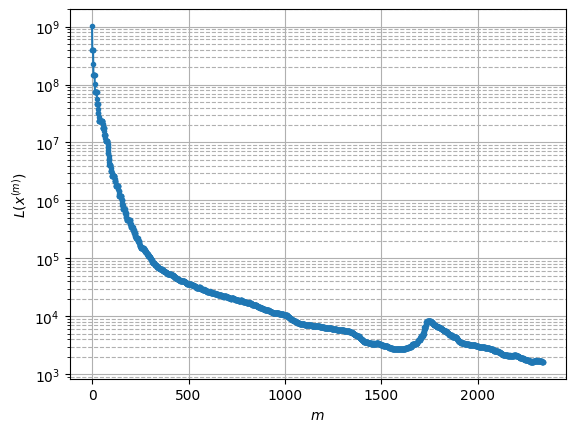

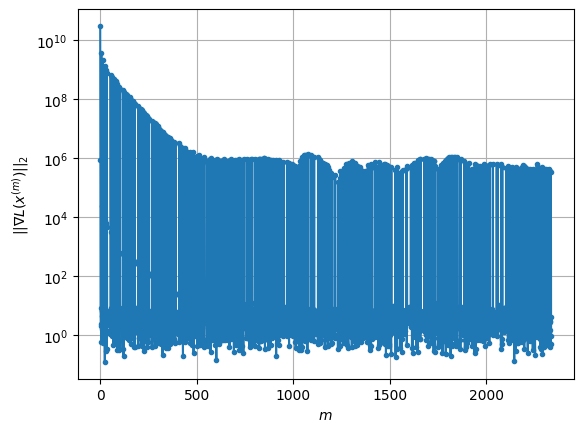

Windows:  76%|███████▌  | 225/296 [1:31:45<13:43, 11.60s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1611.3659811609837
Gradient norm: 511097.36386429117
Deviation from touching point norm = 0.0
Global relative error: 68.67352730432121
Position relative errors: 0.03670912442970605 m, 43.17793165654312 m, 4.006093379238992 m, 53.25098325116736 m

Iteration 1
Cost function: 1601.9250586161454 (-0.59%)
Gradient norm: 3.1416911788078523 (-100.00%)
Deviation from touching point norm = 0.3413339070381504 (341333907038.15%)
Global relative error = 68.58921103631413 (-0.12%)
Position relative errors: 0.033296149460980924 m, 43.13977335378274 m, 3.849225253536439 m, 53.18477194670358 m

STOP on Iteration 2
Cost function = 1601.9250591250945 (0.00%)
Gradient norm = 0.34541321367283556 (-89.01%)
Deviation from touching point norm = 0.34133391186275697 (0.00%)
Global relative error = 68.58921104065779 (0.00%)
Final position relative errors: 0.03329614957529556 m, 43.139773355038855 m, 3.8492252447613806 m, 53.1847

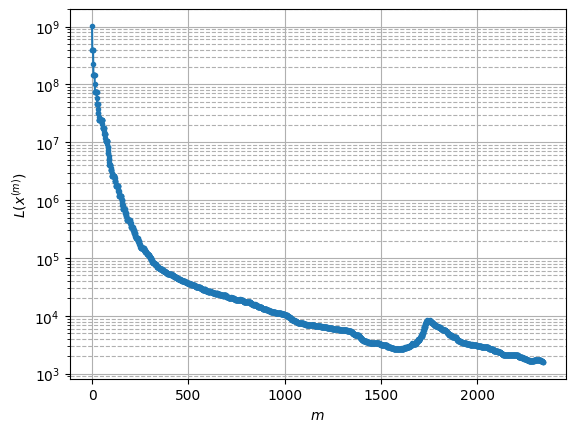

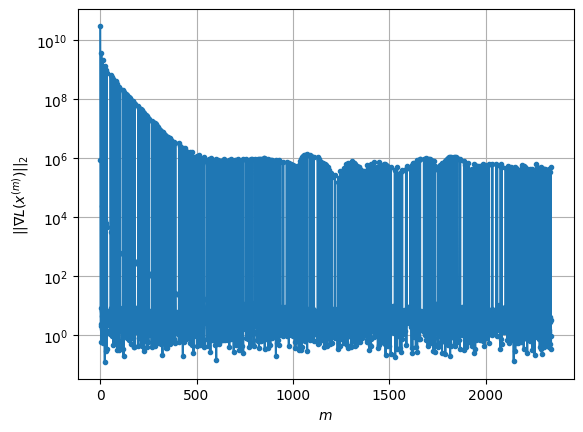

Windows:  76%|███████▋  | 226/296 [1:31:53<12:10, 10.43s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1577.0438034853717
Gradient norm: 303638.9366306536
Deviation from touching point norm = 0.0
Global relative error: 71.12578085882198
Position relative errors: 0.033482461067933636 m, 45.18093666901174 m, 4.53476220201482 m, 54.74479600026139 m

Iteration 1
Cost function: 1568.1056270793074 (-0.57%)
Gradient norm: 1.0806582317044202 (-100.00%)
Deviation from touching point norm = 0.35210468786117544 (352104687861.18%)
Global relative error = 71.04315755622143 (-0.12%)
Position relative errors: 0.03118216056773268 m, 45.14330318583012 m, 4.386076078197626 m, 54.68063639519174 m

STOP on Iteration 2
Cost function = 1568.105629478681 (0.00%)
Gradient norm = 0.6422719315658479 (-40.57%)
Deviation from touching point norm = 0.3521046943422103 (0.00%)
Global relative error = 71.04315756027627 (0.00%)
Final position relative errors: 0.031182159658917654 m, 45.14330318706427 m, 4.386076070524668 m, 54.680636400

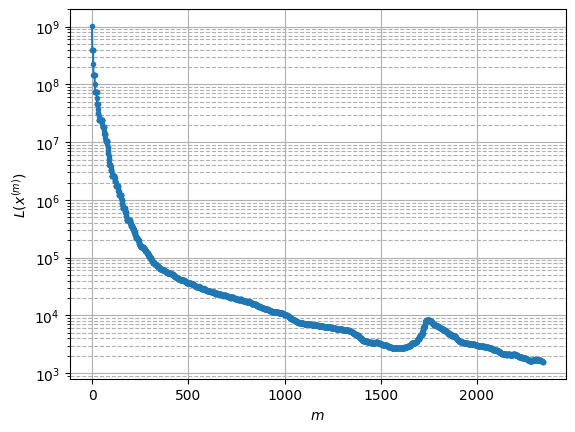

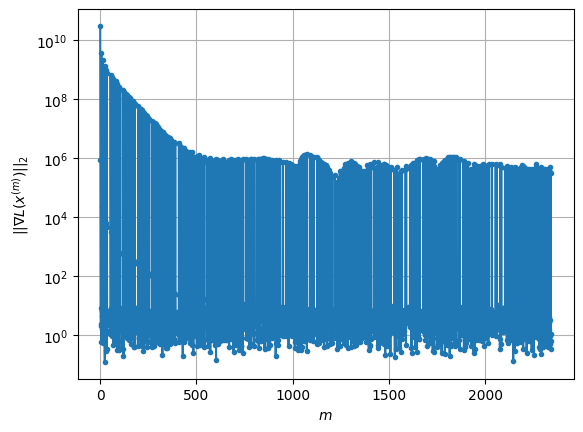

Windows:  77%|███████▋  | 227/296 [1:32:01<11:04,  9.63s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1525.1370080862637
Gradient norm: 343095.8491843795
Deviation from touching point norm = 0.0
Global relative error: 73.27856841585422
Position relative errors: 0.03116879914670506 m, 46.98788304175657 m, 5.071280994328285 m, 56.001492690222655 m

Iteration 1
Cost function: 1515.8914984954804 (-0.61%)
Gradient norm: 1.0025701397538807 (-100.00%)
Deviation from touching point norm = 0.377689358349284 (377689358349.28%)
Global relative error = 73.19847636755786 (-0.11%)
Position relative errors: 0.03250392985453802 m, 46.952112451269635 m, 4.923603058747321 m, 55.93989425512591 m

STOP on Iteration 2
Cost function = 1515.8914983726522 (-0.00%)
Gradient norm = 0.8454042983171035 (-15.68%)
Deviation from touching point norm = 0.37768934680143323 (-0.00%)
Global relative error = 73.19847637195208 (0.00%)
Final position relative errors: 0.03250392746612233 m, 46.95211245313373 m, 4.923603053677537 m, 55.939894

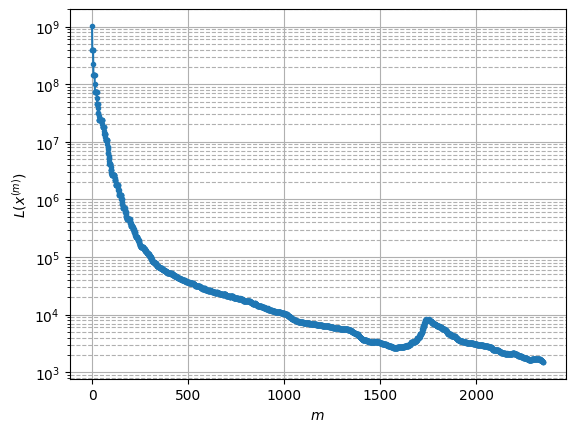

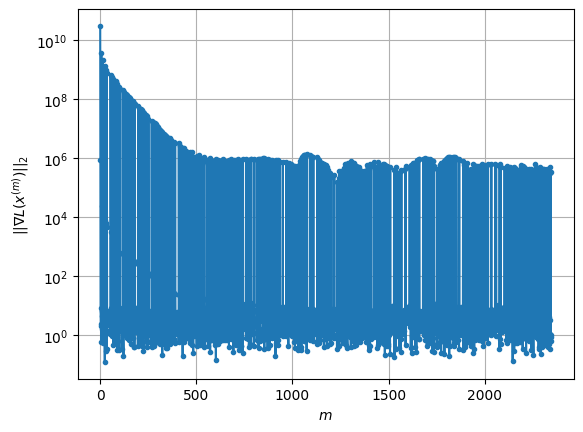

Windows:  77%|███████▋  | 228/296 [1:32:09<10:20,  9.12s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1487.7583044145538
Gradient norm: 312710.5421075116
Deviation from touching point norm = 0.0
Global relative error: 75.1224002364303
Position relative errors: 0.03235462809326197 m, 48.59199456201425 m, 5.598347830266848 m, 57.01622133936647 m

Iteration 1
Cost function: 1477.811880315967 (-0.67%)
Gradient norm: 1.8909877421915973 (-100.00%)
Deviation from touching point norm = 0.37629487470948736 (376294874709.49%)
Global relative error = 75.04441267291622 (-0.10%)
Position relative errors: 0.049469495376700916 m, 48.55694828286448 m, 5.462078272541044 m, 56.956552418051295 m

Iteration 2
Cost function: 1477.8118797953803 (-0.00%)
Gradient norm: 3.1858238472985834 (68.47%)
Deviation from touching point norm = 0.37629487733348976 (0.00%)
Global relative error = 75.04441267626092 (0.00%)
Position relative errors: 0.049469496862637734 m, 48.5569482839797 m, 5.462078266459769 m, 56.95655242208932 m

Iterat

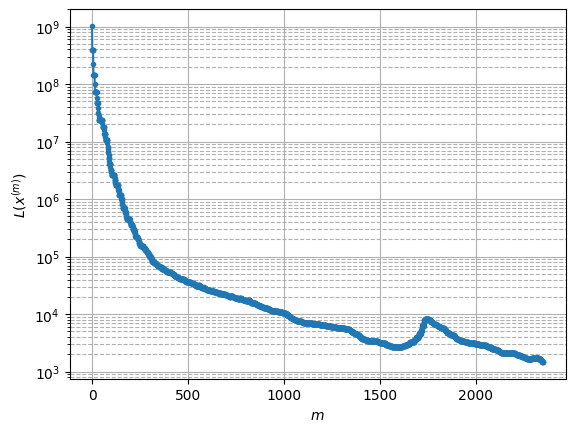

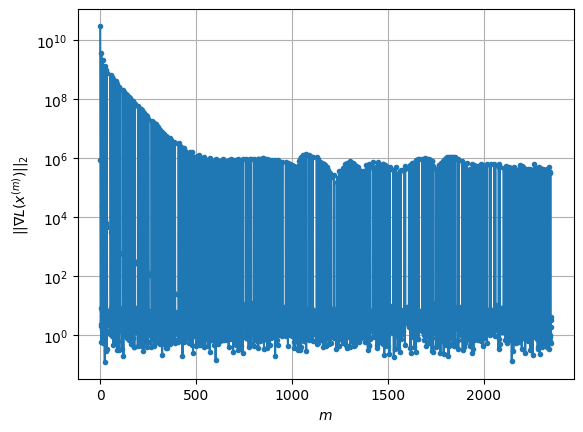

Windows:  77%|███████▋  | 229/296 [1:32:21<11:14, 10.07s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1434.3062428986466
Gradient norm: 281174.17665386567
Deviation from touching point norm = 0.0
Global relative error: 76.64821406618722
Position relative errors: 0.04837628350104965 m, 49.985029487104214 m, 6.11857453971834 m, 57.78412852383558 m

Iteration 1
Cost function: 1425.4633897643187 (-0.62%)
Gradient norm: 4.669485276458399 (-100.00%)
Deviation from touching point norm = 0.370174605886318 (370174605886.32%)
Global relative error = 76.57397094629584 (-0.10%)
Position relative errors: 0.05261604358521467 m, 49.95329410433025 m, 6.0000189614769095 m, 57.72553766245446 m

STOP on Iteration 2
Cost function = 1425.4633911969738 (0.00%)
Gradient norm = 0.8518101508765032 (-81.76%)
Deviation from touching point norm = 0.3701746007093619 (-0.00%)
Global relative error = 76.57397095000282 (0.00%)
Final position relative errors: 0.05261604374331261 m, 49.953294105989215 m, 6.000018955827688 m, 57.72553766

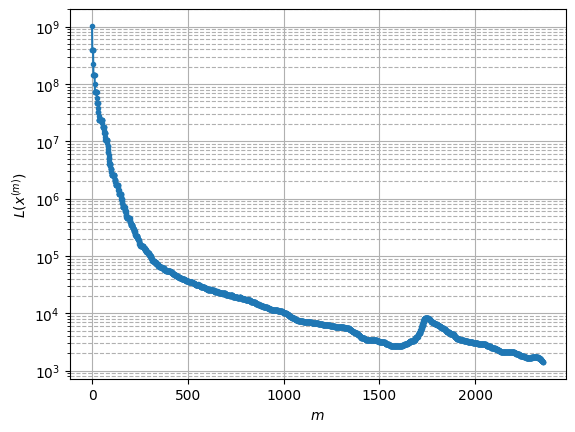

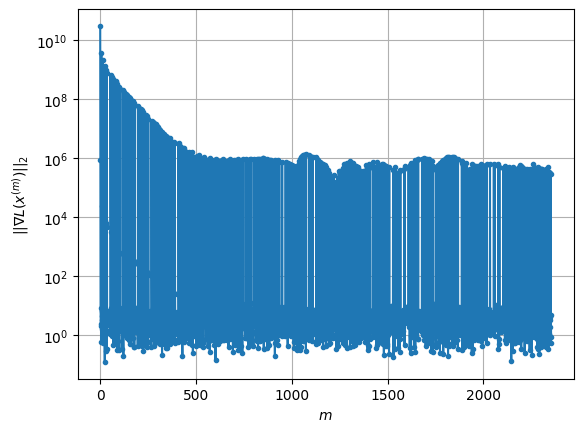

Windows:  78%|███████▊  | 230/296 [1:32:29<10:20,  9.40s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1372.576695620388
Gradient norm: 273215.1738825336
Deviation from touching point norm = 0.0
Global relative error: 77.8505470914829
Position relative errors: 0.051217625245529606 m, 51.16322406297666 m, 6.6325333715399255 m, 58.30127410427931 m

Iteration 1
Cost function: 1363.061030528703 (-0.69%)
Gradient norm: 1.9136678541222538 (-100.00%)
Deviation from touching point norm = 0.39704554168137735 (397045541681.38%)
Global relative error = 77.78054946365141 (-0.09%)
Position relative errors: 0.05661170665223723 m, 51.134335098407036 m, 6.52756149707533 m, 58.24500738466439 m

Iteration 2
Cost function: 1363.0610305025643 (-0.00%)
Gradient norm: 5.937471793912178 (210.27%)
Deviation from touching point norm = 0.3970455351555026 (-0.00%)
Global relative error = 77.78054946725605 (0.00%)
Position relative errors: 0.056611712544837385 m, 51.1343351002239 m, 6.527561492030962 m, 58.245007388442595 m

Iterat

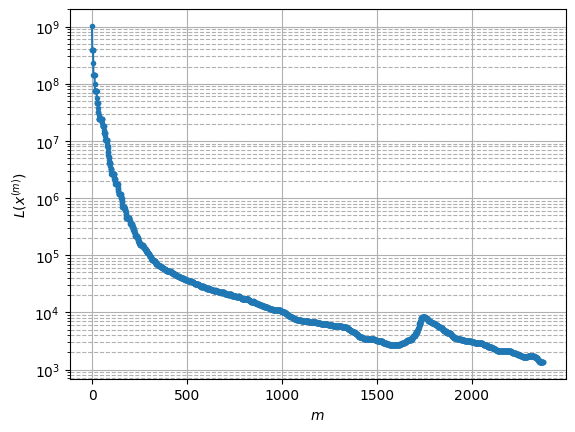

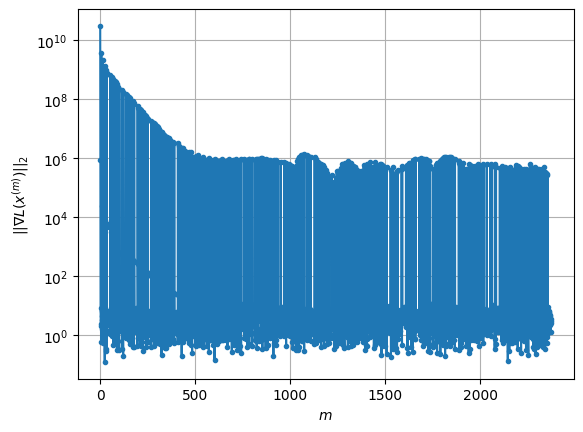

Windows:  78%|███████▊  | 231/296 [1:33:16<22:21, 20.64s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1319.3147384760678
Gradient norm: 468515.7013694929
Deviation from touching point norm = 0.0
Global relative error: 78.72436069026455
Position relative errors: 0.054869186881966285 m, 52.120762360911684 m, 7.132377621111121 m, 58.56685884532536 m

Iteration 1
Cost function: 1311.058254367341 (-0.63%)
Gradient norm: 6.3156007330828645 (-100.00%)
Deviation from touching point norm = 0.36458956720130936 (364589567201.31%)
Global relative error = 78.65902021866809 (-0.08%)
Position relative errors: 0.057182960548242616 m, 52.095072603576405 m, 7.047878929734107 m, 58.512124259448186 m

Iteration 2
Cost function: 1311.0582531521818 (-0.00%)
Gradient norm: 8.056278756358926 (27.56%)
Deviation from touching point norm = 0.36458957966556155 (0.00%)
Global relative error = 78.65902022187538 (0.00%)
Position relative errors: 0.05718295747339858 m, 52.095072604865976 m, 7.047878924921067 m, 58.512124263194416 m

S

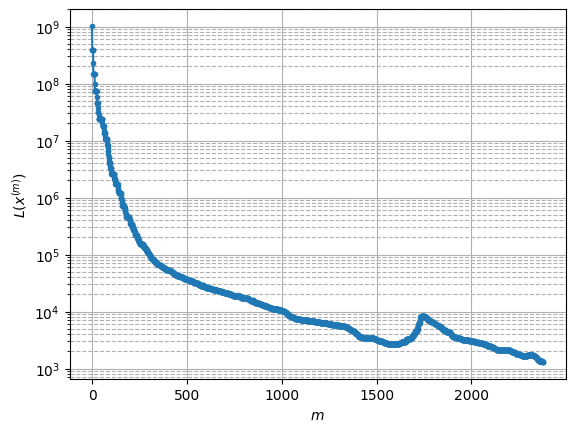

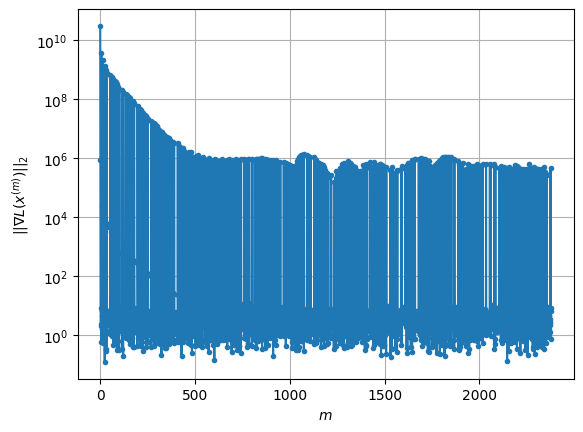

Windows:  78%|███████▊  | 232/296 [1:33:26<18:33, 17.40s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1274.2428912770017
Gradient norm: 400451.74858999497
Deviation from touching point norm = 0.0
Global relative error: 79.26618895035512
Position relative errors: 0.05558348662484645 m, 52.853660300951425 m, 7.621700479532932 m, 58.57922577485314 m

STOP on Iteration 1
Cost function = 1266.1573931263495 (-0.63%)
Gradient norm = 0.9164182460754217 (-100.00%)
Deviation from touching point norm = 0.3516551326761828 (351655132676.18%)
Global relative error = 79.20601299086076 (-0.08%)
Final position relative errors: 0.05899143169971487 m, 52.83033659820021 m, 7.556049144923739 m, 58.52734803193027 m

Majorization-Minimization converged after 1 iterations


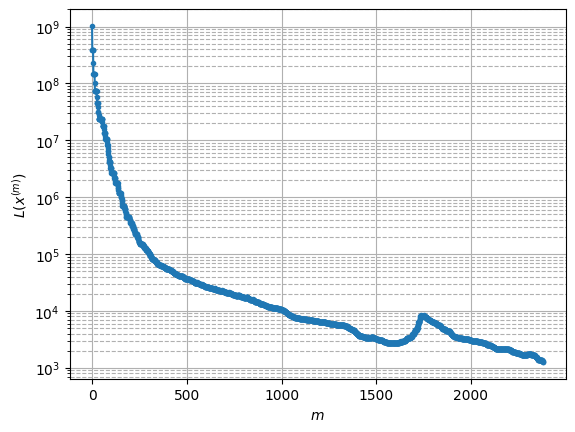

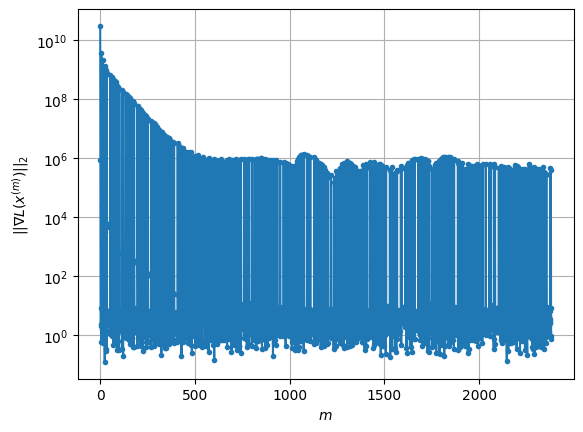

Windows:  79%|███████▊  | 233/296 [1:33:31<14:26, 13.76s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1219.1251589442704
Gradient norm: 325708.2215418593
Deviation from touching point norm = 0.0
Global relative error: 79.47417176748019
Position relative errors: 0.05733264122126629 m, 53.35776482752166 m, 8.096115834085909 m, 58.33988670876514 m

Iteration 1
Cost function: 1210.3128147725035 (-0.72%)
Gradient norm: 2.9487405481702087 (-100.00%)
Deviation from touching point norm = 0.37372134543646307 (373721345436.46%)
Global relative error = 79.41942802689917 (-0.07%)
Position relative errors: 0.06017772583349455 m, 53.33668395383598 m, 8.051750836193163 m, 58.29073022232865 m

STOP on Iteration 2
Cost function = 1210.3128148200512 (0.00%)
Gradient norm = 0.2723264950976792 (-90.76%)
Deviation from touching point norm = 0.37372134894329995 (0.00%)
Global relative error = 79.41942802997347 (0.00%)
Final position relative errors: 0.060177725946025364 m, 53.336683954983464 m, 8.051750833271981 m, 58.290730

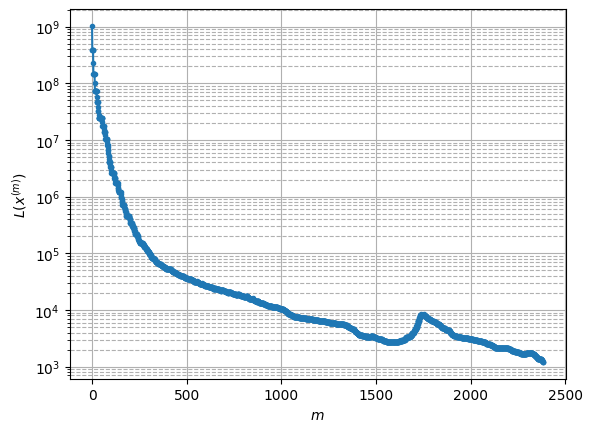

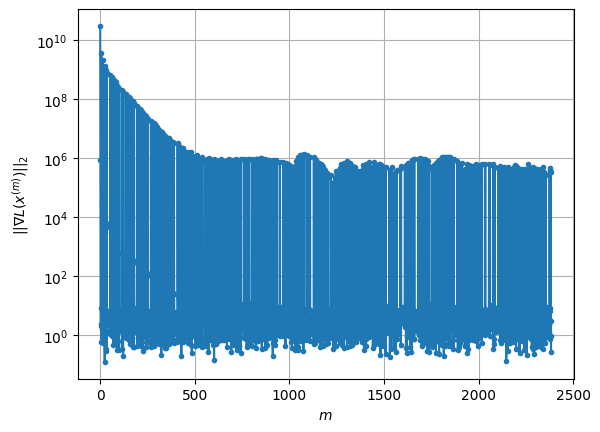

Windows:  79%|███████▉  | 234/296 [1:33:38<12:15, 11.87s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1175.3105237700468
Gradient norm: 591522.4784988612
Deviation from touching point norm = 0.0
Global relative error: 79.34785232288796
Position relative errors: 0.05837466276869812 m, 53.63069739733008 m, 8.555495013323302 m, 57.85006394601712 m

Iteration 1
Cost function: 1168.3168750183393 (-0.60%)
Gradient norm: 1.37201144280808 (-100.00%)
Deviation from touching point norm = 0.32394782691232143 (323947826912.32%)
Global relative error = 79.29796105897321 (-0.06%)
Position relative errors: 0.05323810026474495 m, 53.61173001639939 m, 8.53812251636768 m, 57.80178629841233 m

STOP on Iteration 2
Cost function = 1168.316875379502 (0.00%)
Gradient norm = 0.716449138463732 (-47.78%)
Deviation from touching point norm = 0.3239478177281988 (-0.00%)
Global relative error = 79.29796106205724 (0.00%)
Final position relative errors: 0.05323810067631422 m, 53.61173001780831 m, 8.53812251510407 m, 57.80178630152276

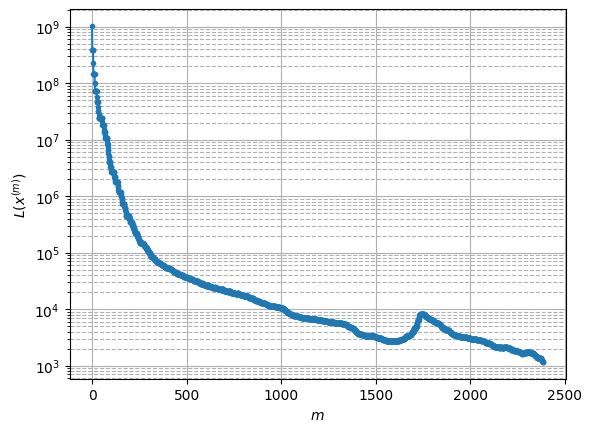

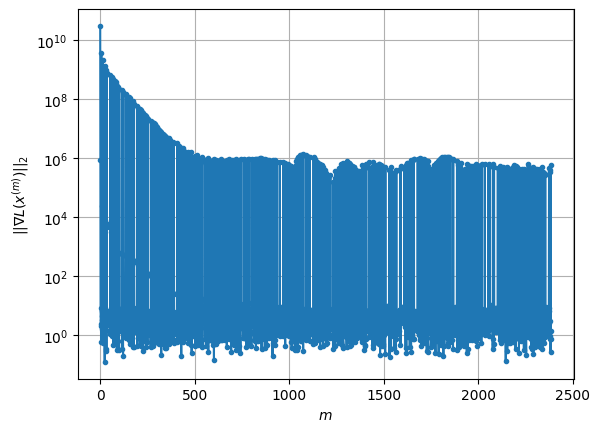

Windows:  79%|███████▉  | 235/296 [1:33:46<10:45, 10.57s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1139.5160028848559
Gradient norm: 357522.9990537438
Deviation from touching point norm = 0.0
Global relative error: 78.8876153849333
Position relative errors: 0.05172093167667962 m, 53.67110136450935 m, 9.003140976823946 m, 57.1105005701168 m

Iteration 1
Cost function: 1133.6033311510466 (-0.52%)
Gradient norm: 1.2621452828069368 (-100.00%)
Deviation from touching point norm = 0.27874990400280847 (278749904002.81%)
Global relative error = 78.84187681729789 (-0.06%)
Position relative errors: 0.04393823295990485 m, 53.65341015189325 m, 9.00532830661702 m, 57.0636049517711 m

Iteration 2
Cost function: 1133.6033305376263 (-0.00%)
Gradient norm: 3.4377928270475526 (172.38%)
Deviation from touching point norm = 0.2787499022357372 (-0.00%)
Global relative error = 78.8418768203837 (0.00%)
Position relative errors: 0.04393823033161233 m, 53.65341015213388 m, 9.005328307105788 m, 57.06360495573326 m

STOP on It

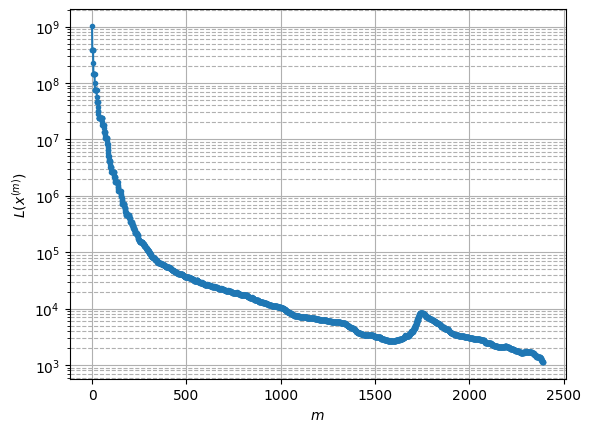

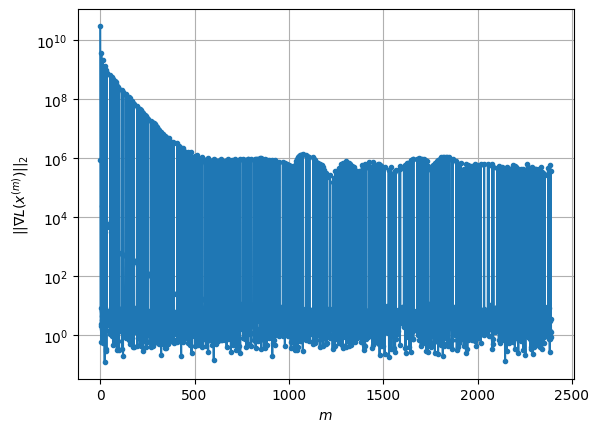

Windows:  80%|███████▉  | 236/296 [1:33:56<10:21, 10.36s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1121.9678871526223
Gradient norm: 330151.00555732066
Deviation from touching point norm = 0.0
Global relative error: 78.09519187056587
Position relative errors: 0.0427840781972225 m, 53.47801708076036 m, 9.429346121525796 m, 56.12526972110391 m

Iteration 1
Cost function: 1117.6186735121362 (-0.39%)
Gradient norm: 1.84153698588735 (-100.00%)
Deviation from touching point norm = 0.20981729670517812 (209817296705.18%)
Global relative error = 78.05210961329593 (-0.06%)
Position relative errors: 0.04430753799475337 m, 53.461000657095994 m, 9.44255419396216 m, 56.07931035603719 m

Iteration 2
Cost function: 1117.6186720314051 (-0.00%)
Gradient norm: 1.0444815580985873 (-43.28%)
Deviation from touching point norm = 0.2098172967256372 (0.00%)
Global relative error = 78.05210961648328 (0.00%)
Position relative errors: 0.04430753794294385 m, 53.46100065752663 m, 9.44255419514479 m, 56.07931035986377 m

STOP on I

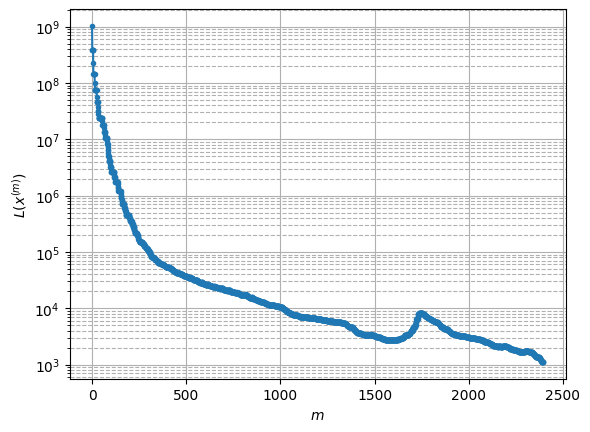

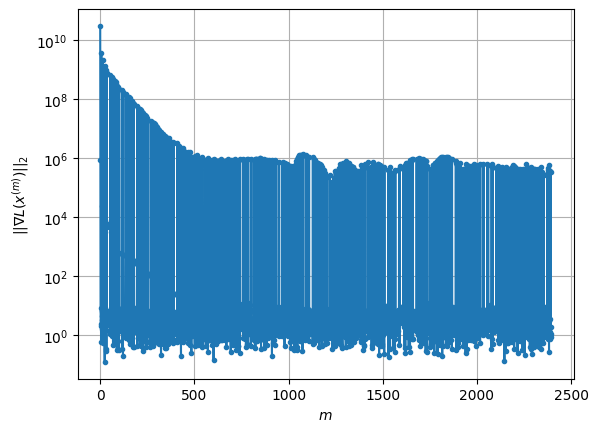

Windows:  80%|████████  | 237/296 [1:34:06<10:04, 10.24s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1128.4632246896806
Gradient norm: 362172.41920859925
Deviation from touching point norm = 0.0
Global relative error: 76.9730539070884
Position relative errors: 0.04302888574899635 m, 53.051787195320486 m, 9.823460237187092 m, 54.89859831703899 m

Iteration 1
Cost function: 1123.8599095345348 (-0.41%)
Gradient norm: 4.489057610798975 (-100.00%)
Deviation from touching point norm = 0.19495929341770518 (194959293417.71%)
Global relative error = 76.9313155434254 (-0.05%)
Position relative errors: 0.053447670686074554 m, 53.035669675874416 m, 9.83709842679839 m, 54.85319598384408 m

STOP on Iteration 2
Cost function = 1123.8599079598887 (-0.00%)
Gradient norm = 0.571341335929891 (-87.27%)
Deviation from touching point norm = 0.19495928755841913 (-0.00%)
Global relative error = 76.93131554682326 (0.00%)
Final position relative errors: 0.053447663138715934 m, 53.03566967663679 m, 9.83709842823507 m, 54.8531959

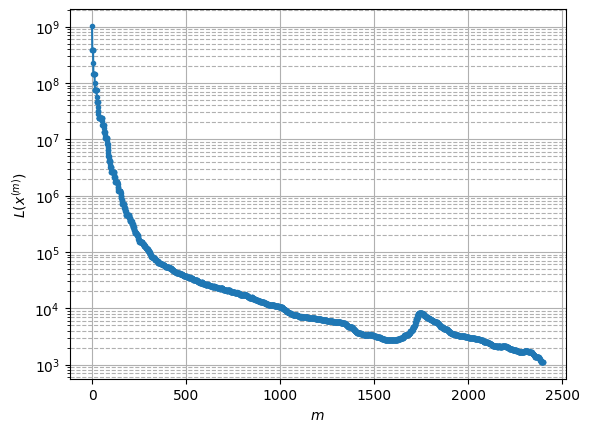

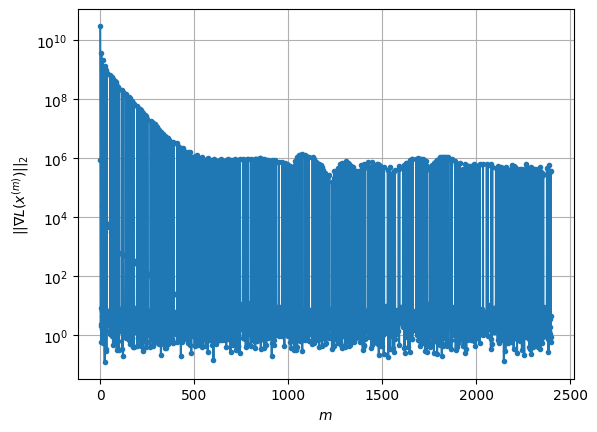

Windows:  80%|████████  | 238/296 [1:34:13<09:07,  9.45s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1154.7526427754217
Gradient norm: 403977.3849595248
Deviation from touching point norm = 0.0
Global relative error: 75.5253299276469
Position relative errors: 0.05182045787663031 m, 52.39459517527735 m, 10.173005900318104 m, 53.43583331052863 m

Iteration 1
Cost function: 1150.2876140182436 (-0.39%)
Gradient norm: 3.6454908112851254 (-100.00%)
Deviation from touching point norm = 0.12861125626978623 (128611256269.79%)
Global relative error = 75.48388050361308 (-0.05%)
Position relative errors: 0.05730979016209924 m, 52.37805858916918 m, 10.186137665562146 m, 53.39095120815381 m

STOP on Iteration 2
Cost function = 1150.2876139921755 (-0.00%)
Gradient norm = 0.38133280564118976 (-89.54%)
Deviation from touching point norm = 0.1286112539658964 (-0.00%)
Global relative error = 75.4838805074317 (0.00%)
Final position relative errors: 0.05730979317914647 m, 52.37805858977785 m, 10.186137667356626 m, 53.39095

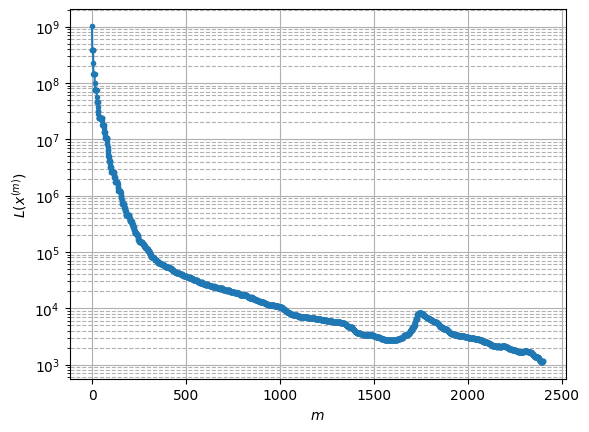

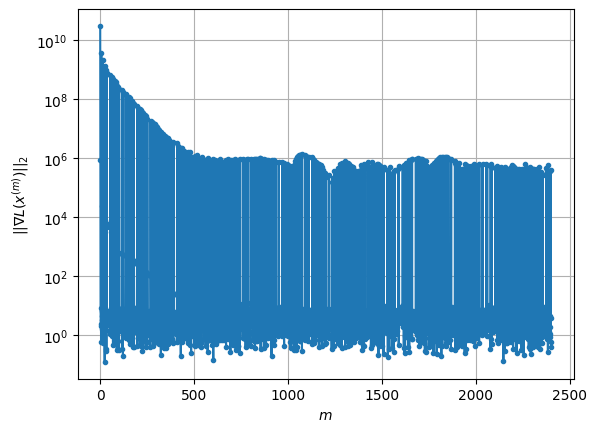

Windows:  81%|████████  | 239/296 [1:34:21<08:26,  8.89s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1180.6142520685974
Gradient norm: 415261.86426252493
Deviation from touching point norm = 0.0
Global relative error: 73.75793987005223
Position relative errors: 0.05548142323352694 m, 51.508174257097544 m, 10.47533985451354 m, 51.74364410108191 m

Iteration 1
Cost function: 1175.959165449815 (-0.39%)
Gradient norm: 3.6122682670656423 (-100.00%)
Deviation from touching point norm = 0.10929681390967798 (109296813909.68%)
Global relative error = 73.71677874605311 (-0.06%)
Position relative errors: 0.05395385573014765 m, 51.49134700280882 m, 10.488148664010284 m, 51.69912312660552 m

Iteration 2
Cost function: 1175.9591640661984 (-0.00%)
Gradient norm: 3.2429686105254727 (-10.22%)
Deviation from touching point norm = 0.1092968054561379 (-0.00%)
Global relative error = 73.71677874999286 (0.00%)
Position relative errors: 0.05395385308237665 m, 51.49134700302022 m, 10.488148666921584 m, 51.699123131424734 m

S

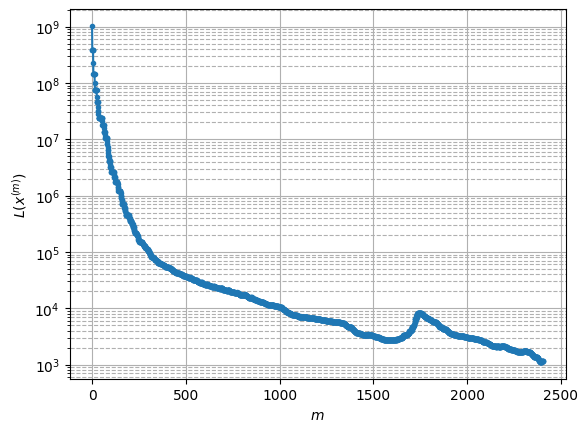

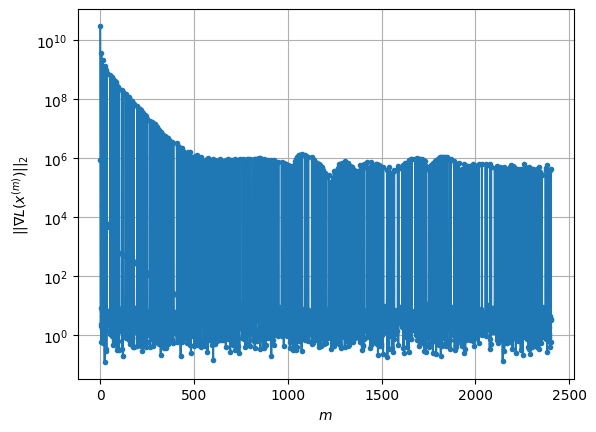

Windows:  81%|████████  | 240/296 [1:34:31<08:31,  9.14s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1202.27960569419
Gradient norm: 452257.330322981
Deviation from touching point norm = 0.0
Global relative error: 71.67936914465132
Position relative errors: 0.05212951258702632 m, 50.39669378751925 m, 10.729098927055505 m, 49.82958387379375 m

Iteration 1
Cost function: 1197.5059040846427 (-0.40%)
Gradient norm: 4.76373908302676 (-100.00%)
Deviation from touching point norm = 0.12023036745264608 (120230367452.65%)
Global relative error = 71.63881810996122 (-0.06%)
Position relative errors: 0.05032289798365475 m, 50.37938837913721 m, 10.7423290753801 m, 49.78589979672081 m

Iteration 2
Cost function: 1197.5059032198255 (-0.00%)
Gradient norm: 3.1554127148820115 (-33.76%)
Deviation from touching point norm = 0.12023036753691888 (0.00%)
Global relative error = 71.638818114936 (0.00%)
Position relative errors: 0.050322897145842774 m, 50.3793883799758 m, 10.742329078450071 m, 49.78589980236907 m

Iteration 3

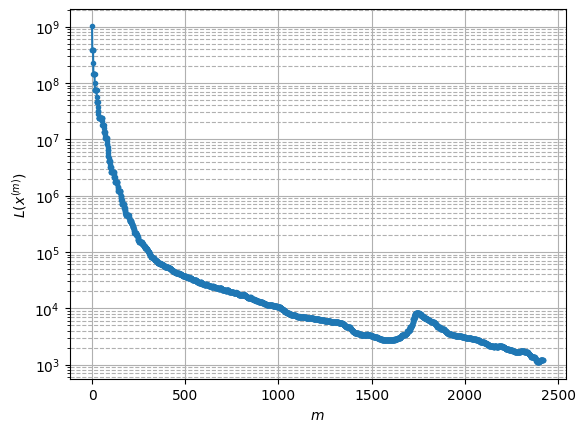

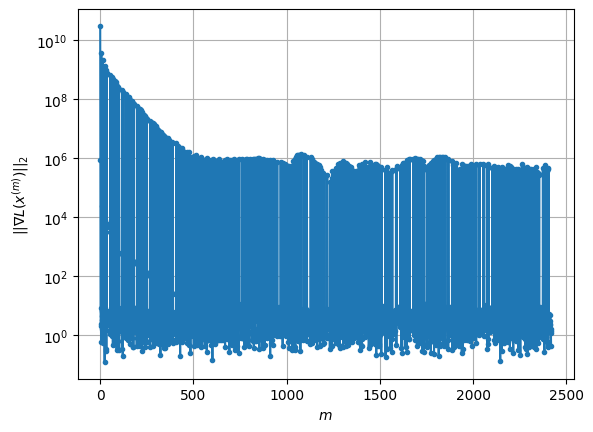

Windows:  81%|████████▏ | 241/296 [1:35:06<15:35, 17.01s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1225.8919269214311
Gradient norm: 409300.45099574205
Deviation from touching point norm = 0.0
Global relative error: 69.2998813629026
Position relative errors: 0.048617326703480866 m, 49.06496454637369 m, 10.933644169062081 m, 47.70276691418633 m

STOP on Iteration 1
Cost function = 1220.6085320156951 (-0.43%)
Gradient norm = 0.9909883979701554 (-100.00%)
Deviation from touching point norm = 0.1343625571235632 (134362557123.56%)
Global relative error = 69.26012294528684 (-0.06%)
Final position relative errors: 0.046549472373431 m, 49.0473853203193 m, 10.947174175584818 m, 47.6599825636493 m

Majorization-Minimization converged after 1 iterations


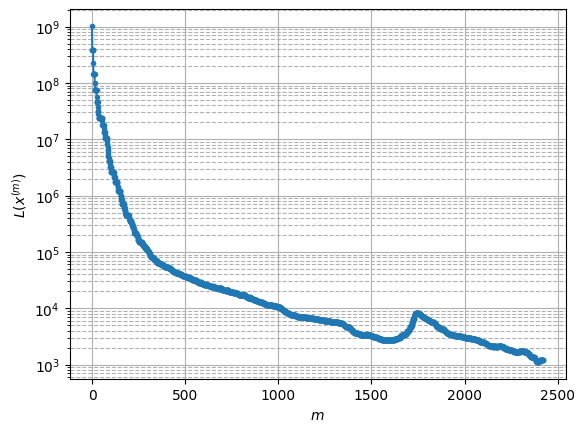

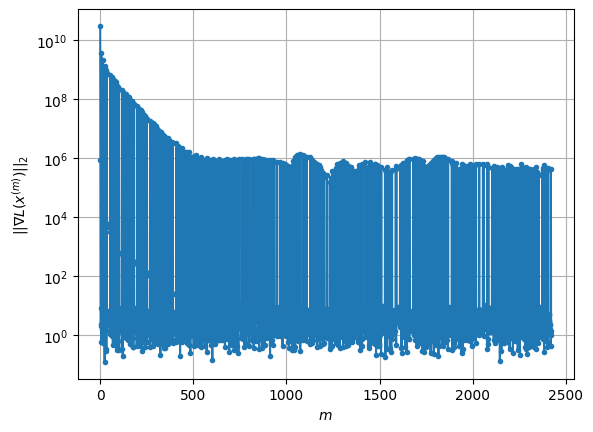

Windows:  82%|████████▏ | 242/296 [1:35:11<12:06, 13.45s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1222.481463770184
Gradient norm: 306151.7795310002
Deviation from touching point norm = 0.0
Global relative error: 66.63105824358416
Position relative errors: 0.044865865088385234 m, 47.5191393703098 m, 11.087699228874305 m, 45.37276605760943 m

STOP on Iteration 1
Cost function = 1218.3473029481056 (-0.34%)
Gradient norm = 0.39770766452807454 (-100.00%)
Deviation from touching point norm = 0.15272109402066134 (152721094020.66%)
Global relative error = 66.59330178897946 (-0.06%)
Final position relative errors: 0.04554860176112266 m, 47.50084264332208 m, 11.10312152715834 m, 45.33270436784034 m

Majorization-Minimization converged after 1 iterations


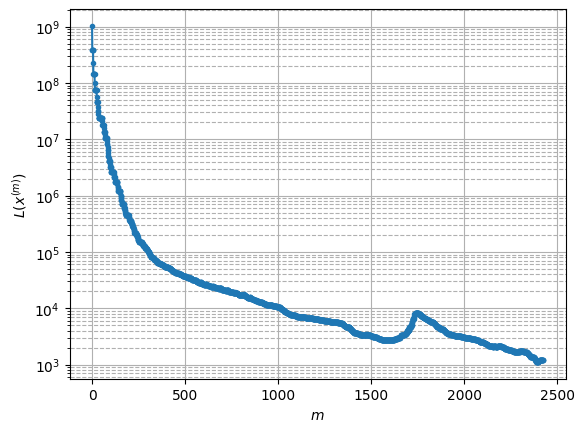

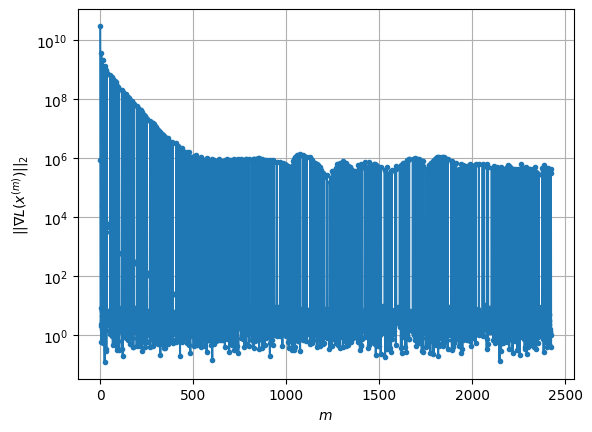

Windows:  82%|████████▏ | 243/296 [1:35:17<09:44, 11.03s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1222.1513295690156
Gradient norm: 268808.99794042454
Deviation from touching point norm = 0.0
Global relative error: 63.687027429347836
Position relative errors: 0.04387688436063419 m, 45.765637289853274 m, 11.191944673585196 m, 42.85183278424616 m

Iteration 1
Cost function: 1218.4225912444558 (-0.31%)
Gradient norm: 2.9175151839888147 (-100.00%)
Deviation from touching point norm = 0.16973850364019488 (169738503640.19%)
Global relative error = 63.65156770761386 (-0.06%)
Position relative errors: 0.037768184156600514 m, 45.74798681110148 m, 11.20710265657243 m, 42.81402132126372 m

STOP on Iteration 2
Cost function = 1218.4225899976875 (-0.00%)
Gradient norm = 0.5305817251230065 (-81.81%)
Deviation from touching point norm = 0.1697384935720634 (-0.00%)
Global relative error = 63.6515677132536 (0.00%)
Final position relative errors: 0.03776818431256831 m, 45.74798681163684 m, 11.207102659879066 m, 42.81

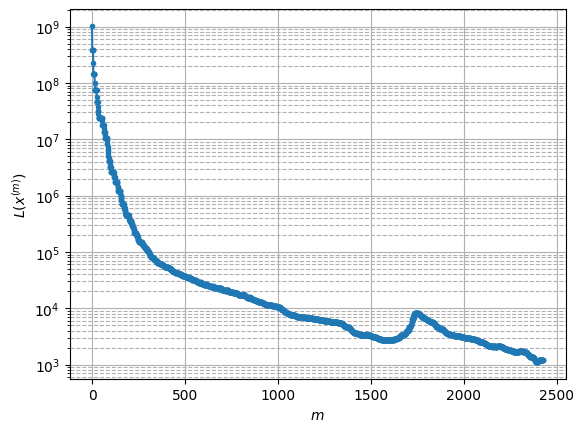

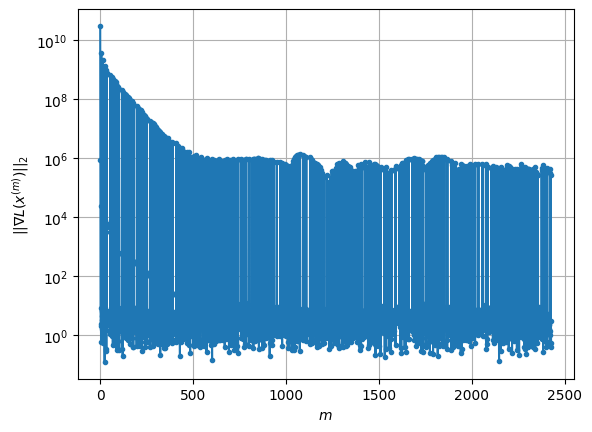

Windows:  82%|████████▏ | 244/296 [1:35:24<08:42, 10.05s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1225.7992422729278
Gradient norm: 311693.8046517013
Deviation from touching point norm = 0.0
Global relative error: 60.4825270384185
Position relative errors: 0.036367886140777454 m, 43.81357424831486 m, 11.243700582237489 m, 40.15073361969686 m

Iteration 1
Cost function: 1221.152941432794 (-0.38%)
Gradient norm: 5.1467614831215736 (-100.00%)
Deviation from touching point norm = 0.21422006034617644 (214220060346.18%)
Global relative error = 60.449582937640855 (-0.05%)
Position relative errors: 0.04384228327850607 m, 43.7956465037362 m, 11.261121992417662 m, 40.115774800161425 m

Iteration 2
Cost function: 1221.1529419417725 (0.00%)
Gradient norm: 3.3338739793977137 (-35.22%)
Deviation from touching point norm = 0.2142200583158212 (-0.00%)
Global relative error = 60.449582943233395 (0.00%)
Position relative errors: 0.0438422823836215 m, 43.795646504344546 m, 11.261121996153038 m, 40.11577480687694 m

ST

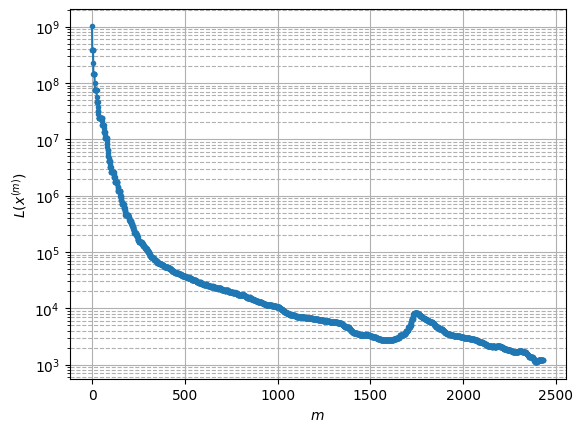

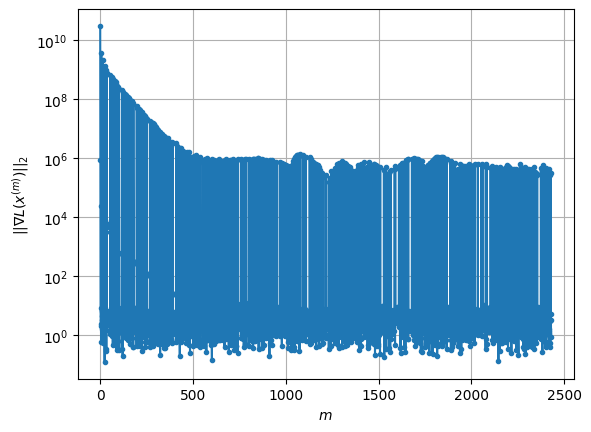

Windows:  83%|████████▎ | 245/296 [1:35:34<08:24,  9.90s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1213.8673791858678
Gradient norm: 287448.0340872058
Deviation from touching point norm = 0.0
Global relative error: 57.03377663416841
Position relative errors: 0.04218552294003312 m, 41.67065058740573 m, 11.245158591976995 m, 37.28202587105679 m

Iteration 1
Cost function: 1208.3431314834104 (-0.46%)
Gradient norm: 7.755468750843852 (-100.00%)
Deviation from touching point norm = 0.26053417097328563 (260534170973.29%)
Global relative error = 57.00469969738292 (-0.05%)
Position relative errors: 0.043381334896803646 m, 41.65312651796015 m, 11.266262186433538 m, 37.25075258371541 m

Iteration 2
Cost function: 1208.3431348244678 (0.00%)
Gradient norm: 5.569790571065821 (-28.18%)
Deviation from touching point norm = 0.26053416799951634 (-0.00%)
Global relative error = 57.00469970325892 (0.00%)
Position relative errors: 0.04338133141653947 m, 41.653126518384866 m, 11.266262190515036 m, 37.250752591002154 m

I

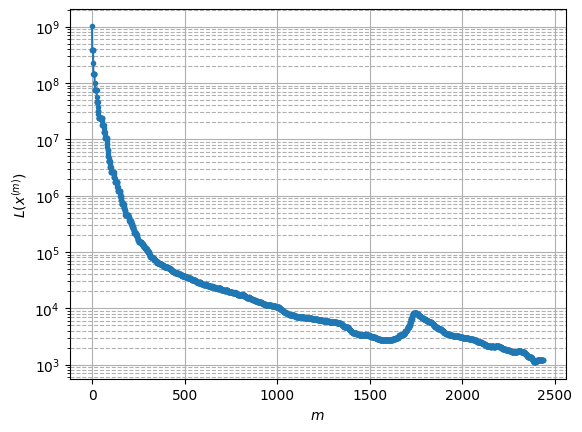

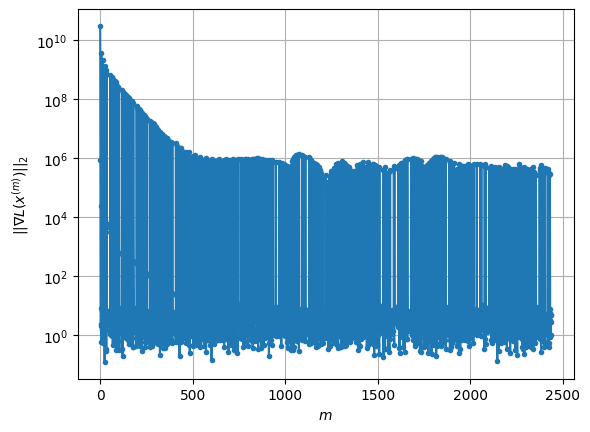

Windows:  83%|████████▎ | 246/296 [1:35:50<09:51, 11.83s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1189.2634828801588
Gradient norm: 267182.3488818486
Deviation from touching point norm = 0.0
Global relative error: 53.359875651391235
Position relative errors: 0.04175789915476375 m, 39.34698259552364 m, 11.19766822200351 m, 34.25926969954448 m

Iteration 1
Cost function: 1183.4192056709892 (-0.49%)
Gradient norm: 4.753377233108232 (-100.00%)
Deviation from touching point norm = 0.2916829865424727 (291682986542.47%)
Global relative error = 53.335719349901446 (-0.05%)
Position relative errors: 0.04907534102946476 m, 39.33072538778401 m, 11.221975399948013 m, 34.232348060579106 m

Iteration 2
Cost function: 1183.4192053156323 (-0.00%)
Gradient norm: 3.86460726350004 (-18.70%)
Deviation from touching point norm = 0.2916829835469471 (-0.00%)
Global relative error = 53.33571935509636 (0.00%)
Position relative errors: 0.04907534736772298 m, 39.33072538827177 m, 11.221975403553504 m, 34.23234806692158 m

STOP

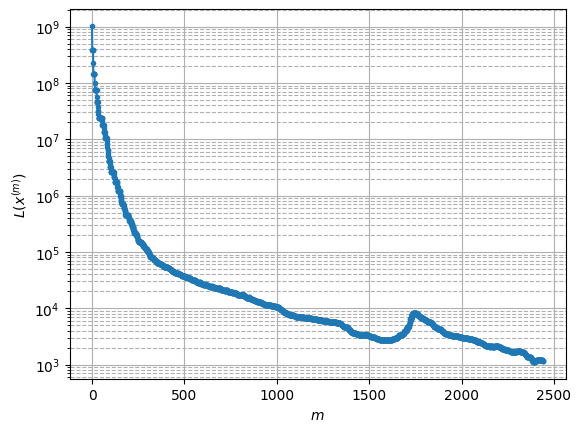

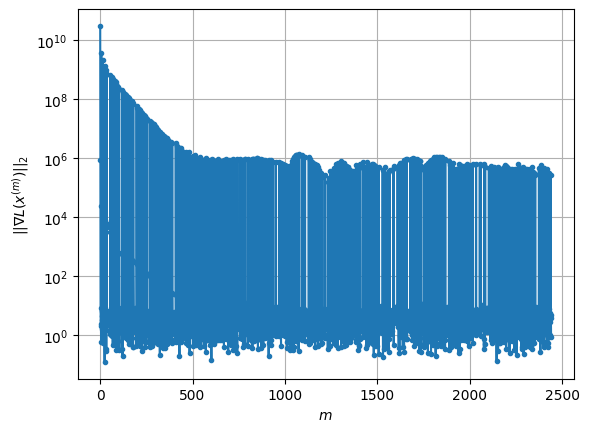

Windows:  83%|████████▎ | 247/296 [1:36:00<09:08, 11.19s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1170.1931846860023
Gradient norm: 295968.60320647695
Deviation from touching point norm = 0.0
Global relative error: 49.48157513860132
Position relative errors: 0.047210788354963895 m, 36.8536694209438 m, 11.101049952019718 m, 31.096512740016394 m

Iteration 1
Cost function: 1164.453526113919 (-0.49%)
Gradient norm: 5.424789843090884 (-100.00%)
Deviation from touching point norm = 0.289276151358006 (289276151358.01%)
Global relative error = 49.461680687870064 (-0.04%)
Position relative errors: 0.03780538842775538 m, 36.838298367964065 m, 11.124599919722016 m, 31.074664921664933 m

Iteration 2
Cost function: 1164.4535282752406 (0.00%)
Gradient norm: 1.5815902424897554 (-70.85%)
Deviation from touching point norm = 0.28927613657584256 (-0.00%)
Global relative error = 49.46168069284955 (0.00%)
Position relative errors: 0.03780538520622898 m, 36.83829836785026 m, 11.124599922338492 m, 31.074664928792938 m



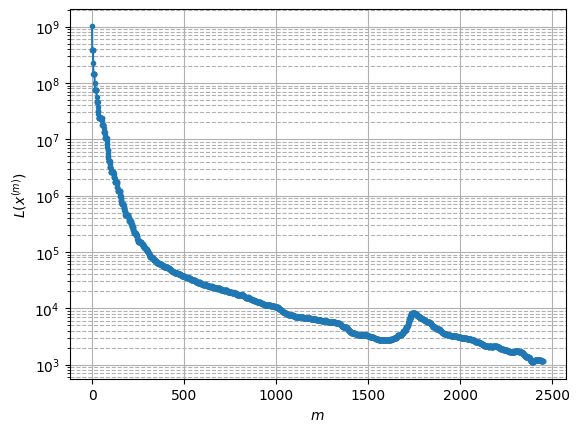

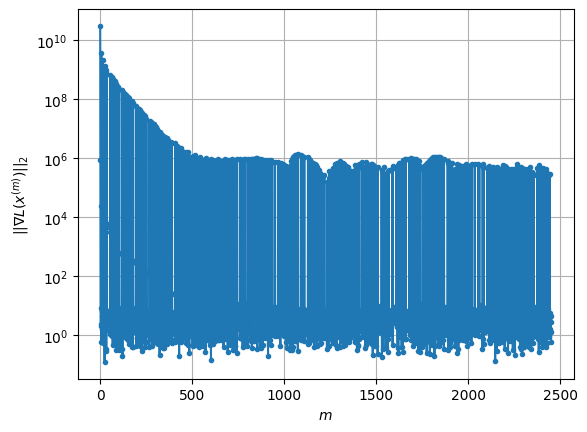

Windows:  84%|████████▍ | 248/296 [1:36:21<11:18, 14.13s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1165.7982836928106
Gradient norm: 304267.0798231675
Deviation from touching point norm = 0.0
Global relative error: 45.420258595757474
Position relative errors: 0.0360467442670124 m, 34.201275471879995 m, 10.952125877537988 m, 27.808580419820025 m

Iteration 1
Cost function: 1160.61026688154 (-0.45%)
Gradient norm: 3.422975866095355 (-100.00%)
Deviation from touching point norm = 0.24953189326388414 (249531893263.88%)
Global relative error = 45.40290697186142 (-0.04%)
Position relative errors: 0.024743802455441055 m, 34.18782229947383 m, 10.970252529895497 m, 27.789648822926363 m

Iteration 2
Cost function: 1160.610267771907 (0.00%)
Gradient norm: 2.8540900060206074 (-16.62%)
Deviation from touching point norm = 0.24953189197321557 (-0.00%)
Global relative error = 45.40290697653324 (0.00%)
Position relative errors: 0.024743809358385608 m, 34.18782229982371 m, 10.970252532394353 m, 27.789648829136187 m



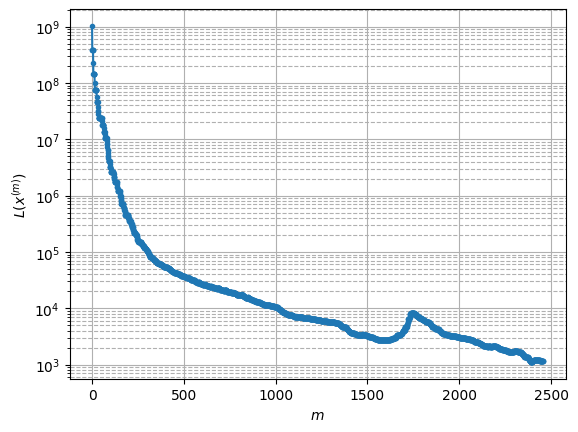

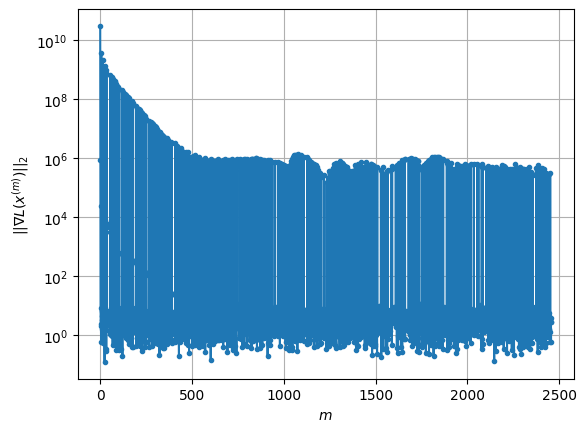

Windows:  84%|████████▍ | 249/296 [1:36:36<11:13, 14.34s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1144.2470148163573
Gradient norm: 286524.1126288664
Deviation from touching point norm = 0.0
Global relative error: 41.19925808769535
Position relative errors: 0.023448957498727697 m, 31.40247312228145 m, 10.747409281114486 m, 24.40800316943028 m

STOP on Iteration 1
Cost function = 1138.2512789465932 (-0.52%)
Gradient norm = 0.8724720823460431 (-100.00%)
Deviation from touching point norm = 0.29467948928322213 (294679489283.22%)
Global relative error = 41.18854200822155 (-0.03%)
Final position relative errors: 0.014562230134355099 m, 31.38955472643668 m, 10.765180403019315 m, 24.398708157656365 m

Majorization-Minimization converged after 1 iterations


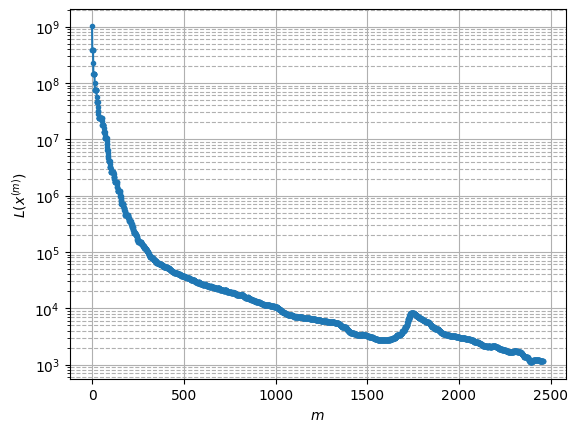

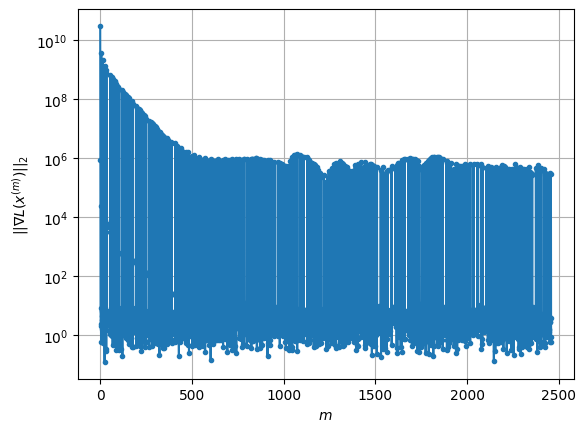

Windows:  84%|████████▍ | 250/296 [1:36:41<08:55, 11.65s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1119.2438317779931
Gradient norm: 408336.23669155303
Deviation from touching point norm = 0.0
Global relative error: 36.852317576248694
Position relative errors: 0.013438163688992439 m, 28.468130221136235 m, 10.49313359885778 m, 20.91762089466963 m

Iteration 1
Cost function: 1112.7564336343485 (-0.58%)
Gradient norm: 3.707903062637172 (-100.00%)
Deviation from touching point norm = 0.30674048337249993 (306740483372.50%)
Global relative error = 36.84823675147573 (-0.01%)
Position relative errors: 0.017572914976519863 m, 28.456871971734905 m, 10.511242249184264 m, 20.91665603298131 m

Iteration 2
Cost function: 1112.7564343899214 (0.00%)
Gradient norm: 2.1953830714954967 (-40.79%)
Deviation from touching point norm = 0.3067404796851409 (-0.00%)
Global relative error = 36.84823675538319 (0.00%)
Position relative errors: 0.01757292152314328 m, 28.45687197163543 m, 10.511242251140507 m, 20.916656039011713 m

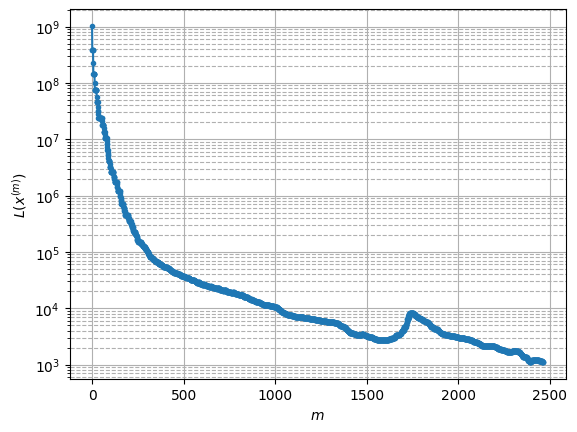

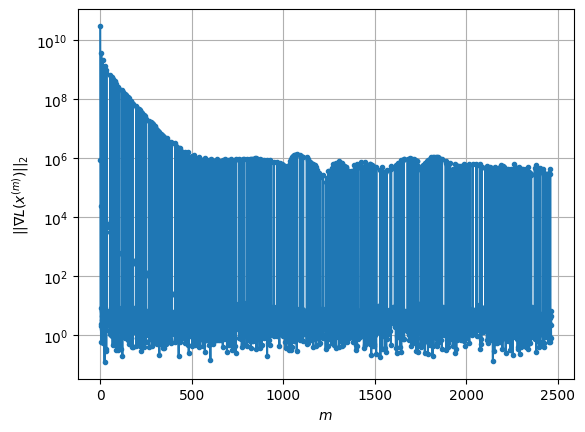

Windows:  85%|████████▍ | 251/296 [1:36:55<09:17, 12.39s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1094.5644973849464
Gradient norm: 418540.74575527705
Deviation from touching point norm = 0.0
Global relative error: 32.416074650162216
Position relative errors: 0.016912050192916393 m, 25.41222941495389 m, 10.191454972981148 m, 17.353619594435973 m

Iteration 1
Cost function: 1088.0341418677497 (-0.60%)
Gradient norm: 2.424163973164396 (-100.00%)
Deviation from touching point norm = 0.32189717147832464 (321897171478.32%)
Global relative error = 32.42040766465325 (0.01%)
Position relative errors: 0.01924518313133816 m, 25.40240141827066 m, 10.212494225953106 m, 17.36372932600067 m

Iteration 2
Cost function: 1088.034142223166 (0.00%)
Gradient norm: 4.602261272993589 (89.85%)
Deviation from touching point norm = 0.3218971727024701 (0.00%)
Global relative error = 32.42040766825938 (0.00%)
Position relative errors: 0.019245177150043435 m, 25.402401418351708 m, 10.212494227843058 m, 17.36372933151027 m

STO

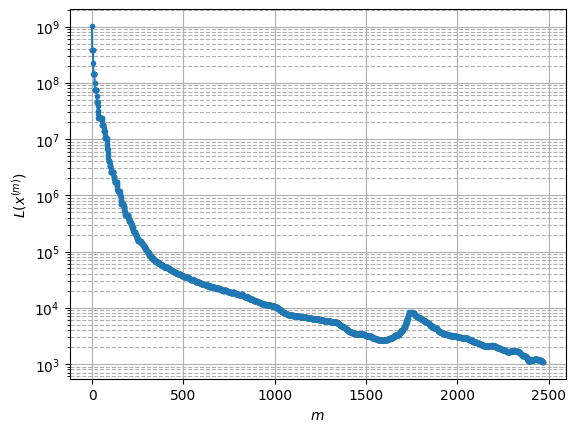

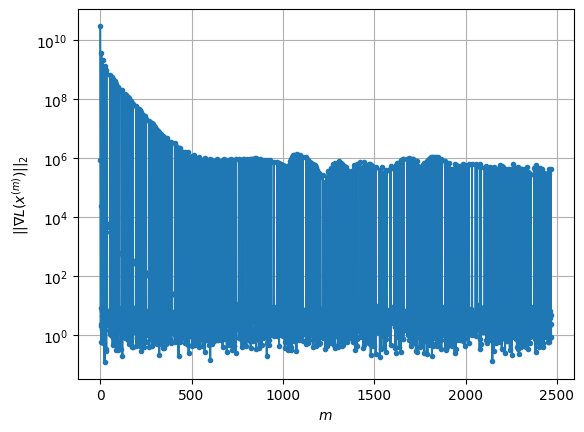

Windows:  85%|████████▌ | 252/296 [1:37:05<08:27, 11.53s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1068.9952898740003
Gradient norm: 294263.4965607609
Deviation from touching point norm = 0.0
Global relative error: 27.941224653977923
Position relative errors: 0.018737827829999977 m, 22.247925992326394 m, 9.846543987863438 m, 13.739737532801177 m

Iteration 1
Cost function: 1063.2493759089255 (-0.54%)
Gradient norm: 2.9924365195311045 (-100.00%)
Deviation from touching point norm = 0.2984559021041515 (298455902104.15%)
Global relative error = 27.952393701762094 (0.04%)
Position relative errors: 0.01707825493363158 m, 22.238826731428777 m, 9.860163175507275 m, 13.767394106963046 m

Iteration 2
Cost function: 1063.249375263014 (-0.00%)
Gradient norm: 2.06026623396595 (-31.15%)
Deviation from touching point norm = 0.298455913649377 (0.00%)
Global relative error = 27.952393706117746 (0.00%)
Position relative errors: 0.01707825166835797 m, 22.238826732140023 m, 9.860163177712327 m, 13.767394113082354 m

It

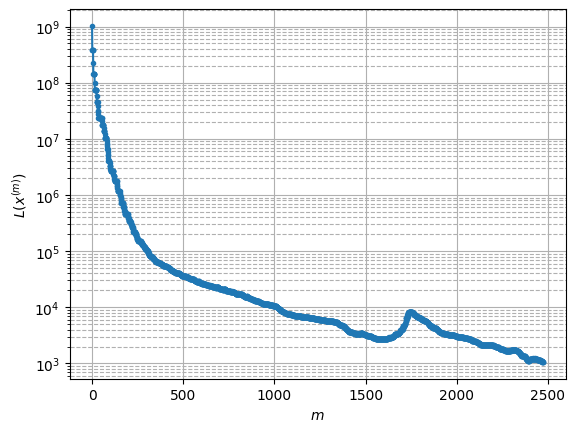

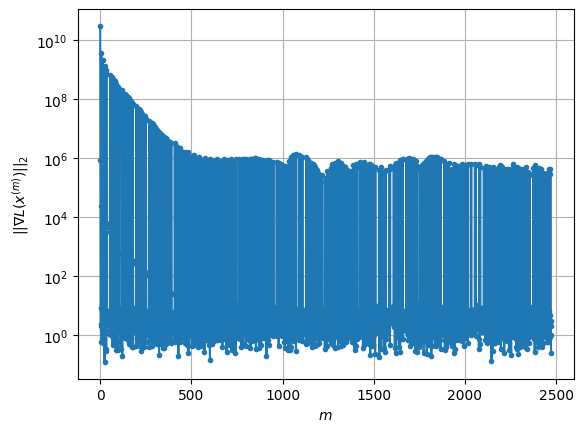

Windows:  85%|████████▌ | 253/296 [1:37:17<08:21, 11.65s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1031.201060499546
Gradient norm: 274186.234598125
Deviation from touching point norm = 0.0
Global relative error: 23.498129868722685
Position relative errors: 0.016861256681881456 m, 18.98839352518461 m, 9.450382340023308 m, 10.113658199381241 m

Iteration 1
Cost function: 1025.2579434379682 (-0.58%)
Gradient norm: 3.2047326887563687 (-100.00%)
Deviation from touching point norm = 0.3173508731037192 (317350873103.72%)
Global relative error = 23.52097435512109 (0.10%)
Position relative errors: 0.01991124994743859 m, 18.981813655458073 m, 9.461361493765331 m, 10.16869258840019 m

Iteration 2
Cost function: 1025.25794217095 (-0.00%)
Gradient norm: 4.010084630053895 (25.13%)
Deviation from touching point norm = 0.3173508678547765 (-0.00%)
Global relative error = 23.520974357197506 (0.00%)
Position relative errors: 0.01991124341037464 m, 18.98181365562391 m, 9.461361495105422 m, 10.168692591659422 m

Iterati

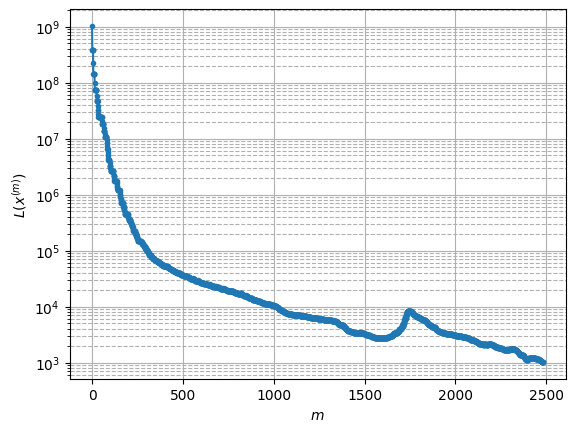

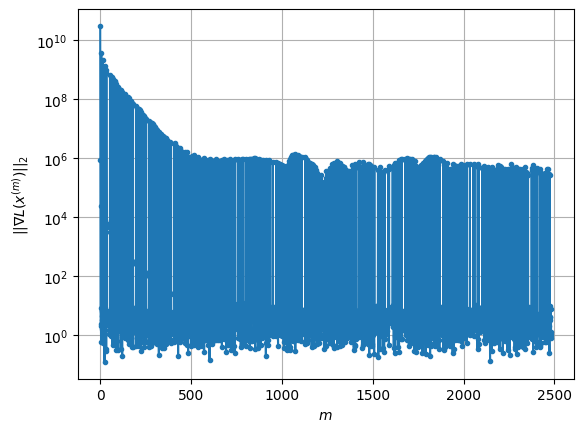

Windows:  86%|████████▌ | 254/296 [1:37:38<10:11, 14.55s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1001.1961119308902
Gradient norm: 235693.00213723734
Deviation from touching point norm = 0.0
Global relative error: 19.211835653937584
Position relative errors: 0.01948116434156385 m, 15.649797957692867 m, 9.01004117220319 m, 6.556682966771856 m

Iteration 1
Cost function: 995.5709490854167 (-0.56%)
Gradient norm: 6.997168266774541 (-100.00%)
Deviation from touching point norm = 0.31187828361438164 (311878283614.38%)
Global relative error = 19.24552458714559 (0.18%)
Position relative errors: 0.01494906462509707 m, 15.644021216170835 m, 9.016675114828667 m, 6.659356606464249 m

Iteration 2
Cost function: 995.5709517143297 (0.00%)
Gradient norm: 6.846514543530755 (-2.15%)
Deviation from touching point norm = 0.3118782865892329 (0.00%)
Global relative error = 19.245524589156496 (0.00%)
Position relative errors: 0.014949064441435879 m, 15.644021216397434 m, 9.016675115017144 m, 6.65935661148861 m

STOP on 

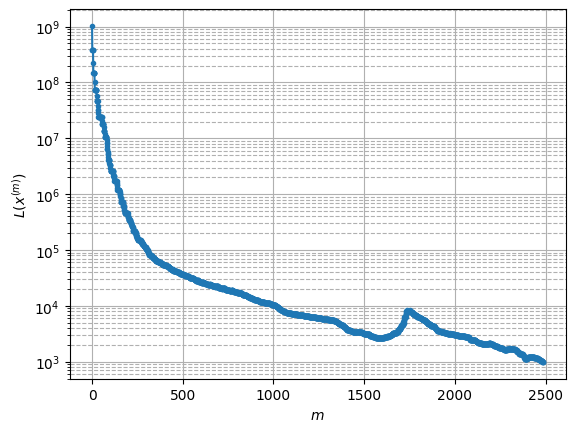

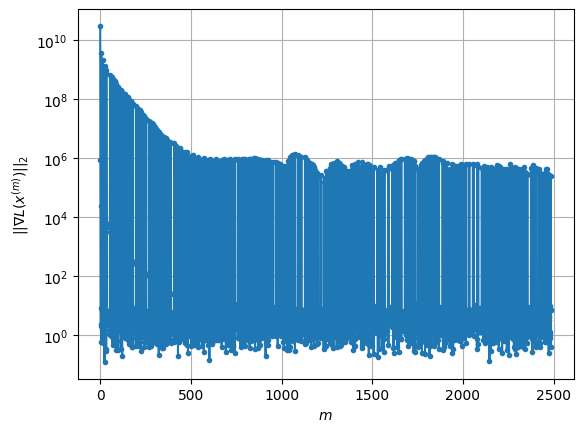

Windows:  86%|████████▌ | 255/296 [1:37:48<09:00, 13.18s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 979.0982076442282
Gradient norm: 361402.5622590369
Deviation from touching point norm = 0.0
Global relative error: 15.308241601304715
Position relative errors: 0.014695946749031125 m, 12.245239530270403 m, 8.526213624167482 m, 3.4194354385258428 m

Iteration 1
Cost function: 973.6554663814838 (-0.56%)
Gradient norm: 4.197377191179998 (-100.00%)
Deviation from touching point norm = 0.3005720387853306 (300572038785.33%)
Global relative error = 15.352799295469783 (0.29%)
Position relative errors: 0.006871461875140778 m, 12.245011350215126 m, 8.526615649422592 m, 3.613534614308948 m

Iteration 2
Cost function: 973.6554651714919 (-0.00%)
Gradient norm: 4.281167216905684 (2.00%)
Deviation from touching point norm = 0.30057204051063635 (0.00%)
Global relative error = 15.352799295782107 (0.00%)
Position relative errors: 0.006871455677394312 m, 12.245011351060587 m, 8.526615647318932 m, 3.6135346177465237 m

Ite

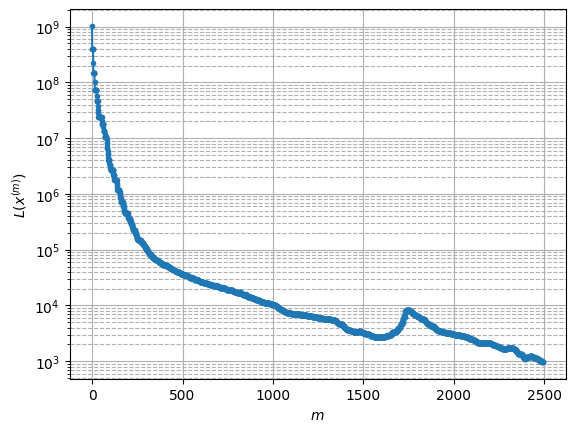

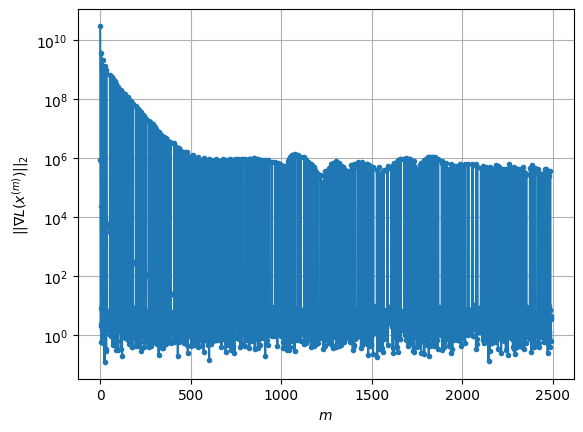

Windows:  86%|████████▋ | 256/296 [1:38:02<08:59, 13.50s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 956.643174183127
Gradient norm: 266716.8921577543
Deviation from touching point norm = 0.0
Global relative error: 12.2465777616435
Position relative errors: 0.0068892648236971105 m, 8.79554168656005 m, 7.999884002894236 m, 2.9345408720817208 m

Iteration 1
Cost function: 951.6054631902463 (-0.53%)
Gradient norm: 4.3777662560264705 (-100.00%)
Deviation from touching point norm = 0.29213692953264886 (292136929532.65%)
Global relative error = 12.30236650199897 (0.46%)
Position relative errors: 0.011417613109186014 m, 8.797367276188075 m, 7.99210075690628 m, 3.1738558379492736 m

Iteration 2
Cost function: 951.6054624277506 (-0.00%)
Gradient norm: 4.4686348033421215 (2.08%)
Deviation from touching point norm = 0.29213693780927946 (0.00%)
Global relative error = 12.30236650506414 (0.00%)
Position relative errors: 0.01141762335849796 m, 8.797367275864211 m, 7.992100759694076 m, 3.1738558436711037 m

Iteration

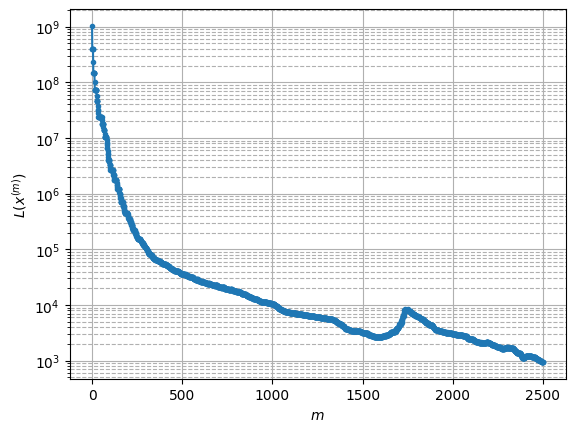

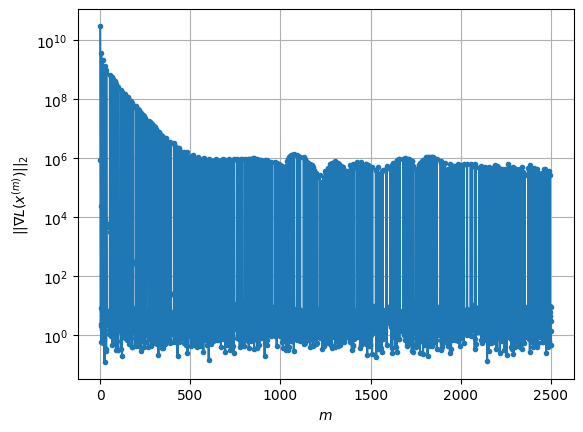

Windows:  87%|████████▋ | 257/296 [1:38:23<10:16, 15.81s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 950.6914983955111
Gradient norm: 284423.74649147765
Deviation from touching point norm = 0.0
Global relative error: 10.829983928351218
Position relative errors: 0.011824418881584886 m, 5.316288348037092 m, 7.431949980019688 m, 5.812416461354646 m

STOP on Iteration 1
Cost function = 946.7646231819364 (-0.41%)
Gradient norm = 0.4596162871246944 (-100.00%)
Deviation from touching point norm = 0.24830667137856421 (248306671378.56%)
Global relative error = 10.872658636161304 (0.39%)
Final position relative errors: 0.012729960014391856 m, 5.32511527517622 m, 7.41207231485986 m, 5.9085918255107766 m

Majorization-Minimization converged after 1 iterations


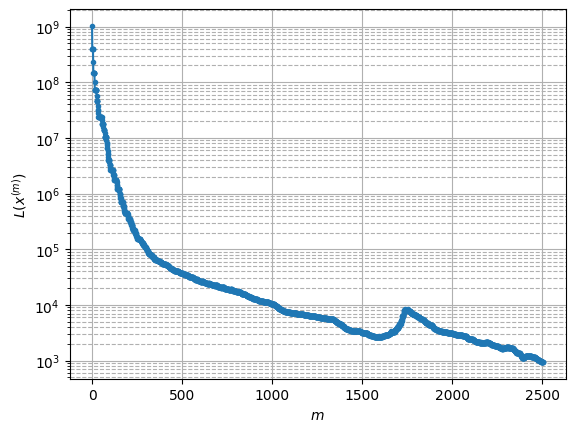

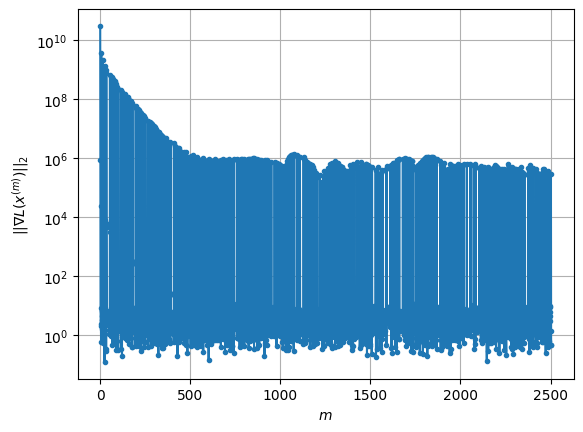

Windows:  87%|████████▋ | 258/296 [1:38:29<08:00, 12.63s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 943.1613006417978
Gradient norm: 467797.68121675996
Deviation from touching point norm = 0.0
Global relative error: 11.6751444926719
Position relative errors: 0.013180135576602067 m, 1.8694674156761695 m, 6.821354386120284 m, 9.288468482100827 m

Iteration 1
Cost function: 938.9963389079954 (-0.44%)
Gradient norm: 6.932739212591084 (-100.00%)
Deviation from touching point norm = 0.24395864925059554 (243958649250.60%)
Global relative error = 11.708050568136224 (0.28%)
Position relative errors: 0.013644181649729473 m, 1.895206513579449 m, 6.798654934160778 m, 9.341164675140266 m

Iteration 2
Cost function: 938.9963386563015 (-0.00%)
Gradient norm: 5.154636521000117 (-25.65%)
Deviation from touching point norm = 0.24395864131355 (-0.00%)
Global relative error = 11.70805056597698 (-0.00%)
Position relative errors: 0.013644187689603524 m, 1.8952065129921785 m, 6.798654935795529 m, 9.341164671354408 m

Iterat

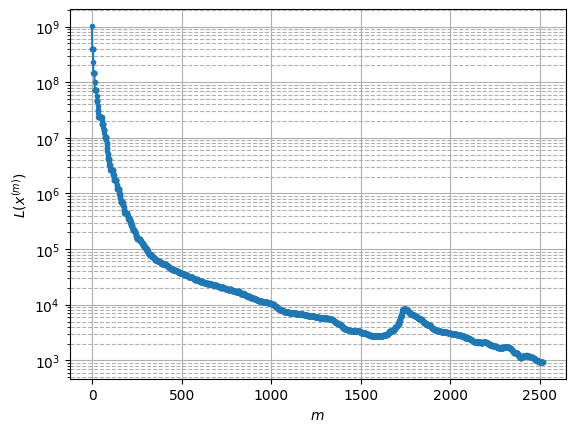

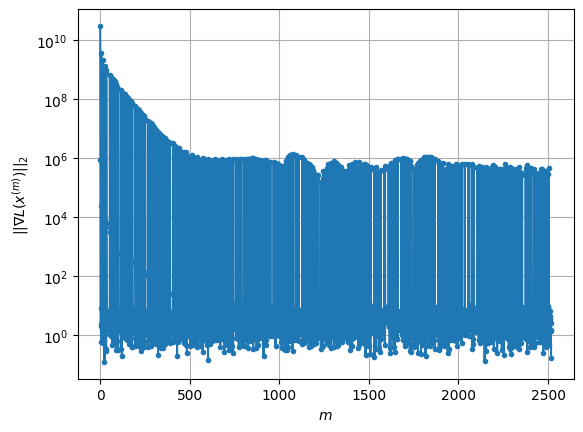

Windows:  88%|████████▊ | 259/296 [1:39:01<11:30, 18.66s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 956.1714476042384
Gradient norm: 315106.7428032186
Deviation from touching point norm = 0.0
Global relative error: 14.383357578557826
Position relative errors: 0.01442055812603685 m, 1.846207125656611 m, 6.180626207260295 m, 12.855537497162121 m

Iteration 1
Cost function: 952.135463608453 (-0.42%)
Gradient norm: 2.9524803096994314 (-100.00%)
Deviation from touching point norm = 0.20161603686528523 (201616036865.29%)
Global relative error = 14.388018483159087 (0.03%)
Position relative errors: 0.019314958061793803 m, 1.8768071730683575 m, 6.149898312832421 m, 12.871043202610641 m

Iteration 2
Cost function: 952.135461948891 (-0.00%)
Gradient norm: 1.3528772339577244 (-54.18%)
Deviation from touching point norm = 0.20161603701877218 (0.00%)
Global relative error = 14.38801848176487 (-0.00%)
Position relative errors: 0.019314956552666875 m, 1.8768071743111796 m, 6.1498983117594275 m, 12.871043201385813 m



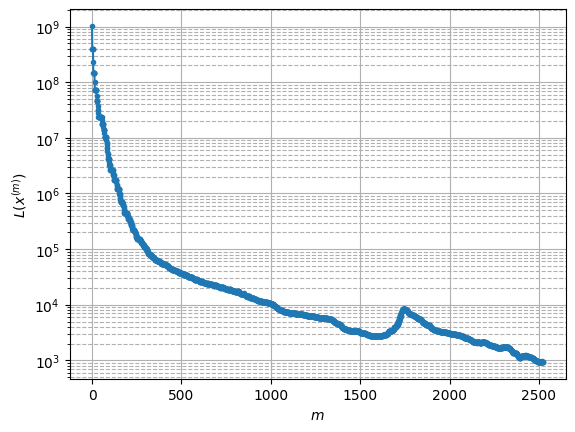

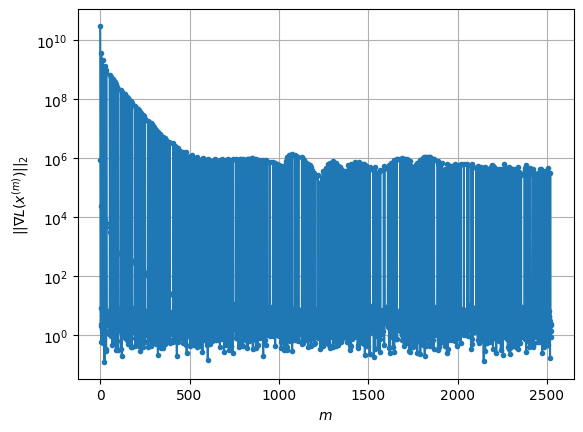

Windows:  88%|████████▊ | 260/296 [1:39:16<10:23, 17.32s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 961.4492343792136
Gradient norm: 249820.412116436
Deviation from touching point norm = 0.0
Global relative error: 18.08926102383732
Position relative errors: 0.02055710519822208 m, 5.2906573746630645 m, 5.508252066048647 m, 16.397618643292734 m

STOP on Iteration 1
Cost function = 958.3150535322626 (-0.33%)
Gradient norm = 0.4191952483151357 (-100.00%)
Deviation from touching point norm = 0.17459955609557706 (174599556095.58%)
Global relative error = 18.081425329753557 (-0.04%)
Final position relative errors: 0.021879477357471106 m, 5.2990929356423075 m, 5.477608038672908 m, 16.39651626026963 m

Majorization-Minimization converged after 1 iterations


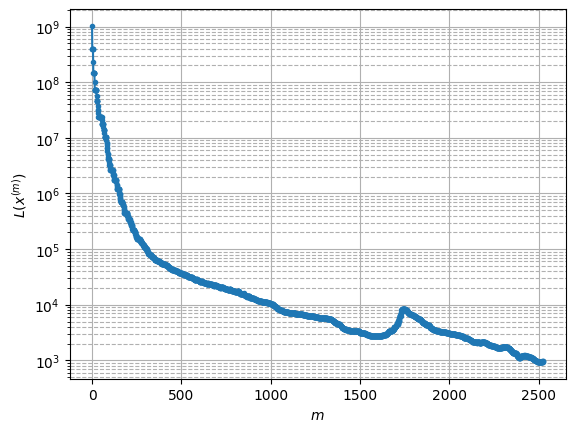

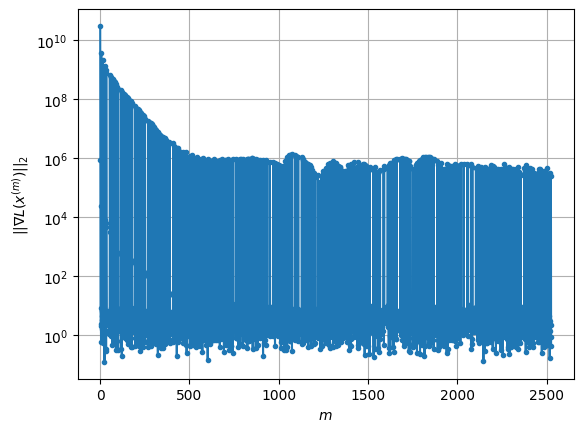

Windows:  88%|████████▊ | 261/296 [1:39:21<07:59, 13.69s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 970.2960662442312
Gradient norm: 293829.7152220803
Deviation from touching point norm = 0.0
Global relative error: 22.25660990226904
Position relative errors: 0.02302679925741037 m, 8.760643674224035 m, 4.816530698458374 m, 19.884701953679535 m

Iteration 1
Cost function: 967.4063841655396 (-0.30%)
Gradient norm: 1.8654725140715651 (-100.00%)
Deviation from touching point norm = 0.1484975205676719 (148497520567.67%)
Global relative error = 22.23378209299982 (-0.10%)
Position relative errors: 0.02999648411509135 m, 8.7646608367799 m, 4.777429958201767 m, 19.866809490674864 m

Iteration 2
Cost function: 967.4063854204356 (0.00%)
Gradient norm: 5.462140388445722 (192.80%)
Deviation from touching point norm = 0.14849751891776924 (-0.00%)
Global relative error = 22.23378209198511 (-0.00%)
Position relative errors: 0.029996482302779872 m, 8.764660836921788 m, 4.777429958176865 m, 19.866809489485373 m

Iterati

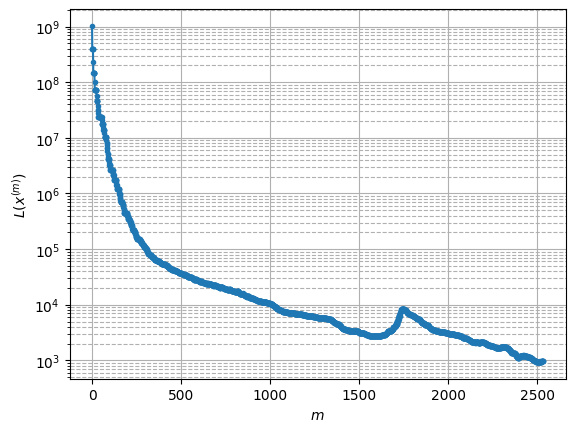

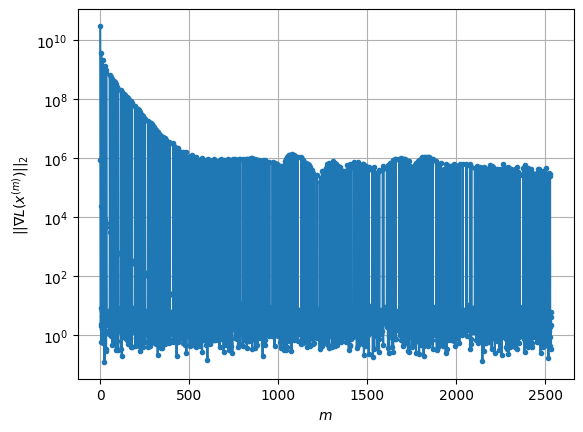

Windows:  89%|████████▊ | 262/296 [1:39:38<08:16, 14.59s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 993.4815199769547
Gradient norm: 282293.03597049584
Deviation from touching point norm = 0.0
Global relative error: 26.607692963161114
Position relative errors: 0.030861145992720707 m, 12.198236736486109 m, 4.101502737413888 m, 23.2882459127068 m

Iteration 1
Cost function: 990.5605449597199 (-0.29%)
Gradient norm: 4.8576628370507855 (-100.00%)
Deviation from touching point norm = 0.14067326712259556 (140673267122.60%)
Global relative error = 26.57679570378089 (-0.12%)
Position relative errors: 0.02262889534279906 m, 12.201900483904984 m, 4.062215865707922 m, 23.257921666209246 m

Iteration 2
Cost function: 990.5605452984399 (0.00%)
Gradient norm: 1.8291522808930554 (-62.35%)
Deviation from touching point norm = 0.14067326292661675 (-0.00%)
Global relative error = 26.576795703071383 (-0.00%)
Position relative errors: 0.022628896927444624 m, 12.201900483724438 m, 4.062215866929697 m, 23.25792166527827 m


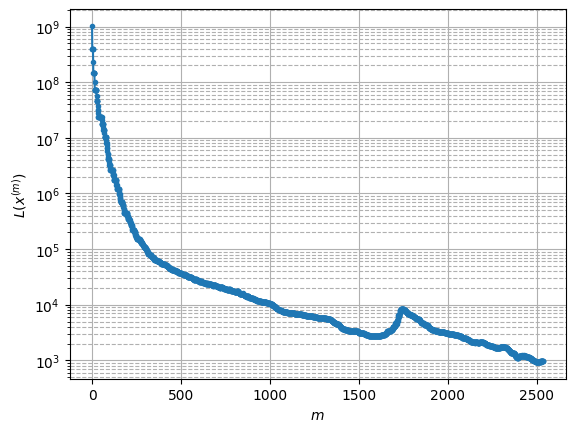

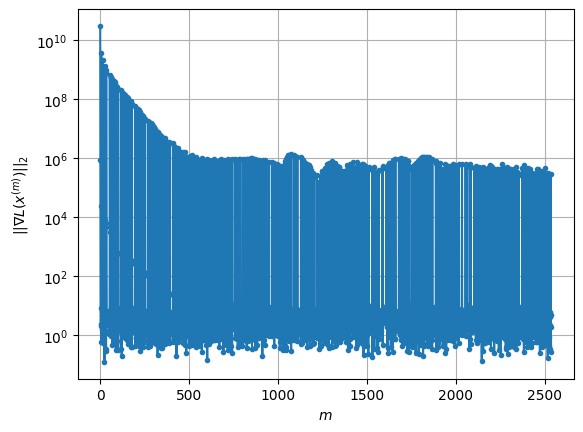

Windows:  89%|████████▉ | 263/296 [1:39:47<07:12, 13.11s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1005.9311773591872
Gradient norm: 421980.50599491136
Deviation from touching point norm = 0.0
Global relative error: 31.006049012953124
Position relative errors: 0.023506238538873916 m, 15.585085471801486 m, 3.37800393449059 m, 26.590644382370847 m

STOP on Iteration 1
Cost function = 1002.8578472573881 (-0.31%)
Gradient norm = 0.6059933720848762 (-100.00%)
Deviation from touching point norm = 0.13019331118238175 (130193311182.38%)
Global relative error = 30.969298082289704 (-0.12%)
Final position relative errors: 0.02661204202768931 m, 15.586491536338093 m, 3.3362355046393137 m, 26.552234956521858 m

Majorization-Minimization converged after 1 iterations


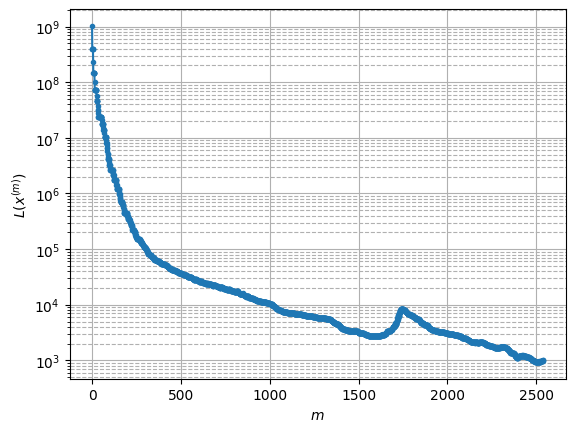

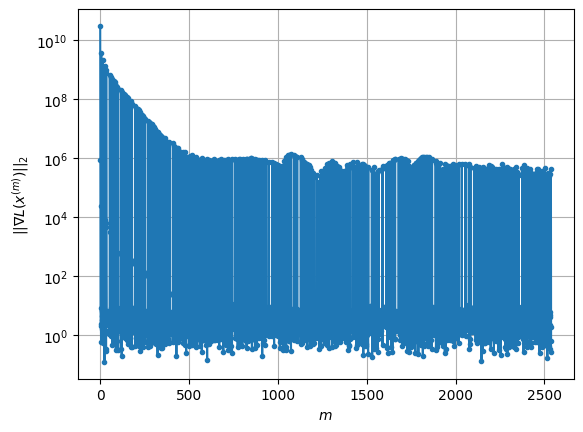

Windows:  89%|████████▉ | 264/296 [1:39:52<05:42, 10.70s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1017.1270257058794
Gradient norm: 400654.47447079915
Deviation from touching point norm = 0.0
Global relative error: 35.37053920001094
Position relative errors: 0.027135838462920506 m, 18.902814996817675 m, 2.6546285180317457 m, 29.777589654730672 m

Iteration 1
Cost function: 1013.8327822700744 (-0.32%)
Gradient norm: 5.145288164174692 (-100.00%)
Deviation from touching point norm = 0.14091973020923823 (140919730209.24%)
Global relative error = 35.3275052069773 (-0.12%)
Position relative errors: 0.03762167408193135 m, 18.901956639912914 m, 2.596615481294681 m, 29.732118051143686 m

Iteration 2
Cost function: 1013.8327827351507 (0.00%)
Gradient norm: 3.693494699348948 (-28.22%)
Deviation from touching point norm = 0.14091971965756817 (-0.00%)
Global relative error = 35.32750520838442 (0.00%)
Position relative errors: 0.0376216639440566 m, 18.901956639725586 m, 2.596615483132717 m, 29.732118052787 m

Ite

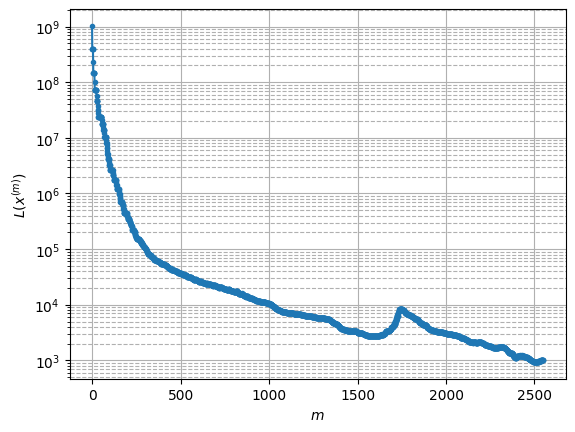

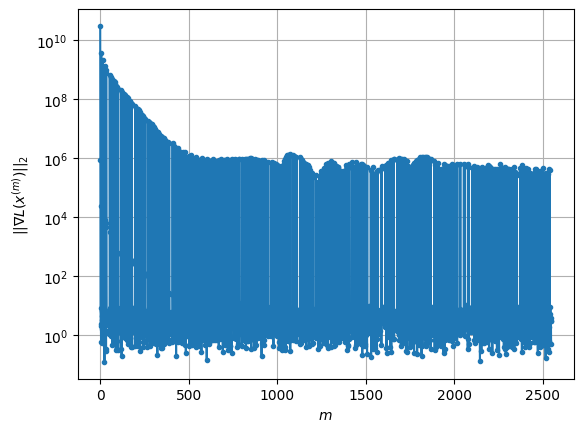

Windows:  90%|████████▉ | 265/296 [1:40:16<07:31, 14.55s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1049.5583104863626
Gradient norm: 416648.8776445883
Deviation from touching point norm = 0.0
Global relative error: 39.64624680324852
Position relative errors: 0.03749802675497505 m, 22.13630280459162 m, 1.9352828995549471 m, 32.83377320155896 m

STOP on Iteration 1
Cost function = 1044.6706497909474 (-0.47%)
Gradient norm = 0.4482613060110667 (-100.00%)
Deviation from touching point norm = 0.14320851493609962 (143208514936.10%)
Global relative error = 39.59815054718265 (-0.12%)
Final position relative errors: 0.029121833022685666 m, 22.133022619934582 m, 1.8541920338504374 m, 32.782592496099944 m

Majorization-Minimization converged after 1 iterations


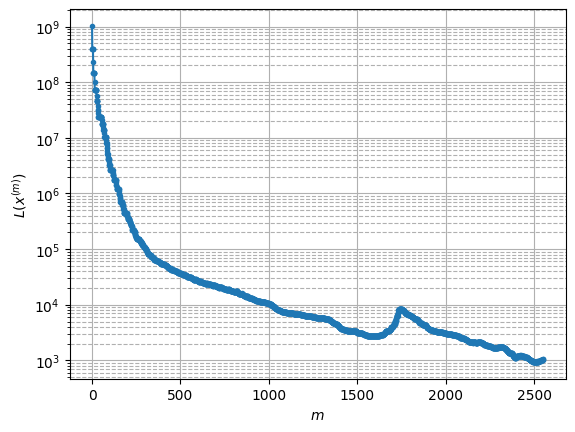

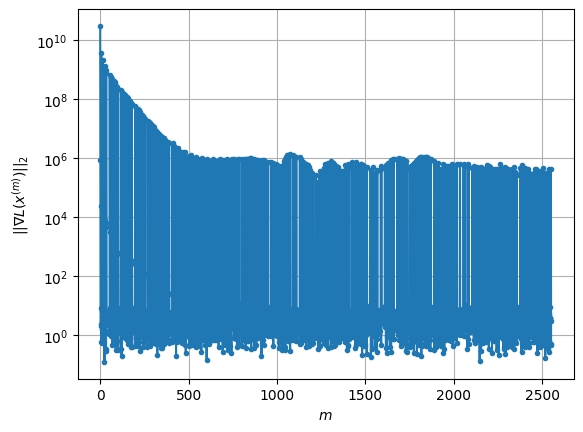

Windows:  90%|████████▉ | 266/296 [1:40:21<05:52, 11.74s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1057.47175601593
Gradient norm: 399325.7053170089
Deviation from touching point norm = 0.0
Global relative error: 43.79453300649742
Position relative errors: 0.029482345956906547 m, 25.27156490202225 m, 1.2612715457122958 m, 35.74510160469689 m

STOP on Iteration 1
Cost function = 1052.6007771409083 (-0.46%)
Gradient norm = 0.29250607206965795 (-100.00%)
Deviation from touching point norm = 0.1874435600254304 (187443560025.43%)
Global relative error = 43.7425790594838 (-0.12%)
Final position relative errors: 0.026173793107884587 m, 25.268310407416006 m, 1.1564024019377364 m, 35.68728906796881 m

Majorization-Minimization converged after 1 iterations


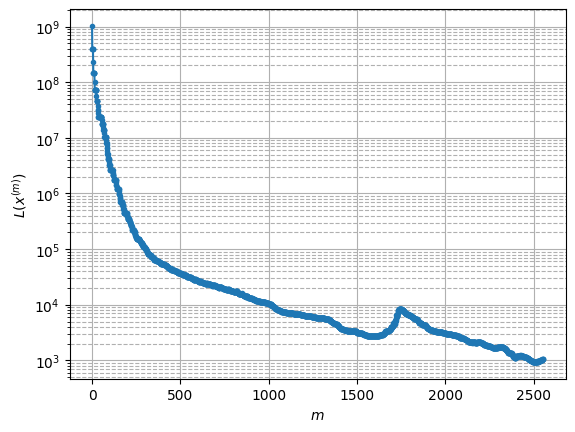

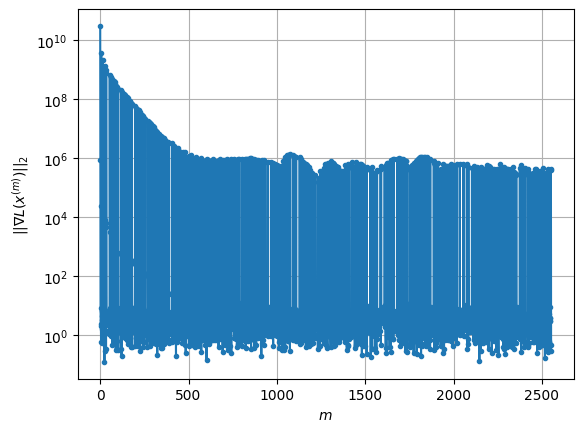

Windows:  90%|█████████ | 267/296 [1:40:26<04:43,  9.78s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1068.1065382311974
Gradient norm: 356222.7789743288
Deviation from touching point norm = 0.0
Global relative error: 47.785134583263975
Position relative errors: 0.02660552197904587 m, 28.296690999424438 m, 0.8195922054601112 m, 38.49726244815935 m

Iteration 1
Cost function: 1063.6178504018344 (-0.42%)
Gradient norm: 2.6617672174286953 (-100.00%)
Deviation from touching point norm = 0.18017145819550326 (180171458195.50%)
Global relative error = 47.7333403700006 (-0.11%)
Position relative errors: 0.024996898190789478 m, 28.290164266065194 m, 0.7007567133903284 m, 38.4401092403827 m

Iteration 2
Cost function: 1063.6178513229179 (0.00%)
Gradient norm: 2.412461296076695 (-9.37%)
Deviation from touching point norm = 0.18017145059698222 (-0.00%)
Global relative error = 47.733340373053785 (0.00%)
Position relative errors: 0.02499689808490643 m, 28.290164266936603 m, 0.7007567164968261 m, 38.44010924347614 m



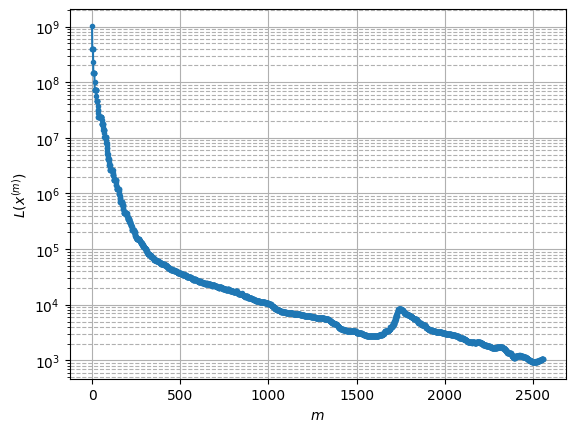

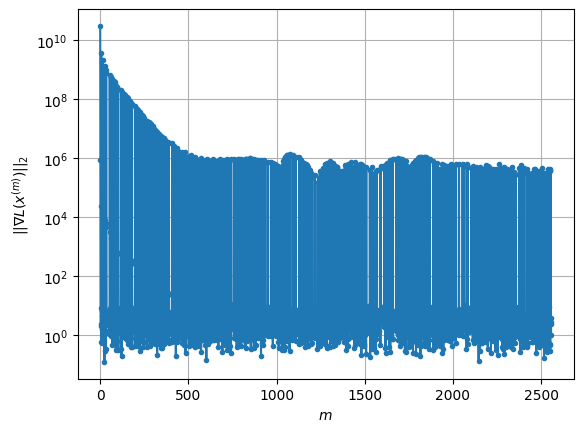

Windows:  91%|█████████ | 268/296 [1:40:38<04:52, 10.44s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1074.2007490739068
Gradient norm: 397457.17070158245
Deviation from touching point norm = 0.0
Global relative error: 51.595252130377304
Position relative errors: 0.025442930691186545 m, 31.195188588846005 m, 1.0109340043506188 m, 41.08410126000479 m

Iteration 1
Cost function: 1069.5767423537934 (-0.43%)
Gradient norm: 10.587129773501117 (-100.00%)
Deviation from touching point norm = 0.18760165757375802 (187601657573.76%)
Global relative error = 51.542934381736615 (-0.10%)
Position relative errors: 0.02481844278268714 m, 31.187152149534985 m, 0.9642918484164111 m, 41.025612916743924 m

Iteration 2
Cost function: 1069.576743846974 (0.00%)
Gradient norm: 4.498091425689419 (-57.51%)
Deviation from touching point norm = 0.18760165220511885 (-0.00%)
Global relative error = 51.5429343848336 (0.00%)
Position relative errors: 0.024818448213252315 m, 31.18715215010926 m, 0.9642918495544077 m, 41.025612920168264

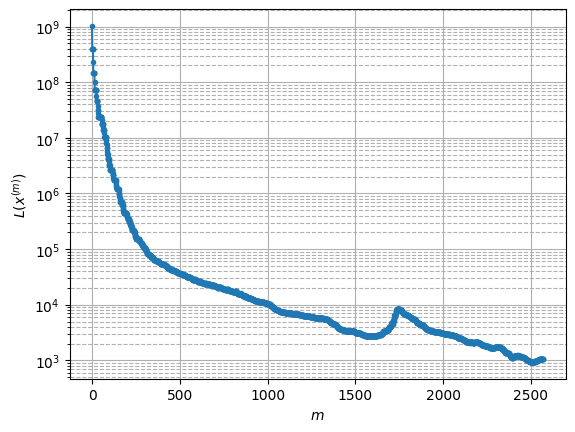

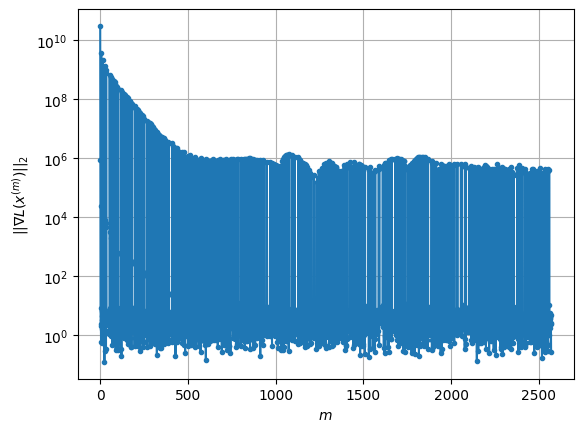

Windows:  91%|█████████ | 269/296 [1:41:06<07:01, 15.60s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1071.4488401240876
Gradient norm: 386347.8199895876
Deviation from touching point norm = 0.0
Global relative error: 55.201294021644856
Position relative errors: 0.024731161563589756 m, 33.956021586693346 m, 1.6274161378498395 m, 43.491592325028364 m

Iteration 1
Cost function: 1066.3400367765114 (-0.48%)
Gradient norm: 1.0654412683109988 (-100.00%)
Deviation from touching point norm = 0.22053955183244686 (220539551832.45%)
Global relative error = 55.14826044321208 (-0.10%)
Position relative errors: 0.023362016912360492 m, 33.9466689284821 m, 1.623476956219994 m, 43.43172017922218 m

Iteration 2
Cost function: 1066.3400376027391 (0.00%)
Gradient norm: 2.1445417486224585 (101.28%)
Deviation from touching point norm = 0.2205395367540019 (-0.00%)
Global relative error = 55.14826044579444 (0.00%)
Position relative errors: 0.023362013104597425 m, 33.946668928345154 m, 1.6234769586344668 m, 43.431720182520024 

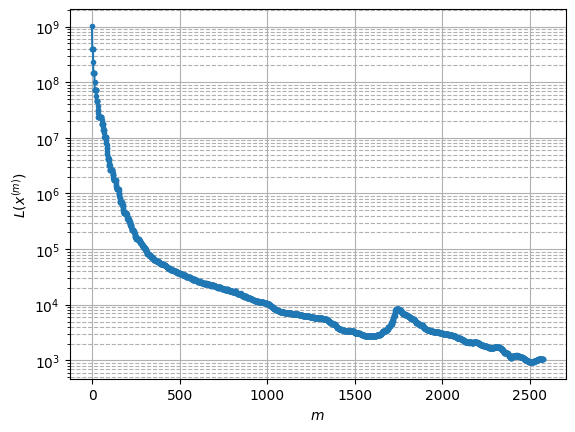

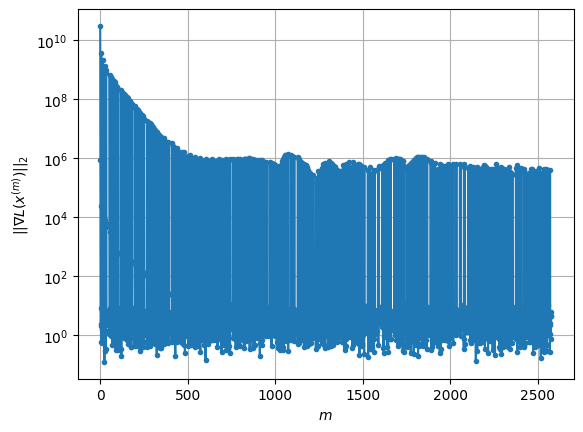

Windows:  91%|█████████ | 270/296 [1:41:22<06:53, 15.92s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1064.4462811972485
Gradient norm: 355431.51541618997
Deviation from touching point norm = 0.0
Global relative error: 58.582997933682094
Position relative errors: 0.02314682656246117 m, 36.56723672692931 m, 2.3483486579023367 m, 45.70871125051444 m

Iteration 1
Cost function: 1059.4658182987462 (-0.47%)
Gradient norm: 1.3111546286957851 (-100.00%)
Deviation from touching point norm = 0.22860246209147858 (228602462091.48%)
Global relative error = 58.53074482055282 (-0.09%)
Position relative errors: 0.021819367999827262 m, 36.556161230511115 m, 2.35433244746953 m, 45.65028508099377 m

Iteration 2
Cost function: 1059.465820711238 (0.00%)
Gradient norm: 3.2841855302288514 (150.48%)
Deviation from touching point norm = 0.22860245301380394 (-0.00%)
Global relative error = 58.530744823263554 (0.00%)
Position relative errors: 0.02181936579583916 m, 36.55616123110789 m, 2.3543324494929823 m, 45.65028508388815 m



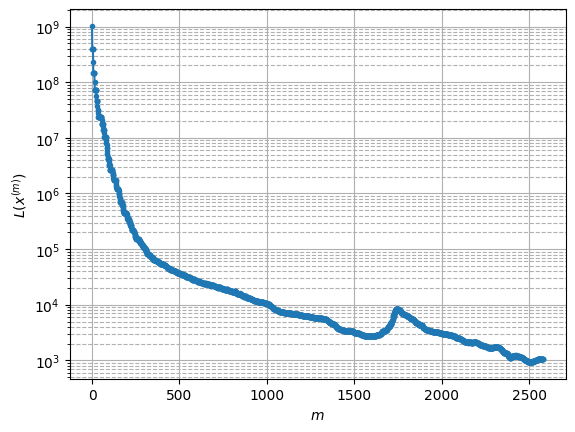

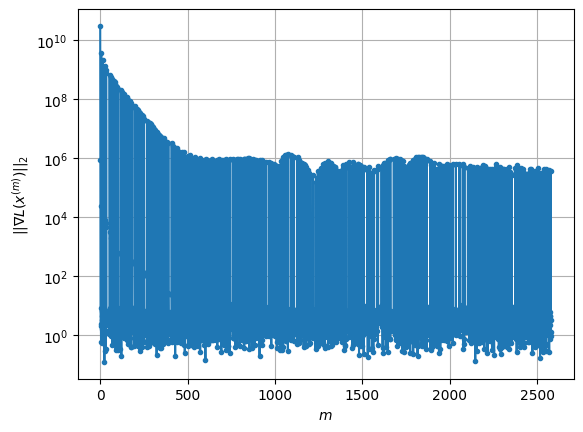

Windows:  92%|█████████▏| 271/296 [1:41:32<05:52, 14.08s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1056.8250669214028
Gradient norm: 350184.16113227804
Deviation from touching point norm = 0.0
Global relative error: 61.72382213822433
Position relative errors: 0.02174009613978499 m, 39.01712943199945 m, 3.0874418384070563 m, 47.72796084510652 m

Iteration 1
Cost function: 1052.166972040344 (-0.44%)
Gradient norm: 2.73218430889626 (-100.00%)
Deviation from touching point norm = 0.24163804036638684 (241638040366.39%)
Global relative error = 61.673071382764334 (-0.08%)
Position relative errors: 0.02188794012075692 m, 39.00434368508066 m, 3.101696671652102 m, 47.671848037162455 m

Iteration 2
Cost function: 1052.1669721274238 (0.00%)
Gradient norm: 2.7114257151486374 (-0.76%)
Deviation from touching point norm = 0.241638041855029 (0.00%)
Global relative error = 61.67307138541447 (0.00%)
Position relative errors: 0.021887940531071744 m, 39.00434368506117 m, 3.101696672798897 m, 47.67184804053207 m

Iterati

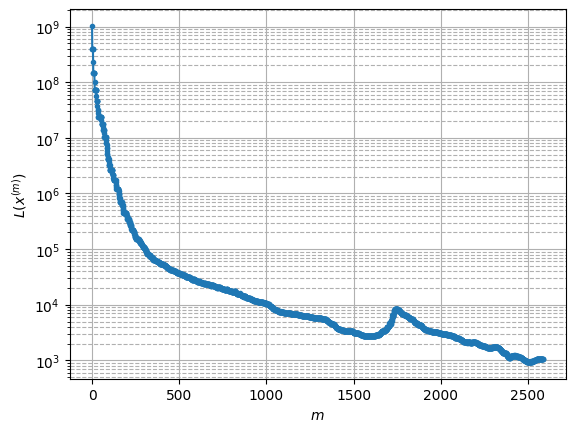

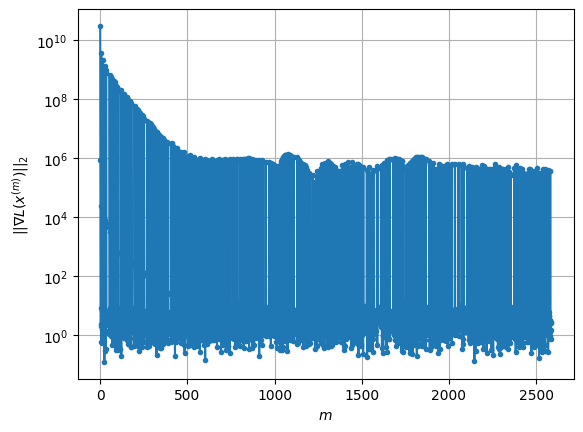

Windows:  92%|█████████▏| 272/296 [1:41:47<05:41, 14.22s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1045.8188494027704
Gradient norm: 380938.6786438129
Deviation from touching point norm = 0.0
Global relative error: 64.60831507407406
Position relative errors: 0.021605481796502353 m, 41.294965151977 m, 3.8271783164609317 m, 49.540994218121824 m

Iteration 1
Cost function: 1041.1726154566954 (-0.44%)
Gradient norm: 3.81889656307732 (-100.00%)
Deviation from touching point norm = 0.24295439107936082 (242954391079.36%)
Global relative error = 64.5590132927141 (-0.08%)
Position relative errors: 0.021000848985465514 m, 41.28245630965989 m, 3.846711901008325 m, 49.485604033026476 m

STOP on Iteration 2
Cost function = 1041.1726157454586 (0.00%)
Gradient norm = 0.4015987278388907 (-89.48%)
Deviation from touching point norm = 0.24295439309852176 (0.00%)
Global relative error = 64.5590132957333 (0.00%)
Final position relative errors: 0.021000851575141345 m, 41.28245630951752 m, 3.8467119023766685 m, 49.4856040

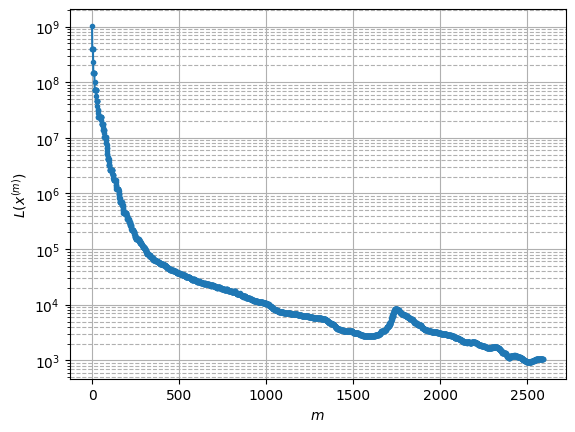

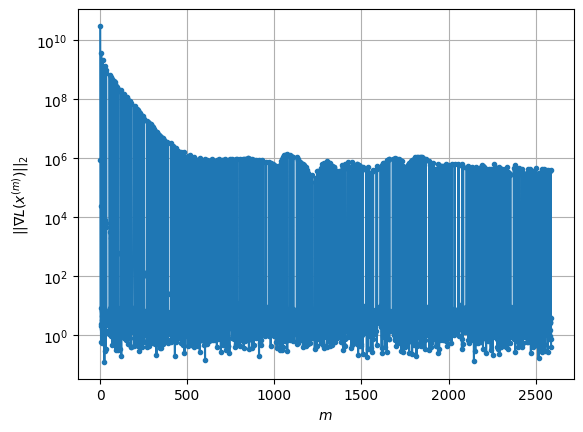

Windows:  92%|█████████▏| 273/296 [1:41:55<04:41, 12.26s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1044.1018258303911
Gradient norm: 466788.1658933091
Deviation from touching point norm = 0.0
Global relative error: 67.22198833863597
Position relative errors: 0.02041996547001093 m, 43.39267195174149 m, 4.557519073002762 m, 51.13803288771827 m

Iteration 1
Cost function: 1039.8368770986306 (-0.41%)
Gradient norm: 6.588638516109604 (-100.00%)
Deviation from touching point norm = 0.2227985285866081 (222798528586.61%)
Global relative error = 67.17427115063785 (-0.07%)
Position relative errors: 0.017018211774050794 m, 43.379079377996256 m, 4.5795115176291 m, 51.08487086464477 m

Iteration 2
Cost function: 1039.836876551205 (-0.00%)
Gradient norm: 5.350358259357229 (-18.79%)
Deviation from touching point norm = 0.2227985439592657 (0.00%)
Global relative error = 67.17427115361217 (0.00%)
Position relative errors: 0.017018207995760745 m, 43.37907937882661 m, 4.57951151954124 m, 51.0848708676806 m

Iteration 3

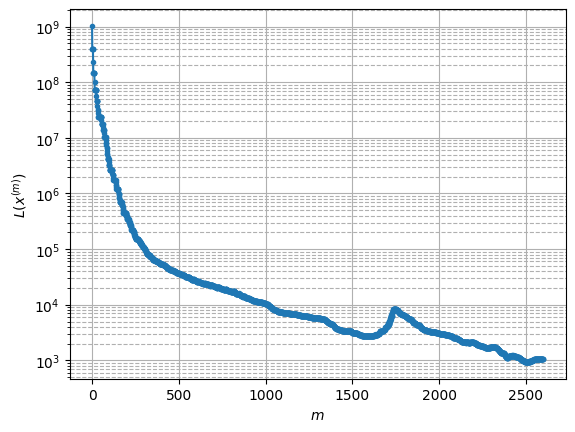

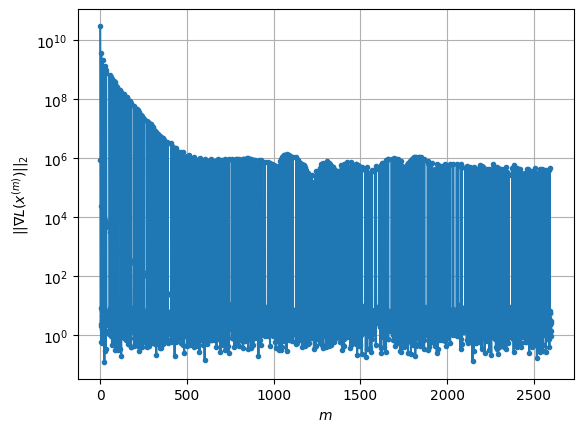

Windows:  93%|█████████▎| 274/296 [1:42:18<05:41, 15.50s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1030.7895865425153
Gradient norm: 429932.4586524138
Deviation from touching point norm = 0.0
Global relative error: 69.55212610749898
Position relative errors: 0.016767309971212473 m, 45.2996614254362 m, 5.271125842925218 m, 52.51335388684044 m

Iteration 1
Cost function: 1025.6882525472945 (-0.49%)
Gradient norm: 1.0300743375619017 (-100.00%)
Deviation from touching point norm = 0.255829618544349 (255829618544.35%)
Global relative error = 69.50519125542034 (-0.07%)
Position relative errors: 0.023526736740191703 m, 45.28597500426718 m, 5.294486161559935 m, 52.46063675096611 m

Iteration 2
Cost function: 1025.6882529992117 (0.00%)
Gradient norm: 1.2593538612583437 (22.26%)
Deviation from touching point norm = 0.2558296172845353 (-0.00%)
Global relative error = 69.50519125796195 (0.00%)
Position relative errors: 0.02352673476778532 m, 45.28597500403182 m, 5.294486162748731 m, 52.460636754417585 m

STOP on

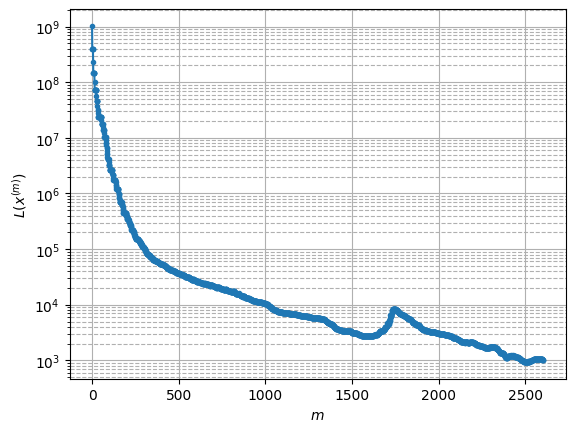

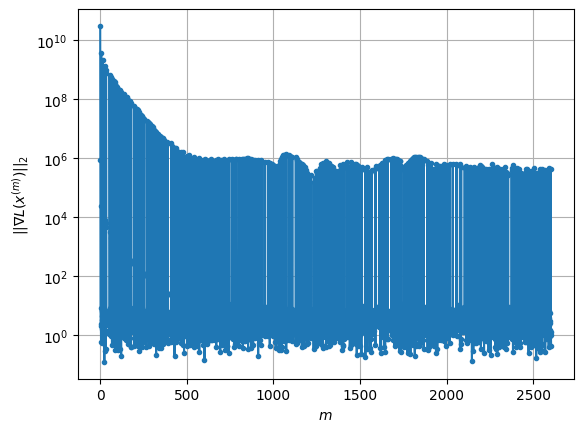

Windows:  93%|█████████▎| 275/296 [1:42:28<04:50, 13.84s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1004.4266446842718
Gradient norm: 440134.29834235535
Deviation from touching point norm = 0.0
Global relative error: 71.5867596661515
Position relative errors: 0.023327495613369015 m, 47.00848536622078 m, 5.963223705541696 m, 53.659153038266425 m

Iteration 1
Cost function: 999.1581398500485 (-0.52%)
Gradient norm: 1.0499304330410733 (-100.00%)
Deviation from touching point norm = 0.2793150201232155 (279315020123.22%)
Global relative error = 71.54207253650009 (-0.06%)
Position relative errors: 0.020031590683054507 m, 46.993855351801244 m, 5.9863752698591846 m, 53.609769968545564 m

STOP on Iteration 2
Cost function = 999.1581391554118 (-0.00%)
Gradient norm = 0.8691546925235947 (-17.22%)
Deviation from touching point norm = 0.27931502261635466 (0.00%)
Global relative error = 71.54207253830651 (0.00%)
Final position relative errors: 0.020031590625101917 m, 46.993855351455956 m, 5.986375270698247 m, 53.60

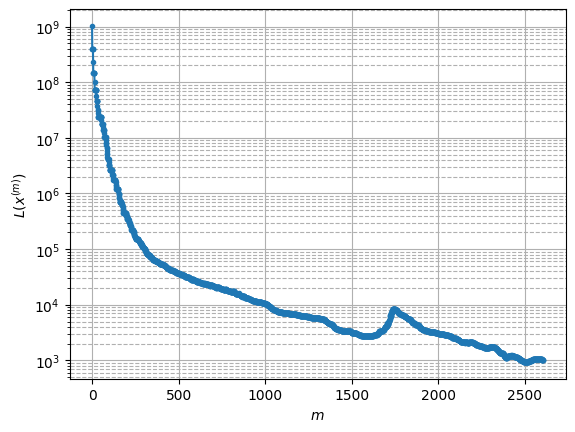

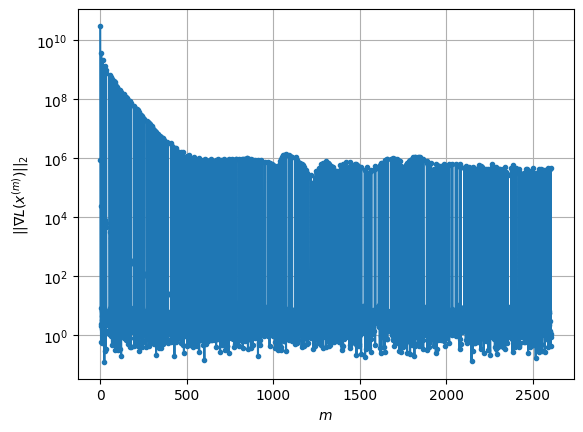

Windows:  93%|█████████▎| 276/296 [1:42:35<03:59, 11.98s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 971.8715177219917
Gradient norm: 317610.77813186357
Deviation from touching point norm = 0.0
Global relative error: 73.31763321500465
Position relative errors: 0.019931495523770035 m, 48.5107222964258 m, 6.629079492973589 m, 54.57324625674841 m

Iteration 1
Cost function: 965.9622080275475 (-0.61%)
Gradient norm: 3.7526158114892163 (-100.00%)
Deviation from touching point norm = 0.3148774924843174 (314877492484.32%)
Global relative error = 73.27519639860013 (-0.06%)
Position relative errors: 0.02268198325555109 m, 48.49551763751886 m, 6.651605830987819 m, 54.527001929607486 m

Iteration 2
Cost function: 965.9622084427087 (0.00%)
Gradient norm: 7.1228925151683375 (89.81%)
Deviation from touching point norm = 0.31487749688973965 (0.00%)
Global relative error = 73.2751964008103 (0.00%)
Position relative errors: 0.022681981837224384 m, 48.49551763750865 m, 6.6516058318138445 m, 54.5270019324865 m

Iteration

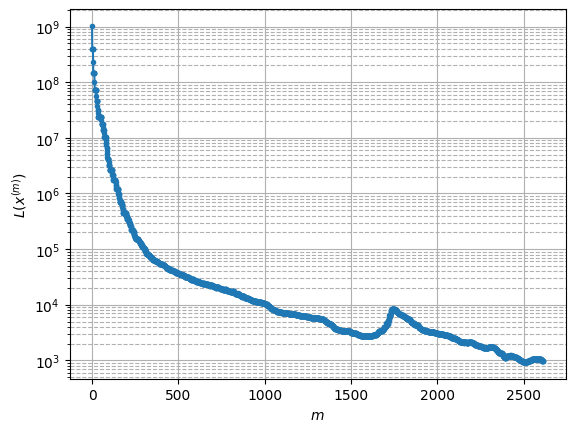

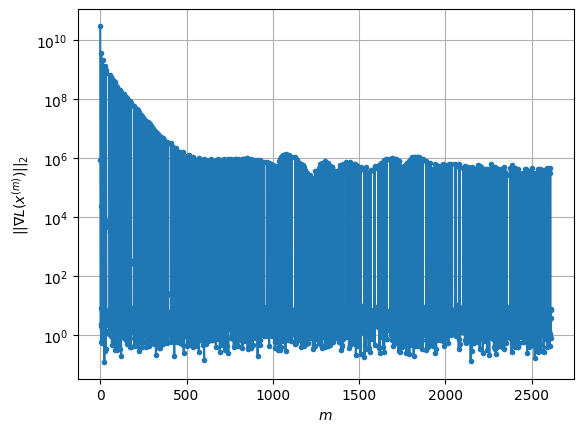

Windows:  94%|█████████▎| 277/296 [1:42:50<04:01, 12.70s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 950.9475119736652
Gradient norm: 370234.90692311095
Deviation from touching point norm = 0.0
Global relative error: 74.736562456958
Position relative errors: 0.02234885852781909 m, 49.80009741235456 m, 7.265284227772483 m, 55.251412757826714 m

Iteration 1
Cost function: 945.0819875457162 (-0.62%)
Gradient norm: 2.664835082668178 (-100.00%)
Deviation from touching point norm = 0.3133176388674553 (313317638867.46%)
Global relative error = 74.69691100596138 (-0.05%)
Position relative errors: 0.030510169318151304 m, 49.78372768840633 m, 7.2868506468239955 m, 55.209684379266896 m

Iteration 2
Cost function: 945.0819870063167 (-0.00%)
Gradient norm: 3.5056109702400824 (31.55%)
Deviation from touching point norm = 0.31331764009178453 (0.00%)
Global relative error = 74.69691100796987 (0.00%)
Position relative errors: 0.03051016163621722 m, 49.78372768865061 m, 7.286850647739725 m, 55.20968438164744 m

Iteratio

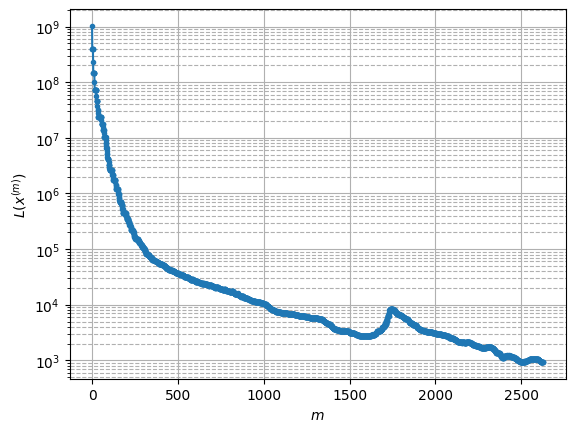

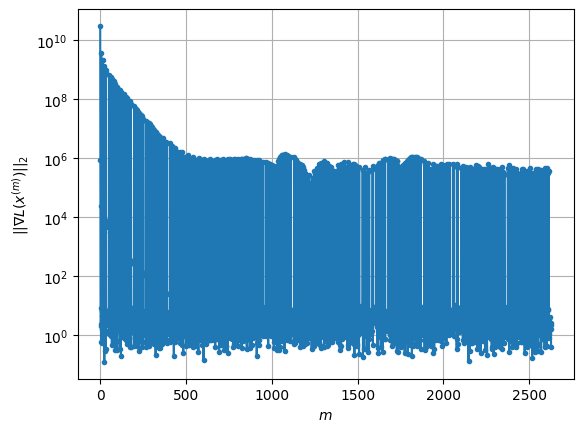

Windows:  94%|█████████▍| 278/296 [1:43:24<05:48, 19.36s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 937.5665477975762
Gradient norm: 295644.0160053997
Deviation from touching point norm = 0.0
Global relative error: 75.83736997301907
Position relative errors: 0.029963649026541705 m, 50.87032849354554 m, 7.868406061616825 m, 55.69203948010006 m

Iteration 1
Cost function: 933.7205285767578 (-0.41%)
Gradient norm: 3.6848132900122894 (-100.00%)
Deviation from touching point norm = 0.252393343293427 (252393343293.43%)
Global relative error = 75.79967339766444 (-0.05%)
Position relative errors: 0.023946369404516197 m, 50.85453330272104 m, 7.888950997689631 m, 55.6522274370521 m

Iteration 2
Cost function: 933.7205293095693 (0.00%)
Gradient norm: 2.8743675087388847 (-21.99%)
Deviation from touching point norm = 0.2523933467582578 (0.00%)
Global relative error = 75.79967339893997 (0.00%)
Position relative errors: 0.02394636844480191 m, 50.85453330256408 m, 7.888950997707353 m, 55.65222743893075 m

STOP on Ite

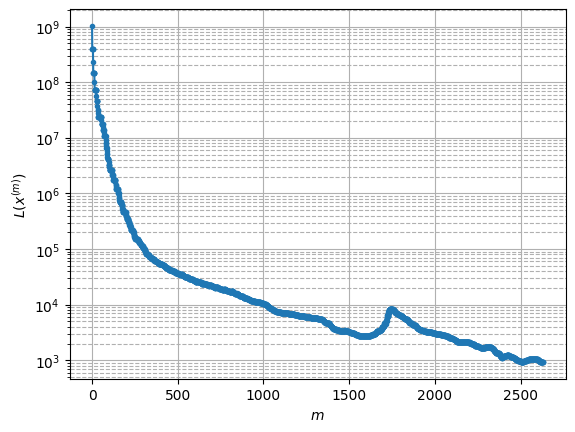

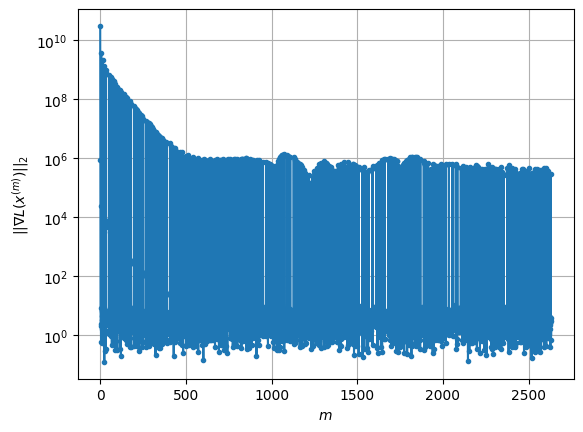

Windows:  94%|█████████▍| 279/296 [1:43:34<04:39, 16.46s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 930.6797096392845
Gradient norm: 280103.977014339
Deviation from touching point norm = 0.0
Global relative error: 76.61414431628808
Position relative errors: 0.023636934967327963 m, 51.71838983032258 m, 8.435668349124857 m, 55.89073236771574 m

Iteration 1
Cost function: 927.153741667406 (-0.38%)
Gradient norm: 2.5890639018312256 (-100.00%)
Deviation from touching point norm = 0.22637181250521035 (226371812505.21%)
Global relative error = 76.5779723291858 (-0.05%)
Position relative errors: 0.019001025315771764 m, 51.70223209808689 m, 8.453851928911536 m, 55.85335110837464 m

Iteration 2
Cost function: 927.1537420134082 (0.00%)
Gradient norm: 1.6105373033591748 (-37.79%)
Deviation from touching point norm = 0.22637180719628064 (-0.00%)
Global relative error = 76.57797233050192 (0.00%)
Position relative errors: 0.01900102497501136 m, 51.7022320982035 m, 8.453851928564621 m, 55.853351110123796 m

Iteration

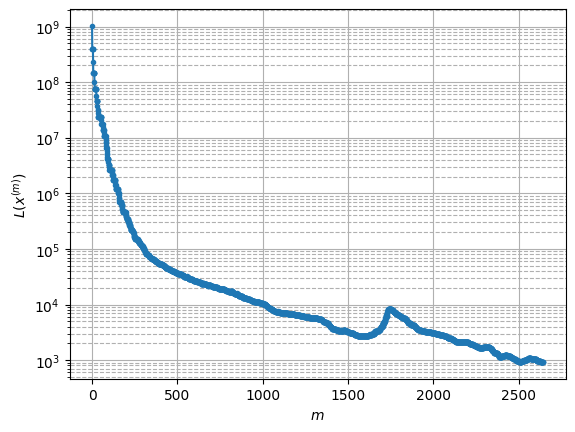

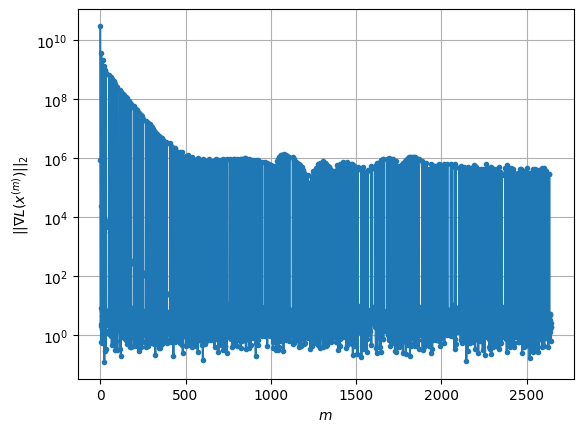

Windows:  95%|█████████▍| 280/296 [1:44:02<05:17, 19.87s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 915.6594030173777
Gradient norm: 254593.64490649005
Deviation from touching point norm = 0.0
Global relative error: 77.06292428993183
Position relative errors: 0.01864770728803889 m, 52.33959856656028 m, 8.96334068914097 m, 55.847280595706124 m

Iteration 1
Cost function: 911.9380275419239 (-0.41%)
Gradient norm: 2.495107051485638 (-100.00%)
Deviation from touching point norm = 0.2430447544769472 (243044754476.95%)
Global relative error = 77.02868739074889 (-0.04%)
Position relative errors: 0.019518316791178963 m, 52.32375780239935 m, 8.980692215156848 m, 55.81209267831908 m

STOP on Iteration 2
Cost function = 911.9380276510976 (0.00%)
Gradient norm = 0.8372632442475344 (-66.44%)
Deviation from touching point norm = 0.2430447442287446 (-0.00%)
Global relative error = 77.02868739235335 (0.00%)
Final position relative errors: 0.01951831994446007 m, 52.323757802914244 m, 8.980692215496548 m, 55.8120926799

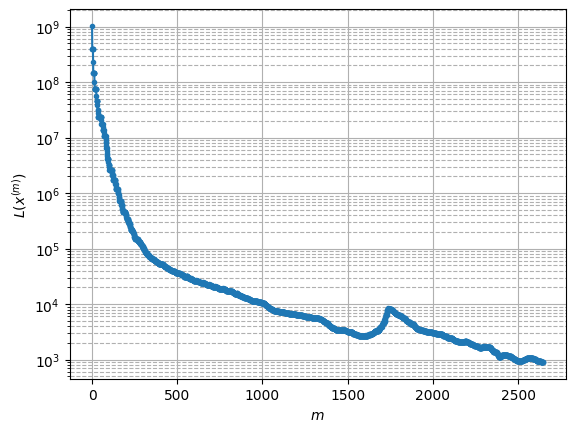

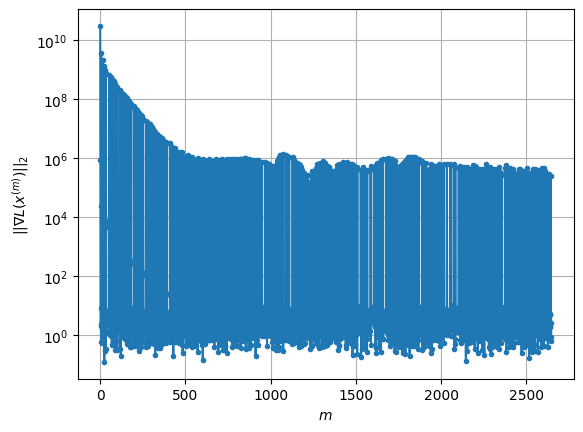

Windows:  95%|█████████▍| 281/296 [1:44:10<04:02, 16.18s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 920.7965635393225
Gradient norm: 336579.8954742209
Deviation from touching point norm = 0.0
Global relative error: 77.1820917894351
Position relative errors: 0.019346181104773694 m, 52.73186647012161 m, 9.45037185494421 m, 55.561817195364824 m

Iteration 1
Cost function: 917.6167143676245 (-0.35%)
Gradient norm: 2.035892451905513 (-100.00%)
Deviation from touching point norm = 0.19549945816515973 (195499458165.16%)
Global relative error = 77.1489050801423 (-0.04%)
Position relative errors: 0.01952873760356472 m, 52.716179614285586 m, 9.464627374326863 m, 55.52817564522561 m

Iteration 2
Cost function: 917.6167129619416 (-0.00%)
Gradient norm: 3.9335215675434045 (93.21%)
Deviation from touching point norm = 0.19549945032875926 (-0.00%)
Global relative error = 77.1489050821898 (0.00%)
Position relative errors: 0.019528738257764924 m, 52.716179614847455 m, 9.464627375172746 m, 55.52817564739254 m

Iteratio

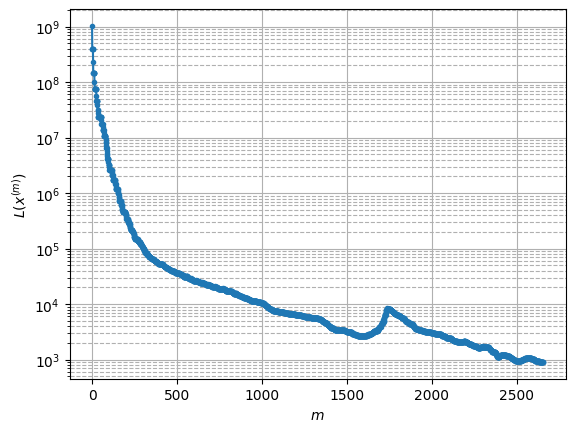

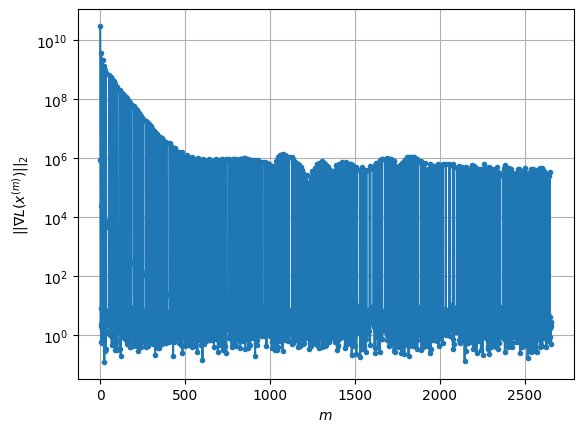

Windows:  95%|█████████▌| 282/296 [1:44:30<04:05, 17.57s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 919.7322703846672
Gradient norm: 257296.17064790535
Deviation from touching point norm = 0.0
Global relative error: 76.97036436440229
Position relative errors: 0.019492376162543037 m, 52.89328949343092 m, 9.892494452257045 m, 55.03521543784118 m

Iteration 1
Cost function: 917.1404790039439 (-0.28%)
Gradient norm: 2.2457142897199693 (-100.00%)
Deviation from touching point norm = 0.1683581159819567 (168358115981.96%)
Global relative error = 76.93818199006846 (-0.04%)
Position relative errors: 0.014110045012017304 m, 52.87833241460123 m, 9.906361130751188 m, 55.00208602663174 m

STOP on Iteration 2
Cost function = 917.1404775047342 (-0.00%)
Gradient norm = 0.7674970798854854 (-65.82%)
Deviation from touching point norm = 0.16835810893320816 (-0.00%)
Global relative error = 76.93818199154457 (0.00%)
Final position relative errors: 0.014110044890217076 m, 52.87833241505483 m, 9.90636113152327 m, 55.0020860

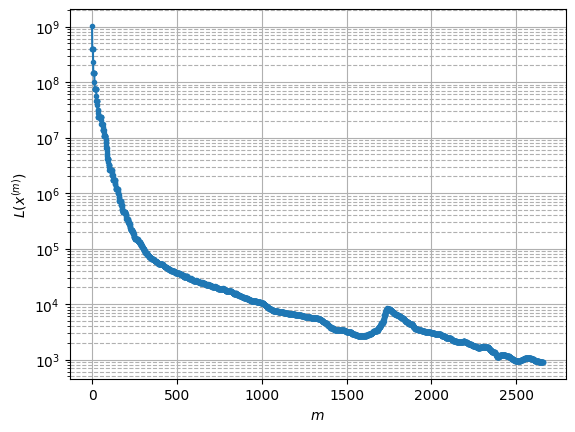

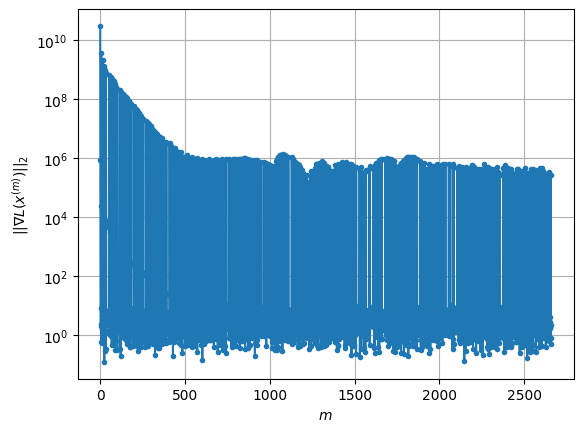

Windows:  96%|█████████▌| 283/296 [1:44:38<03:09, 14.55s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 920.7807299396678
Gradient norm: 375041.28732352034
Deviation from touching point norm = 0.0
Global relative error: 76.42880835716518
Position relative errors: 0.014428552833810294 m, 52.82369652369199 m, 10.290170574911869 m, 54.26906823428192 m

Iteration 1
Cost function: 917.6646038579094 (-0.34%)
Gradient norm: 1.0626877023917953 (-100.00%)
Deviation from touching point norm = 0.17925057134806174 (179250571348.06%)
Global relative error = 76.39792547015725 (-0.04%)
Position relative errors: 0.01065701018734944 m, 52.81034498537885 m, 10.302957630811708 m, 54.236142774271414 m

STOP on Iteration 2
Cost function = 917.6646044849637 (0.00%)
Gradient norm = 0.8862171502272668 (-16.61%)
Deviation from touching point norm = 0.17925056658588442 (-0.00%)
Global relative error = 76.39792547172127 (0.00%)
Final position relative errors: 0.010657008741434227 m, 52.810344985510746 m, 10.302957631573607 m, 54.23

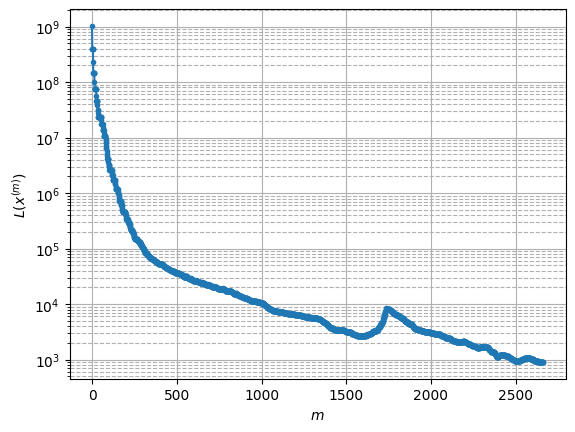

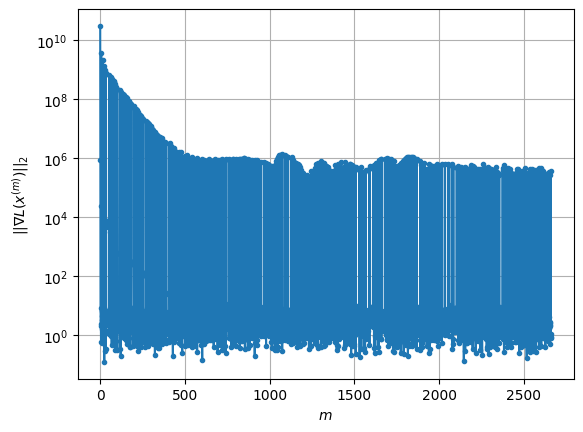

Windows:  96%|█████████▌| 284/296 [1:44:45<02:28, 12.41s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 917.462856380022
Gradient norm: 345778.8041790334
Deviation from touching point norm = 0.0
Global relative error: 75.56034606630067
Position relative errors: 0.010982050728104679 m, 52.524221245694434 m, 10.640795358348244 m, 53.26673476707209 m

STOP on Iteration 1
Cost function = 913.6614044053335 (-0.41%)
Gradient norm = 0.36220037650532694 (-100.00%)
Deviation from touching point norm = 0.20638702310069654 (206387023100.70%)
Global relative error = 75.5310152903515 (-0.04%)
Final position relative errors: 0.016814668152272748 m, 52.51259929354015 m, 10.652751779436064 m, 53.234193738568685 m

Majorization-Minimization converged after 1 iterations


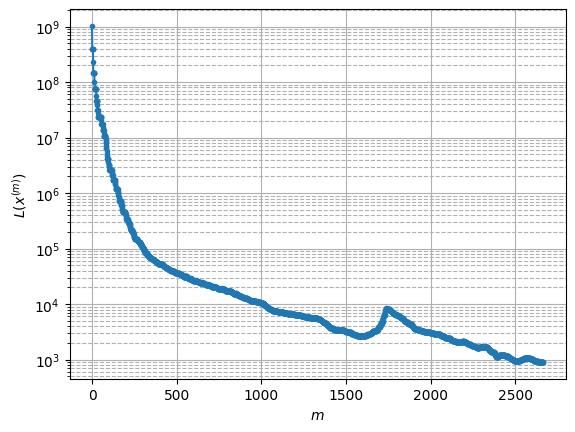

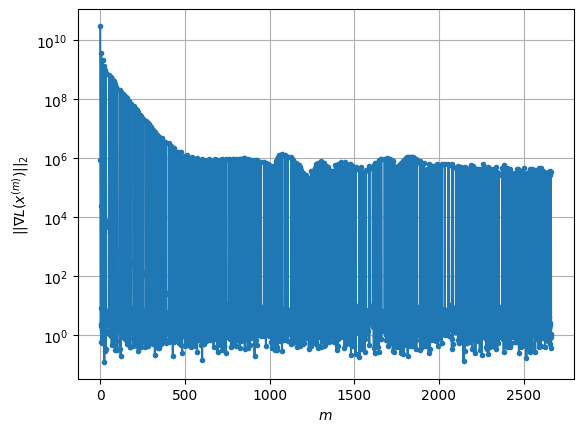

Windows:  96%|█████████▋| 285/296 [1:44:51<01:52, 10.25s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 924.7133480847704
Gradient norm: 280871.425223096
Deviation from touching point norm = 0.0
Global relative error: 74.36935757136555
Position relative errors: 0.0172498239398652 m, 51.99627486632229 m, 10.942892346756569 m, 52.033075473688214 m

STOP on Iteration 1
Cost function = 921.7458890736367 (-0.32%)
Gradient norm = 0.9391133338326964 (-100.00%)
Deviation from touching point norm = 0.16240279741913763 (162402797419.14%)
Global relative error = 74.34057479836902 (-0.04%)
Final position relative errors: 0.017956810333736035 m, 51.98519188838713 m, 10.95220131987935 m, 52.00105036449461 m

Majorization-Minimization converged after 1 iterations


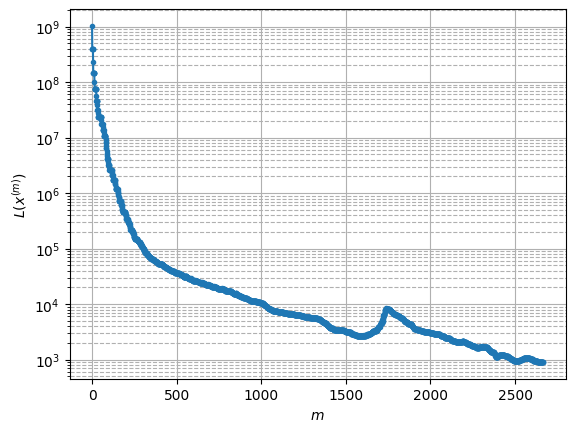

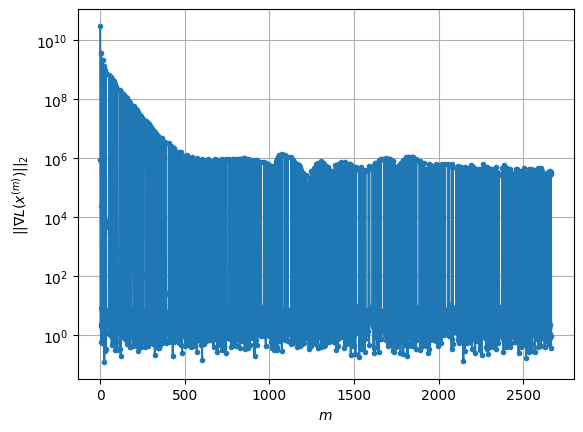

Windows:  97%|█████████▋| 286/296 [1:44:56<01:27,  8.71s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 924.6981321614683
Gradient norm: 271464.76830095774
Deviation from touching point norm = 0.0
Global relative error: 72.86056822895311
Position relative errors: 0.01863111382897812 m, 51.241042522231425 m, 11.193337752478739 m, 50.573964954311094 m

Iteration 1
Cost function: 921.4909284198047 (-0.35%)
Gradient norm: 2.3872943950964576 (-100.00%)
Deviation from touching point norm = 0.17485178964650464 (174851789646.50%)
Global relative error = 72.83330949470412 (-0.04%)
Position relative errors: 0.021739867962520257 m, 51.230997158770855 m, 11.202712874923261 m, 50.54279157281013 m

Iteration 2
Cost function: 921.4909272337633 (-0.00%)
Gradient norm: 1.4874097920262515 (-37.69%)
Deviation from touching point norm = 0.17485179800706588 (0.00%)
Global relative error = 72.83330949732783 (0.00%)
Position relative errors: 0.021739864682214814 m, 51.23099715908168 m, 11.202712876120499 m, 50.542791576011915 m

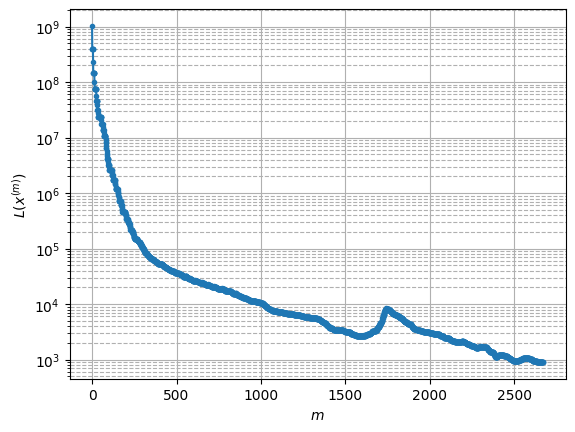

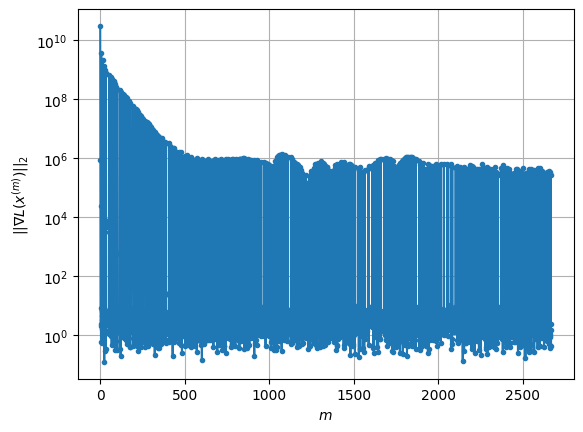

Windows:  97%|█████████▋| 287/296 [1:45:06<01:21,  9.09s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 926.3099711416961
Gradient norm: 307892.64464063855
Deviation from touching point norm = 0.0
Global relative error: 71.04206923344465
Position relative errors: 0.022441070942022186 m, 50.26238121668766 m, 11.39349578931351 m, 48.89637203598696 m

STOP on Iteration 1
Cost function = 923.8449882140378 (-0.27%)
Gradient norm = 0.6787045373724627 (-100.00%)
Deviation from touching point norm = 0.14539867976310453 (145398679763.10%)
Global relative error = 71.01533536480528 (-0.04%)
Final position relative errors: 0.021041574495749147 m, 50.25291654502443 m, 11.400201116814141 m, 48.86569371877716 m

Majorization-Minimization converged after 1 iterations


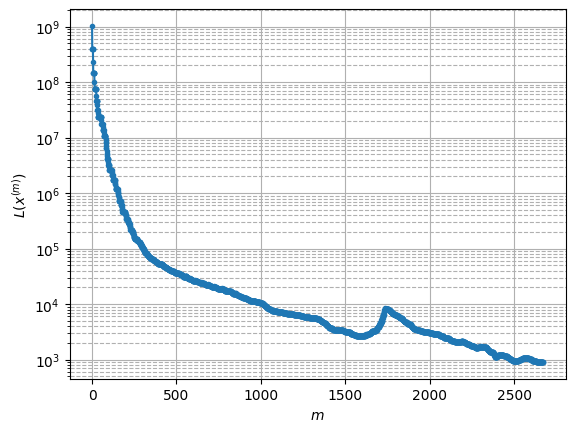

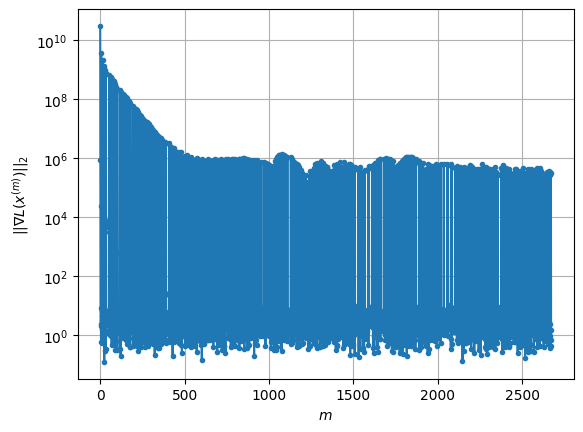

Windows:  97%|█████████▋| 288/296 [1:45:11<01:03,  7.91s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 943.1554754876153
Gradient norm: 398424.6061514204
Deviation from touching point norm = 0.0
Global relative error: 68.9216013775338
Position relative errors: 0.0219199896569379 m, 49.064221193891804 m, 11.539745248933398 m, 47.00767589435808 m

Iteration 1
Cost function: 940.2201190601892 (-0.31%)
Gradient norm: 4.115334745984639 (-100.00%)
Deviation from touching point norm = 0.15472530613658525 (154725306136.59%)
Global relative error = 68.89552691525518 (-0.04%)
Position relative errors: 0.019397352379499844 m, 49.05480635493978 m, 11.546302329496768 m, 46.977660545617354 m

STOP on Iteration 2
Cost function = 940.2201203938424 (0.00%)
Gradient norm = 0.8720633031049314 (-78.81%)
Deviation from touching point norm = 0.15472530122787123 (-0.00%)
Global relative error = 68.89552691781894 (0.00%)
Final position relative errors: 0.019397353621725618 m, 49.05480635503713 m, 11.546302331012038 m, 46.977660

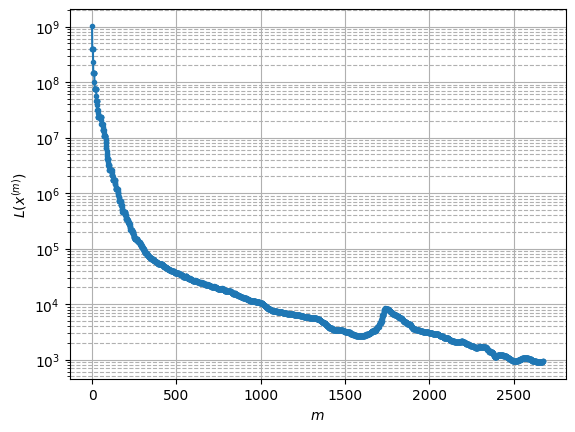

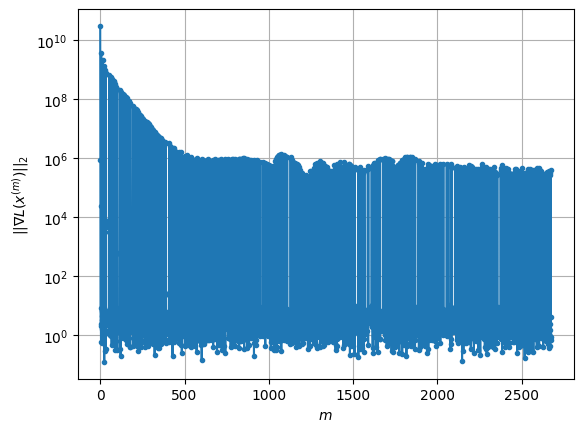

Windows:  98%|█████████▊| 289/296 [1:45:18<00:54,  7.81s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 958.9765082088151
Gradient norm: 379171.90413161
Deviation from touching point norm = 0.0
Global relative error: 66.50940127476902
Position relative errors: 0.02060863054005087 m, 47.65138502009198 m, 11.63385274966303 m, 44.9165568340443 m

Iteration 1
Cost function: 955.6831021897705 (-0.34%)
Gradient norm: 3.0261119142657353 (-100.00%)
Deviation from touching point norm = 0.13657127425204432 (136571274252.04%)
Global relative error = 66.48396077282385 (-0.04%)
Position relative errors: 0.023222790819362404 m, 47.64228481471295 m, 11.641214301719222 m, 44.886628299308924 m

Iteration 2
Cost function: 955.6831043478711 (0.00%)
Gradient norm: 1.40773046602629 (-53.48%)
Deviation from touching point norm = 0.13657127206847083 (-0.00%)
Global relative error = 66.48396077569392 (0.00%)
Position relative errors: 0.023222788041013017 m, 47.64228481495403 m, 11.6412143033342 m, 44.88662830288665 m

Iteration 

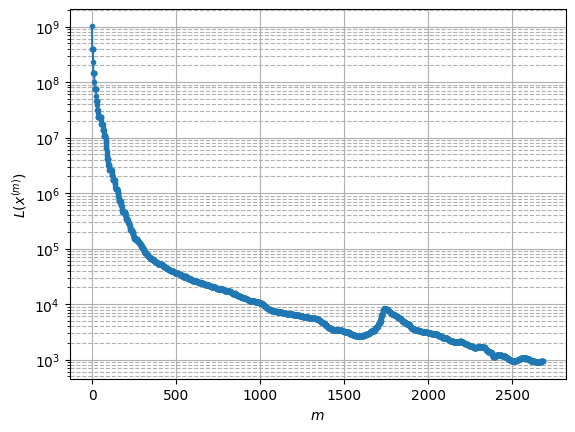

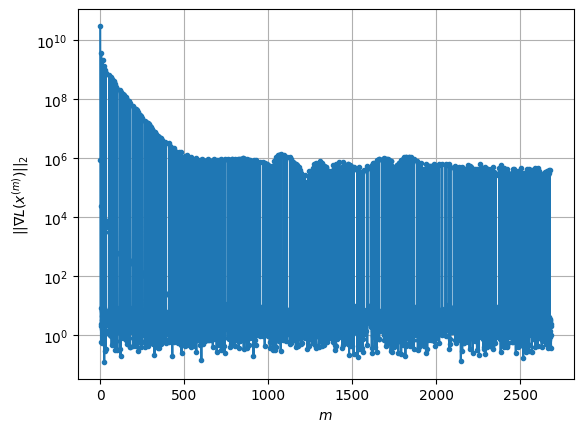

Windows:  98%|█████████▊| 290/296 [1:45:40<01:11, 11.84s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 959.8854760702749
Gradient norm: 278983.58387067105
Deviation from touching point norm = 0.0
Global relative error: 63.81700816958222
Position relative errors: 0.024407704111516083 m, 46.030467106896026 m, 11.676217741438336 m, 42.631791221483134 m

Iteration 1
Cost function: 957.3098106102774 (-0.27%)
Gradient norm: 2.186942755350151 (-100.00%)
Deviation from touching point norm = 0.11806011010698725 (118060110106.99%)
Global relative error = 63.79295770684873 (-0.04%)
Position relative errors: 0.03351418273375044 m, 46.0213167138488 m, 11.683648631450113 m, 42.60362362387966 m

Iteration 2
Cost function: 957.3098102447732 (-0.00%)
Gradient norm: 4.647180037675174 (112.50%)
Deviation from touching point norm = 0.11806010154345327 (-0.00%)
Global relative error = 63.7929577094865 (0.00%)
Position relative errors: 0.0335141863433642 m, 46.02131671404114 m, 11.683648633048298 m, 42.603623627180454 m

Iter

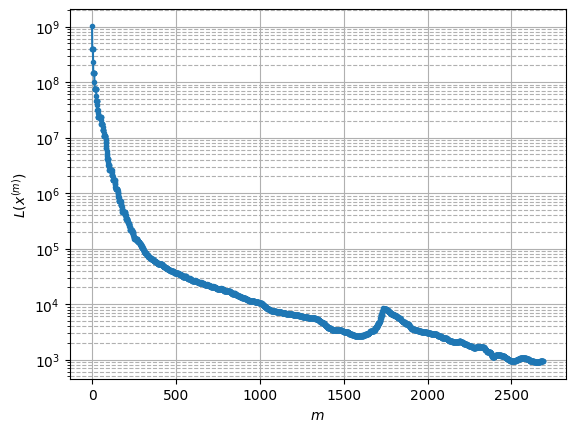

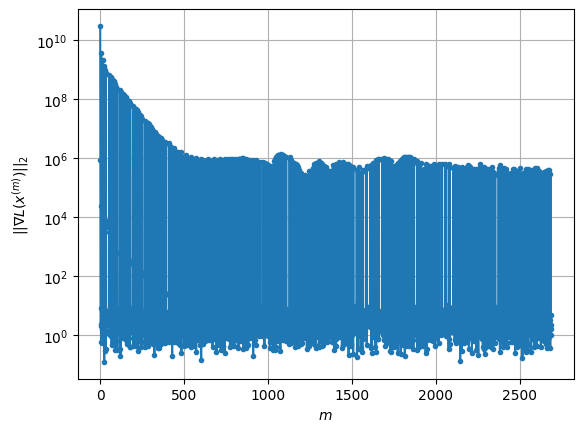

Windows:  98%|█████████▊| 291/296 [1:45:51<00:59, 11.81s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 958.2885186733442
Gradient norm: 252635.23281886606
Deviation from touching point norm = 0.0
Global relative error: 60.85821336951298
Position relative errors: 0.034291002902867865 m, 44.20832448914025 m, 11.665813921125444 m, 40.165295952117376 m

Iteration 1
Cost function: 955.9311111507071 (-0.25%)
Gradient norm: 7.149872646333039 (-100.00%)
Deviation from touching point norm = 0.12342251223429526 (123422512234.30%)
Global relative error = 60.83571174378542 (-0.04%)
Position relative errors: 0.027520383846093566 m, 44.198935045782775 m, 11.67343882105858 m, 40.13932294134862 m

Iteration 2
Cost function: 955.9311101295157 (-0.00%)
Gradient norm: 2.01382650454271 (-71.83%)
Deviation from touching point norm = 0.12342250502489525 (-0.00%)
Global relative error = 60.835711746551816 (0.00%)
Position relative errors: 0.02752038210856332 m, 44.19893504589697 m, 11.673438823006045 m, 40.1393229448505 m

Ite

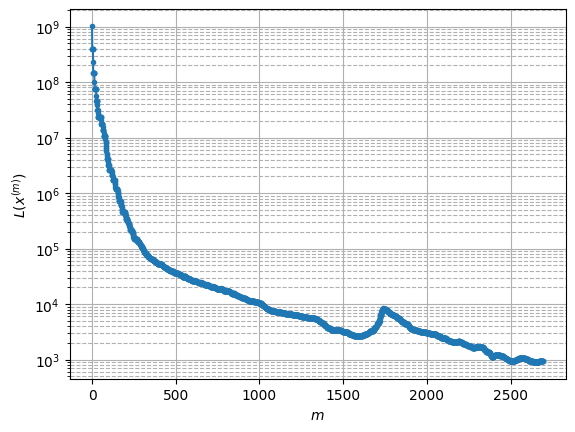

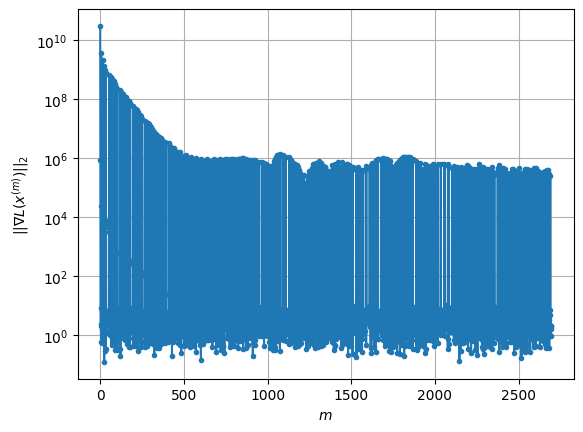

Windows:  99%|█████████▊| 292/296 [1:46:06<00:50, 12.54s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 966.1393273822703
Gradient norm: 306226.83615321724
Deviation from touching point norm = 0.0
Global relative error: 57.64769733360458
Position relative errors: 0.02852272726184839 m, 42.19288909818932 m, 11.602754164952538 m, 37.52851121385709 m

Iteration 1
Cost function: 962.3580850941564 (-0.39%)
Gradient norm: 2.146380126598369 (-100.00%)
Deviation from touching point norm = 0.19304725608609388 (193047256086.09%)
Global relative error = 57.62705507027334 (-0.04%)
Position relative errors: 0.024227322703057413 m, 42.18336406004358 m, 11.611648206831656 m, 37.50476063995994 m

STOP on Iteration 2
Cost function = 962.3580879823365 (0.00%)
Gradient norm = 0.4221252268352487 (-80.33%)
Deviation from touching point norm = 0.19304726051116713 (0.00%)
Global relative error = 57.627055073699516 (0.00%)
Final position relative errors: 0.024227322205844462 m, 42.18336406087831 m, 11.611648208874087 m, 37.50476

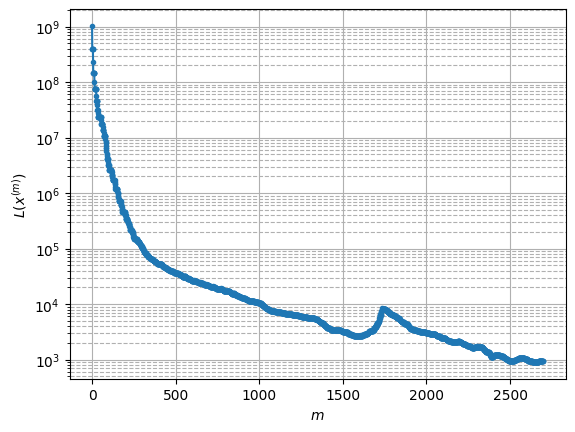

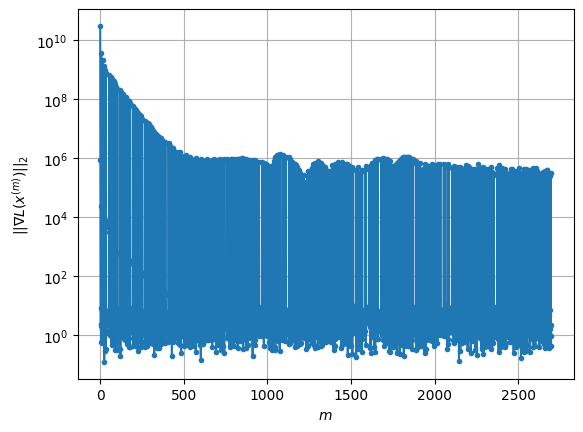

Windows:  99%|█████████▉| 293/296 [1:46:13<00:33, 11.12s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 971.4743444213508
Gradient norm: 309508.57528816216
Deviation from touching point norm = 0.0
Global relative error: 54.20182867062577
Position relative errors: 0.02522373261470289 m, 39.99322066135884 m, 11.488304910076074 m, 34.733197955088066 m

Iteration 1
Cost function: 968.2449526105152 (-0.33%)
Gradient norm: 3.569400729378988 (-100.00%)
Deviation from touching point norm = 0.14220999591383168 (142209995913.83%)
Global relative error = 54.1815240443805 (-0.04%)
Position relative errors: 0.024336160529433565 m, 39.9828075026089 m, 11.497830324572432 m, 34.71034797563592 m

Iteration 2
Cost function: 968.2449506078717 (-0.00%)
Gradient norm: 5.645746624066562 (58.17%)
Deviation from touching point norm = 0.14221000291635674 (0.00%)
Global relative error = 54.181524047762984 (0.00%)
Position relative errors: 0.024336164949523363 m, 39.98280750332975 m, 11.49783032642348 m, 34.71034797946922 m

Iterat

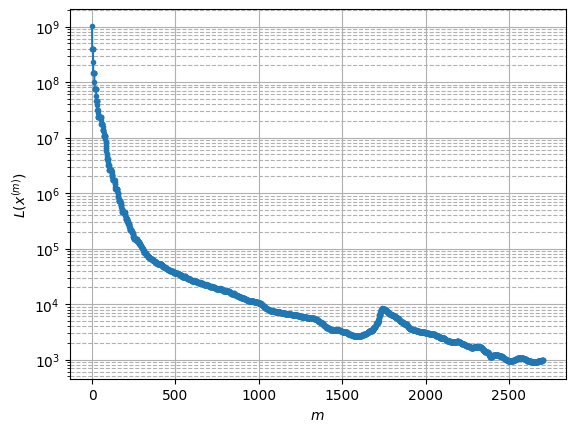

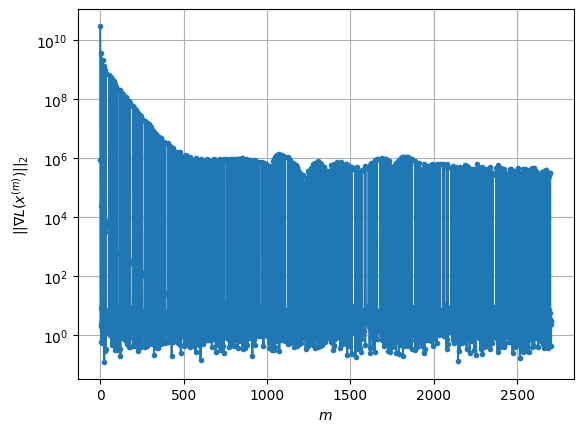

Windows:  99%|█████████▉| 294/296 [1:46:30<00:25, 12.70s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 960.2271150664787
Gradient norm: 269315.3205806019
Deviation from touching point norm = 0.0
Global relative error: 50.53679167995298
Position relative errors: 0.025372801483433353 m, 37.618348991151194 m, 11.322355530734475 m, 31.79035371812034 m

STOP on Iteration 1
Cost function = 957.5041454677588 (-0.28%)
Gradient norm = 0.9142717850672519 (-100.00%)
Deviation from touching point norm = 0.15995977321791904 (159959773217.92%)
Global relative error = 50.51952463948991 (-0.03%)
Final position relative errors: 0.025708329847317617 m, 37.60859272307472 m, 11.331616256804653 m, 31.77114691875453 m

Majorization-Minimization converged after 1 iterations


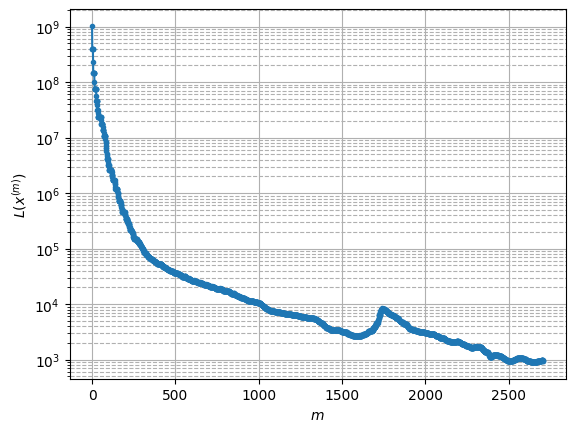

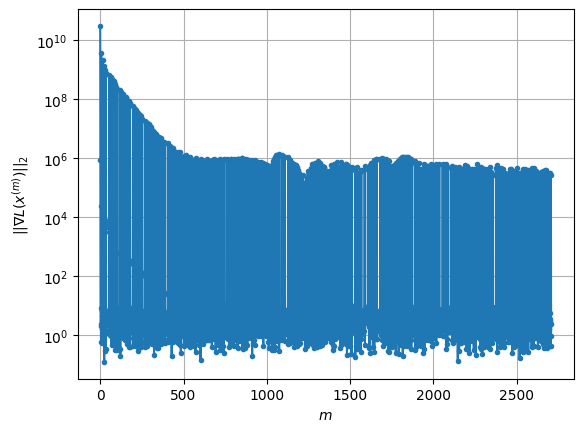

Windows: 100%|█████████▉| 295/296 [1:46:35<00:10, 10.41s/it]


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 951.5465978058602
Gradient norm: 451082.65310270584
Deviation from touching point norm = 0.0
Global relative error: 46.674942693400496
Position relative errors: 0.02660928947764545 m, 35.08031178870519 m, 11.10478122679548 m, 28.715858228603604 m

Iteration 1
Cost function: 947.2792998838833 (-0.45%)
Gradient norm: 2.961565013165886 (-100.00%)
Deviation from touching point norm = 0.23970035672502404 (239700356725.02%)
Global relative error = 46.661929527293005 (-0.03%)
Position relative errors: 0.027353018555367647 m, 35.06979688755489 m, 11.116081138470387 m, 28.703177505156287 m

Iteration 2
Cost function: 947.2793006703329 (0.00%)
Gradient norm: 7.458959426664346 (151.86%)
Deviation from touching point norm = 0.2397003546922587 (-0.00%)
Global relative error = 46.66192953021938 (0.00%)
Position relative errors: 0.027353017679930775 m, 35.06979688790566 m, 11.11608113948489 m, 28.70317750909296 m

Ite

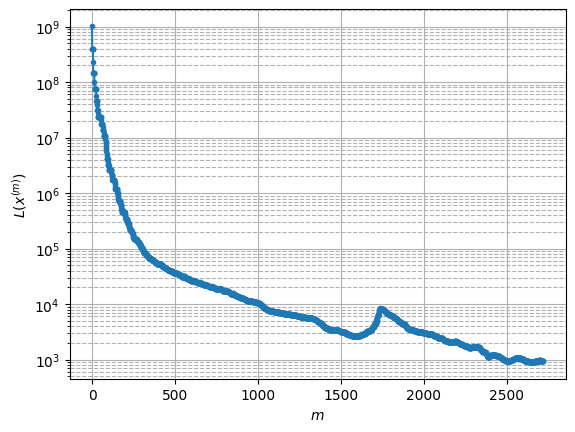

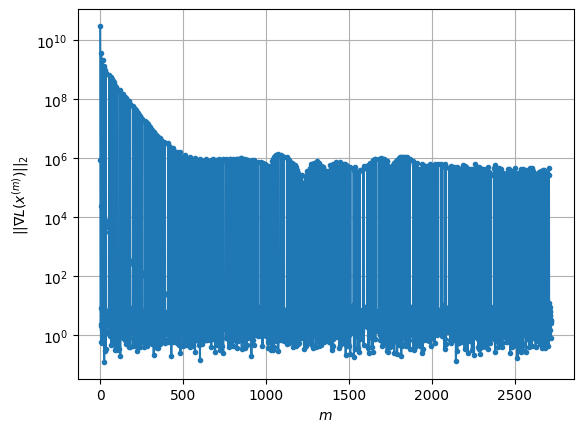

RMSE after convergence:
Chief: nan m
Deputy 1: nan m
Deputy 2: nan m
Deputy 3: nan m


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


In [11]:
# Main execution loop
def run_estimation():
    
    Y = np.zeros((9, 1, T))
    for t in range(T):
        Y[:, :, t] = h(X_true[:, :, t]) + np.random.normal(0, np.sqrt(np.diag(R)).reshape((9, 1)), size=(9, 1))
        
    # Initialize storage for results
    X_est_mm = np.zeros_like(X_true)
    X_est_mm[:, :, 0] = X_est[:, :, 0]  # Use same initial conditions
    
    # Storage for errors
    errors_chief_mm = []
    errors_deputy1_mm = []
    errors_deputy2_mm = []
    errors_deputy3_mm = []
    
    # Initialize solver
    solver = MM_Newton()
    
    # Sliding window estimation
    for t in tqdm(range(T - W + 1), desc="Windows", leave=False):
        # Get measurements for current window
        Y_window = Y[:, :, t:t + W]
        
        # Initial guess is the previous estimate propagated forward
        if t == 0:
            x_init = X_est[:, :, t]
        else:
            x_init = X_est_mm[:, :, t]
        
        # Solve the optimization problem
        x_sol = solver.solve(x_init, Y_window, X_true[:, :, t])
        
        # Store the solution
        X_est_mm[:, :, t] = x_sol
        
        # Plot the results
        give_me_the_plots(solver.cost_function_values, solver.grad_norm_values)
        
        # Propagate solution to next timestep if not at the end
        if t < T - W:
            X_est_mm[:, :, t + 1] = SatelliteDynamics().x_new(dt, x_sol)
        
        # Calculate and store errors
        error_chief = np.linalg.norm(X_est_mm[:3, :, t] - X_true[:3, :, t])
        error_deputy1 = np.linalg.norm(X_est_mm[6:9, :, t] - X_true[6:9, :, t])
        error_deputy2 = np.linalg.norm(X_est_mm[12:15, :, t] - X_true[12:15, :, t])
        error_deputy3 = np.linalg.norm(X_est_mm[18:21, :, t] - X_true[18:21, :, t])
        
        errors_chief_mm.append(error_chief)
        errors_deputy1_mm.append(error_deputy1)
        errors_deputy2_mm.append(error_deputy2)
        errors_deputy3_mm.append(error_deputy3)
    
    return X_est_mm, errors_chief_mm, errors_deputy1_mm, errors_deputy2_mm, errors_deputy3_mm

# Run the estimation
X_est_mm, errors_chief_mm, errors_deputy1_mm, errors_deputy2_mm, errors_deputy3_mm = run_estimation()

# Print RMSE for each satellite
print("RMSE after convergence:")
print(f"Chief: {np.sqrt(np.mean(np.array(errors_chief_mm[T_RMSE:])**2)):.2f} m")
print(f"Deputy 1: {np.sqrt(np.mean(np.array(errors_deputy1_mm[T_RMSE:])**2)):.2f} m")
print(f"Deputy 2: {np.sqrt(np.mean(np.array(errors_deputy2_mm[T_RMSE:])**2)):.2f} m")
print(f"Deputy 3: {np.sqrt(np.mean(np.array(errors_deputy3_mm[T_RMSE:])**2)):.2f} m")

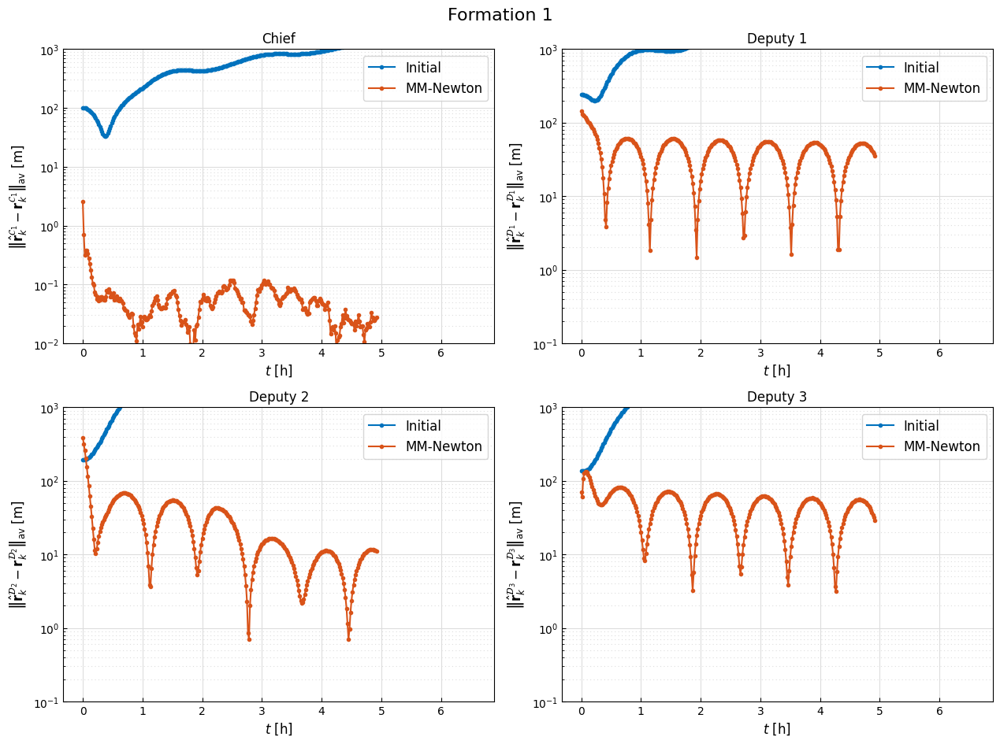

In [12]:
dev_chief = errors_chief_mm
dev_deputy1 = errors_deputy1_mm
dev_deputy2 = errors_deputy2_mm
dev_deputy3 = errors_deputy3_mm

# MATLAB default color cycle
matlab_default_colors = [
    [0, 0.4470, 0.7410],  # blue
    [0.8500, 0.3250, 0.0980],  # orange
    [0.9290, 0.6940, 0.1250],  # yellow
    [0.4940, 0.1840, 0.5560],  # purple
    [0.4660, 0.6740, 0.1880],  # green
    [0.3010, 0.7450, 0.9330],  # light blue
    [0.6350, 0.0780, 0.1840],  # red
]
# Set the color cycle in Matplotlib to match MATLAB's default
plt.rcParams["axes.prop_cycle"] = plt.cycler(color=matlab_default_colors)

time = np.arange(0, T) / dt
algorithm = "MM-Newton"

# Plot positions based on screen size
fig_width = 2 * 6.4  # in inchesa
fig_height = 2 * 4.8  # in inches

# Create a 2 by 2 figure
fig, axs = plt.subplots(2, 2, figsize=(fig_width, fig_height))

# Plot 1: Chief
axs[0, 0].plot(time, dev_chief_initial, ".-", label="Initial")
axs[0, 0].plot(time[:K - W + 1], dev_chief, ".-", label=algorithm)
axs[0, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 0].grid(True, which="both")
axs[0, 0].set_yscale("log")
axs[0, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{C}_1} - \\mathbf{r}_k^{\\mathcal{C}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[0, 0].set_ylim([1e-2, 1e3])
axs[0, 0].tick_params(axis="both", which="both", direction="in")
axs[0, 0].legend(fontsize=12)
axs[0, 0].set_title("Chief")

# Plot 2: Deputy 1
axs[0, 1].plot(time, dev_deputy1_initial, ".-", label="Initial")
axs[0, 1].plot(time[:K - W + 1], dev_deputy1, ".-", label=algorithm)
axs[0, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 1].grid(True, which="both")
axs[0, 1].set_yscale("log")
axs[0, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_1} - \\mathbf{r}_k^{\\mathcal{D}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[0, 1].set_ylim([1e-1, 1e3])
axs[0, 1].tick_params(axis="both", which="both", direction="in")
axs[0, 1].legend(fontsize=12)
axs[0, 1].set_title("Deputy 1")

# Plot 3: Deputy 2
axs[1, 0].plot(time, dev_deputy2_initial, ".-", label="Initial")
axs[1, 0].plot(time[:K - W + 1], dev_deputy2, ".-", label=algorithm)
axs[1, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 0].grid(True, which="both")
axs[1, 0].set_yscale("log")
axs[1, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_2} - \\mathbf{r}_k^{\\mathcal{D}_2}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[1, 0].set_ylim([1e-1, 1e3])
axs[1, 0].tick_params(axis="both", which="both", direction="in")
axs[1, 0].legend(fontsize=12)
axs[1, 0].set_title("Deputy 2")

# Plot 4: Deputy 3
axs[1, 1].plot(time, dev_deputy3_initial, ".-", label="Initial")
axs[1, 1].plot(time[:K - W + 1], dev_deputy3, ".-", label=algorithm)
axs[1, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 1].grid(True, which="both")
axs[1, 1].set_yscale("log")
axs[1, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_3} - \\mathbf{r}_k^{\\mathcal{D}_3}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[1, 1].set_ylim([1e-1, 1e3])
axs[1, 1].tick_params(axis="both", which="both", direction="in")
axs[1, 1].legend(fontsize=12)
axs[1, 1].set_title("Deputy 3")

fig.suptitle(f"Formation {formation}", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 1])
plt.show()

In [13]:
import pickle
from datetime import datetime

# Fill the dictionary
data = {}
data["true"] = X_true[:, :, : K - W + 1]
data[0] = X_est_mm

# Save to pickle file
with open(
    f'mm_newton_all_range_surrogate_form{formation}_{datetime.now().strftime("%Y%m%d_%H%M%S")}.pkl',
    "wb",
) as file:
    pickle.dump(data, file)